In [1]:
#Import tensorflow

import tensorflow as tf
tf.compat.v1.disable_v2_behavior()
gpu_devices = tf.config.experimental.list_physical_devices("GPU")
for device in gpu_devices:
    tf.config.experimental.set_memory_growth(device, True)

Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
#Test if GPU is found

if tf.test.gpu_device_name():
    print('GPU found')
else:
    print("No GPU found")

GPU found


In [3]:
#Autosaving every 10s

%autosave 10

Autosaving every 10 seconds


In [4]:
#Training & Testing files

xtrain_file = "xtrain.csv"
ytrain_file = "ytrain.csv"
xval_file = "xval.csv"
yval_file = "yval.csv"
xtest_file = "xtest.csv"
ytest_file = "ytest.csv"

In [5]:
import pandas as pd
import numpy as np
import scipy.io
import tensorflow_probability as tfp
import matplotlib as plt
import matplotlib.pyplot as plt
import pickle
import scipy.io as spio
import pickle
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential, model_from_json, load_model
from tensorflow.keras.layers import Dense, LSTM, Dropout, Masking
tfd = tfp.distributions

In [6]:
# fix random seed for reproducibility

np.random.seed(0)

In [7]:
#load Training & Testing files into Pandas Dataframes

xtrain = pd.read_csv(xtrain_file, index_col=False)
ytrain = pd.read_csv(ytrain_file, index_col=False)
xval = pd.read_csv(xval_file, index_col=False)
yval = pd.read_csv(yval_file, index_col=False)
xtest = pd.read_csv(xtest_file, index_col=False)
ytest = pd.read_csv(ytest_file, index_col=False)

In [8]:
#Load Hyperparameters Obtained by BayesOpt

matlab_file = 'N1.mat'
mat = spio.loadmat(matlab_file, squeeze_me=True)
lr = mat['lr']
ep = mat['ep']
epochs = mat['epochs']
batch = mat['batch']
L2 = mat['L2'] 
unit1 = mat['unit'] 
size1 = mat['size']
drop1 = mat['drop']

C:\Users\Asus\anaconda3\lib\site-packages\scipy\io\matlab\mio.py:218: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [9]:
#Xtrain to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,4)

In [10]:
#Ytrain to Numpy multidimensional array

ytrain = ytrain.to_numpy()
ytrain = ytrain.reshape(278,24,1)

In [11]:
#Xval to Numpy multidimensional array

xval = xval.to_numpy()
xval = xval.reshape(34,24,4)

In [12]:
#Yval to Numpy multidimensional array

yval = yval.to_numpy()
yval = yval.reshape(34,24,1)

In [13]:
#Xtest to Numpy multidimensional array

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,4)

In [14]:
#Ground truth to Numpy multidimensional array

ytest = ytest.to_numpy()
ytest = ytest.reshape(34,24,1)

In [15]:
#Ytrain2 to Numpy multidimensional array - for SHAP

ytrain2 = np.zeros((278,1))
for i in range(278):
    ytrain2[i] =  ytrain[i][0]
    
ytrain2=ytrain2.reshape(278,)

In [16]:
#Yval2 to Numpy multidimensional array - for SHAP

yval2 = np.zeros((34,1))
for i in range(34):
    yval2[i] =  yval[i][0]
    
yval2 =yval2.reshape(34,)

In [17]:
#Set ytrain, yval for 3 outputs

x_train = xtrain
y_train = [ytrain,ytrain,ytrain2]
x_val = xval
y_val = [yval,yval,yval2]
x_test = xtest

In [18]:
import sklearn
import math
from tensorflow.keras import layers
from tensorflow.keras import activations
from tensorflow.keras import callbacks
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback,ReduceLROnPlateau
from tensorflow.keras.layers import Flatten, Reshape
import warnings
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Lambda, concatenate
from tensorflow.keras.models import Model
from IPython.display import display
from sklearn import metrics

In [19]:
#Define trainable prior

def posterior_mean_field(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  c = np.log(np.expm1(1.))
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(2 * n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t[..., :n],
                     scale=1e-5 + tf.nn.softplus(c + t[..., n:])),
          reinterpreted_batch_ndims=1)),
  ])

# Specify the prior over `keras.layers.Dense` `kernel` and `bias`.
def prior_trainable(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t, scale=1),
          reinterpreted_batch_ndims=1)),
  ])

In [20]:
#Define probabilistic LSTM

#LSTM layers

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)

#Output 1 = Aleatoric output layer

layer3 = Dense(1+1)(layer2)
layer4 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t[..., :1],scale=1e-3 + tf.math.softplus(0.05 * t[..., 1:])),name='out1')(layer3) #aleatoric

#Output 2 = Epistemic output layer

layer5 = tfp.layers.DenseVariational(1, posterior_mean_field, prior_trainable)(layer2)
layer6 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t, scale=1),name = 'out2')(layer5)

#Output 3 = Slicer output layer

layer7 = Dense(1)(layer2)
layer8 = Lambda(lambda t: t[:,-1],name='out3')(layer7)


model = tf.keras.Model(inputs=inputs, outputs=[layer4,layer6,layer8])
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 24, 4)]      0                                            
__________________________________________________________________________________________________
lstm (LSTM)                     (None, 24, 860)      2975600     input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 24, 123)      105903      lstm[0][0]                       
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 24, 2)        248         dense[0][0]                      
_______________________________________________________________________________________

In [21]:
#Define directory for best weights checkpoint

import os
checkpoint_path = "C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Real Gas Turbine/LSTM-N1_2/model checkpoint/N1_ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

#Callback for best weights checkpoint

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True,
    verbose = 1)

In [22]:
#Compile model

optimizers.Adam(learning_rate=lr, beta_1 = 0.9,beta_2 = 0.999, epsilon = ep, amsgrad = False, name = "Adam")
negloglik = lambda y, rv_y: -rv_y.log_prob(y)
model.compile(loss = {'out1': negloglik,'out2': negloglik,'out3':'mean_squared_error'},loss_weights=[0.5,0.5,0],optimizer= 'Adam')

In [23]:
#Set Tensorboard  

%load_ext tensorboard
import tensorboard
tensorboard.__version__
from datetime import datetime
from tensorflow import keras
# Define the Keras TensorBoard callback.
logdir="logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

In [24]:
# Run training

history = model.fit(x_train, y_train, validation_data = (x_val, y_val), epochs = 10000, batch_size  = batch, verbose = 0, callbacks=[model_checkpoint_callback,tensorboard_callback])

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.

Epoch 00001: val_loss improved from inf to 12860966.00000, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 00002: val_loss improved from 12860966.00000 to 9120696.00000, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 00003: val_loss improved from 9120696.00000 to 8163653.50000, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 00004: val_loss improved from 8163653.50000 to 7790248.00000, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 00005: val_loss did not improve from 7790248.00000

Epoch 00006: val_loss did not improve from 7790248.00000

Epoch 00007: val_loss improved from 7790248.00000 


Epoch 00084: val_loss improved from 2852063.00000 to 2663743.00000, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 00085: val_loss did not improve from 2663743.00000

Epoch 00086: val_loss did not improve from 2663743.00000

Epoch 00087: val_loss did not improve from 2663743.00000

Epoch 00088: val_loss did not improve from 2663743.00000

Epoch 00089: val_loss did not improve from 2663743.00000

Epoch 00090: val_loss improved from 2663743.00000 to 2003281.87500, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 00091: val_loss improved from 2003281.87500 to 1562307.00000, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 00092: val_loss did not improve from 1562307.00000

Epoch 00093: val_loss did not improve from 1562307.00000

Epoch 00094: val_loss did not improve from 1562307


Epoch 00195: val_loss did not improve from 239669.51562

Epoch 00196: val_loss did not improve from 239669.51562

Epoch 00197: val_loss did not improve from 239669.51562

Epoch 00198: val_loss did not improve from 239669.51562

Epoch 00199: val_loss did not improve from 239669.51562

Epoch 00200: val_loss did not improve from 239669.51562

Epoch 00201: val_loss did not improve from 239669.51562

Epoch 00202: val_loss did not improve from 239669.51562

Epoch 00203: val_loss improved from 239669.51562 to 238489.68750, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 00204: val_loss did not improve from 238489.68750

Epoch 00205: val_loss did not improve from 238489.68750

Epoch 00206: val_loss did not improve from 238489.68750

Epoch 00207: val_loss improved from 238489.68750 to 237144.59375, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 00208: v

Epoch 00311: val_loss improved from 215552.32812 to 214144.85938, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 00312: val_loss did not improve from 214144.85938

Epoch 00313: val_loss did not improve from 214144.85938

Epoch 00314: val_loss did not improve from 214144.85938

Epoch 00315: val_loss did not improve from 214144.85938

Epoch 00316: val_loss did not improve from 214144.85938

Epoch 00317: val_loss did not improve from 214144.85938

Epoch 00318: val_loss did not improve from 214144.85938

Epoch 00319: val_loss improved from 214144.85938 to 210497.93750, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 00320: val_loss did not improve from 210497.93750

Epoch 00321: val_loss did not improve from 210497.93750

Epoch 00322: val_loss did not improve from 210497.93750

Epoch 00323: val_loss did not improve from 210497.93750

Epoch 00324: va


Epoch 00423: val_loss improved from 184456.70312 to 182863.57812, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 00424: val_loss did not improve from 182863.57812

Epoch 00425: val_loss did not improve from 182863.57812

Epoch 00426: val_loss did not improve from 182863.57812

Epoch 00427: val_loss did not improve from 182863.57812

Epoch 00428: val_loss did not improve from 182863.57812

Epoch 00429: val_loss did not improve from 182863.57812

Epoch 00430: val_loss did not improve from 182863.57812

Epoch 00431: val_loss did not improve from 182863.57812

Epoch 00432: val_loss did not improve from 182863.57812

Epoch 00433: val_loss did not improve from 182863.57812

Epoch 00434: val_loss did not improve from 182863.57812

Epoch 00435: val_loss did not improve from 182863.57812

Epoch 00436: val_loss did not improve from 182863.57812

Epoch 00437: val_loss did not improve from 182863.57812

Epoch 00438: val_loss 

Epoch 00544: val_loss did not improve from 155772.71875

Epoch 00545: val_loss did not improve from 155772.71875

Epoch 00546: val_loss did not improve from 155772.71875

Epoch 00547: val_loss did not improve from 155772.71875

Epoch 00548: val_loss improved from 155772.71875 to 155265.40625, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 00549: val_loss did not improve from 155265.40625

Epoch 00550: val_loss improved from 155265.40625 to 148430.54688, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 00551: val_loss did not improve from 148430.54688

Epoch 00552: val_loss did not improve from 148430.54688

Epoch 00553: val_loss did not improve from 148430.54688

Epoch 00554: val_loss did not improve from 148430.54688

Epoch 00555: val_loss did not improve from 148430.54688

Epoch 00556: val_loss did not improve from 148430.54688

Epoch 00557: va


Epoch 00660: val_loss did not improve from 119934.52344

Epoch 00661: val_loss did not improve from 119934.52344

Epoch 00662: val_loss improved from 119934.52344 to 118185.43750, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 00663: val_loss did not improve from 118185.43750

Epoch 00664: val_loss did not improve from 118185.43750

Epoch 00665: val_loss did not improve from 118185.43750

Epoch 00666: val_loss improved from 118185.43750 to 117573.35938, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 00667: val_loss did not improve from 117573.35938

Epoch 00668: val_loss did not improve from 117573.35938

Epoch 00669: val_loss improved from 117573.35938 to 116909.79688, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 00670: val_loss did not improve from 116909.79688

Epoch 


Epoch 00778: val_loss did not improve from 95045.39844

Epoch 00779: val_loss did not improve from 95045.39844

Epoch 00780: val_loss improved from 95045.39844 to 87441.06250, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 00781: val_loss did not improve from 87441.06250

Epoch 00782: val_loss did not improve from 87441.06250

Epoch 00783: val_loss did not improve from 87441.06250

Epoch 00784: val_loss did not improve from 87441.06250

Epoch 00785: val_loss did not improve from 87441.06250

Epoch 00786: val_loss did not improve from 87441.06250

Epoch 00787: val_loss did not improve from 87441.06250

Epoch 00788: val_loss did not improve from 87441.06250

Epoch 00789: val_loss did not improve from 87441.06250

Epoch 00790: val_loss did not improve from 87441.06250

Epoch 00791: val_loss did not improve from 87441.06250

Epoch 00792: val_loss did not improve from 87441.06250

Epoch 00793: val_loss did not improve 

Epoch 00901: val_loss did not improve from 61658.03516

Epoch 00902: val_loss did not improve from 61658.03516

Epoch 00903: val_loss did not improve from 61658.03516

Epoch 00904: val_loss did not improve from 61658.03516

Epoch 00905: val_loss did not improve from 61658.03516

Epoch 00906: val_loss did not improve from 61658.03516

Epoch 00907: val_loss improved from 61658.03516 to 59588.21484, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 00908: val_loss did not improve from 59588.21484

Epoch 00909: val_loss did not improve from 59588.21484

Epoch 00910: val_loss did not improve from 59588.21484

Epoch 00911: val_loss did not improve from 59588.21484

Epoch 00912: val_loss did not improve from 59588.21484

Epoch 00913: val_loss did not improve from 59588.21484

Epoch 00914: val_loss did not improve from 59588.21484

Epoch 00915: val_loss improved from 59588.21484 to 57760.00391, saving model to C:/Users/Asus/O


Epoch 01026: val_loss did not improve from 37203.08203

Epoch 01027: val_loss did not improve from 37203.08203

Epoch 01028: val_loss did not improve from 37203.08203

Epoch 01029: val_loss improved from 37203.08203 to 36678.86328, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 01030: val_loss did not improve from 36678.86328

Epoch 01031: val_loss did not improve from 36678.86328

Epoch 01032: val_loss did not improve from 36678.86328

Epoch 01033: val_loss did not improve from 36678.86328

Epoch 01034: val_loss did not improve from 36678.86328

Epoch 01035: val_loss did not improve from 36678.86328

Epoch 01036: val_loss did not improve from 36678.86328

Epoch 01037: val_loss did not improve from 36678.86328

Epoch 01038: val_loss improved from 36678.86328 to 32801.05078, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 01039: val_loss did not


Epoch 01139: val_loss did not improve from 9780.60645

Epoch 01140: val_loss did not improve from 9780.60645

Epoch 01141: val_loss did not improve from 9780.60645

Epoch 01142: val_loss did not improve from 9780.60645

Epoch 01143: val_loss did not improve from 9780.60645

Epoch 01144: val_loss did not improve from 9780.60645

Epoch 01145: val_loss did not improve from 9780.60645

Epoch 01146: val_loss did not improve from 9780.60645

Epoch 01147: val_loss did not improve from 9780.60645

Epoch 01148: val_loss did not improve from 9780.60645

Epoch 01149: val_loss did not improve from 9780.60645

Epoch 01150: val_loss did not improve from 9780.60645

Epoch 01151: val_loss did not improve from 9780.60645

Epoch 01152: val_loss did not improve from 9780.60645

Epoch 01153: val_loss did not improve from 9780.60645

Epoch 01154: val_loss did not improve from 9780.60645

Epoch 01155: val_loss did not improve from 9780.60645

Epoch 01156: val_loss did not improve from 9780.60645

Epoch 011

Epoch 01271: val_loss did not improve from 1099.09851

Epoch 01272: val_loss did not improve from 1099.09851

Epoch 01273: val_loss did not improve from 1099.09851

Epoch 01274: val_loss did not improve from 1099.09851

Epoch 01275: val_loss did not improve from 1099.09851

Epoch 01276: val_loss did not improve from 1099.09851

Epoch 01277: val_loss improved from 1099.09851 to 1005.11700, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1_4/model checkpoint\N1_ckpt

Epoch 01278: val_loss did not improve from 1005.11700

Epoch 01279: val_loss did not improve from 1005.11700

Epoch 01280: val_loss did not improve from 1005.11700

Epoch 01281: val_loss did not improve from 1005.11700

Epoch 01282: val_loss did not improve from 1005.11700

Epoch 01283: val_loss did not improve from 1005.11700

Epoch 01284: val_loss did not improve from 1005.11700

Epoch 01285: val_loss did not improve from 1005.11700

Epoch 01286: val_loss did not improve from 1005.11700




Epoch 01416: val_loss did not improve from 857.50439

Epoch 01417: val_loss did not improve from 857.50439

Epoch 01418: val_loss did not improve from 857.50439

Epoch 01419: val_loss did not improve from 857.50439

Epoch 01420: val_loss did not improve from 857.50439

Epoch 01421: val_loss did not improve from 857.50439

Epoch 01422: val_loss did not improve from 857.50439

Epoch 01423: val_loss did not improve from 857.50439

Epoch 01424: val_loss did not improve from 857.50439

Epoch 01425: val_loss did not improve from 857.50439

Epoch 01426: val_loss did not improve from 857.50439

Epoch 01427: val_loss did not improve from 857.50439

Epoch 01428: val_loss did not improve from 857.50439

Epoch 01429: val_loss did not improve from 857.50439

Epoch 01430: val_loss did not improve from 857.50439

Epoch 01431: val_loss did not improve from 857.50439

Epoch 01432: val_loss did not improve from 857.50439

Epoch 01433: val_loss did not improve from 857.50439

Epoch 01434: val_loss did n


Epoch 01568: val_loss did not improve from 857.50439

Epoch 01569: val_loss did not improve from 857.50439

Epoch 01570: val_loss did not improve from 857.50439

Epoch 01571: val_loss did not improve from 857.50439

Epoch 01572: val_loss did not improve from 857.50439

Epoch 01573: val_loss did not improve from 857.50439

Epoch 01574: val_loss did not improve from 857.50439

Epoch 01575: val_loss did not improve from 857.50439

Epoch 01576: val_loss did not improve from 857.50439

Epoch 01577: val_loss did not improve from 857.50439

Epoch 01578: val_loss did not improve from 857.50439

Epoch 01579: val_loss did not improve from 857.50439

Epoch 01580: val_loss did not improve from 857.50439

Epoch 01581: val_loss did not improve from 857.50439

Epoch 01582: val_loss did not improve from 857.50439

Epoch 01583: val_loss did not improve from 857.50439

Epoch 01584: val_loss did not improve from 857.50439

Epoch 01585: val_loss did not improve from 857.50439

Epoch 01586: val_loss did n


Epoch 01720: val_loss did not improve from 857.50439

Epoch 01721: val_loss did not improve from 857.50439

Epoch 01722: val_loss did not improve from 857.50439

Epoch 01723: val_loss did not improve from 857.50439

Epoch 01724: val_loss did not improve from 857.50439

Epoch 01725: val_loss did not improve from 857.50439

Epoch 01726: val_loss did not improve from 857.50439

Epoch 01727: val_loss did not improve from 857.50439

Epoch 01728: val_loss did not improve from 857.50439

Epoch 01729: val_loss did not improve from 857.50439

Epoch 01730: val_loss did not improve from 857.50439

Epoch 01731: val_loss did not improve from 857.50439

Epoch 01732: val_loss did not improve from 857.50439

Epoch 01733: val_loss did not improve from 857.50439

Epoch 01734: val_loss did not improve from 857.50439

Epoch 01735: val_loss did not improve from 857.50439

Epoch 01736: val_loss did not improve from 857.50439

Epoch 01737: val_loss did not improve from 857.50439

Epoch 01738: val_loss did n


Epoch 01872: val_loss did not improve from 857.50439

Epoch 01873: val_loss did not improve from 857.50439

Epoch 01874: val_loss did not improve from 857.50439

Epoch 01875: val_loss did not improve from 857.50439

Epoch 01876: val_loss did not improve from 857.50439

Epoch 01877: val_loss did not improve from 857.50439

Epoch 01878: val_loss did not improve from 857.50439

Epoch 01879: val_loss did not improve from 857.50439

Epoch 01880: val_loss did not improve from 857.50439

Epoch 01881: val_loss did not improve from 857.50439

Epoch 01882: val_loss did not improve from 857.50439

Epoch 01883: val_loss did not improve from 857.50439

Epoch 01884: val_loss did not improve from 857.50439

Epoch 01885: val_loss did not improve from 857.50439

Epoch 01886: val_loss did not improve from 857.50439

Epoch 01887: val_loss did not improve from 857.50439

Epoch 01888: val_loss did not improve from 857.50439

Epoch 01889: val_loss did not improve from 857.50439

Epoch 01890: val_loss did n


Epoch 02025: val_loss did not improve from 857.50439

Epoch 02026: val_loss did not improve from 857.50439

Epoch 02027: val_loss did not improve from 857.50439

Epoch 02028: val_loss did not improve from 857.50439

Epoch 02029: val_loss did not improve from 857.50439

Epoch 02030: val_loss did not improve from 857.50439

Epoch 02031: val_loss did not improve from 857.50439

Epoch 02032: val_loss did not improve from 857.50439

Epoch 02033: val_loss did not improve from 857.50439

Epoch 02034: val_loss did not improve from 857.50439

Epoch 02035: val_loss did not improve from 857.50439

Epoch 02036: val_loss did not improve from 857.50439

Epoch 02037: val_loss did not improve from 857.50439

Epoch 02038: val_loss did not improve from 857.50439

Epoch 02039: val_loss did not improve from 857.50439

Epoch 02040: val_loss did not improve from 857.50439

Epoch 02041: val_loss did not improve from 857.50439

Epoch 02042: val_loss did not improve from 857.50439

Epoch 02043: val_loss did n


Epoch 02177: val_loss did not improve from 857.50439

Epoch 02178: val_loss did not improve from 857.50439

Epoch 02179: val_loss did not improve from 857.50439

Epoch 02180: val_loss did not improve from 857.50439

Epoch 02181: val_loss did not improve from 857.50439

Epoch 02182: val_loss did not improve from 857.50439

Epoch 02183: val_loss did not improve from 857.50439

Epoch 02184: val_loss did not improve from 857.50439

Epoch 02185: val_loss did not improve from 857.50439

Epoch 02186: val_loss did not improve from 857.50439

Epoch 02187: val_loss did not improve from 857.50439

Epoch 02188: val_loss did not improve from 857.50439

Epoch 02189: val_loss did not improve from 857.50439

Epoch 02190: val_loss did not improve from 857.50439

Epoch 02191: val_loss did not improve from 857.50439

Epoch 02192: val_loss did not improve from 857.50439

Epoch 02193: val_loss did not improve from 857.50439

Epoch 02194: val_loss did not improve from 857.50439

Epoch 02195: val_loss did n


Epoch 02330: val_loss did not improve from 857.50439

Epoch 02331: val_loss did not improve from 857.50439

Epoch 02332: val_loss did not improve from 857.50439

Epoch 02333: val_loss did not improve from 857.50439

Epoch 02334: val_loss did not improve from 857.50439

Epoch 02335: val_loss did not improve from 857.50439

Epoch 02336: val_loss did not improve from 857.50439

Epoch 02337: val_loss did not improve from 857.50439

Epoch 02338: val_loss did not improve from 857.50439

Epoch 02339: val_loss did not improve from 857.50439

Epoch 02340: val_loss did not improve from 857.50439

Epoch 02341: val_loss did not improve from 857.50439

Epoch 02342: val_loss did not improve from 857.50439

Epoch 02343: val_loss did not improve from 857.50439

Epoch 02344: val_loss did not improve from 857.50439

Epoch 02345: val_loss did not improve from 857.50439

Epoch 02346: val_loss did not improve from 857.50439

Epoch 02347: val_loss did not improve from 857.50439

Epoch 02348: val_loss did n


Epoch 02482: val_loss did not improve from 857.50439

Epoch 02483: val_loss did not improve from 857.50439

Epoch 02484: val_loss did not improve from 857.50439

Epoch 02485: val_loss did not improve from 857.50439

Epoch 02486: val_loss did not improve from 857.50439

Epoch 02487: val_loss did not improve from 857.50439

Epoch 02488: val_loss did not improve from 857.50439

Epoch 02489: val_loss did not improve from 857.50439

Epoch 02490: val_loss did not improve from 857.50439

Epoch 02491: val_loss did not improve from 857.50439

Epoch 02492: val_loss did not improve from 857.50439

Epoch 02493: val_loss did not improve from 857.50439

Epoch 02494: val_loss did not improve from 857.50439

Epoch 02495: val_loss did not improve from 857.50439

Epoch 02496: val_loss did not improve from 857.50439

Epoch 02497: val_loss did not improve from 857.50439

Epoch 02498: val_loss did not improve from 857.50439

Epoch 02499: val_loss did not improve from 857.50439

Epoch 02500: val_loss did n


Epoch 02635: val_loss did not improve from 857.50439

Epoch 02636: val_loss did not improve from 857.50439

Epoch 02637: val_loss did not improve from 857.50439

Epoch 02638: val_loss did not improve from 857.50439

Epoch 02639: val_loss did not improve from 857.50439

Epoch 02640: val_loss did not improve from 857.50439

Epoch 02641: val_loss did not improve from 857.50439

Epoch 02642: val_loss did not improve from 857.50439

Epoch 02643: val_loss did not improve from 857.50439

Epoch 02644: val_loss did not improve from 857.50439

Epoch 02645: val_loss did not improve from 857.50439

Epoch 02646: val_loss did not improve from 857.50439

Epoch 02647: val_loss did not improve from 857.50439

Epoch 02648: val_loss did not improve from 857.50439

Epoch 02649: val_loss did not improve from 857.50439

Epoch 02650: val_loss did not improve from 857.50439

Epoch 02651: val_loss did not improve from 857.50439

Epoch 02652: val_loss did not improve from 857.50439

Epoch 02653: val_loss did n


Epoch 02787: val_loss did not improve from 857.50439

Epoch 02788: val_loss did not improve from 857.50439

Epoch 02789: val_loss did not improve from 857.50439

Epoch 02790: val_loss did not improve from 857.50439

Epoch 02791: val_loss did not improve from 857.50439

Epoch 02792: val_loss did not improve from 857.50439

Epoch 02793: val_loss did not improve from 857.50439

Epoch 02794: val_loss did not improve from 857.50439

Epoch 02795: val_loss did not improve from 857.50439

Epoch 02796: val_loss did not improve from 857.50439

Epoch 02797: val_loss did not improve from 857.50439

Epoch 02798: val_loss did not improve from 857.50439

Epoch 02799: val_loss did not improve from 857.50439

Epoch 02800: val_loss did not improve from 857.50439

Epoch 02801: val_loss did not improve from 857.50439

Epoch 02802: val_loss did not improve from 857.50439

Epoch 02803: val_loss did not improve from 857.50439

Epoch 02804: val_loss did not improve from 857.50439

Epoch 02805: val_loss did n


Epoch 02939: val_loss did not improve from 857.50439

Epoch 02940: val_loss did not improve from 857.50439

Epoch 02941: val_loss did not improve from 857.50439

Epoch 02942: val_loss did not improve from 857.50439

Epoch 02943: val_loss did not improve from 857.50439

Epoch 02944: val_loss did not improve from 857.50439

Epoch 02945: val_loss did not improve from 857.50439

Epoch 02946: val_loss did not improve from 857.50439

Epoch 02947: val_loss did not improve from 857.50439

Epoch 02948: val_loss did not improve from 857.50439

Epoch 02949: val_loss did not improve from 857.50439

Epoch 02950: val_loss did not improve from 857.50439

Epoch 02951: val_loss did not improve from 857.50439

Epoch 02952: val_loss did not improve from 857.50439

Epoch 02953: val_loss did not improve from 857.50439

Epoch 02954: val_loss did not improve from 857.50439

Epoch 02955: val_loss did not improve from 857.50439

Epoch 02956: val_loss did not improve from 857.50439

Epoch 02957: val_loss did n


Epoch 03092: val_loss did not improve from 857.50439

Epoch 03093: val_loss did not improve from 857.50439

Epoch 03094: val_loss did not improve from 857.50439

Epoch 03095: val_loss did not improve from 857.50439

Epoch 03096: val_loss did not improve from 857.50439

Epoch 03097: val_loss did not improve from 857.50439

Epoch 03098: val_loss did not improve from 857.50439

Epoch 03099: val_loss did not improve from 857.50439

Epoch 03100: val_loss did not improve from 857.50439

Epoch 03101: val_loss did not improve from 857.50439

Epoch 03102: val_loss did not improve from 857.50439

Epoch 03103: val_loss did not improve from 857.50439

Epoch 03104: val_loss did not improve from 857.50439

Epoch 03105: val_loss did not improve from 857.50439

Epoch 03106: val_loss did not improve from 857.50439

Epoch 03107: val_loss did not improve from 857.50439

Epoch 03108: val_loss did not improve from 857.50439

Epoch 03109: val_loss did not improve from 857.50439

Epoch 03110: val_loss did n


Epoch 03244: val_loss did not improve from 857.50439

Epoch 03245: val_loss did not improve from 857.50439

Epoch 03246: val_loss did not improve from 857.50439

Epoch 03247: val_loss did not improve from 857.50439

Epoch 03248: val_loss did not improve from 857.50439

Epoch 03249: val_loss did not improve from 857.50439

Epoch 03250: val_loss did not improve from 857.50439

Epoch 03251: val_loss did not improve from 857.50439

Epoch 03252: val_loss did not improve from 857.50439

Epoch 03253: val_loss did not improve from 857.50439

Epoch 03254: val_loss did not improve from 857.50439

Epoch 03255: val_loss did not improve from 857.50439

Epoch 03256: val_loss did not improve from 857.50439

Epoch 03257: val_loss did not improve from 857.50439

Epoch 03258: val_loss did not improve from 857.50439

Epoch 03259: val_loss did not improve from 857.50439

Epoch 03260: val_loss did not improve from 857.50439

Epoch 03261: val_loss did not improve from 857.50439

Epoch 03262: val_loss did n


Epoch 03396: val_loss did not improve from 857.50439

Epoch 03397: val_loss did not improve from 857.50439

Epoch 03398: val_loss did not improve from 857.50439

Epoch 03399: val_loss did not improve from 857.50439

Epoch 03400: val_loss did not improve from 857.50439

Epoch 03401: val_loss did not improve from 857.50439

Epoch 03402: val_loss did not improve from 857.50439

Epoch 03403: val_loss did not improve from 857.50439

Epoch 03404: val_loss did not improve from 857.50439

Epoch 03405: val_loss did not improve from 857.50439

Epoch 03406: val_loss did not improve from 857.50439

Epoch 03407: val_loss did not improve from 857.50439

Epoch 03408: val_loss did not improve from 857.50439

Epoch 03409: val_loss did not improve from 857.50439

Epoch 03410: val_loss did not improve from 857.50439

Epoch 03411: val_loss did not improve from 857.50439

Epoch 03412: val_loss did not improve from 857.50439

Epoch 03413: val_loss did not improve from 857.50439

Epoch 03414: val_loss did n


Epoch 03549: val_loss did not improve from 857.50439

Epoch 03550: val_loss did not improve from 857.50439

Epoch 03551: val_loss did not improve from 857.50439

Epoch 03552: val_loss did not improve from 857.50439

Epoch 03553: val_loss did not improve from 857.50439

Epoch 03554: val_loss did not improve from 857.50439

Epoch 03555: val_loss did not improve from 857.50439

Epoch 03556: val_loss did not improve from 857.50439

Epoch 03557: val_loss did not improve from 857.50439

Epoch 03558: val_loss did not improve from 857.50439

Epoch 03559: val_loss did not improve from 857.50439

Epoch 03560: val_loss did not improve from 857.50439

Epoch 03561: val_loss did not improve from 857.50439

Epoch 03562: val_loss did not improve from 857.50439

Epoch 03563: val_loss did not improve from 857.50439

Epoch 03564: val_loss did not improve from 857.50439

Epoch 03565: val_loss did not improve from 857.50439

Epoch 03566: val_loss did not improve from 857.50439

Epoch 03567: val_loss did n


Epoch 03853: val_loss did not improve from 857.50439

Epoch 03854: val_loss did not improve from 857.50439

Epoch 03855: val_loss did not improve from 857.50439

Epoch 03856: val_loss did not improve from 857.50439

Epoch 03857: val_loss did not improve from 857.50439

Epoch 03858: val_loss did not improve from 857.50439

Epoch 03859: val_loss did not improve from 857.50439

Epoch 03860: val_loss did not improve from 857.50439

Epoch 03861: val_loss did not improve from 857.50439

Epoch 03862: val_loss did not improve from 857.50439

Epoch 03863: val_loss did not improve from 857.50439

Epoch 03864: val_loss did not improve from 857.50439

Epoch 03865: val_loss did not improve from 857.50439

Epoch 03866: val_loss did not improve from 857.50439

Epoch 03867: val_loss did not improve from 857.50439

Epoch 03868: val_loss did not improve from 857.50439

Epoch 03869: val_loss did not improve from 857.50439

Epoch 03870: val_loss did not improve from 857.50439

Epoch 03871: val_loss did n


Epoch 04005: val_loss did not improve from 857.50439

Epoch 04006: val_loss did not improve from 857.50439

Epoch 04007: val_loss did not improve from 857.50439

Epoch 04008: val_loss did not improve from 857.50439

Epoch 04009: val_loss did not improve from 857.50439

Epoch 04010: val_loss did not improve from 857.50439

Epoch 04011: val_loss did not improve from 857.50439

Epoch 04012: val_loss did not improve from 857.50439

Epoch 04013: val_loss did not improve from 857.50439

Epoch 04014: val_loss did not improve from 857.50439

Epoch 04015: val_loss did not improve from 857.50439

Epoch 04016: val_loss did not improve from 857.50439

Epoch 04017: val_loss did not improve from 857.50439

Epoch 04018: val_loss did not improve from 857.50439

Epoch 04019: val_loss did not improve from 857.50439

Epoch 04020: val_loss did not improve from 857.50439

Epoch 04021: val_loss did not improve from 857.50439

Epoch 04022: val_loss did not improve from 857.50439

Epoch 04023: val_loss did n


Epoch 04157: val_loss did not improve from 857.50439

Epoch 04158: val_loss did not improve from 857.50439

Epoch 04159: val_loss did not improve from 857.50439

Epoch 04160: val_loss did not improve from 857.50439

Epoch 04161: val_loss did not improve from 857.50439

Epoch 04162: val_loss did not improve from 857.50439

Epoch 04163: val_loss did not improve from 857.50439

Epoch 04164: val_loss did not improve from 857.50439

Epoch 04165: val_loss did not improve from 857.50439

Epoch 04166: val_loss did not improve from 857.50439

Epoch 04167: val_loss did not improve from 857.50439

Epoch 04168: val_loss did not improve from 857.50439

Epoch 04169: val_loss did not improve from 857.50439

Epoch 04170: val_loss did not improve from 857.50439

Epoch 04171: val_loss did not improve from 857.50439

Epoch 04172: val_loss did not improve from 857.50439

Epoch 04173: val_loss did not improve from 857.50439

Epoch 04174: val_loss did not improve from 857.50439

Epoch 04175: val_loss did n


Epoch 04310: val_loss did not improve from 857.50439

Epoch 04311: val_loss did not improve from 857.50439

Epoch 04312: val_loss did not improve from 857.50439

Epoch 04313: val_loss did not improve from 857.50439

Epoch 04314: val_loss did not improve from 857.50439

Epoch 04315: val_loss did not improve from 857.50439

Epoch 04316: val_loss did not improve from 857.50439

Epoch 04317: val_loss did not improve from 857.50439

Epoch 04318: val_loss did not improve from 857.50439

Epoch 04319: val_loss did not improve from 857.50439

Epoch 04320: val_loss did not improve from 857.50439

Epoch 04321: val_loss did not improve from 857.50439

Epoch 04322: val_loss did not improve from 857.50439

Epoch 04323: val_loss did not improve from 857.50439

Epoch 04324: val_loss did not improve from 857.50439

Epoch 04325: val_loss did not improve from 857.50439

Epoch 04326: val_loss did not improve from 857.50439

Epoch 04327: val_loss did not improve from 857.50439

Epoch 04328: val_loss did n


Epoch 04462: val_loss did not improve from 857.50439

Epoch 04463: val_loss did not improve from 857.50439

Epoch 04464: val_loss did not improve from 857.50439

Epoch 04465: val_loss did not improve from 857.50439

Epoch 04466: val_loss did not improve from 857.50439

Epoch 04467: val_loss did not improve from 857.50439

Epoch 04468: val_loss did not improve from 857.50439

Epoch 04469: val_loss did not improve from 857.50439

Epoch 04470: val_loss did not improve from 857.50439

Epoch 04471: val_loss did not improve from 857.50439

Epoch 04472: val_loss did not improve from 857.50439

Epoch 04473: val_loss did not improve from 857.50439

Epoch 04474: val_loss did not improve from 857.50439

Epoch 04475: val_loss did not improve from 857.50439

Epoch 04476: val_loss did not improve from 857.50439

Epoch 04477: val_loss did not improve from 857.50439

Epoch 04478: val_loss did not improve from 857.50439

Epoch 04479: val_loss did not improve from 857.50439

Epoch 04480: val_loss did n


Epoch 04614: val_loss did not improve from 857.50439

Epoch 04615: val_loss did not improve from 857.50439

Epoch 04616: val_loss did not improve from 857.50439

Epoch 04617: val_loss did not improve from 857.50439

Epoch 04618: val_loss did not improve from 857.50439

Epoch 04619: val_loss did not improve from 857.50439

Epoch 04620: val_loss did not improve from 857.50439

Epoch 04621: val_loss did not improve from 857.50439

Epoch 04622: val_loss did not improve from 857.50439

Epoch 04623: val_loss did not improve from 857.50439

Epoch 04624: val_loss did not improve from 857.50439

Epoch 04625: val_loss did not improve from 857.50439

Epoch 04626: val_loss did not improve from 857.50439

Epoch 04627: val_loss did not improve from 857.50439

Epoch 04628: val_loss did not improve from 857.50439

Epoch 04629: val_loss did not improve from 857.50439

Epoch 04630: val_loss did not improve from 857.50439

Epoch 04631: val_loss did not improve from 857.50439

Epoch 04632: val_loss did n

Epoch 04766: val_loss did not improve from 857.50439

Epoch 04767: val_loss did not improve from 857.50439

Epoch 04768: val_loss did not improve from 857.50439

Epoch 04769: val_loss did not improve from 857.50439

Epoch 04770: val_loss did not improve from 857.50439

Epoch 04771: val_loss did not improve from 857.50439

Epoch 04772: val_loss did not improve from 857.50439

Epoch 04773: val_loss did not improve from 857.50439

Epoch 04774: val_loss did not improve from 857.50439

Epoch 04775: val_loss did not improve from 857.50439

Epoch 04776: val_loss did not improve from 857.50439

Epoch 04777: val_loss did not improve from 857.50439

Epoch 04778: val_loss did not improve from 857.50439

Epoch 04779: val_loss did not improve from 857.50439

Epoch 04780: val_loss did not improve from 857.50439

Epoch 04781: val_loss did not improve from 857.50439

Epoch 04782: val_loss did not improve from 857.50439

Epoch 04783: val_loss did not improve from 857.50439

Epoch 04784: val_loss did no


Epoch 04918: val_loss did not improve from 857.50439

Epoch 04919: val_loss did not improve from 857.50439

Epoch 04920: val_loss did not improve from 857.50439

Epoch 04921: val_loss did not improve from 857.50439

Epoch 04922: val_loss did not improve from 857.50439

Epoch 04923: val_loss did not improve from 857.50439

Epoch 04924: val_loss did not improve from 857.50439

Epoch 04925: val_loss did not improve from 857.50439

Epoch 04926: val_loss did not improve from 857.50439

Epoch 04927: val_loss did not improve from 857.50439

Epoch 04928: val_loss did not improve from 857.50439

Epoch 04929: val_loss did not improve from 857.50439

Epoch 04930: val_loss did not improve from 857.50439

Epoch 04931: val_loss did not improve from 857.50439

Epoch 04932: val_loss did not improve from 857.50439

Epoch 04933: val_loss did not improve from 857.50439

Epoch 04934: val_loss did not improve from 857.50439

Epoch 04935: val_loss did not improve from 857.50439

Epoch 04936: val_loss did n


Epoch 05222: val_loss did not improve from 857.50439

Epoch 05223: val_loss did not improve from 857.50439

Epoch 05224: val_loss did not improve from 857.50439

Epoch 05225: val_loss did not improve from 857.50439

Epoch 05226: val_loss did not improve from 857.50439

Epoch 05227: val_loss did not improve from 857.50439

Epoch 05228: val_loss did not improve from 857.50439

Epoch 05229: val_loss did not improve from 857.50439

Epoch 05230: val_loss did not improve from 857.50439

Epoch 05231: val_loss did not improve from 857.50439

Epoch 05232: val_loss did not improve from 857.50439

Epoch 05233: val_loss did not improve from 857.50439

Epoch 05234: val_loss did not improve from 857.50439

Epoch 05235: val_loss did not improve from 857.50439

Epoch 05236: val_loss did not improve from 857.50439

Epoch 05237: val_loss did not improve from 857.50439

Epoch 05238: val_loss did not improve from 857.50439

Epoch 05239: val_loss did not improve from 857.50439

Epoch 05240: val_loss did n


Epoch 05374: val_loss did not improve from 857.50439

Epoch 05375: val_loss did not improve from 857.50439

Epoch 05376: val_loss did not improve from 857.50439

Epoch 05377: val_loss did not improve from 857.50439

Epoch 05378: val_loss did not improve from 857.50439

Epoch 05379: val_loss did not improve from 857.50439

Epoch 05380: val_loss did not improve from 857.50439

Epoch 05381: val_loss did not improve from 857.50439

Epoch 05382: val_loss did not improve from 857.50439

Epoch 05383: val_loss did not improve from 857.50439

Epoch 05384: val_loss did not improve from 857.50439

Epoch 05385: val_loss did not improve from 857.50439

Epoch 05386: val_loss did not improve from 857.50439

Epoch 05387: val_loss did not improve from 857.50439

Epoch 05388: val_loss did not improve from 857.50439

Epoch 05389: val_loss did not improve from 857.50439

Epoch 05390: val_loss did not improve from 857.50439

Epoch 05391: val_loss did not improve from 857.50439

Epoch 05392: val_loss did n


Epoch 05527: val_loss did not improve from 857.50439

Epoch 05528: val_loss did not improve from 857.50439

Epoch 05529: val_loss did not improve from 857.50439

Epoch 05530: val_loss did not improve from 857.50439

Epoch 05531: val_loss did not improve from 857.50439

Epoch 05532: val_loss did not improve from 857.50439

Epoch 05533: val_loss did not improve from 857.50439

Epoch 05534: val_loss did not improve from 857.50439

Epoch 05535: val_loss did not improve from 857.50439

Epoch 05536: val_loss did not improve from 857.50439

Epoch 05537: val_loss did not improve from 857.50439

Epoch 05538: val_loss did not improve from 857.50439

Epoch 05539: val_loss did not improve from 857.50439

Epoch 05540: val_loss did not improve from 857.50439

Epoch 05541: val_loss did not improve from 857.50439

Epoch 05542: val_loss did not improve from 857.50439

Epoch 05543: val_loss did not improve from 857.50439

Epoch 05544: val_loss did not improve from 857.50439

Epoch 05545: val_loss did n


Epoch 05831: val_loss did not improve from 857.50439

Epoch 05832: val_loss did not improve from 857.50439

Epoch 05833: val_loss did not improve from 857.50439

Epoch 05834: val_loss did not improve from 857.50439

Epoch 05835: val_loss did not improve from 857.50439

Epoch 05836: val_loss did not improve from 857.50439

Epoch 05837: val_loss did not improve from 857.50439

Epoch 05838: val_loss did not improve from 857.50439

Epoch 05839: val_loss did not improve from 857.50439

Epoch 05840: val_loss did not improve from 857.50439

Epoch 05841: val_loss did not improve from 857.50439

Epoch 05842: val_loss did not improve from 857.50439

Epoch 05843: val_loss did not improve from 857.50439

Epoch 05844: val_loss did not improve from 857.50439

Epoch 05845: val_loss did not improve from 857.50439

Epoch 05846: val_loss did not improve from 857.50439

Epoch 05847: val_loss did not improve from 857.50439

Epoch 05848: val_loss did not improve from 857.50439

Epoch 05849: val_loss did n


Epoch 05983: val_loss did not improve from 857.50439

Epoch 05984: val_loss did not improve from 857.50439

Epoch 05985: val_loss did not improve from 857.50439

Epoch 05986: val_loss did not improve from 857.50439

Epoch 05987: val_loss did not improve from 857.50439

Epoch 05988: val_loss did not improve from 857.50439

Epoch 05989: val_loss did not improve from 857.50439

Epoch 05990: val_loss did not improve from 857.50439

Epoch 05991: val_loss did not improve from 857.50439

Epoch 05992: val_loss did not improve from 857.50439

Epoch 05993: val_loss did not improve from 857.50439

Epoch 05994: val_loss did not improve from 857.50439

Epoch 05995: val_loss did not improve from 857.50439

Epoch 05996: val_loss did not improve from 857.50439

Epoch 05997: val_loss did not improve from 857.50439

Epoch 05998: val_loss did not improve from 857.50439

Epoch 05999: val_loss did not improve from 857.50439

Epoch 06000: val_loss did not improve from 857.50439

Epoch 06001: val_loss did n


Epoch 06135: val_loss did not improve from 857.50439

Epoch 06136: val_loss did not improve from 857.50439

Epoch 06137: val_loss did not improve from 857.50439

Epoch 06138: val_loss did not improve from 857.50439

Epoch 06139: val_loss did not improve from 857.50439

Epoch 06140: val_loss did not improve from 857.50439

Epoch 06141: val_loss did not improve from 857.50439

Epoch 06142: val_loss did not improve from 857.50439

Epoch 06143: val_loss did not improve from 857.50439

Epoch 06144: val_loss did not improve from 857.50439

Epoch 06145: val_loss did not improve from 857.50439

Epoch 06146: val_loss did not improve from 857.50439

Epoch 06147: val_loss did not improve from 857.50439

Epoch 06148: val_loss did not improve from 857.50439

Epoch 06149: val_loss did not improve from 857.50439

Epoch 06150: val_loss did not improve from 857.50439

Epoch 06151: val_loss did not improve from 857.50439

Epoch 06152: val_loss did not improve from 857.50439

Epoch 06153: val_loss did n


Epoch 06287: val_loss did not improve from 857.50439

Epoch 06288: val_loss did not improve from 857.50439

Epoch 06289: val_loss did not improve from 857.50439

Epoch 06290: val_loss did not improve from 857.50439

Epoch 06291: val_loss did not improve from 857.50439

Epoch 06292: val_loss did not improve from 857.50439

Epoch 06293: val_loss did not improve from 857.50439

Epoch 06294: val_loss did not improve from 857.50439

Epoch 06295: val_loss did not improve from 857.50439

Epoch 06296: val_loss did not improve from 857.50439

Epoch 06297: val_loss did not improve from 857.50439

Epoch 06298: val_loss did not improve from 857.50439

Epoch 06299: val_loss did not improve from 857.50439

Epoch 06300: val_loss did not improve from 857.50439

Epoch 06301: val_loss did not improve from 857.50439

Epoch 06302: val_loss did not improve from 857.50439

Epoch 06303: val_loss did not improve from 857.50439

Epoch 06304: val_loss did not improve from 857.50439

Epoch 06305: val_loss did n


Epoch 06439: val_loss did not improve from 857.50439

Epoch 06440: val_loss did not improve from 857.50439

Epoch 06441: val_loss did not improve from 857.50439

Epoch 06442: val_loss did not improve from 857.50439

Epoch 06443: val_loss did not improve from 857.50439

Epoch 06444: val_loss did not improve from 857.50439

Epoch 06445: val_loss did not improve from 857.50439

Epoch 06446: val_loss did not improve from 857.50439

Epoch 06447: val_loss did not improve from 857.50439

Epoch 06448: val_loss did not improve from 857.50439

Epoch 06449: val_loss did not improve from 857.50439

Epoch 06450: val_loss did not improve from 857.50439

Epoch 06451: val_loss did not improve from 857.50439

Epoch 06452: val_loss did not improve from 857.50439

Epoch 06453: val_loss did not improve from 857.50439

Epoch 06454: val_loss did not improve from 857.50439

Epoch 06455: val_loss did not improve from 857.50439

Epoch 06456: val_loss did not improve from 857.50439

Epoch 06457: val_loss did n

Epoch 06591: val_loss did not improve from 857.50439

Epoch 06592: val_loss did not improve from 857.50439

Epoch 06593: val_loss did not improve from 857.50439

Epoch 06594: val_loss did not improve from 857.50439

Epoch 06595: val_loss did not improve from 857.50439

Epoch 06596: val_loss did not improve from 857.50439

Epoch 06597: val_loss did not improve from 857.50439

Epoch 06598: val_loss did not improve from 857.50439

Epoch 06599: val_loss did not improve from 857.50439

Epoch 06600: val_loss did not improve from 857.50439

Epoch 06601: val_loss did not improve from 857.50439

Epoch 06602: val_loss did not improve from 857.50439

Epoch 06603: val_loss did not improve from 857.50439

Epoch 06604: val_loss did not improve from 857.50439

Epoch 06605: val_loss did not improve from 857.50439

Epoch 06606: val_loss did not improve from 857.50439

Epoch 06607: val_loss did not improve from 857.50439

Epoch 06608: val_loss did not improve from 857.50439

Epoch 06609: val_loss did no


Epoch 06743: val_loss did not improve from 857.50439

Epoch 06744: val_loss did not improve from 857.50439

Epoch 06745: val_loss did not improve from 857.50439

Epoch 06746: val_loss did not improve from 857.50439

Epoch 06747: val_loss did not improve from 857.50439

Epoch 06748: val_loss did not improve from 857.50439

Epoch 06749: val_loss did not improve from 857.50439

Epoch 06750: val_loss did not improve from 857.50439

Epoch 06751: val_loss did not improve from 857.50439

Epoch 06752: val_loss did not improve from 857.50439

Epoch 06753: val_loss did not improve from 857.50439

Epoch 06754: val_loss did not improve from 857.50439

Epoch 06755: val_loss did not improve from 857.50439

Epoch 06756: val_loss did not improve from 857.50439

Epoch 06757: val_loss did not improve from 857.50439

Epoch 06758: val_loss did not improve from 857.50439

Epoch 06759: val_loss did not improve from 857.50439

Epoch 06760: val_loss did not improve from 857.50439

Epoch 06761: val_loss did n


Epoch 06896: val_loss did not improve from 857.50439

Epoch 06897: val_loss did not improve from 857.50439

Epoch 06898: val_loss did not improve from 857.50439

Epoch 06899: val_loss did not improve from 857.50439

Epoch 06900: val_loss did not improve from 857.50439

Epoch 06901: val_loss did not improve from 857.50439

Epoch 06902: val_loss did not improve from 857.50439

Epoch 06903: val_loss did not improve from 857.50439

Epoch 06904: val_loss did not improve from 857.50439

Epoch 06905: val_loss did not improve from 857.50439

Epoch 06906: val_loss did not improve from 857.50439

Epoch 06907: val_loss did not improve from 857.50439

Epoch 06908: val_loss did not improve from 857.50439

Epoch 06909: val_loss did not improve from 857.50439

Epoch 06910: val_loss did not improve from 857.50439

Epoch 06911: val_loss did not improve from 857.50439

Epoch 06912: val_loss did not improve from 857.50439

Epoch 06913: val_loss did not improve from 857.50439

Epoch 06914: val_loss did n


Epoch 07049: val_loss did not improve from 857.50439

Epoch 07050: val_loss did not improve from 857.50439

Epoch 07051: val_loss did not improve from 857.50439

Epoch 07052: val_loss did not improve from 857.50439

Epoch 07053: val_loss did not improve from 857.50439

Epoch 07054: val_loss did not improve from 857.50439

Epoch 07055: val_loss did not improve from 857.50439

Epoch 07056: val_loss did not improve from 857.50439

Epoch 07057: val_loss did not improve from 857.50439

Epoch 07058: val_loss did not improve from 857.50439

Epoch 07059: val_loss did not improve from 857.50439

Epoch 07060: val_loss did not improve from 857.50439

Epoch 07061: val_loss did not improve from 857.50439

Epoch 07062: val_loss did not improve from 857.50439

Epoch 07063: val_loss did not improve from 857.50439

Epoch 07064: val_loss did not improve from 857.50439

Epoch 07065: val_loss did not improve from 857.50439

Epoch 07066: val_loss did not improve from 857.50439

Epoch 07067: val_loss did n


Epoch 07352: val_loss did not improve from 857.50439

Epoch 07353: val_loss did not improve from 857.50439

Epoch 07354: val_loss did not improve from 857.50439

Epoch 07355: val_loss did not improve from 857.50439

Epoch 07356: val_loss did not improve from 857.50439

Epoch 07357: val_loss did not improve from 857.50439

Epoch 07358: val_loss did not improve from 857.50439

Epoch 07359: val_loss did not improve from 857.50439

Epoch 07360: val_loss did not improve from 857.50439

Epoch 07361: val_loss did not improve from 857.50439

Epoch 07362: val_loss did not improve from 857.50439

Epoch 07363: val_loss did not improve from 857.50439

Epoch 07364: val_loss did not improve from 857.50439

Epoch 07365: val_loss did not improve from 857.50439

Epoch 07366: val_loss did not improve from 857.50439

Epoch 07367: val_loss did not improve from 857.50439

Epoch 07368: val_loss did not improve from 857.50439

Epoch 07369: val_loss did not improve from 857.50439

Epoch 07370: val_loss did n


Epoch 07504: val_loss did not improve from 857.50439

Epoch 07505: val_loss did not improve from 857.50439

Epoch 07506: val_loss did not improve from 857.50439

Epoch 07507: val_loss did not improve from 857.50439

Epoch 07508: val_loss did not improve from 857.50439

Epoch 07509: val_loss did not improve from 857.50439

Epoch 07510: val_loss did not improve from 857.50439

Epoch 07511: val_loss did not improve from 857.50439

Epoch 07512: val_loss did not improve from 857.50439

Epoch 07513: val_loss did not improve from 857.50439

Epoch 07514: val_loss did not improve from 857.50439

Epoch 07515: val_loss did not improve from 857.50439

Epoch 07516: val_loss did not improve from 857.50439

Epoch 07517: val_loss did not improve from 857.50439

Epoch 07518: val_loss did not improve from 857.50439

Epoch 07519: val_loss did not improve from 857.50439

Epoch 07520: val_loss did not improve from 857.50439

Epoch 07521: val_loss did not improve from 857.50439

Epoch 07522: val_loss did n


Epoch 07808: val_loss did not improve from 857.50439

Epoch 07809: val_loss did not improve from 857.50439

Epoch 07810: val_loss did not improve from 857.50439

Epoch 07811: val_loss did not improve from 857.50439

Epoch 07812: val_loss did not improve from 857.50439

Epoch 07813: val_loss did not improve from 857.50439

Epoch 07814: val_loss did not improve from 857.50439

Epoch 07815: val_loss did not improve from 857.50439

Epoch 07816: val_loss did not improve from 857.50439

Epoch 07817: val_loss did not improve from 857.50439

Epoch 07818: val_loss did not improve from 857.50439

Epoch 07819: val_loss did not improve from 857.50439

Epoch 07820: val_loss did not improve from 857.50439

Epoch 07821: val_loss did not improve from 857.50439

Epoch 07822: val_loss did not improve from 857.50439

Epoch 07823: val_loss did not improve from 857.50439

Epoch 07824: val_loss did not improve from 857.50439

Epoch 07825: val_loss did not improve from 857.50439

Epoch 07826: val_loss did n


Epoch 07961: val_loss did not improve from 857.50439

Epoch 07962: val_loss did not improve from 857.50439

Epoch 07963: val_loss did not improve from 857.50439

Epoch 07964: val_loss did not improve from 857.50439

Epoch 07965: val_loss did not improve from 857.50439

Epoch 07966: val_loss did not improve from 857.50439

Epoch 07967: val_loss did not improve from 857.50439

Epoch 07968: val_loss did not improve from 857.50439

Epoch 07969: val_loss did not improve from 857.50439

Epoch 07970: val_loss did not improve from 857.50439

Epoch 07971: val_loss did not improve from 857.50439

Epoch 07972: val_loss did not improve from 857.50439

Epoch 07973: val_loss did not improve from 857.50439

Epoch 07974: val_loss did not improve from 857.50439

Epoch 07975: val_loss did not improve from 857.50439

Epoch 07976: val_loss did not improve from 857.50439

Epoch 07977: val_loss did not improve from 857.50439

Epoch 07978: val_loss did not improve from 857.50439

Epoch 07979: val_loss did n

Epoch 08263: val_loss did not improve from 857.50439

Epoch 08264: val_loss did not improve from 857.50439

Epoch 08265: val_loss did not improve from 857.50439

Epoch 08266: val_loss did not improve from 857.50439

Epoch 08267: val_loss did not improve from 857.50439

Epoch 08268: val_loss did not improve from 857.50439

Epoch 08269: val_loss did not improve from 857.50439

Epoch 08270: val_loss did not improve from 857.50439

Epoch 08271: val_loss did not improve from 857.50439

Epoch 08272: val_loss did not improve from 857.50439

Epoch 08273: val_loss did not improve from 857.50439

Epoch 08274: val_loss did not improve from 857.50439

Epoch 08275: val_loss did not improve from 857.50439

Epoch 08276: val_loss did not improve from 857.50439

Epoch 08277: val_loss did not improve from 857.50439

Epoch 08278: val_loss did not improve from 857.50439

Epoch 08279: val_loss did not improve from 857.50439

Epoch 08280: val_loss did not improve from 857.50439

Epoch 08281: val_loss did no


Epoch 08416: val_loss did not improve from 857.50439

Epoch 08417: val_loss did not improve from 857.50439

Epoch 08418: val_loss did not improve from 857.50439

Epoch 08419: val_loss did not improve from 857.50439

Epoch 08420: val_loss did not improve from 857.50439

Epoch 08421: val_loss did not improve from 857.50439

Epoch 08422: val_loss did not improve from 857.50439

Epoch 08423: val_loss did not improve from 857.50439

Epoch 08424: val_loss did not improve from 857.50439

Epoch 08425: val_loss did not improve from 857.50439

Epoch 08426: val_loss did not improve from 857.50439

Epoch 08427: val_loss did not improve from 857.50439

Epoch 08428: val_loss did not improve from 857.50439

Epoch 08429: val_loss did not improve from 857.50439

Epoch 08430: val_loss did not improve from 857.50439

Epoch 08431: val_loss did not improve from 857.50439

Epoch 08432: val_loss did not improve from 857.50439

Epoch 08433: val_loss did not improve from 857.50439

Epoch 08434: val_loss did n


Epoch 08719: val_loss did not improve from 857.50439

Epoch 08720: val_loss did not improve from 857.50439

Epoch 08721: val_loss did not improve from 857.50439

Epoch 08722: val_loss did not improve from 857.50439

Epoch 08723: val_loss did not improve from 857.50439

Epoch 08724: val_loss did not improve from 857.50439

Epoch 08725: val_loss did not improve from 857.50439

Epoch 08726: val_loss did not improve from 857.50439

Epoch 08727: val_loss did not improve from 857.50439

Epoch 08728: val_loss did not improve from 857.50439

Epoch 08729: val_loss did not improve from 857.50439

Epoch 08730: val_loss did not improve from 857.50439

Epoch 08731: val_loss did not improve from 857.50439

Epoch 08732: val_loss did not improve from 857.50439

Epoch 08733: val_loss did not improve from 857.50439

Epoch 08734: val_loss did not improve from 857.50439

Epoch 08735: val_loss did not improve from 857.50439

Epoch 08736: val_loss did not improve from 857.50439

Epoch 08737: val_loss did n

Epoch 08871: val_loss did not improve from 857.50439

Epoch 08872: val_loss did not improve from 857.50439

Epoch 08873: val_loss did not improve from 857.50439

Epoch 08874: val_loss did not improve from 857.50439

Epoch 08875: val_loss did not improve from 857.50439

Epoch 08876: val_loss did not improve from 857.50439

Epoch 08877: val_loss did not improve from 857.50439

Epoch 08878: val_loss did not improve from 857.50439

Epoch 08879: val_loss did not improve from 857.50439

Epoch 08880: val_loss did not improve from 857.50439

Epoch 08881: val_loss did not improve from 857.50439

Epoch 08882: val_loss did not improve from 857.50439

Epoch 08883: val_loss did not improve from 857.50439

Epoch 08884: val_loss did not improve from 857.50439

Epoch 08885: val_loss did not improve from 857.50439

Epoch 08886: val_loss did not improve from 857.50439

Epoch 08887: val_loss did not improve from 857.50439

Epoch 08888: val_loss did not improve from 857.50439

Epoch 08889: val_loss did no


Epoch 09175: val_loss did not improve from 857.50439

Epoch 09176: val_loss did not improve from 857.50439

Epoch 09177: val_loss did not improve from 857.50439

Epoch 09178: val_loss did not improve from 857.50439

Epoch 09179: val_loss did not improve from 857.50439

Epoch 09180: val_loss did not improve from 857.50439

Epoch 09181: val_loss did not improve from 857.50439

Epoch 09182: val_loss did not improve from 857.50439

Epoch 09183: val_loss did not improve from 857.50439

Epoch 09184: val_loss did not improve from 857.50439

Epoch 09185: val_loss did not improve from 857.50439

Epoch 09186: val_loss did not improve from 857.50439

Epoch 09187: val_loss did not improve from 857.50439

Epoch 09188: val_loss did not improve from 857.50439

Epoch 09189: val_loss did not improve from 857.50439

Epoch 09190: val_loss did not improve from 857.50439

Epoch 09191: val_loss did not improve from 857.50439

Epoch 09192: val_loss did not improve from 857.50439

Epoch 09193: val_loss did n


Epoch 09327: val_loss did not improve from 857.50439

Epoch 09328: val_loss did not improve from 857.50439

Epoch 09329: val_loss did not improve from 857.50439

Epoch 09330: val_loss did not improve from 857.50439

Epoch 09331: val_loss did not improve from 857.50439

Epoch 09332: val_loss did not improve from 857.50439

Epoch 09333: val_loss did not improve from 857.50439

Epoch 09334: val_loss did not improve from 857.50439

Epoch 09335: val_loss did not improve from 857.50439

Epoch 09336: val_loss did not improve from 857.50439

Epoch 09337: val_loss did not improve from 857.50439

Epoch 09338: val_loss did not improve from 857.50439

Epoch 09339: val_loss did not improve from 857.50439

Epoch 09340: val_loss did not improve from 857.50439

Epoch 09341: val_loss did not improve from 857.50439

Epoch 09342: val_loss did not improve from 857.50439

Epoch 09343: val_loss did not improve from 857.50439

Epoch 09344: val_loss did not improve from 857.50439

Epoch 09345: val_loss did n


Epoch 09480: val_loss did not improve from 857.50439

Epoch 09481: val_loss did not improve from 857.50439

Epoch 09482: val_loss did not improve from 857.50439

Epoch 09483: val_loss did not improve from 857.50439

Epoch 09484: val_loss did not improve from 857.50439

Epoch 09485: val_loss did not improve from 857.50439

Epoch 09486: val_loss did not improve from 857.50439

Epoch 09487: val_loss did not improve from 857.50439

Epoch 09488: val_loss did not improve from 857.50439

Epoch 09489: val_loss did not improve from 857.50439

Epoch 09490: val_loss did not improve from 857.50439

Epoch 09491: val_loss did not improve from 857.50439

Epoch 09492: val_loss did not improve from 857.50439

Epoch 09493: val_loss did not improve from 857.50439

Epoch 09494: val_loss did not improve from 857.50439

Epoch 09495: val_loss did not improve from 857.50439

Epoch 09496: val_loss did not improve from 857.50439

Epoch 09497: val_loss did not improve from 857.50439

Epoch 09498: val_loss did n


Epoch 09783: val_loss did not improve from 857.50439

Epoch 09784: val_loss did not improve from 857.50439

Epoch 09785: val_loss did not improve from 857.50439

Epoch 09786: val_loss did not improve from 857.50439

Epoch 09787: val_loss did not improve from 857.50439

Epoch 09788: val_loss did not improve from 857.50439

Epoch 09789: val_loss did not improve from 857.50439

Epoch 09790: val_loss did not improve from 857.50439

Epoch 09791: val_loss did not improve from 857.50439

Epoch 09792: val_loss did not improve from 857.50439

Epoch 09793: val_loss did not improve from 857.50439

Epoch 09794: val_loss did not improve from 857.50439

Epoch 09795: val_loss did not improve from 857.50439

Epoch 09796: val_loss did not improve from 857.50439

Epoch 09797: val_loss did not improve from 857.50439

Epoch 09798: val_loss did not improve from 857.50439

Epoch 09799: val_loss did not improve from 857.50439

Epoch 09800: val_loss did not improve from 857.50439

Epoch 09801: val_loss did n


Epoch 09935: val_loss did not improve from 857.50439

Epoch 09936: val_loss did not improve from 857.50439

Epoch 09937: val_loss did not improve from 857.50439

Epoch 09938: val_loss did not improve from 857.50439

Epoch 09939: val_loss did not improve from 857.50439

Epoch 09940: val_loss did not improve from 857.50439

Epoch 09941: val_loss did not improve from 857.50439

Epoch 09942: val_loss did not improve from 857.50439

Epoch 09943: val_loss did not improve from 857.50439

Epoch 09944: val_loss did not improve from 857.50439

Epoch 09945: val_loss did not improve from 857.50439

Epoch 09946: val_loss did not improve from 857.50439

Epoch 09947: val_loss did not improve from 857.50439

Epoch 09948: val_loss did not improve from 857.50439

Epoch 09949: val_loss did not improve from 857.50439

Epoch 09950: val_loss did not improve from 857.50439

Epoch 09951: val_loss did not improve from 857.50439

Epoch 09952: val_loss did not improve from 857.50439

Epoch 09953: val_loss did n

In [25]:
#Load best weights into model

import os
os.listdir(checkpoint_dir)
model.load_weights(checkpoint_path)

In [26]:
#SHAP cannot be used with model with probabilistic layers. So, transfer learned weights of probabilistic LSTM to a new LSTM without probabilistic layers
#Define New LSTM without probabilistic layers for explanation

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model2 = tf.keras.Model(inputs=inputs, outputs=layer4)
model2.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 24, 4)]           0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 24, 860)           2975600   
_________________________________________________________________
dense_3 (Dense)              (None, 24, 123)           105903    
_________________________________________________________________
dense_4 (Dense)              (None, 24, 1)             124       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 3,081,627
Trainable params: 3,081,627
Non-trainable params: 0
_________________________________________________________________


In [27]:
#Transfer weights from old LSTM to new LSTM

model2.layers[0].set_weights(model.layers[0].get_weights())
model2.layers[1].set_weights(model.layers[1].get_weights())
model2.layers[2].set_weights(model.layers[2].get_weights())
model2.layers[3].set_weights(model.layers[5].get_weights())
model2.layers[4].set_weights(model.layers[8].get_weights())

In [28]:
#Prediction with new LSTM

preds2 = model2(x_test)
y3 = preds2
y3 = tf.keras.backend.get_value(y3)
tens_draw3 = y3

In [29]:
#Import SHAP & initialized JS

import shap
shap.initjs()

In [30]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2', 'MF'], dtype='<U2')

In [31]:
#load Training Files into Pandas Dataframes for SHAP Plots

xtrain = pd.read_csv(xtrain_file, index_col=False)

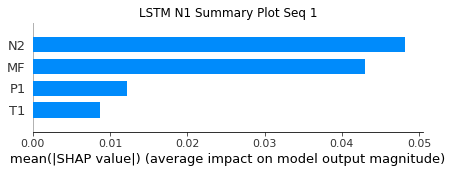

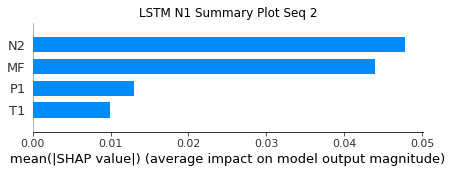

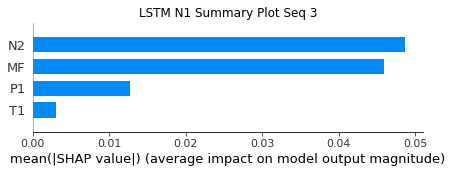

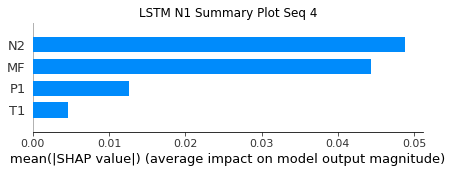

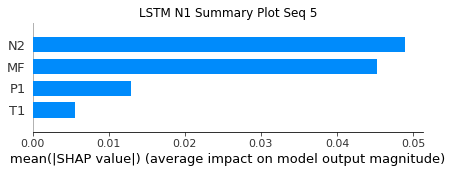

...

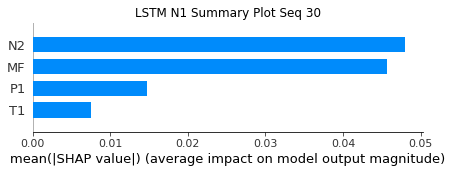

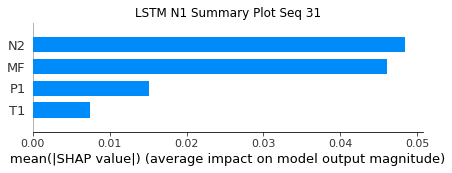

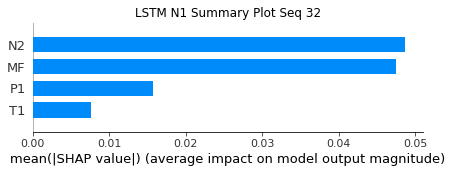

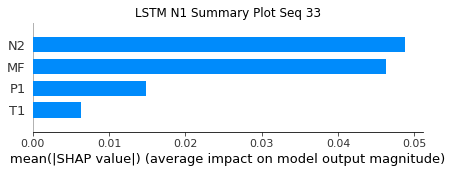

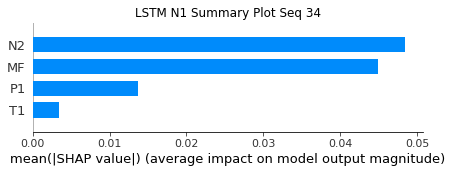

In [32]:
#SHAP Summmary Plot

instance = x_train
instance2 = x_test
explainer = shap.DeepExplainer(model2,instance)
shap_values = explainer.shap_values(instance2)
for i in range(34):
    shap.summary_plot(shap_values[0][i],feature_names=xtrain.columns,show=False,plot_size=(7, 2),plot_type="bar")
    plt.title("LSTM N1 Summary Plot Seq %i" %(i+1),fontsize=12)
    plt.savefig("Sum_Plot %i" %i+'.tiff')
    plt.figure
    plt.show()

Contribution: [0.20236826 0.1317225  0.84708949 0.74862935]


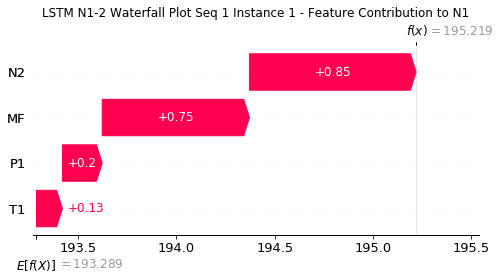

None

Contribution: [0.01427171 0.01206786 0.04646156 0.04323007]


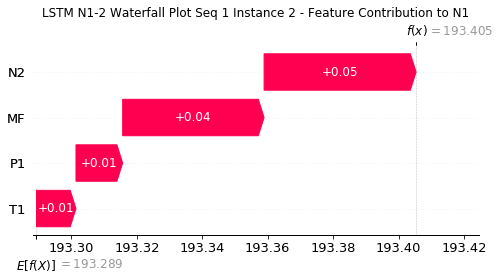

None

Contribution: [0.00245943 0.0023411  0.00848945 0.00743963]


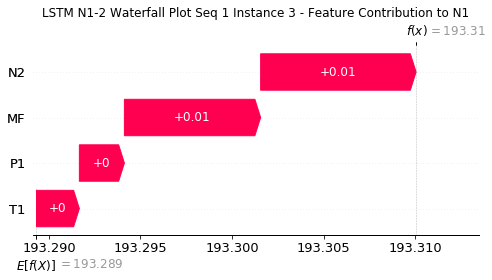

None

Contribution: [0.0012896  0.00116731 0.0043935  0.00393013]


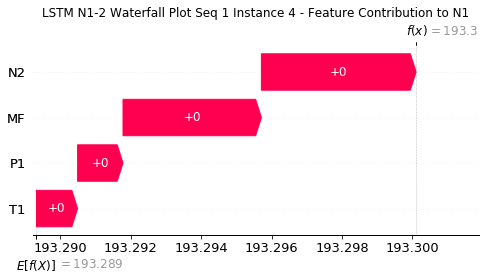

None

Contribution: [0.00107173 0.00095274 0.00357774 0.00322379]


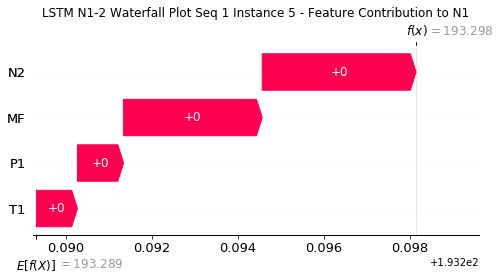

None

Contribution: [0.00091251 0.00082791 0.00305401 0.00276169]


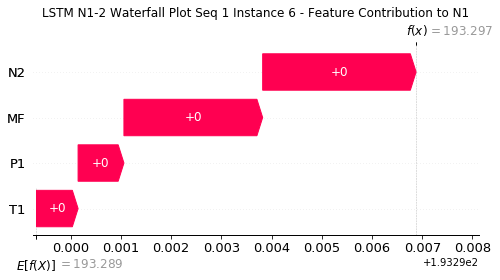

None

Contribution: [0.00088237 0.00079475 0.00292177 0.00265582]


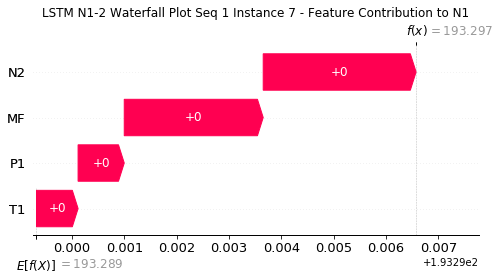

None

Contribution: [0.00085386 0.00080025 0.00286782 0.00258063]


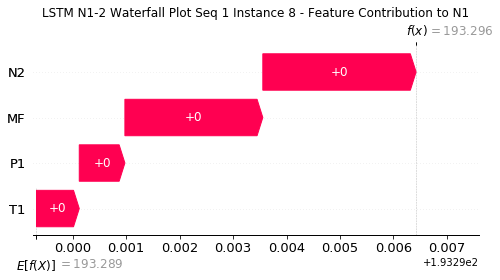

None

Contribution: [0.00085502 0.00078217 0.00285003 0.00259494]


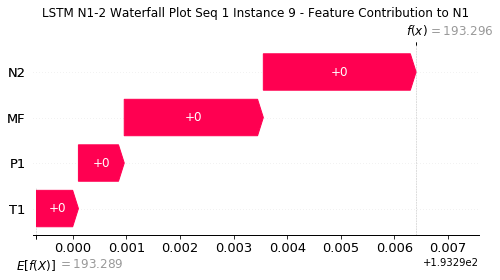

None

Contribution: [0.00084376 0.00075518 0.00282102 0.00255446]


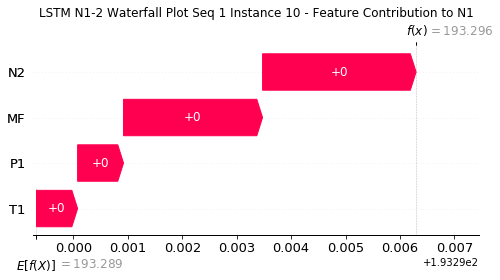

None

Contribution: [0.00084908 0.00075673 0.00283043 0.00256367]


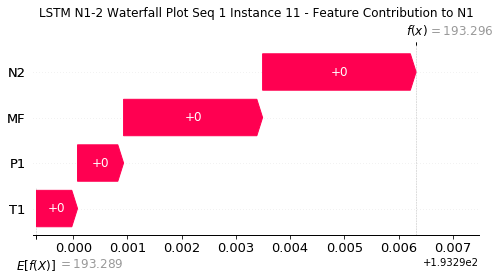

None

Contribution: [0.00086927 0.00075315 0.00285933 0.00258744]


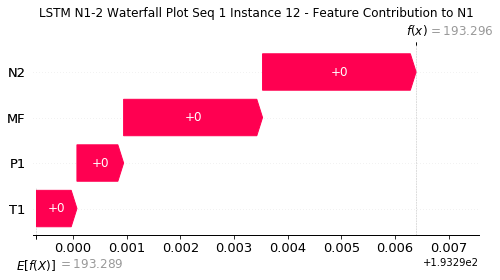

None

Contribution: [0.00087866 0.00078073 0.0029213  0.00265027]


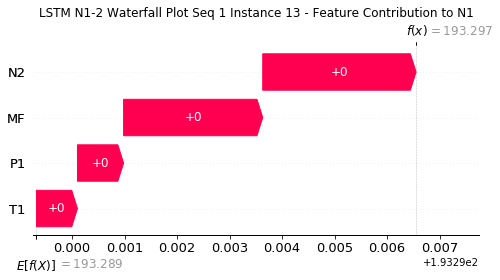

None

Contribution: [0.00089215 0.00080333 0.00301926 0.00272071]


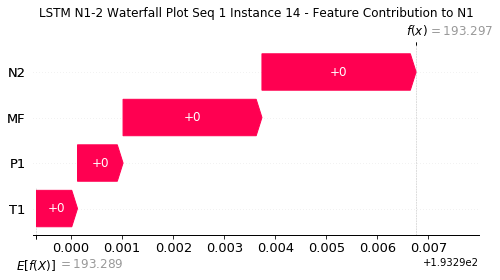

None

Contribution: [0.00096936 0.00085834 0.00320834 0.00291762]


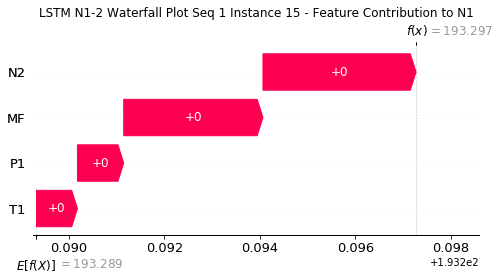

None

Contribution: [0.00105896 0.00093957 0.00349957 0.003187  ]


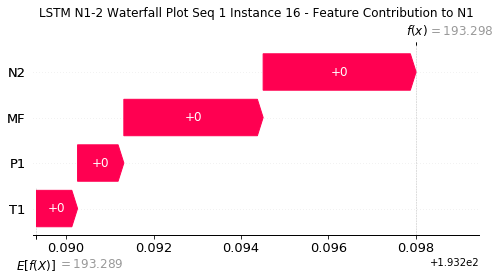

None

Contribution: [0.0012001  0.00108754 0.00400329 0.00366543]


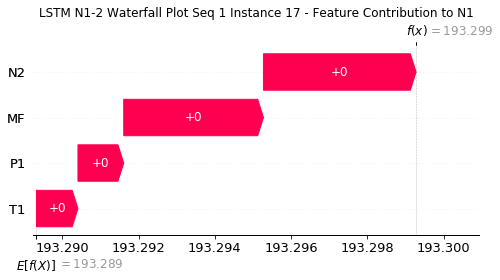

None

Contribution: [0.00148456 0.00131344 0.00486716 0.00444552]


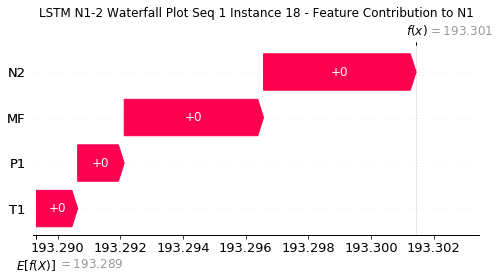

None

Contribution: [0.00197989 0.00174917 0.00647767 0.0059242 ]


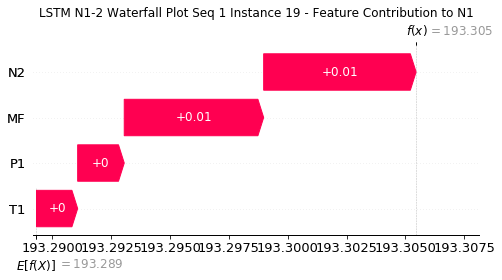

None

Contribution: [0.0029418  0.00259801 0.00960552 0.00879673]


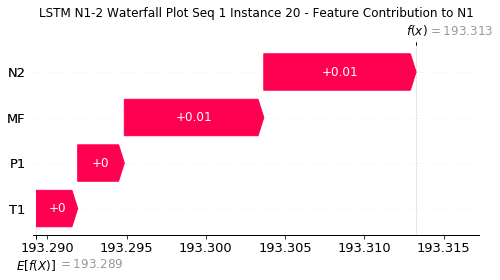

None

Contribution: [0.00485312 0.00430784 0.01586571 0.01456013]


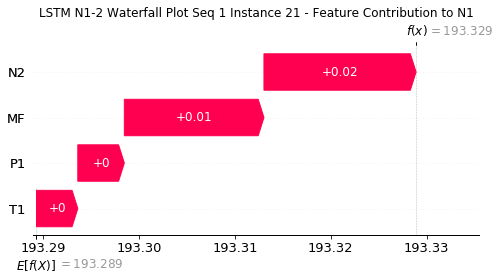

None

Contribution: [0.00867007 0.00775788 0.02838502 0.02614324]


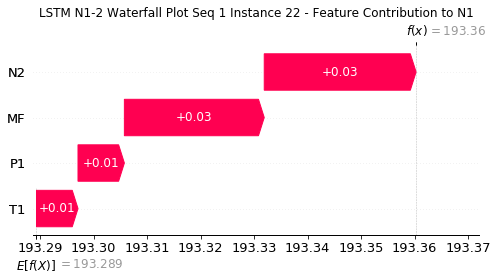

None

Contribution: [0.01555415 0.01441521 0.05141091 0.04746746]


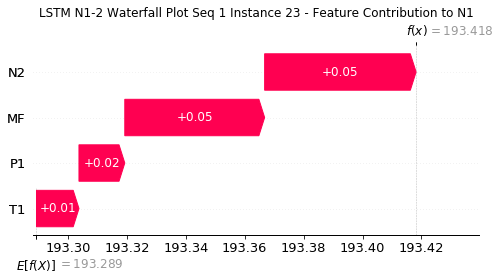

None

Contribution: [0.02533227 0.01966259 0.09171479 0.08357319]


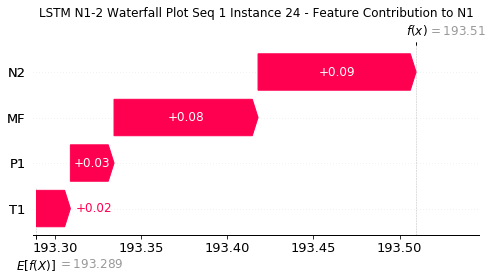

None

Contribution: [0.2238356  0.16757222 0.84000414 0.76871778]


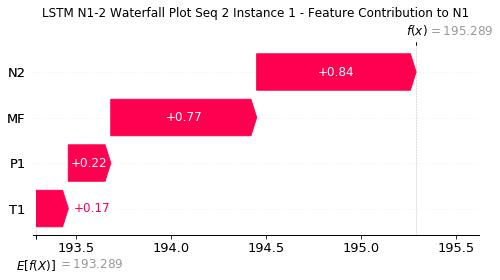

None

Contribution: [0.01433585 0.01289081 0.04558941 0.04311169]


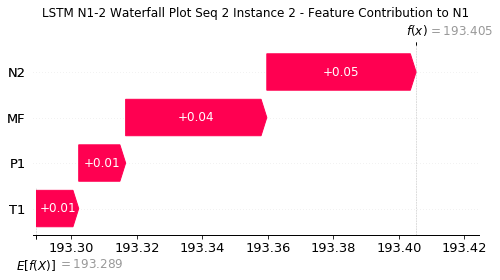

None

Contribution: [0.00248729 0.0024628  0.00839868 0.00745901]


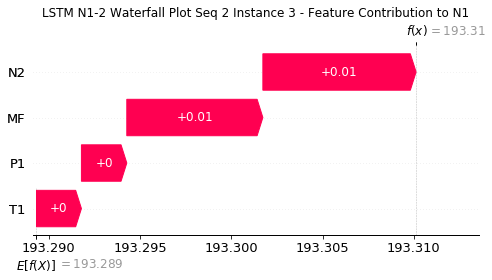

None

Contribution: [0.00132532 0.00126527 0.00441209 0.0039915 ]


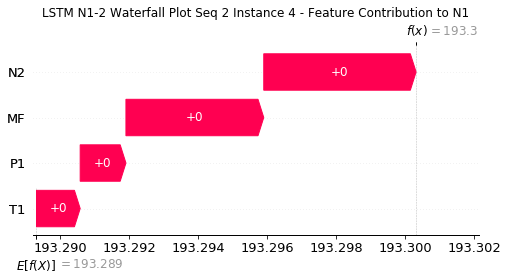

None

Contribution: [0.00108741 0.00101711 0.00356157 0.0032508 ]


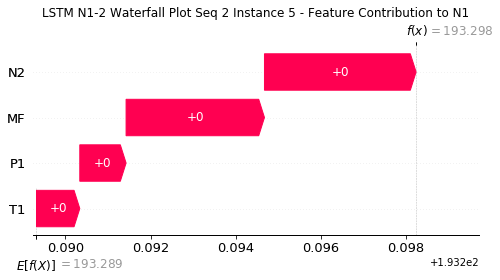

None

Contribution: [0.00092969 0.00088145 0.00305227 0.00278787]


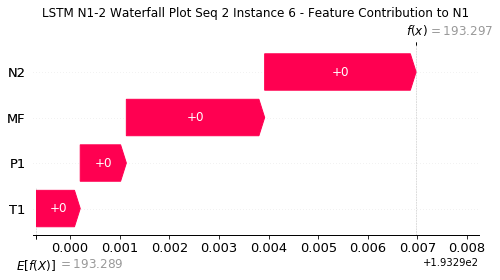

None

Contribution: [0.00088554 0.0008193  0.00290202 0.00265979]


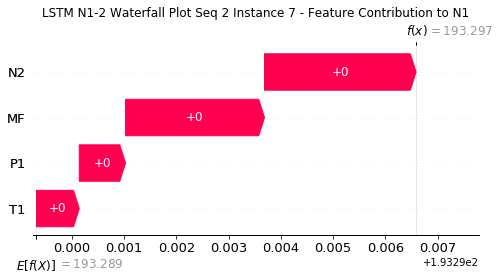

None

Contribution: [0.00086458 0.00080552 0.00284785 0.00258791]


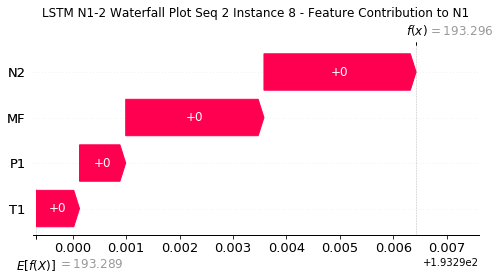

None

Contribution: [0.00086918 0.00078582 0.00282608 0.0025807 ]


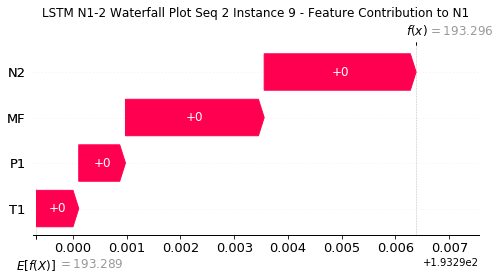

None

Contribution: [0.00085427 0.000809   0.00281269 0.00256788]


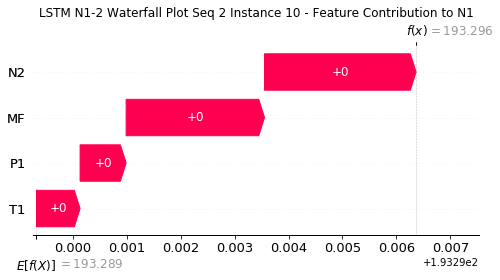

None

Contribution: [0.0008569  0.00081318 0.00282259 0.00257946]


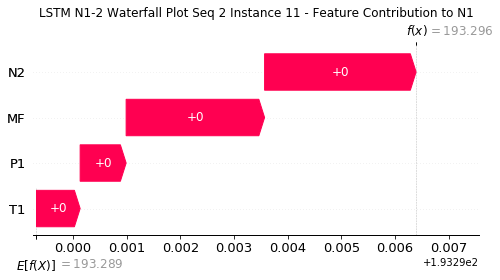

None

Contribution: [0.00087014 0.00079031 0.00284808 0.00260814]


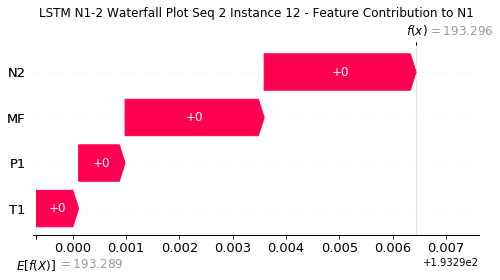

None

Contribution: [0.00088545 0.00082663 0.00291078 0.00266199]


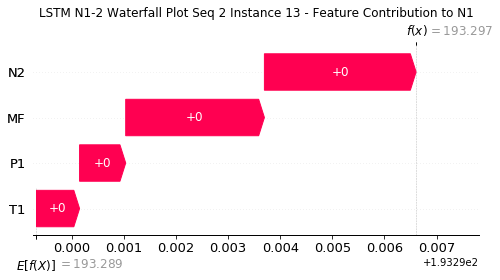

None

Contribution: [0.00090142 0.00085627 0.00301462 0.00276044]


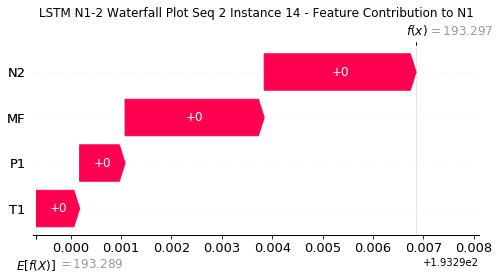

None

Contribution: [0.00097167 0.00091128 0.00319461 0.00292359]


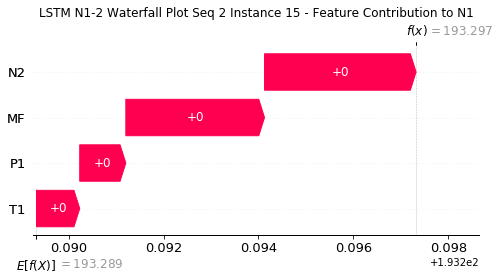

None

Contribution: [0.00106168 0.00100203 0.0034831  0.00318801]


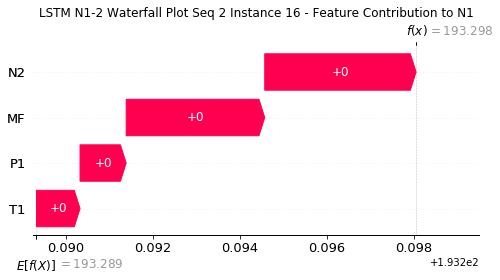

None

Contribution: [0.00119302 0.0011167  0.00396962 0.00359048]


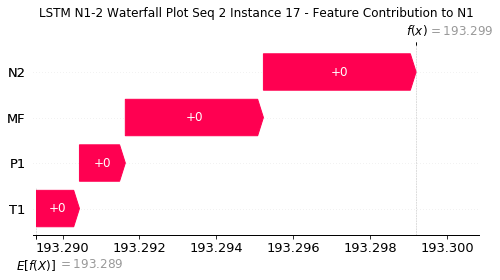

None

Contribution: [0.0014829  0.00137136 0.00484441 0.00445208]


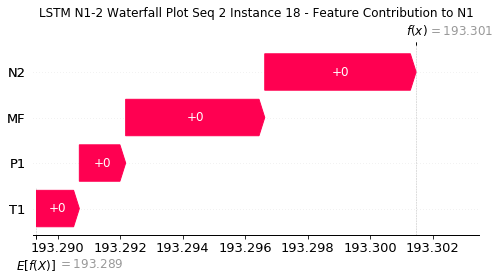

None

Contribution: [0.00197931 0.00182527 0.00644662 0.00593258]


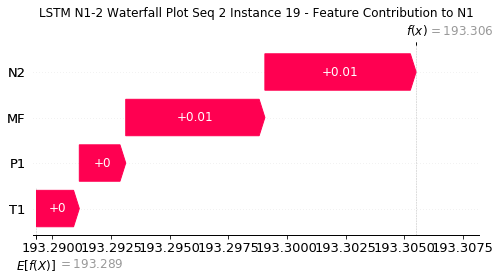

None

Contribution: [0.00294397 0.00266528 0.00956211 0.00881621]


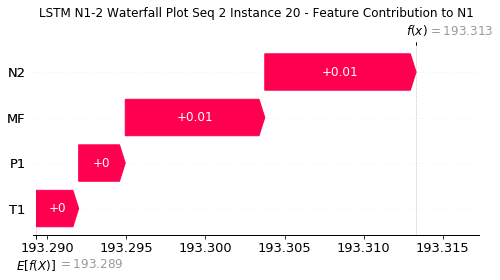

None

Contribution: [0.00486306 0.00445522 0.01578589 0.01454431]


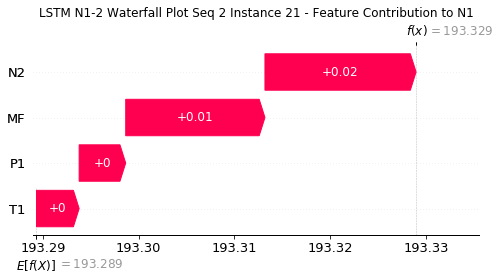

None

Contribution: [0.00870372 0.00817194 0.02822747 0.02596737]


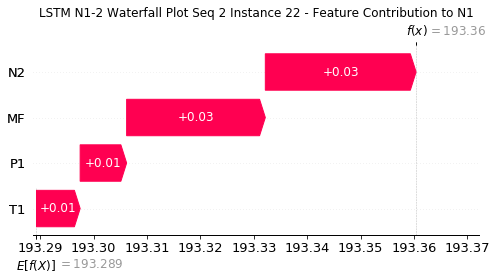

None

Contribution: [0.0153164  0.0142078  0.05106544 0.04668155]


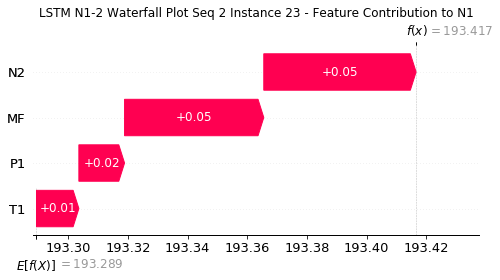

None

Contribution: [0.02403428 0.00887673 0.0915557  0.08680717]


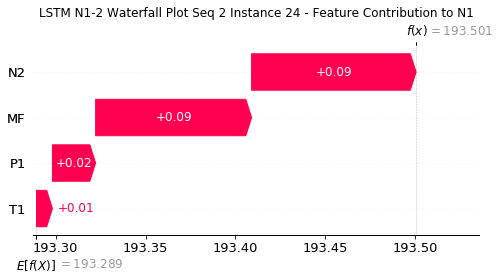

None

Contribution: [0.21414292 0.02344971 0.85739133 0.81796405]


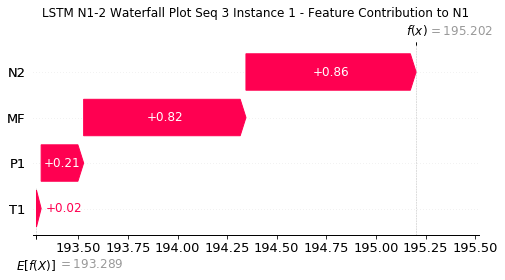

None

Contribution: [0.01463495 0.01069512 0.04724729 0.04477162]


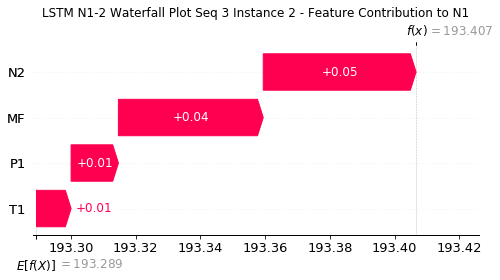

None

Contribution: [0.0025218  0.00192158 0.00862224 0.00763629]


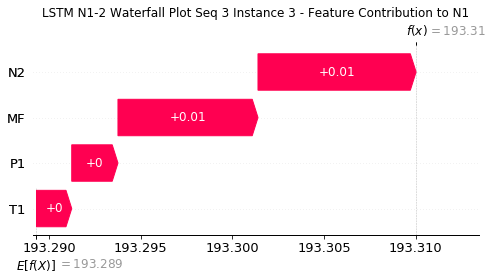

None

Contribution: [0.00130473 0.00090172 0.00440357 0.00397787]


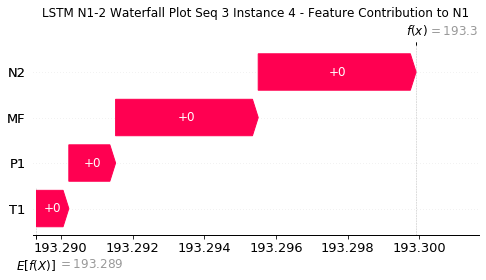

None

Contribution: [0.00108205 0.00076441 0.0036081  0.00327847]


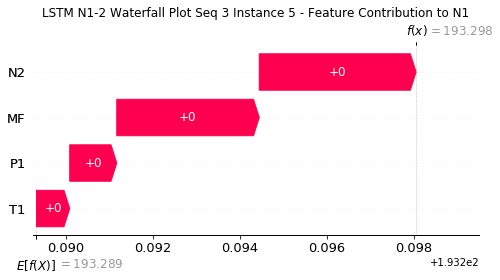

None

Contribution: [0.00092274 0.00065588 0.0030733  0.00279988]


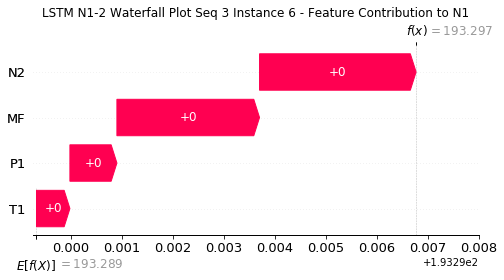

None

Contribution: [0.00086729 0.00061218 0.00291741 0.00266278]


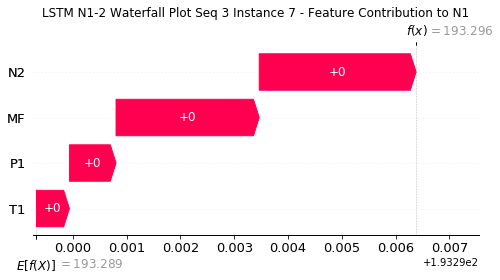

None

Contribution: [0.00086989 0.0005571  0.0028623  0.00259157]


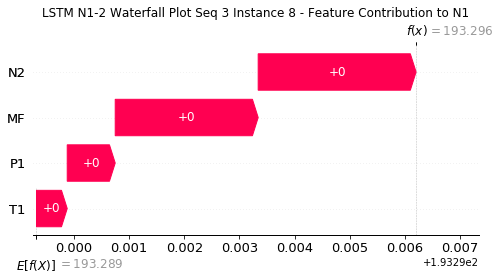

None

Contribution: [0.00085002 0.00057274 0.00284265 0.00258431]


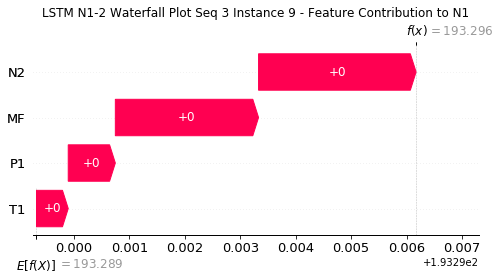

None

Contribution: [0.00084872 0.0005854  0.00283436 0.00257891]


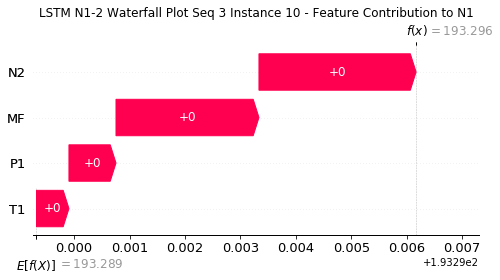

None

Contribution: [0.00085156 0.00059094 0.00284426 0.00259058]


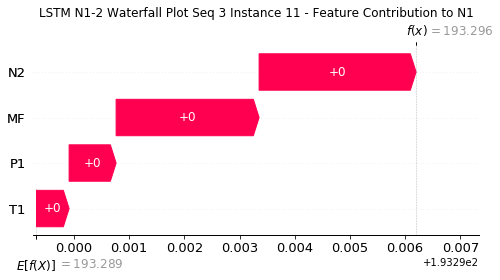

None

Contribution: [0.00086304 0.00058222 0.00286585 0.00260076]


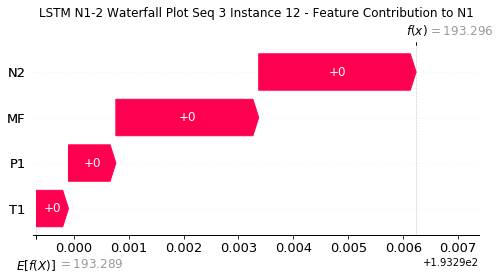

None

Contribution: [0.00087898 0.00060661 0.00293596 0.00267295]


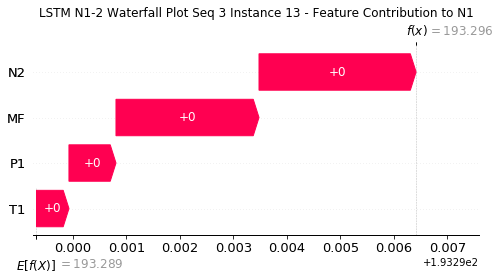

None

Contribution: [0.00091469 0.00063628 0.0030407  0.00276434]


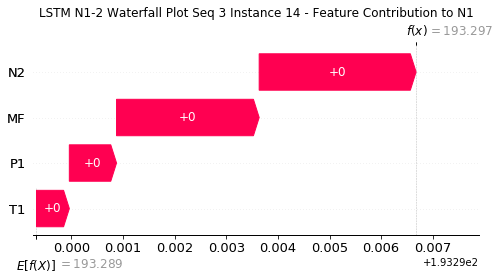

None

Contribution: [0.00096584 0.00066536 0.0032278  0.00294304]


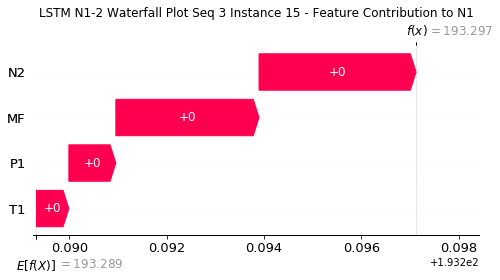

None

Contribution: [0.00105742 0.00072175 0.00352399 0.00321581]


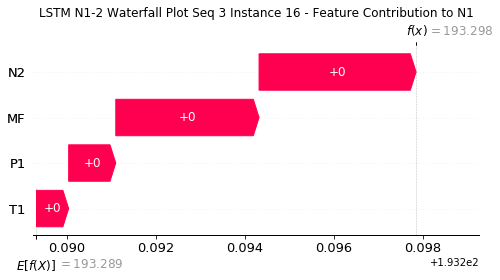

None

Contribution: [0.00121746 0.0008403  0.00402621 0.00367198]


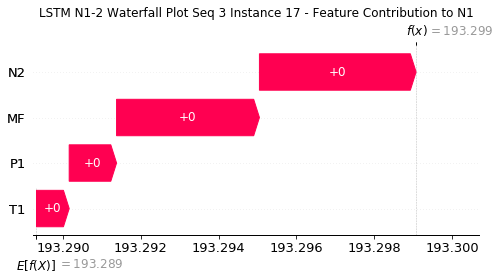

None

Contribution: [0.00147785 0.00103282 0.00491415 0.00449736]


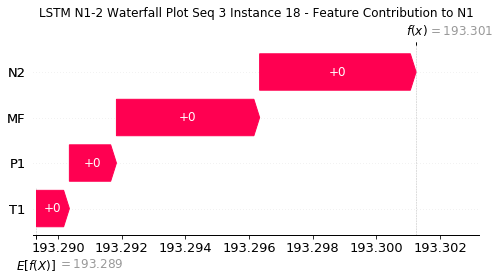

None

Contribution: [0.0019744  0.00137023 0.00654688 0.00599648]


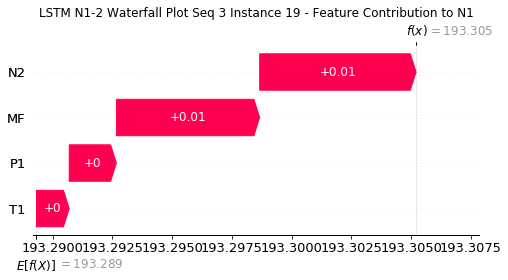

None

Contribution: [0.00293203 0.00204324 0.00970656 0.00889323]


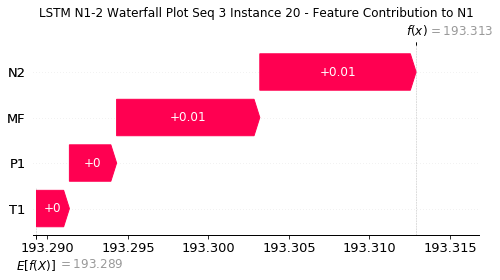

None

Contribution: [0.00484281 0.00332464 0.01601159 0.01467369]


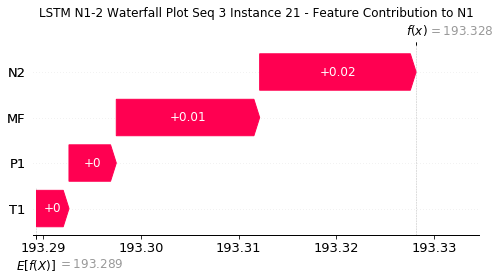

None

Contribution: [0.00865471 0.00597491 0.02857175 0.02623407]


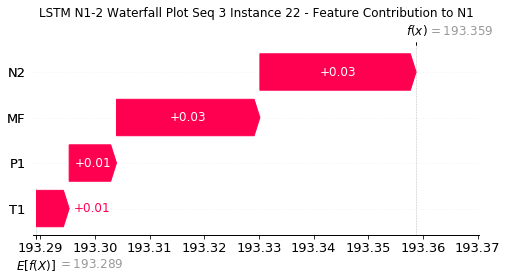

None

Contribution: [0.01556234 0.00981874 0.05152212 0.04728354]


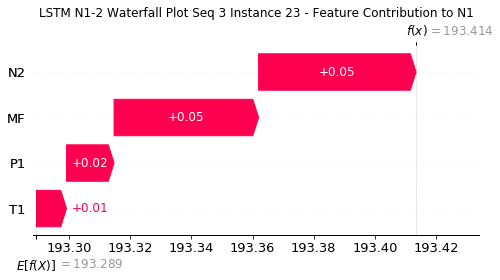

None

Contribution: [ 0.02394719 -0.00458736  0.09097839  0.08293025]


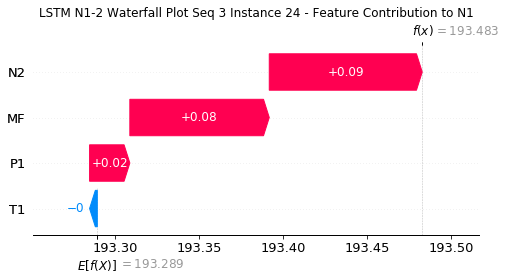

None

Contribution: [ 0.21071205 -0.06220992  0.85855913  0.77901583]


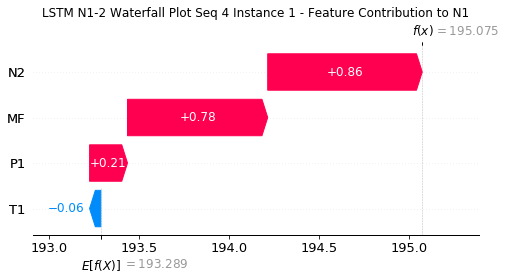

None

Contribution: [0.01492848 0.00974188 0.04846962 0.04554476]


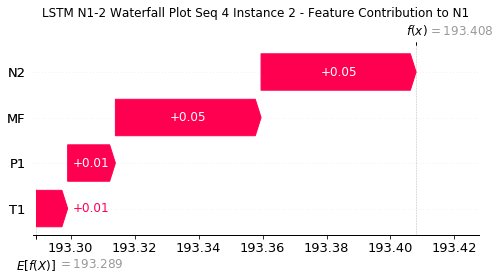

None

Contribution: [0.00256225 0.00193933 0.00873666 0.007676  ]


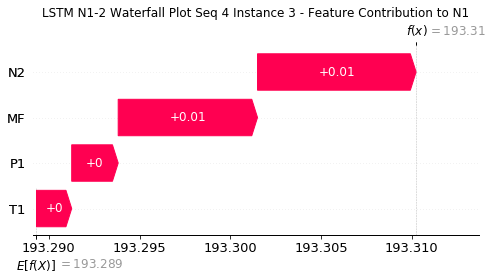

None

Contribution: [0.00129781 0.00089417 0.00437687 0.00392848]


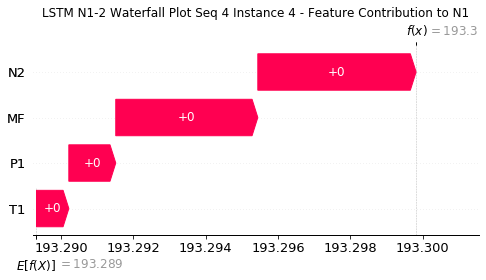

None

Contribution: [0.00108796 0.00081525 0.00360081 0.00325775]


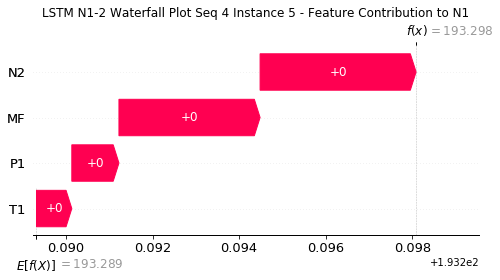

None

Contribution: [0.00092387 0.00065694 0.00306941 0.00278066]


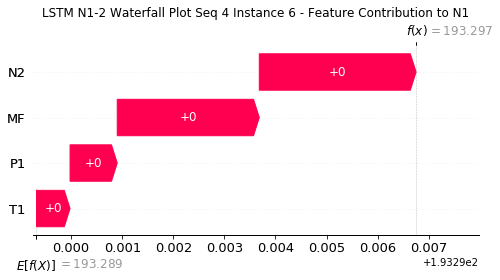

None

Contribution: [0.00088936 0.00060809 0.00292493 0.00264957]


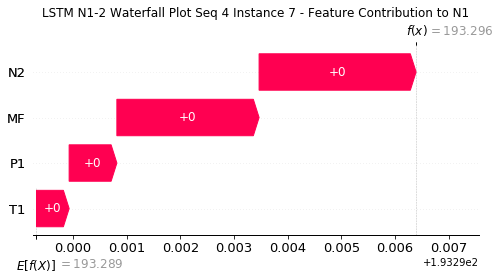

None

Contribution: [0.00086816 0.00058537 0.00287491 0.00259581]


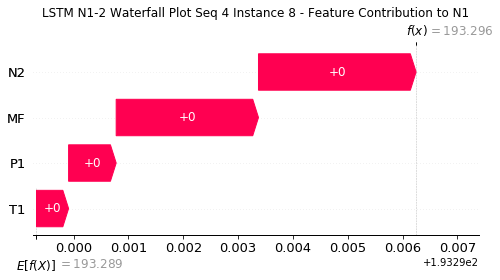

None

Contribution: [0.00085327 0.00059492 0.002853   0.00258702]


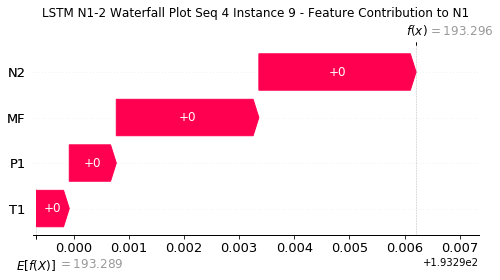

None

Contribution: [0.00085348 0.0005874  0.00283944 0.00258363]


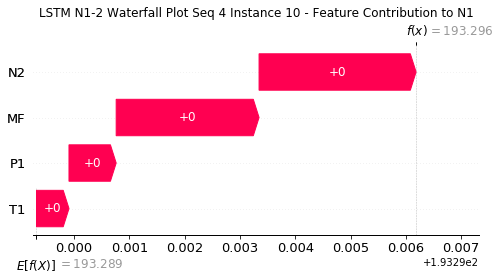

None

Contribution: [0.00085929 0.0005852  0.00284837 0.00259141]


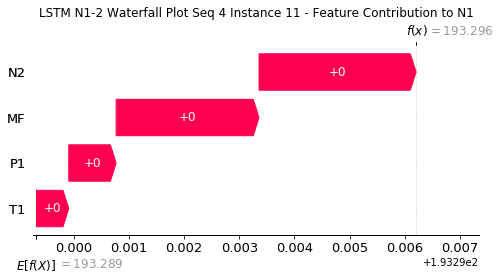

None

Contribution: [0.00083988 0.00055803 0.00286593 0.00259333]


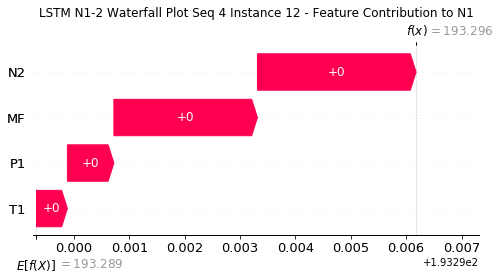

None

Contribution: [0.00088545 0.00059664 0.00294137 0.00267782]


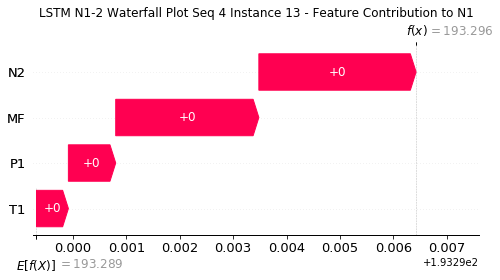

None

Contribution: [0.00092518 0.00060018 0.00305157 0.00277277]


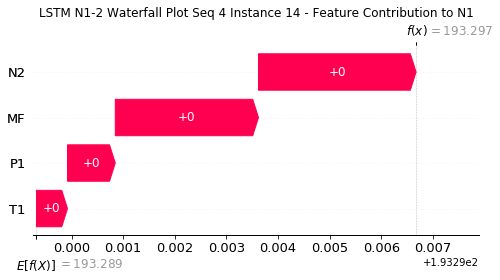

None

Contribution: [0.00097731 0.00064707 0.00323656 0.0029507 ]


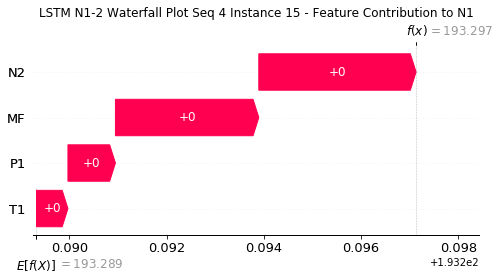

None

Contribution: [0.00106691 0.0007066  0.00353575 0.00322467]


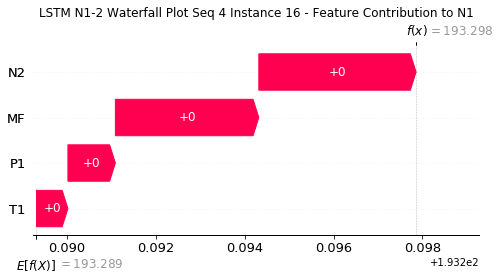

None

Contribution: [0.00123747 0.00081924 0.00404518 0.00368527]


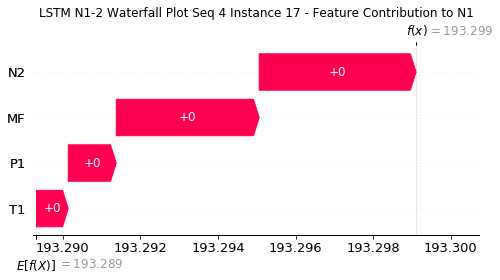

None

Contribution: [0.00149774 0.00098996 0.00493176 0.00449774]


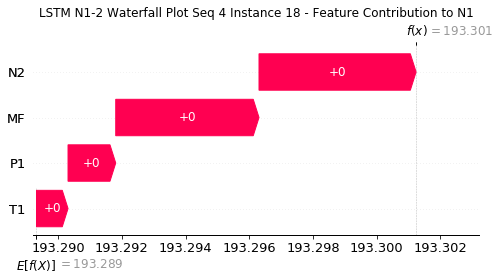

None

Contribution: [0.00199614 0.00132527 0.00657532 0.006004  ]


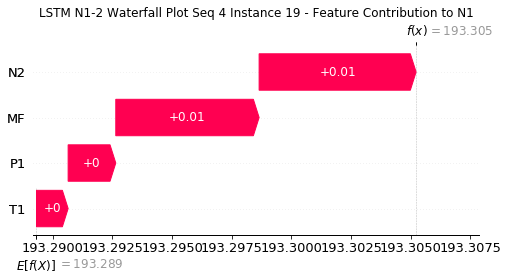

None

Contribution: [0.00295885 0.00197272 0.00975085 0.00891129]


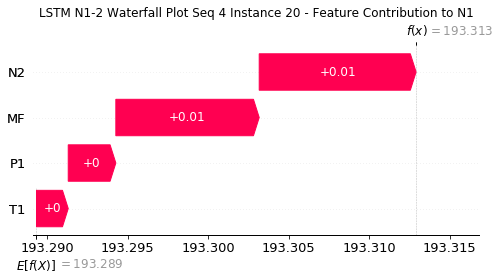

None

Contribution: [0.00486558 0.00325509 0.01609065 0.0147393 ]


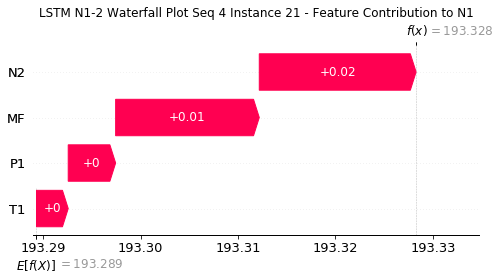

None

Contribution: [0.00866579 0.00586991 0.02866861 0.0262678 ]


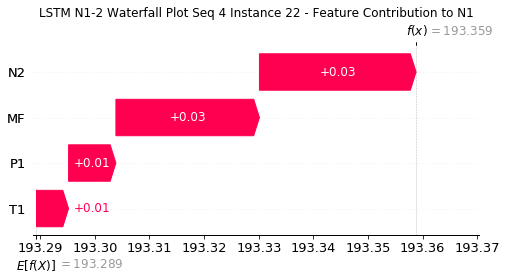

None

Contribution: [0.01567365 0.01036223 0.05161994 0.04743558]


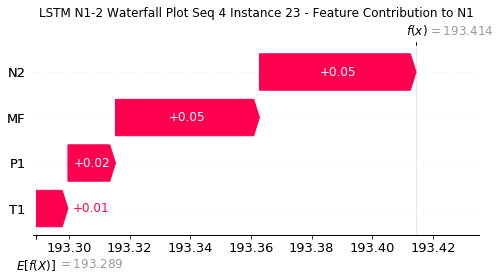

None

Contribution: [ 0.02462782 -0.00439459  0.09165584  0.08467724]


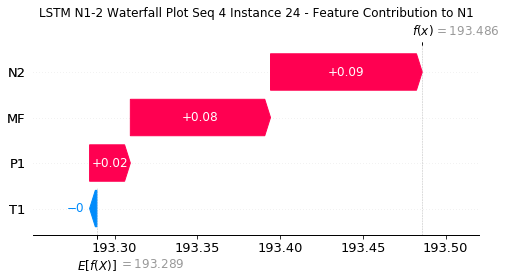

None

Contribution: [ 0.22012089 -0.08752334  0.8621664   0.79657492]


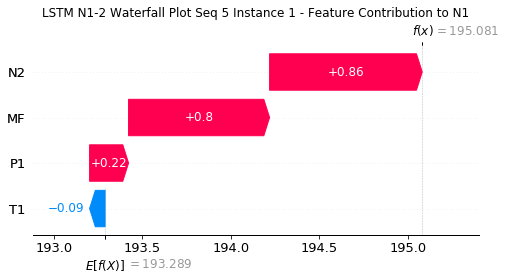

None

Contribution: [0.01508802 0.0088763  0.04848025 0.04576117]


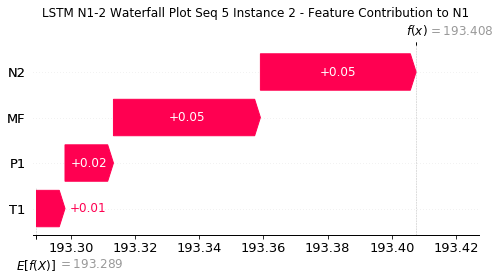

None

Contribution: [0.00256081 0.001751   0.00875736 0.00777086]


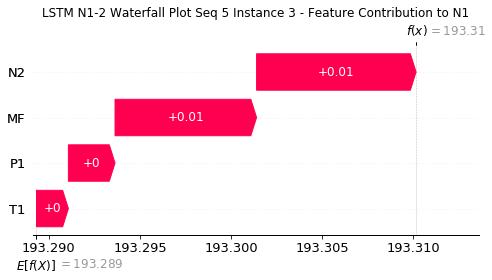

None

Contribution: [0.00129899 0.0008014  0.00438166 0.003974  ]


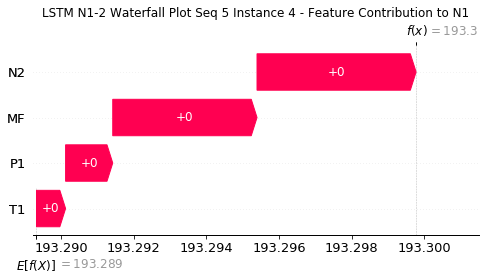

None

Contribution: [0.00109271 0.0006868  0.00359535 0.00328138]


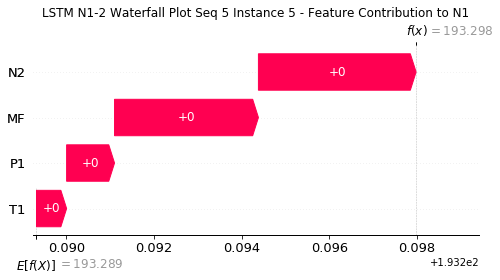

None

Contribution: [0.00092335 0.00059959 0.00307165 0.00280603]


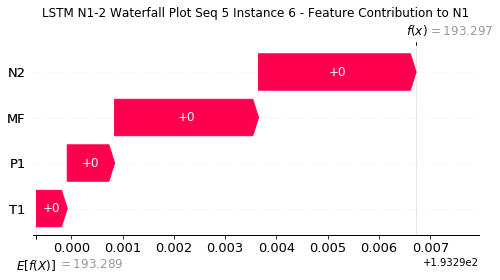

None

Contribution: [0.00088298 0.00056107 0.00292488 0.00265998]


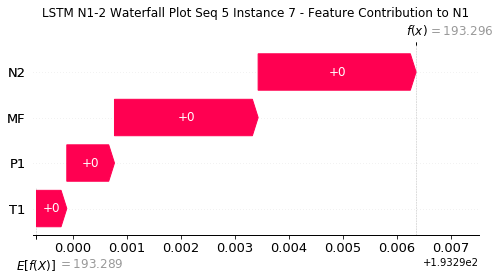

None

Contribution: [0.00085152 0.00054887 0.00286778 0.00258864]


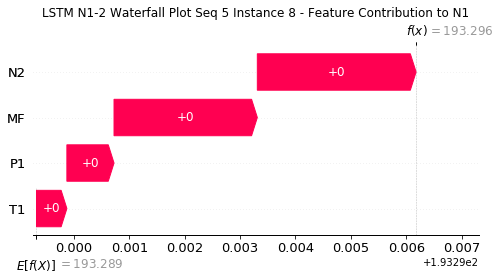

None

Contribution: [0.00085901 0.00056352 0.00285846 0.00261887]


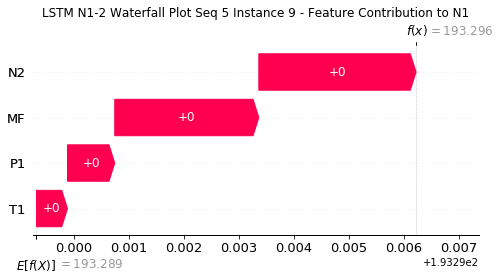

None

Contribution: [0.00085859 0.00055738 0.00284275 0.00260397]


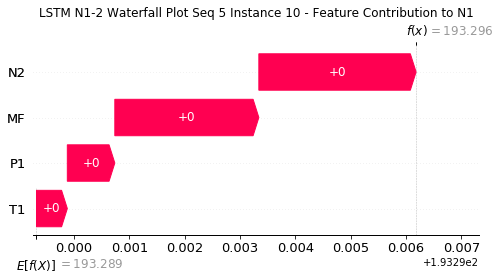

None

Contribution: [0.00086176 0.00055432 0.00285163 0.00260856]


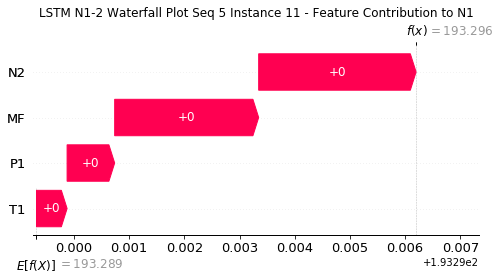

None

Contribution: [0.00085584 0.00056772 0.00287849 0.00262917]


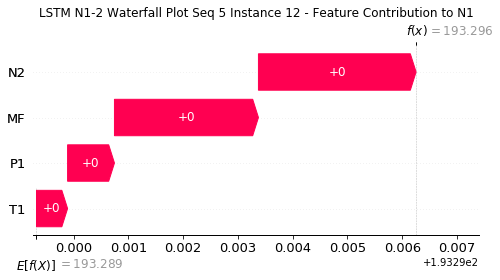

None

Contribution: [0.00089047 0.00057547 0.00294639 0.00269931]


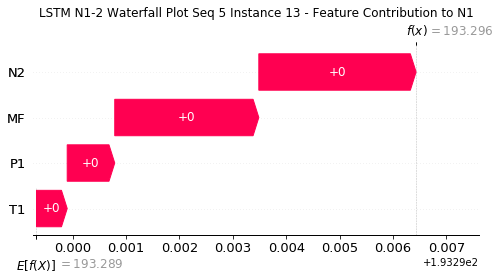

None

Contribution: [0.00092849 0.00059958 0.00304853 0.00275693]


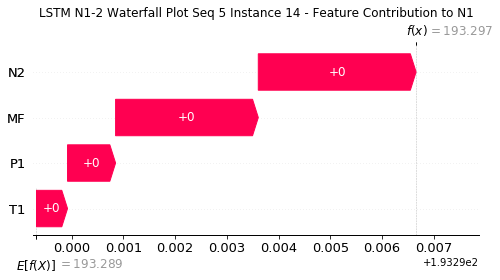

None

Contribution: [0.00098104 0.000626   0.00324094 0.00296903]


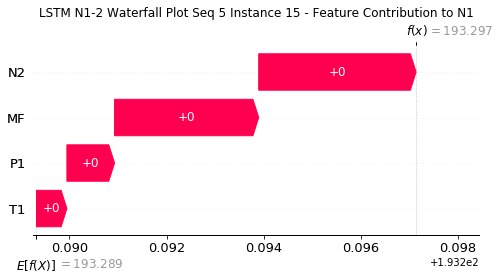

None

Contribution: [0.00106841 0.00068023 0.00353862 0.00324258]


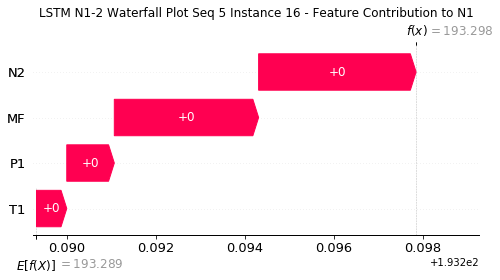

None

Contribution: [0.00120888 0.00076968 0.00404057 0.00370369]


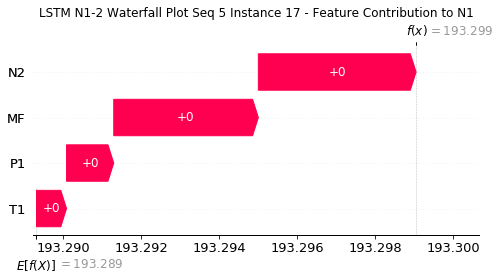

None

Contribution: [0.00148892 0.00094862 0.00493432 0.00452108]


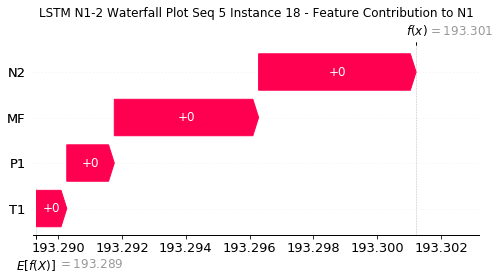

None

Contribution: [0.00198462 0.00127304 0.00657778 0.00603444]


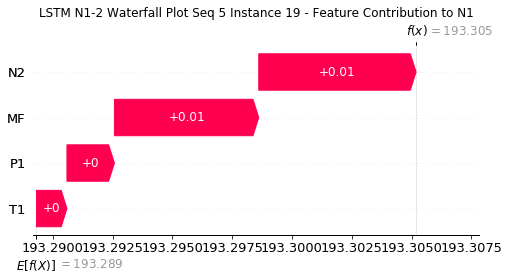

None

Contribution: [0.0029423  0.00192127 0.00975622 0.00896731]


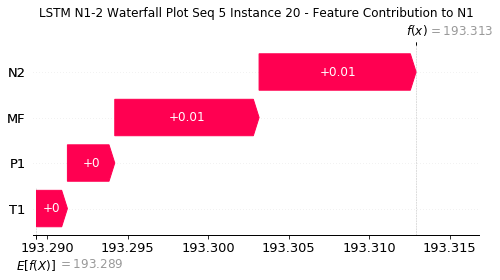

None

Contribution: [0.00485466 0.00319584 0.01609509 0.01483011]


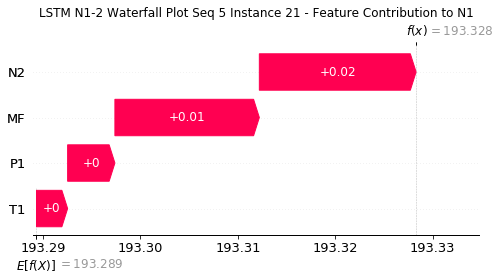

None

Contribution: [0.00863154 0.00577421 0.02867742 0.02645219]


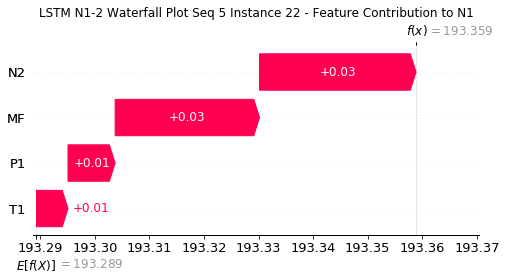

None

Contribution: [0.01535199 0.01036544 0.05159386 0.04757973]


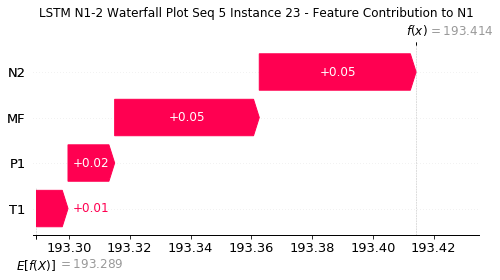

None

Contribution: [ 0.02311906 -0.00470209  0.09158023  0.08577645]


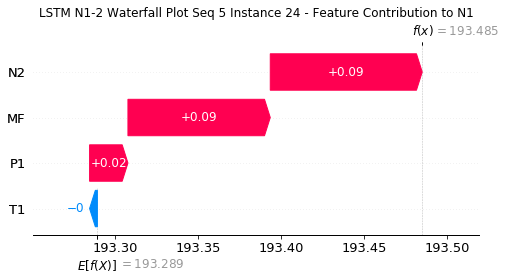

None

Contribution: [ 0.20888482 -0.06402797  0.85919986  0.8160276 ]


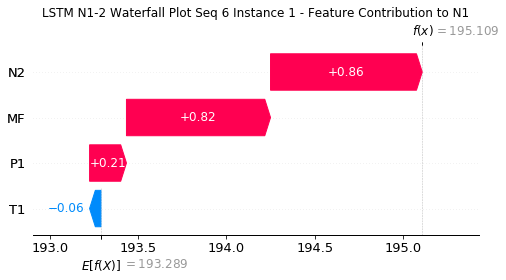

None

Contribution: [0.01492191 0.00921852 0.04805324 0.04595432]


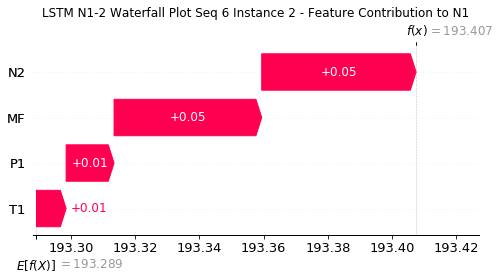

None

Contribution: [0.00252785 0.00186645 0.00868145 0.00768262]


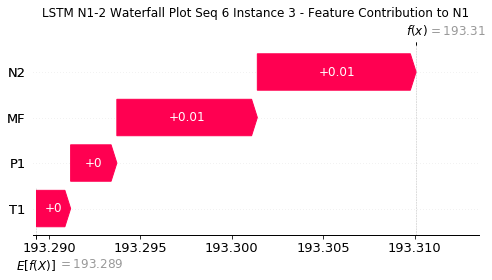

None

Contribution: [0.00129224 0.0008627  0.00436946 0.00395309]


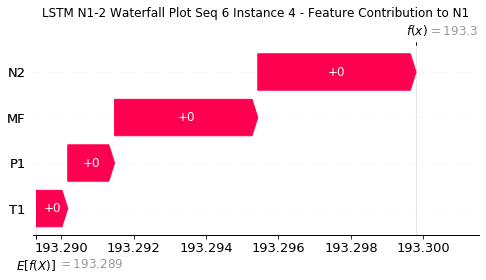

None

Contribution: [0.00105703 0.00074213 0.00357648 0.00324809]


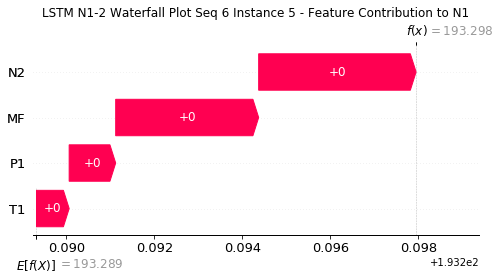

None

Contribution: [0.0009183  0.00063915 0.00306046 0.00279079]


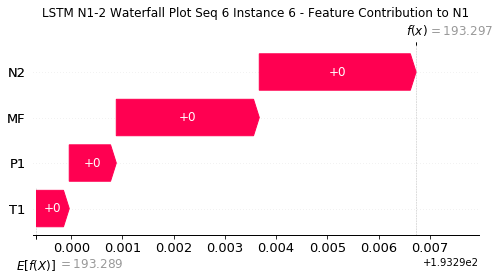

None

Contribution: [0.00086983 0.0005944  0.00290999 0.00263432]


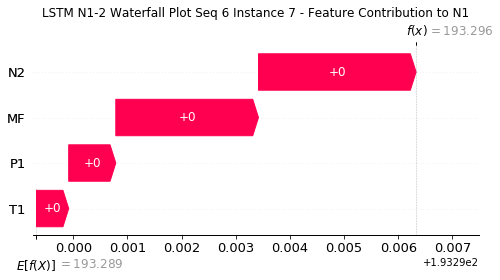

None

Contribution: [0.00084426 0.00059895 0.002871   0.00261855]


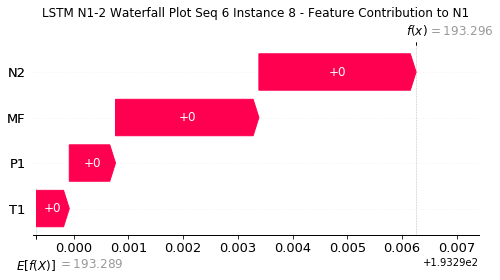

None

Contribution: [0.00085449 0.00058197 0.00285054 0.00259831]


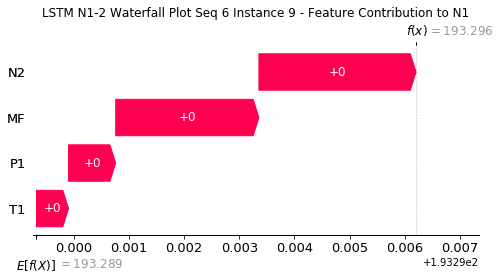

None

Contribution: [0.00085076 0.00058061 0.00283588 0.00260205]


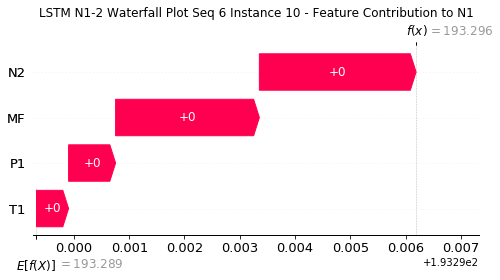

None

Contribution: [0.00085444 0.00058219 0.0028444  0.00260644]


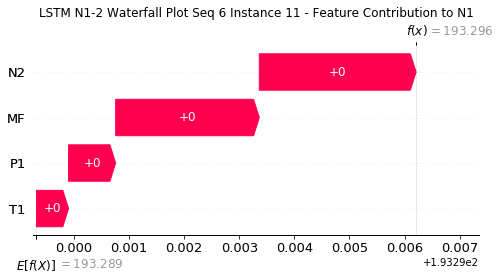

None

Contribution: [0.00087881 0.00058968 0.002874   0.0026407 ]


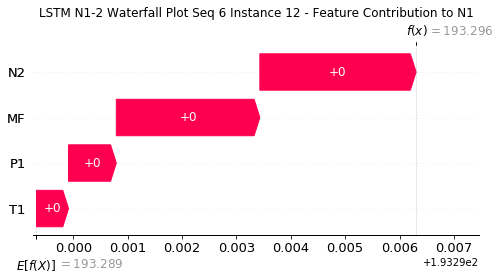

None

Contribution: [0.00088387 0.0006017  0.00293926 0.0026955 ]


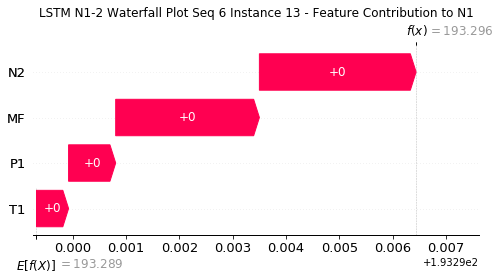

None

Contribution: [0.00091892 0.00060969 0.00303324 0.0027693 ]


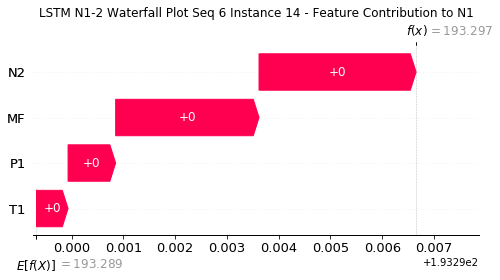

None

Contribution: [0.00097462 0.00065737 0.00323128 0.00296042]


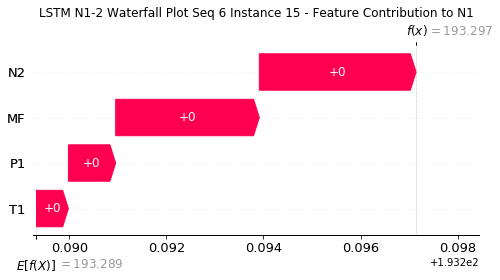

None

Contribution: [0.00106992 0.00072108 0.00352985 0.00323591]


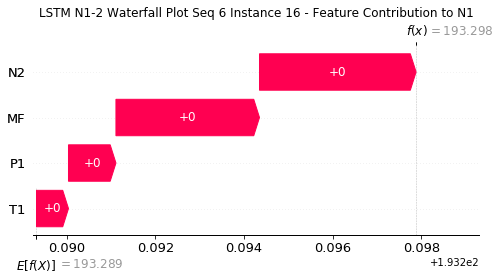

None

Contribution: [0.00121256 0.00084679 0.00403267 0.00368744]


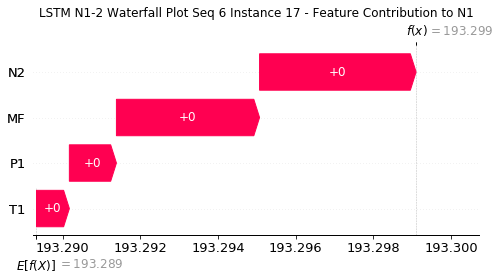

None

Contribution: [0.00149351 0.00102779 0.00491677 0.00449539]


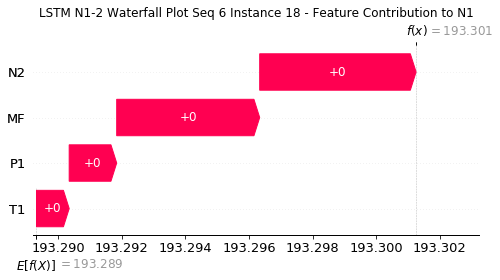

None

Contribution: [0.00199851 0.00137984 0.00655542 0.00600635]


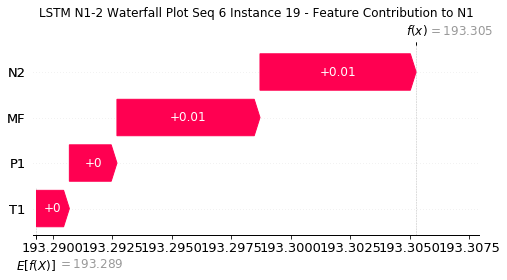

None

Contribution: [0.00296439 0.00207868 0.00972698 0.00892984]


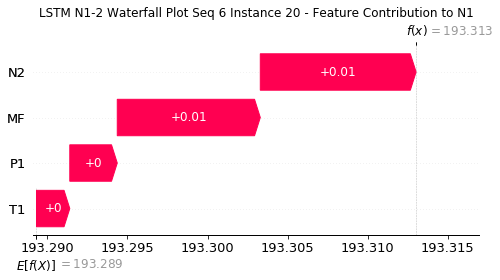

None

Contribution: [0.00490865 0.00342534 0.01606314 0.01479926]


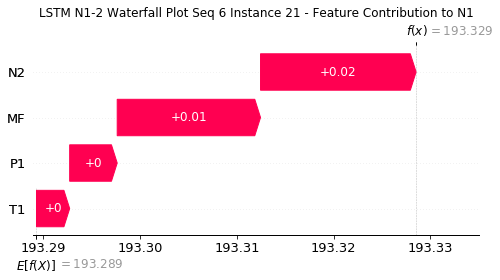

None

Contribution: [0.00872621 0.00619557 0.02864062 0.0263476 ]


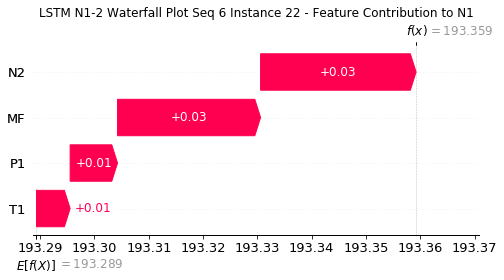

None

Contribution: [0.01548631 0.01093236 0.05160366 0.04711207]


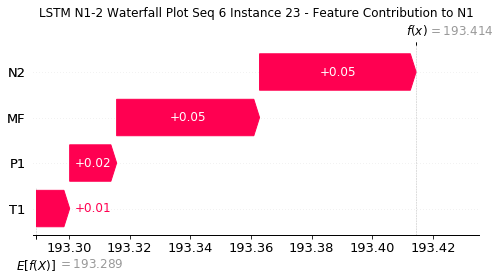

None

Contribution: [ 0.02485058 -0.00016958  0.0920334   0.0850921 ]


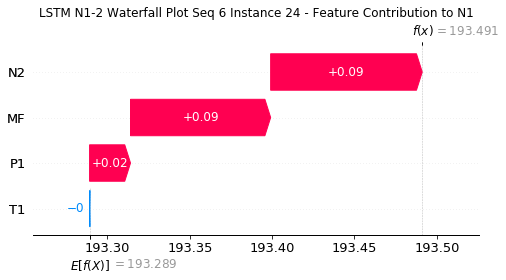

None

Contribution: [ 0.21429946 -0.02975818  0.86486831  0.7952781 ]


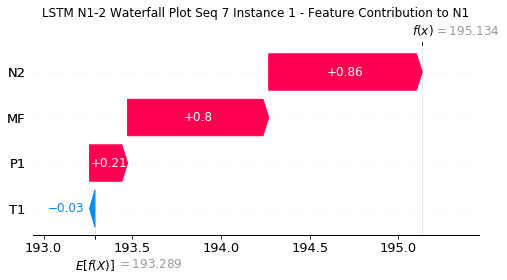

None

Contribution: [0.01489589 0.00952102 0.04811495 0.0450078 ]


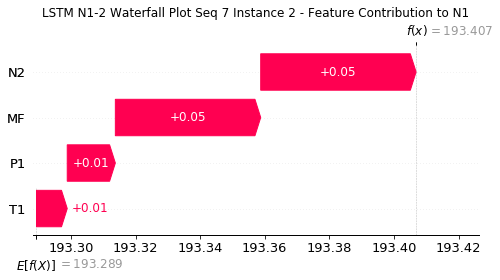

None

Contribution: [0.00255555 0.00181304 0.00871913 0.00768137]


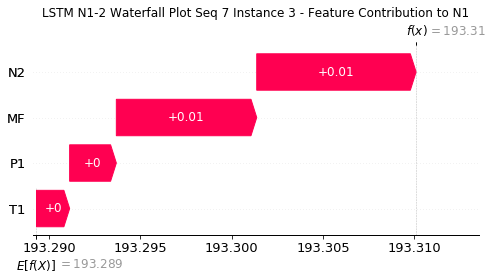

None

Contribution: [0.00130546 0.00082596 0.00439377 0.00394926]


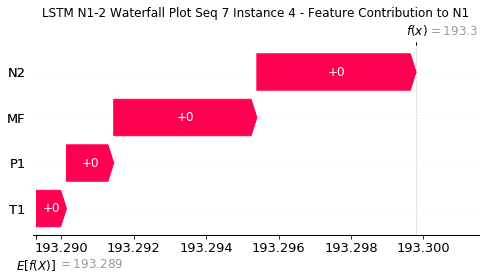

None

Contribution: [0.00107797 0.00073136 0.00360653 0.00328093]


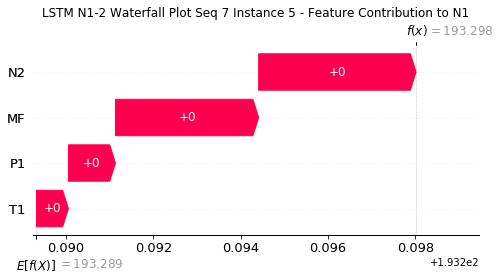

None

Contribution: [0.00092609 0.00060694 0.00307611 0.00279009]


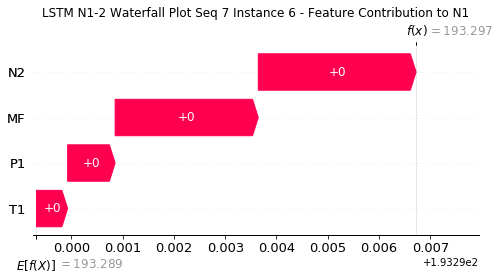

None

Contribution: [0.00087485 0.00053783 0.00291035 0.00264379]


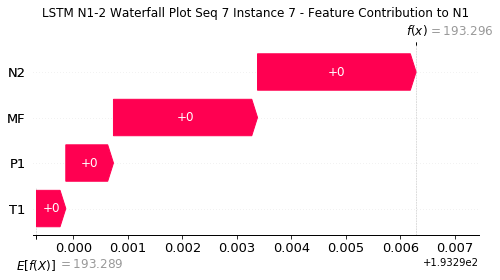

None

Contribution: [0.00087095 0.00057283 0.0028724  0.00260361]


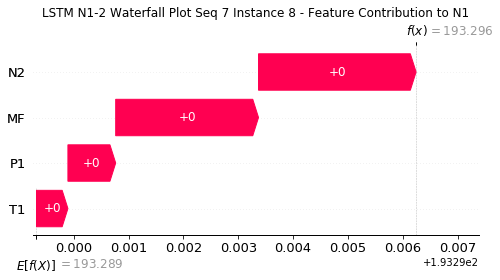

None

Contribution: [0.00085684 0.00055581 0.00284648 0.00258914]


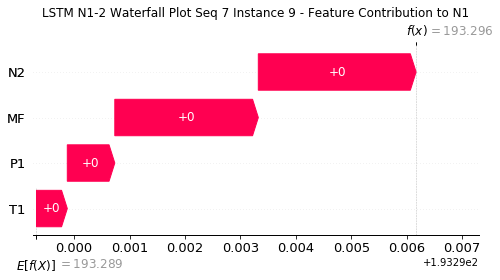

None

Contribution: [0.00085617 0.00052857 0.00284442 0.0025851 ]


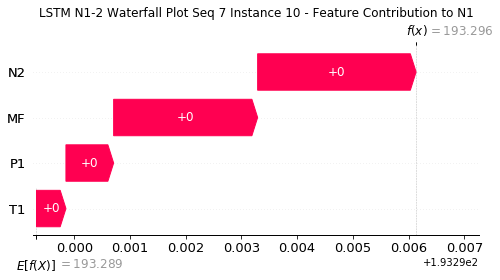

None

Contribution: [0.00085884 0.00052063 0.00285296 0.00259171]


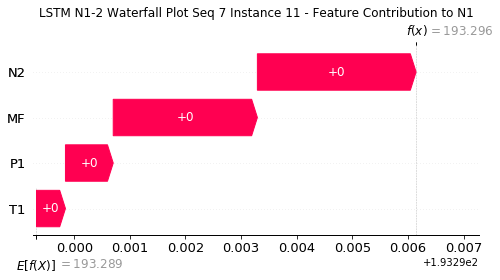

None

Contribution: [0.00087116 0.00048539 0.00287844 0.00260355]


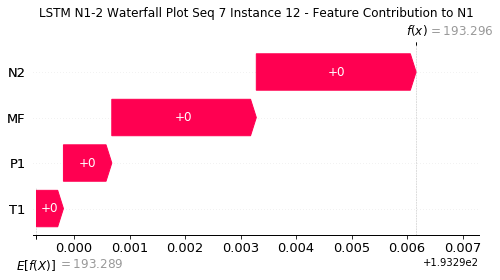

None

Contribution: [0.00088562 0.00053056 0.00294665 0.00267899]


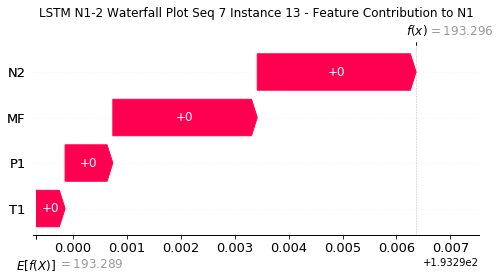

None

Contribution: [0.0009222  0.00052573 0.003059   0.00277085]


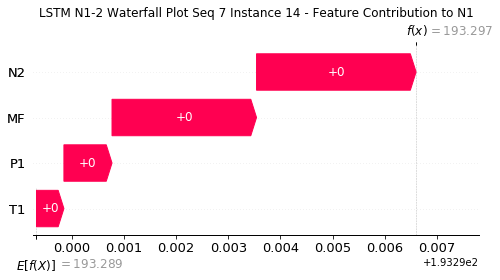

None

Contribution: [0.00097328 0.00056634 0.0032429  0.00294898]


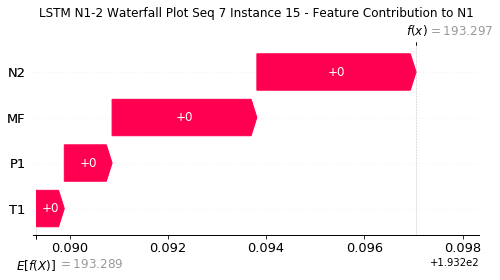

None

Contribution: [0.00106547 0.00061856 0.00354532 0.00322212]


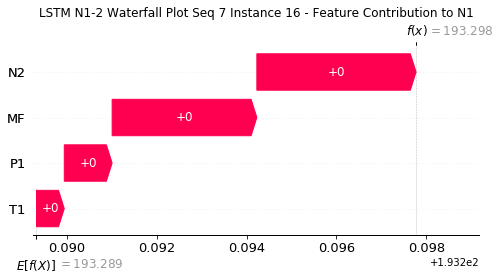

None

Contribution: [0.00122464 0.0007015  0.0040471  0.00365532]


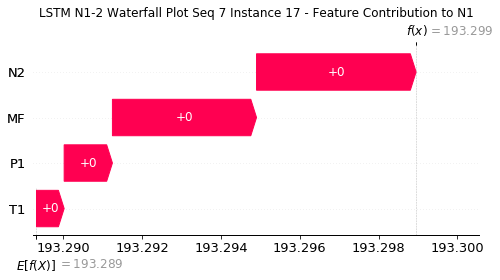

None

Contribution: [0.00148447 0.00086664 0.00494508 0.00449984]


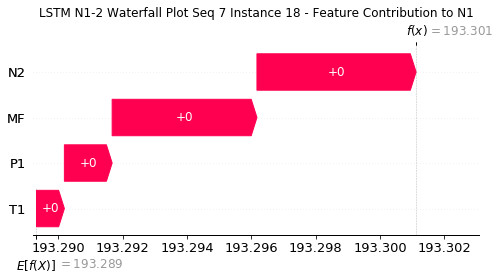

None

Contribution: [0.00198431 0.00116326 0.0065952  0.00600798]


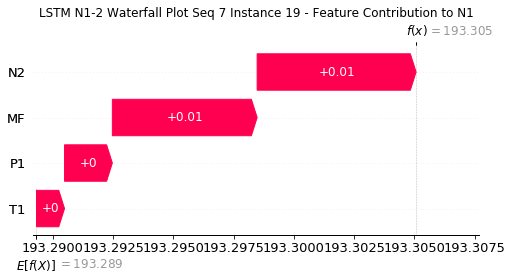

None

Contribution: [0.00294319 0.00174698 0.00977576 0.00892175]


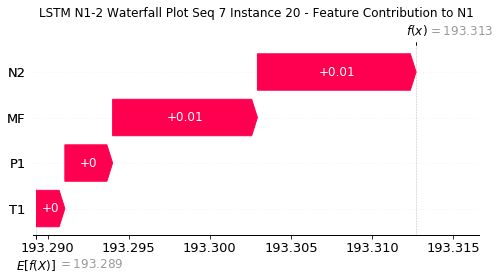

None

Contribution: [0.00486255 0.00288151 0.01612956 0.01473365]


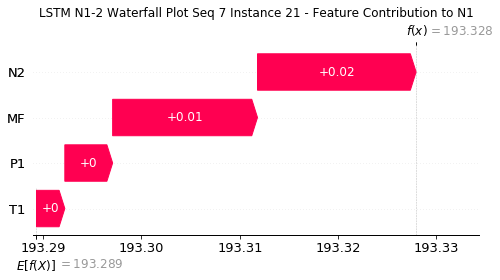

None

Contribution: [0.00864361 0.00525683 0.02871779 0.02626079]


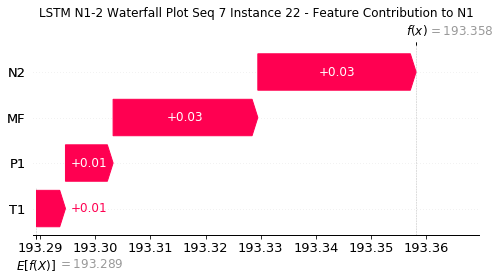

None

Contribution: [0.01555627 0.0089416  0.05165812 0.04766133]


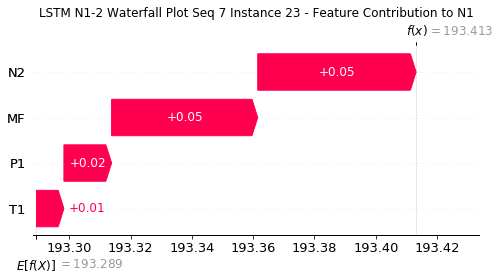

None

Contribution: [ 0.02422511 -0.01184211  0.09212529  0.08614841]


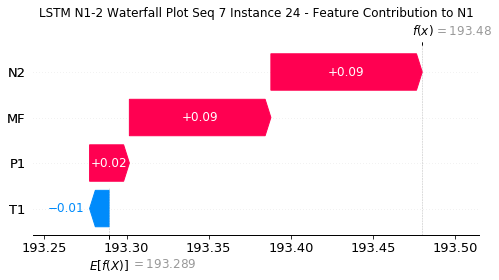

None

Contribution: [ 0.21198999 -0.15325637  0.87154467  0.82511121]


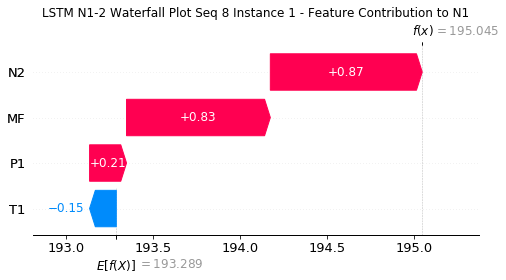

None

Contribution: [0.01503787 0.00839284 0.04927809 0.04680717]


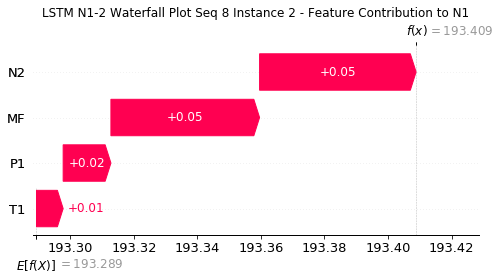

None

Contribution: [0.00260935 0.00154773 0.00884156 0.00781217]


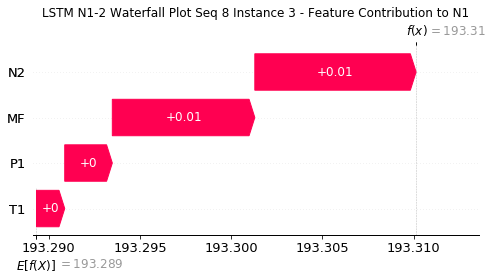

None

Contribution: [0.00129    0.00067025 0.00436157 0.00392304]


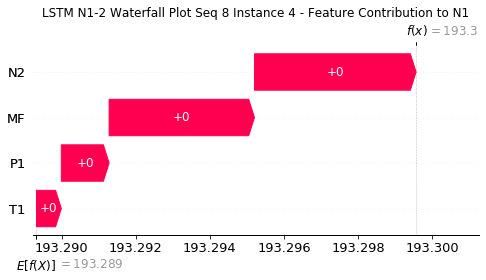

None

Contribution: [0.0010891  0.0006724  0.00361116 0.00328979]


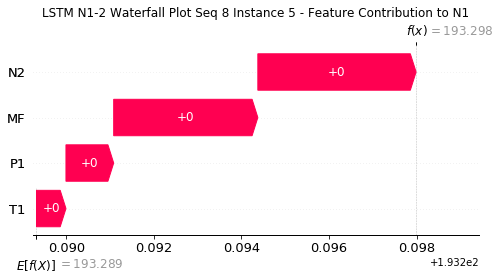

None

Contribution: [0.00091768 0.00052854 0.00306986 0.0027806 ]


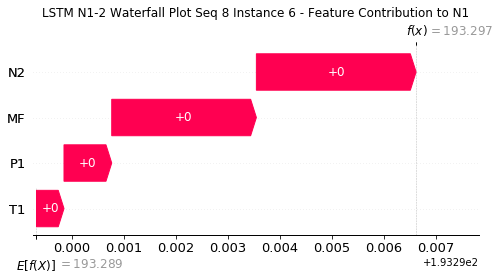

None

Contribution: [0.00087901 0.000531   0.00293774 0.00268196]


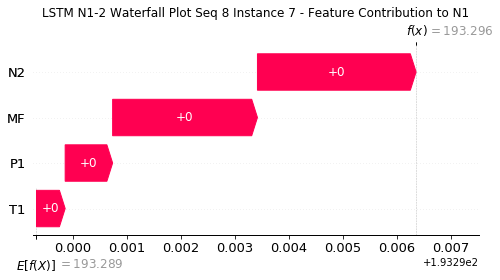

None

Contribution: [0.00085747 0.00049415 0.00288459 0.00262765]


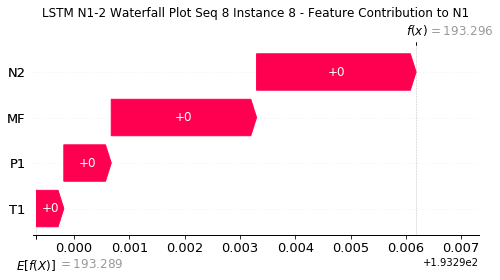

None

Contribution: [0.00084853 0.00052804 0.00286671 0.00261088]


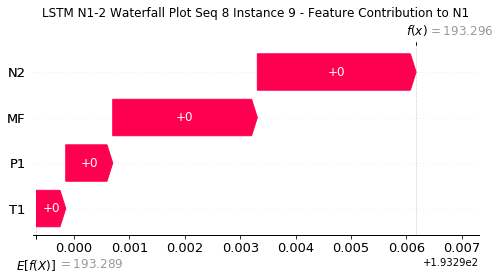

None

Contribution: [0.00085416 0.00049415 0.00285082 0.00259534]


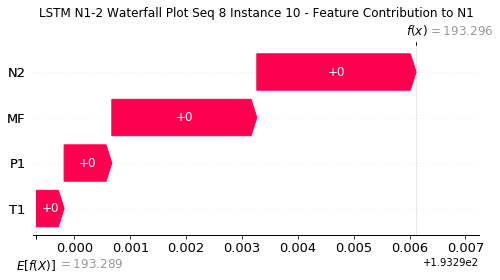

None

Contribution: [0.00085792 0.00049076 0.00285994 0.00260266]


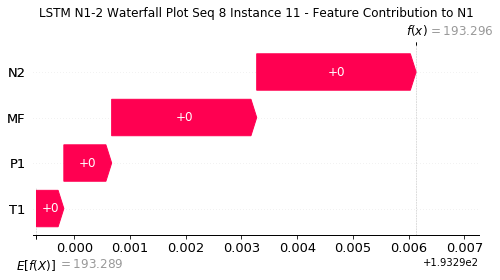

None

Contribution: [0.00085615 0.00048604 0.00288627 0.00260894]


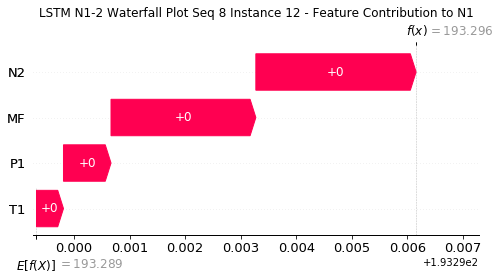

None

Contribution: [0.00089497 0.00051716 0.00296477 0.00270991]


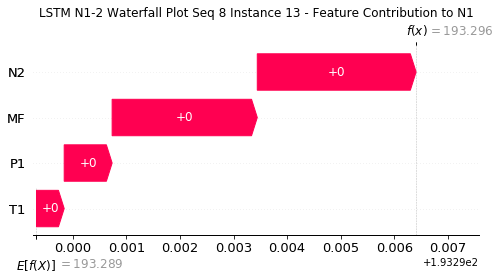

None

Contribution: [0.00093307 0.00050975 0.00307575 0.00279818]


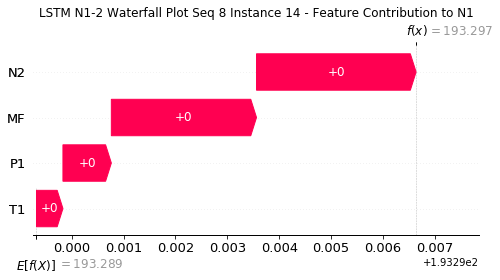

None

Contribution: [0.00097517 0.00055828 0.00326108 0.0029726 ]


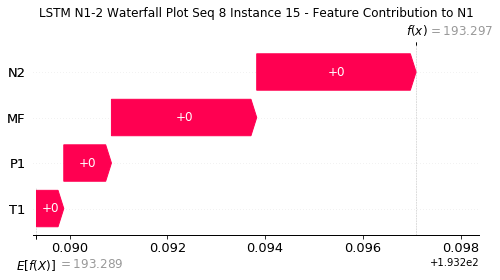

None

Contribution: [0.00104737 0.000599   0.00355296 0.0032118 ]


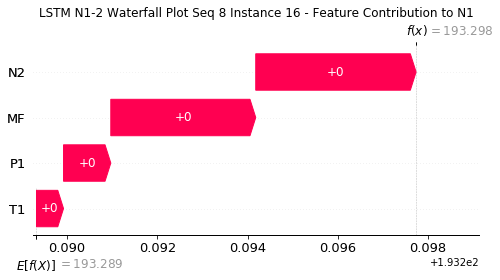

None

Contribution: [0.00120529 0.00071021 0.00407352 0.00370925]


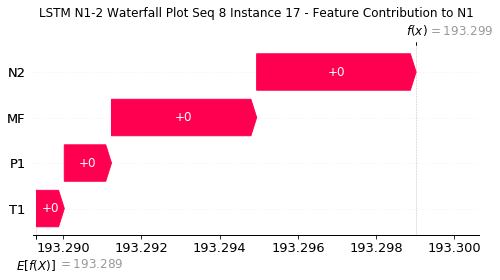

None

Contribution: [0.0014896  0.00086265 0.0049718  0.00451932]


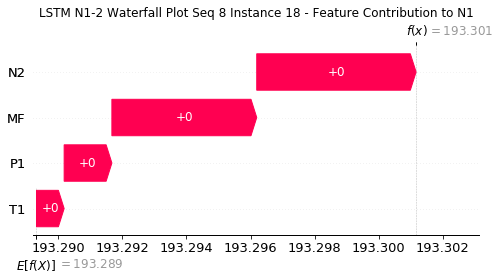

None

Contribution: [0.00197842 0.00116026 0.00662522 0.00600467]


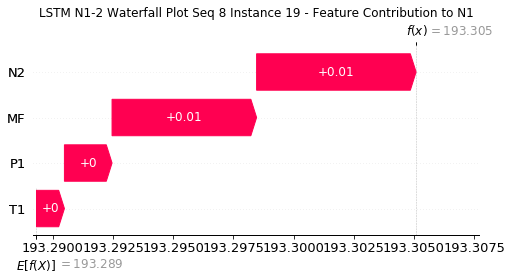

None

Contribution: [0.00298784 0.00179237 0.0098442  0.00899135]


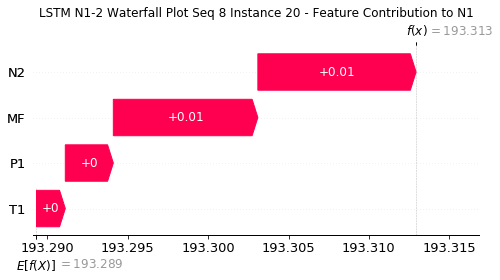

None

Contribution: [0.004856   0.00294711 0.01622661 0.01476654]


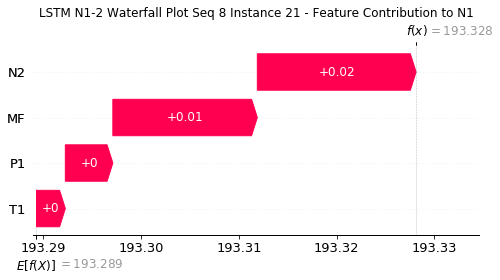

None

Contribution: [0.00878551 0.00530885 0.02897801 0.02682594]


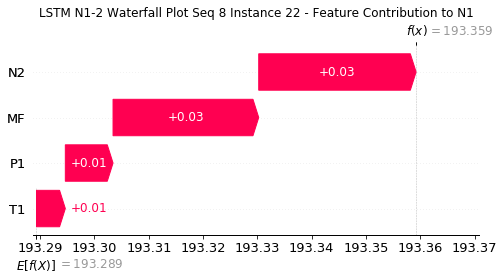

None

Contribution: [0.01532246 0.00870387 0.05198953 0.04794489]


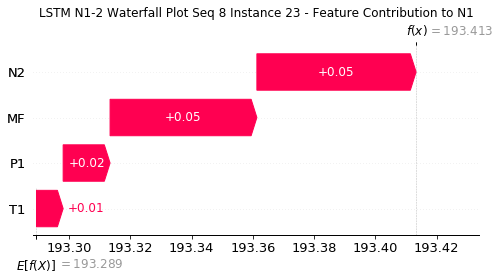

None

Contribution: [ 0.01941385 -0.01219032  0.08962317  0.06928339]


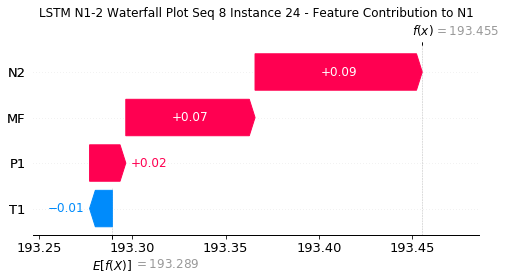

None

Contribution: [ 0.22459663 -0.12390902  0.86549219  0.75798034]


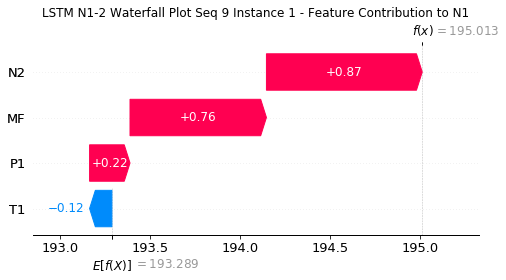

None

Contribution: [0.01506377 0.00767392 0.04915426 0.04591132]


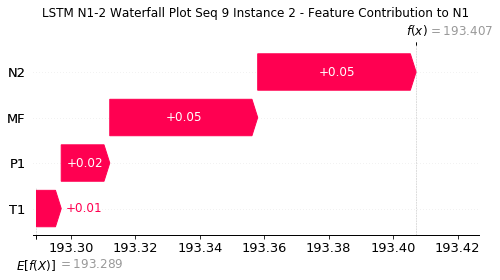

None

Contribution: [0.00247318 0.00167891 0.00882412 0.00780749]


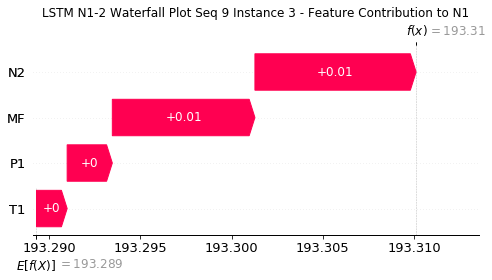

None

Contribution: [0.00125324 0.00077589 0.00436167 0.003952  ]


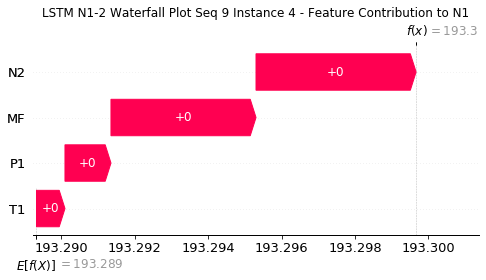

None

Contribution: [0.00099286 0.00062392 0.00355433 0.00317106]


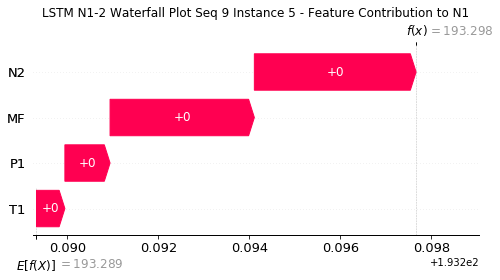

None

Contribution: [0.00090109 0.000605   0.00306193 0.00279515]


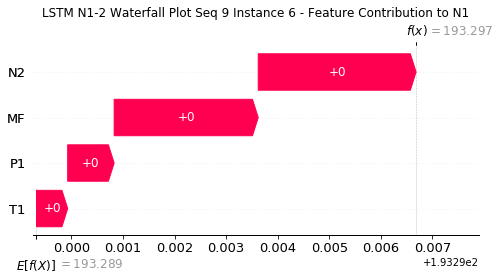

None

Contribution: [0.0008762  0.00065728 0.00292761 0.00266803]


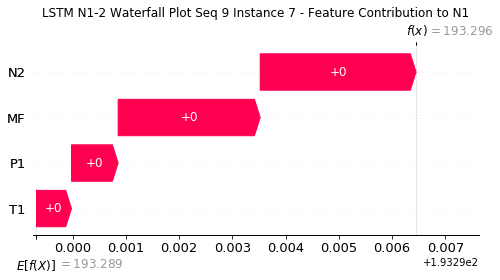

None

Contribution: [0.00087149 0.00068231 0.00289224 0.00264465]


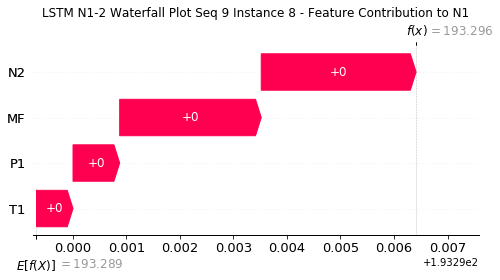

None

Contribution: [0.00086875 0.00061845 0.00286276 0.00262903]


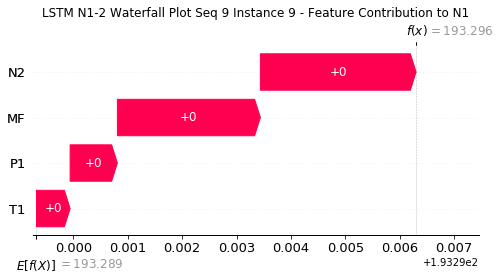

None

Contribution: [0.00086143 0.00058608 0.00284198 0.00260594]


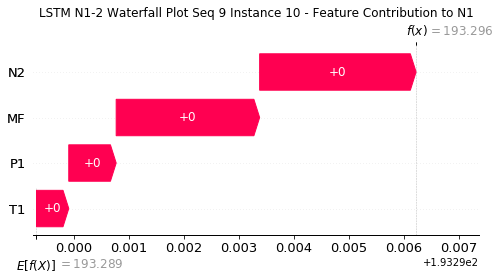

None

Contribution: [0.00086399 0.00059621 0.00285107 0.00261071]


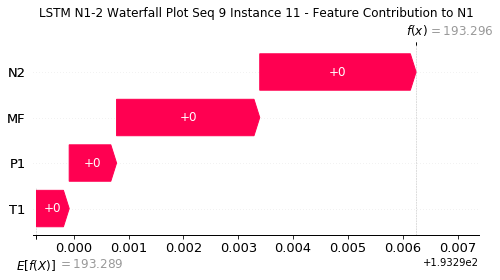

None

Contribution: [0.00086393 0.00060862 0.00287094 0.0026079 ]


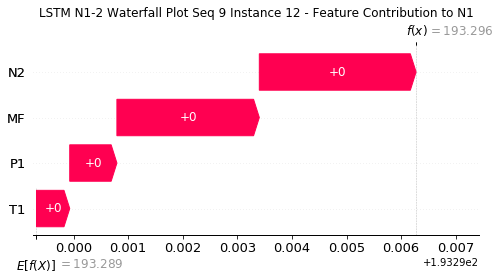

None

Contribution: [0.00089522 0.00061884 0.00294295 0.00268997]


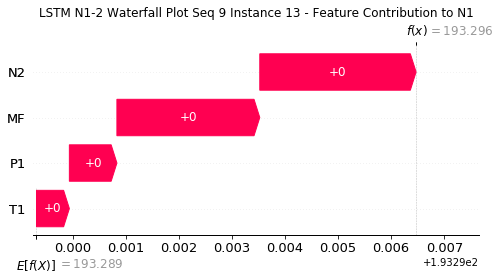

None

Contribution: [0.00093273 0.00062656 0.00305082 0.00277512]


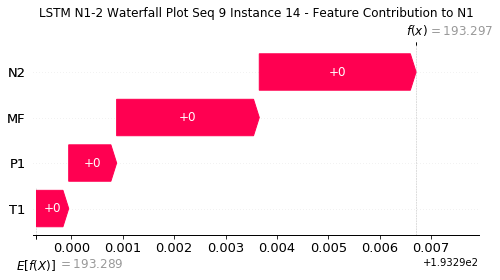

None

Contribution: [0.00099336 0.00070599 0.00324041 0.00296138]


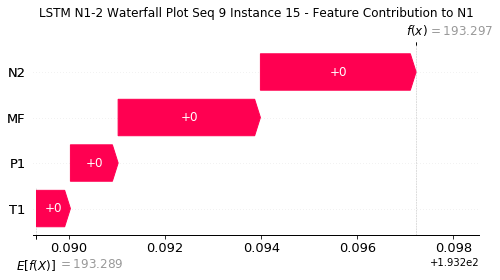

None

Contribution: [0.00109211 0.00078177 0.00354234 0.00324539]


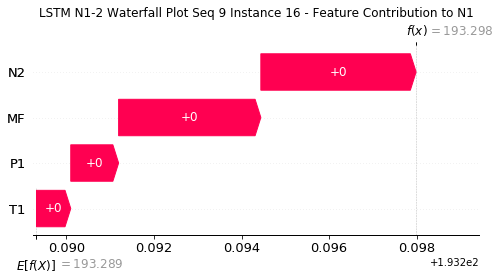

None

Contribution: [0.00121376 0.00092656 0.00404289 0.00367596]


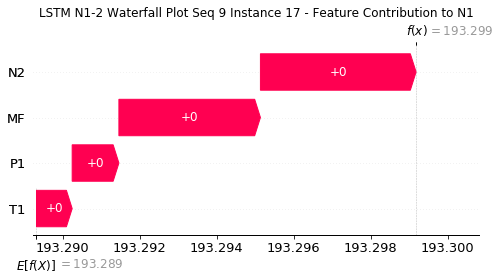

None

Contribution: [0.00150228 0.00109438 0.00492881 0.00448822]


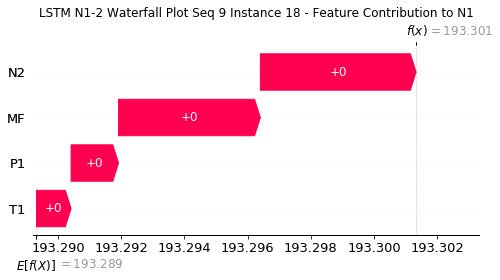

None

Contribution: [0.00201505 0.00146796 0.00657187 0.00599966]


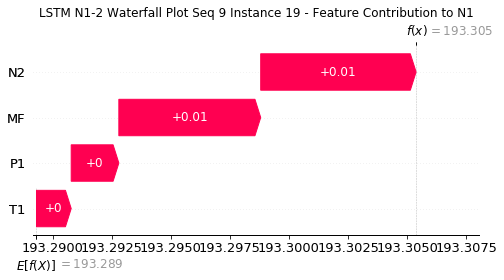

None

Contribution: [0.00298384 0.00216995 0.00974184 0.00888451]


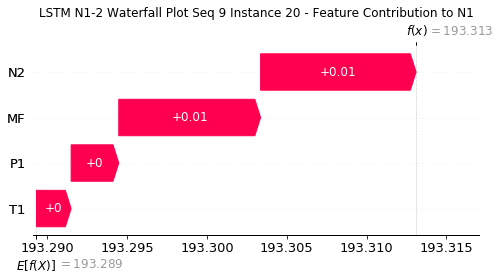

None

Contribution: [0.00499424 0.00365667 0.01609185 0.014751  ]


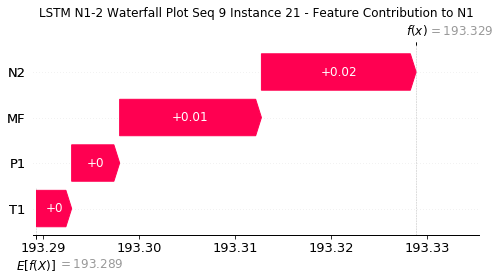

None

Contribution: [0.00879548 0.00649206 0.02866893 0.02613005]


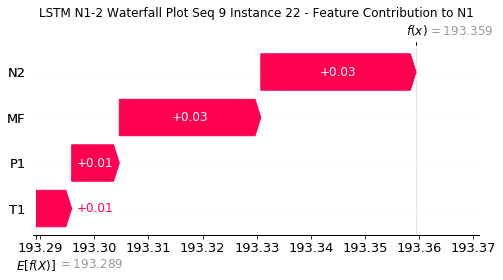

None

Contribution: [0.01537306 0.01225976 0.05147189 0.04695878]


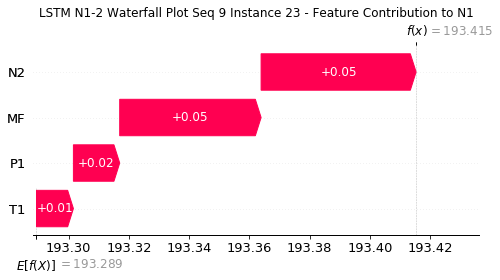

None

Contribution: [0.02507866 0.00639144 0.09186685 0.08731788]


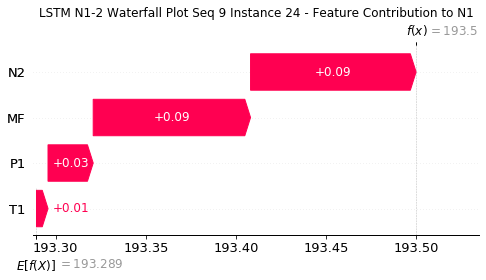

None

Contribution: [0.2055577  0.01348099 0.85071111 0.7809531 ]


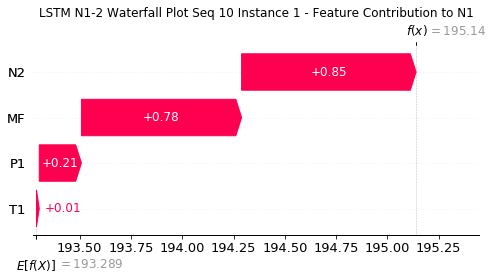

None

Contribution: [0.01452926 0.0104176  0.04757472 0.04479713]


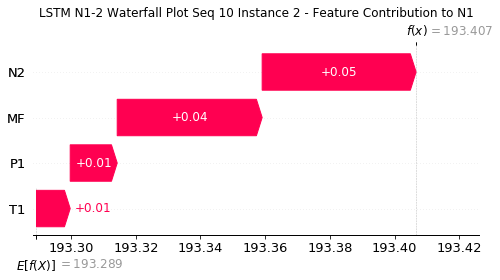

None

Contribution: [0.00256132 0.00197759 0.00862017 0.00761531]


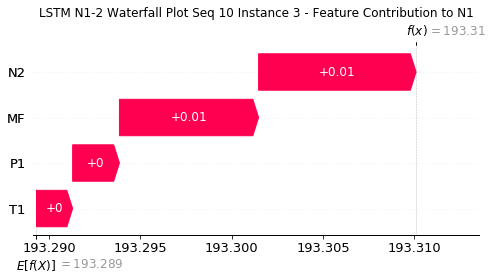

None

Contribution: [0.00132186 0.00093444 0.00437768 0.00395333]


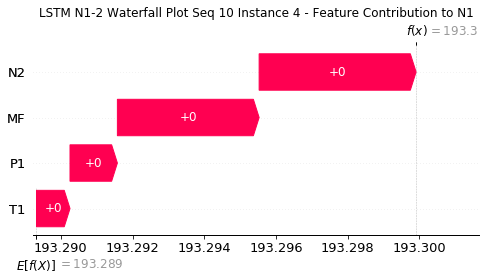

None

Contribution: [0.00108927 0.00082189 0.00359109 0.00330625]


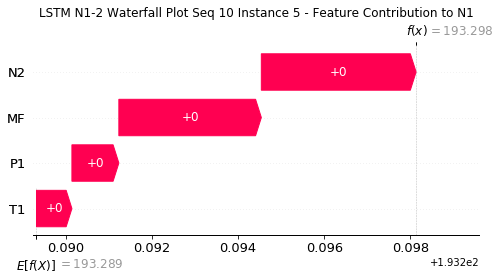

None

Contribution: [0.00093337 0.00067755 0.00305823 0.00278649]


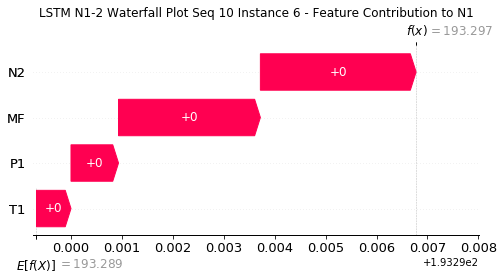

None

Contribution: [0.00086728 0.000626   0.00290201 0.00261019]


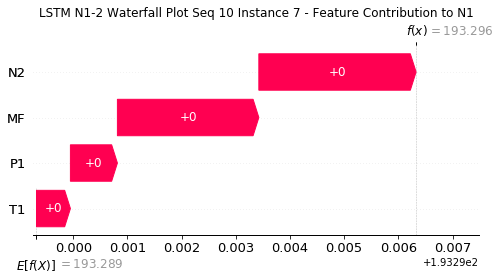

None

Contribution: [0.0008987  0.00063364 0.00288522 0.00265888]


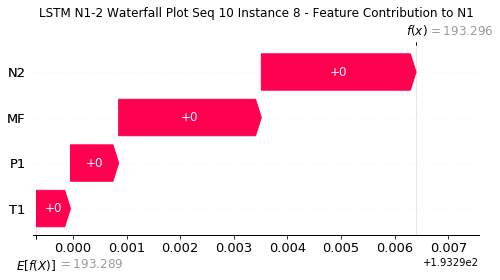

None

Contribution: [0.00086381 0.00061602 0.00284969 0.00260755]


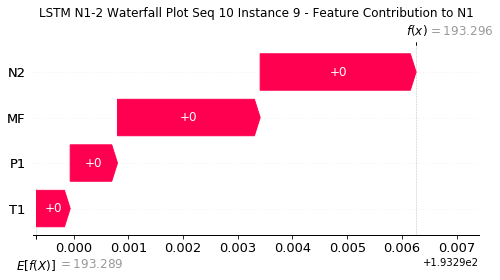

None

Contribution: [0.00087108 0.00060716 0.00283731 0.00260471]


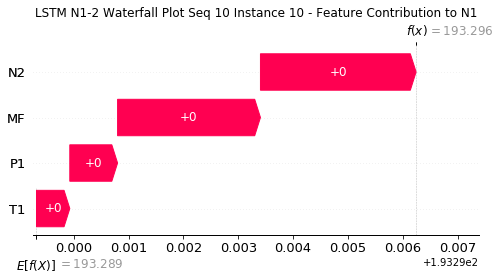

None

Contribution: [0.00087179 0.00060545 0.00284263 0.00260102]


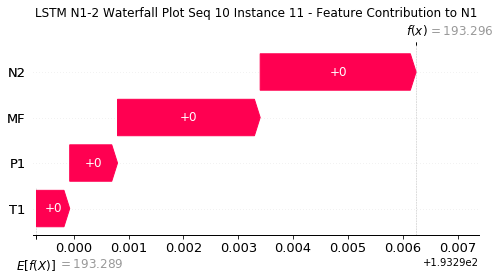

None

Contribution: [0.00087312 0.00057704 0.00286028 0.00259849]


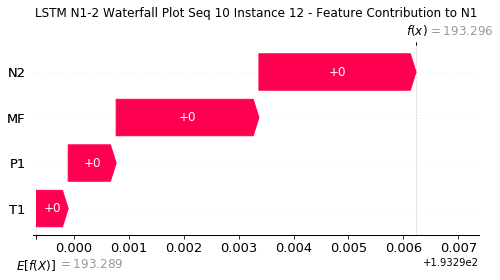

None

Contribution: [0.00090414 0.00061958 0.002939   0.00269918]


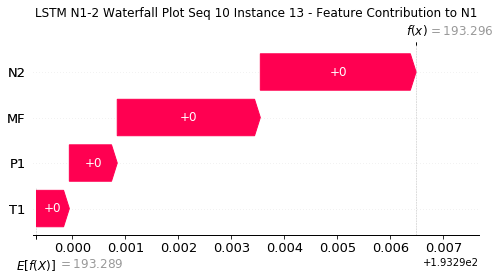

None

Contribution: [0.00093218 0.00066327 0.00305082 0.00280854]


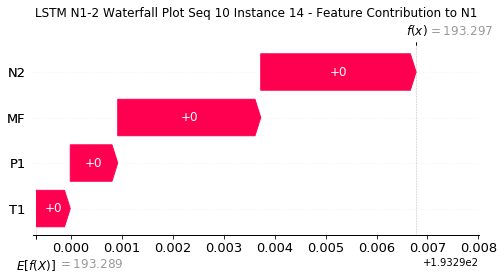

None

Contribution: [0.00099534 0.00068014 0.00323183 0.00296565]


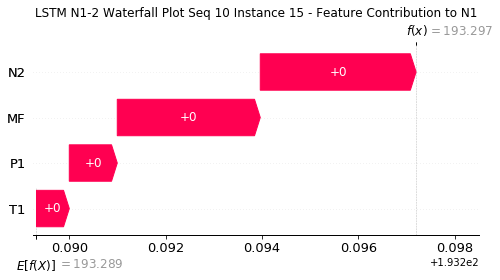

None

Contribution: [0.00108892 0.00074202 0.00352889 0.003239  ]


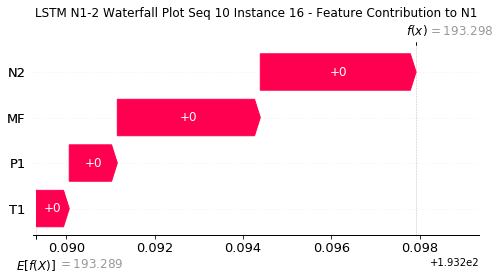

None

Contribution: [0.00123699 0.00084425 0.00402793 0.00368312]


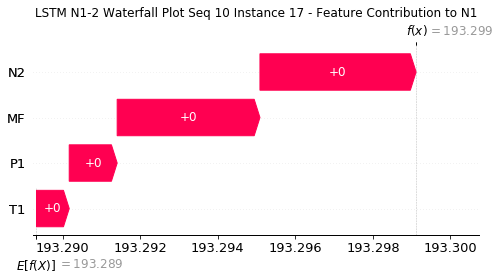

None

Contribution: [0.00151701 0.00103412 0.00491006 0.00449931]


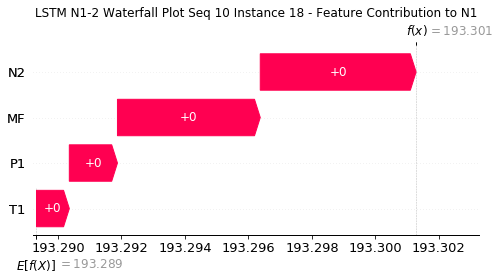

None

Contribution: [0.00202719 0.00137613 0.00654452 0.00601121]


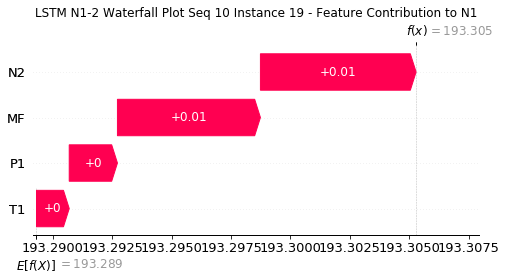

None

Contribution: [0.00301688 0.00202975 0.0097087  0.00895021]


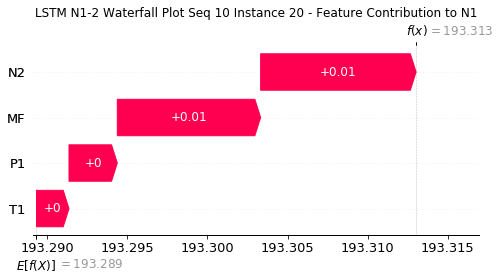

None

Contribution: [0.00499831 0.00336088 0.0160434  0.01485982]


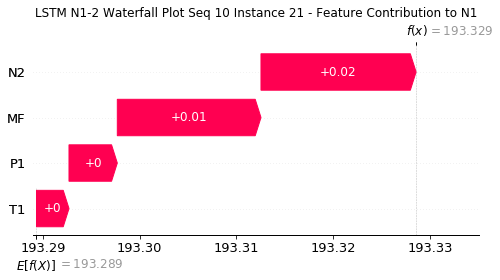

None

Contribution: [0.00891193 0.00602803 0.02861767 0.02647887]


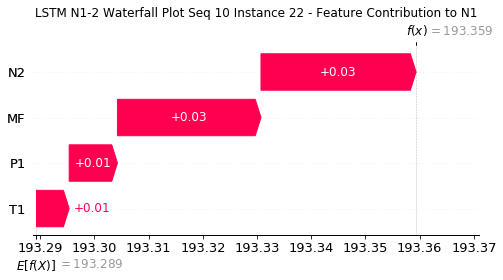

None

Contribution: [0.01587424 0.01109617 0.05153768 0.04703624]


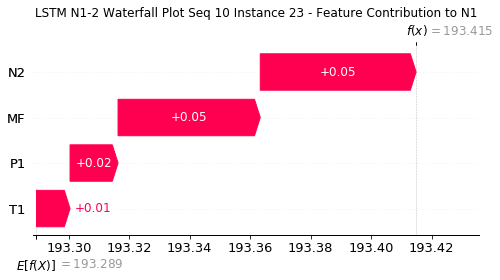

None

Contribution: [0.02729062 0.0019626  0.09228642 0.08716462]


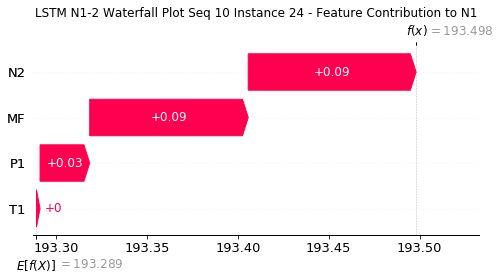

None

Contribution: [ 0.24680557 -0.01372532  0.85294878  0.81867921]


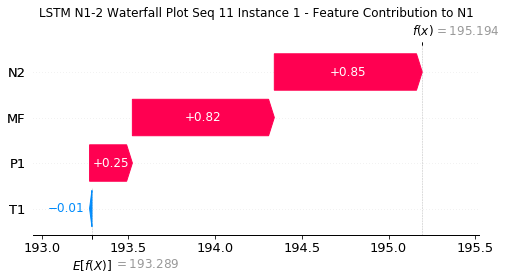

None

Contribution: [0.0152228  0.0106835  0.04680546 0.04480098]


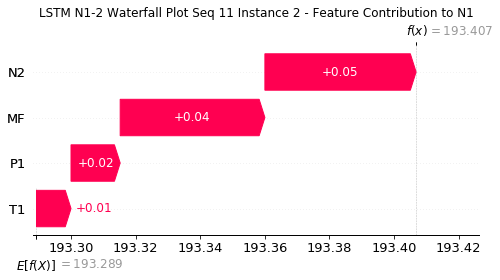

None

Contribution: [0.00267512 0.00185729 0.0085378  0.00772669]


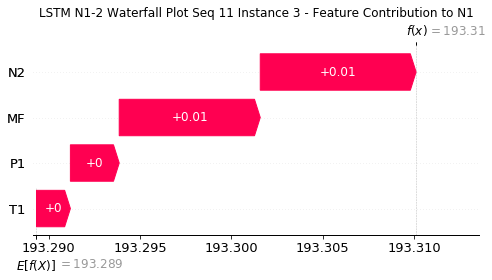

None

Contribution: [0.00139504 0.0008313  0.00439204 0.00405628]


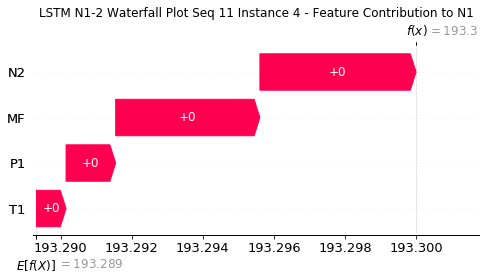

None

Contribution: [0.00116247 0.00083861 0.00359958 0.0033353 ]


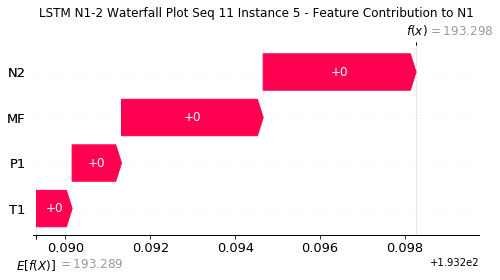

None

Contribution: [0.00098082 0.00063201 0.00306518 0.00284519]


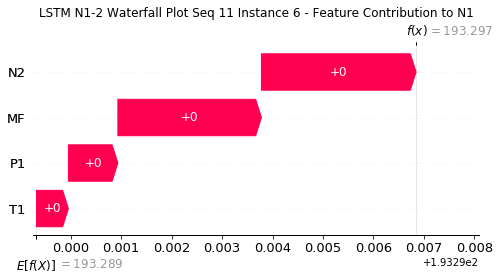

None

Contribution: [0.0009391  0.00067293 0.00293848 0.00271492]


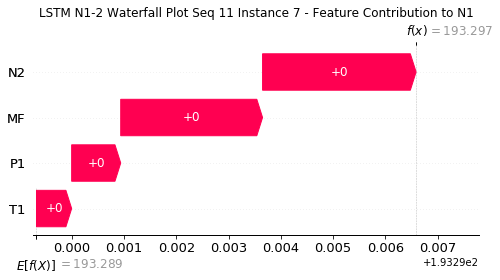

None

Contribution: [0.00092581 0.00065013 0.00289488 0.00267722]


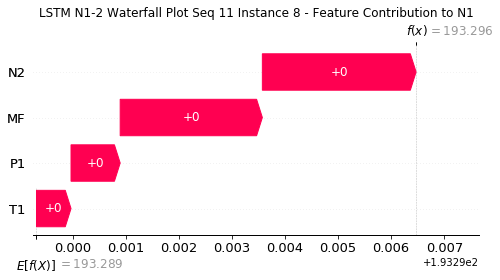

None

Contribution: [0.00091481 0.00066313 0.00287025 0.00265762]


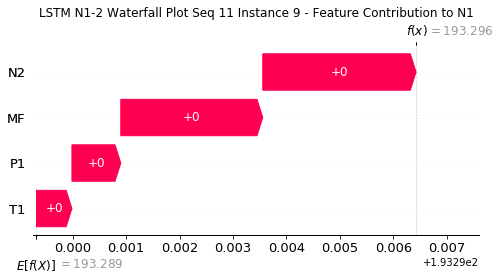

None

Contribution: [0.00089232 0.0004365  0.00282304 0.00261606]


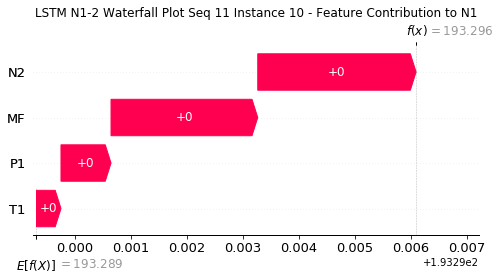

None

Contribution: [0.00089564 0.00044065 0.00283061 0.00262016]


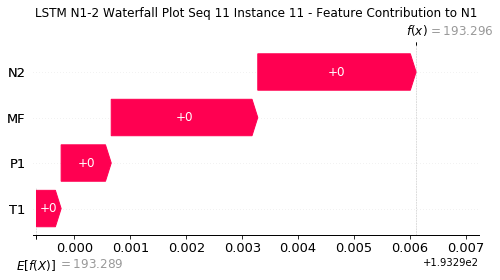

None

Contribution: [0.0008826  0.00032083 0.0028444  0.002635  ]


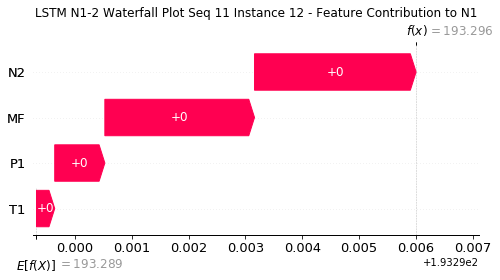

None

Contribution: [0.00092106 0.00044763 0.00292087 0.00269786]


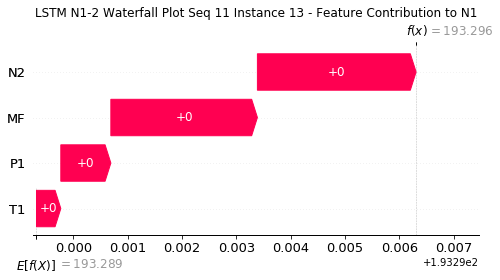

None

Contribution: [0.00094442 0.00035312 0.00302994 0.00280658]


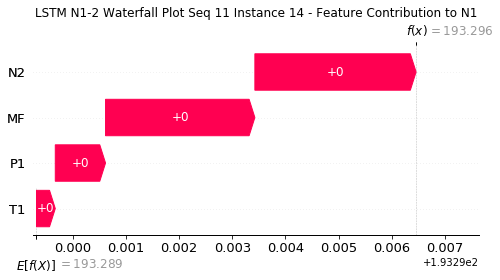

None

Contribution: [0.00101016 0.00049484 0.00320934 0.00295395]


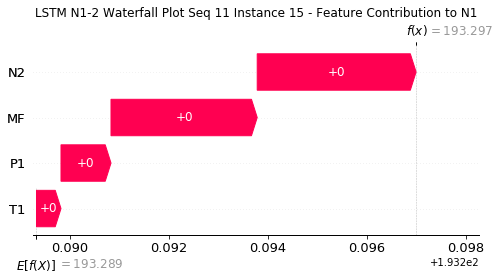

None

Contribution: [0.00110728 0.00057548 0.00350666 0.00322777]


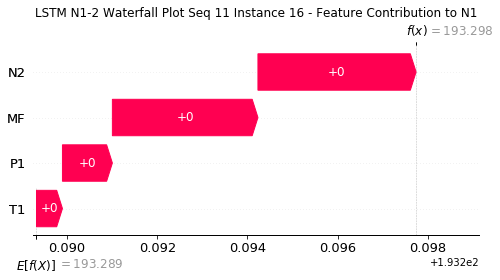

None

Contribution: [0.00128274 0.00075879 0.00402442 0.00375609]


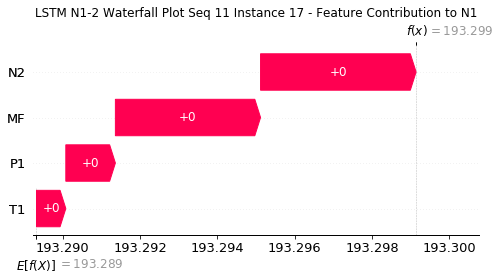

None

Contribution: [0.00155453 0.00096211 0.00488857 0.00448975]


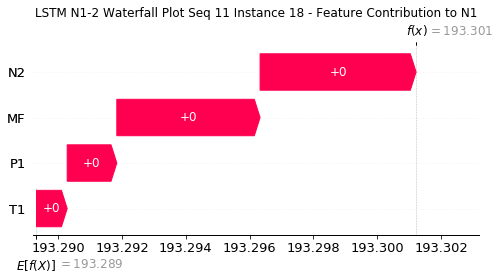

None

Contribution: [0.00207474 0.00130323 0.00651041 0.00598582]


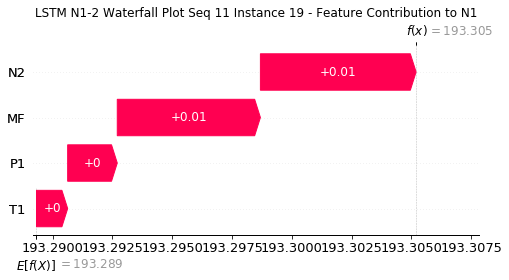

None

Contribution: [0.00307649 0.00196749 0.00964853 0.00887913]


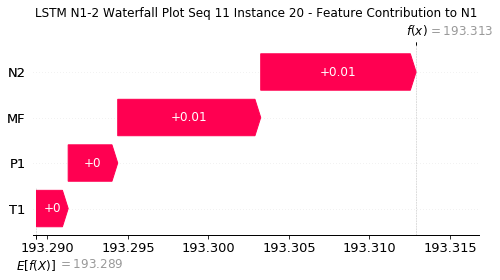

None

Contribution: [0.00505973 0.00307791 0.01592479 0.01467275]


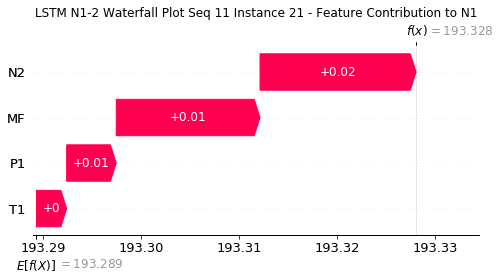

None

Contribution: [0.00902493 0.00588627 0.0283914  0.02615168]


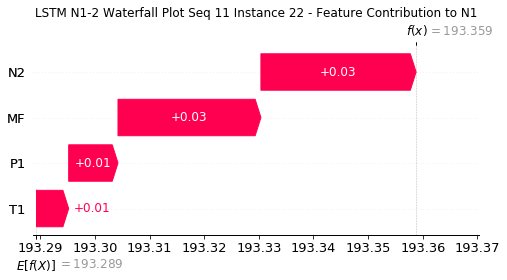

None

Contribution: [0.01662205 0.01260991 0.05139286 0.04811696]


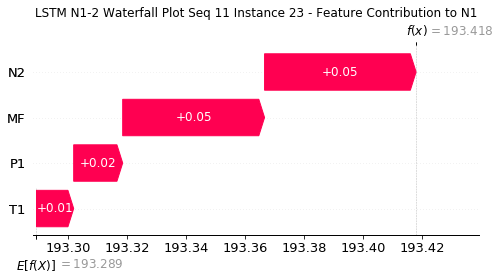

None

Contribution: [0.03109229 0.01007988 0.09265945 0.09050597]


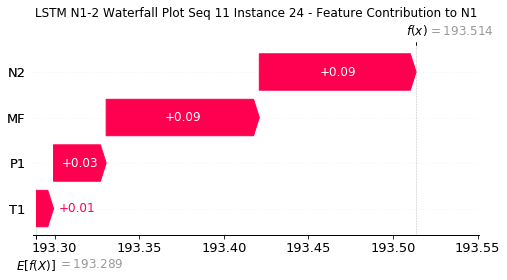

None

Contribution: [0.2679677  0.04052219 0.84678752 0.82152736]


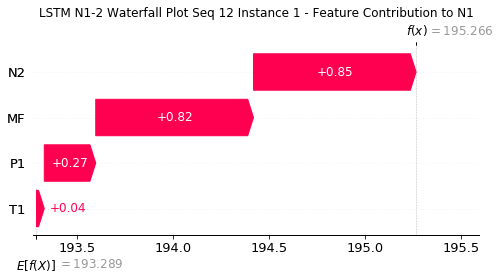

None

Contribution: [0.01494039 0.011334   0.04577142 0.04341802]


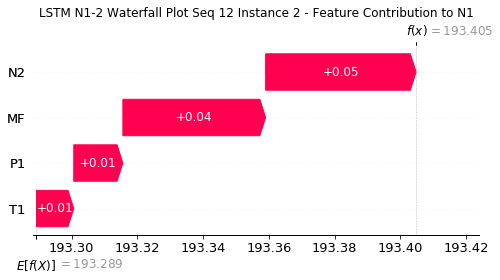

None

Contribution: [0.0026517  0.00213076 0.008406   0.00749366]


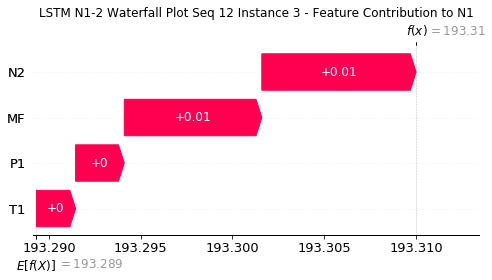

None

Contribution: [0.00141155 0.00106551 0.00439443 0.00400113]


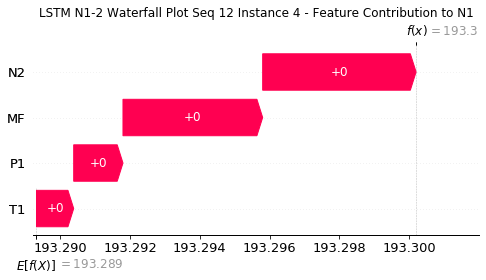

None

Contribution: [0.00111661 0.00088568 0.00355753 0.00325024]


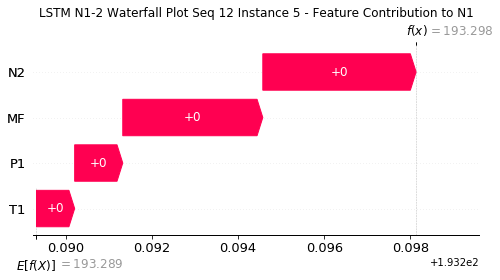

None

Contribution: [0.00098561 0.00076401 0.00304643 0.00280352]


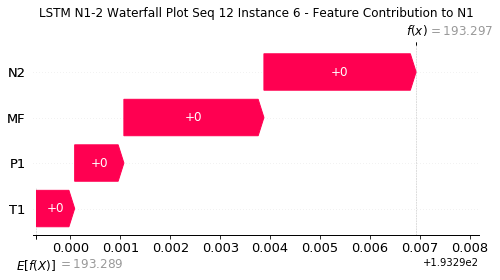

None

Contribution: [0.0009615  0.00073818 0.00292186 0.00273011]


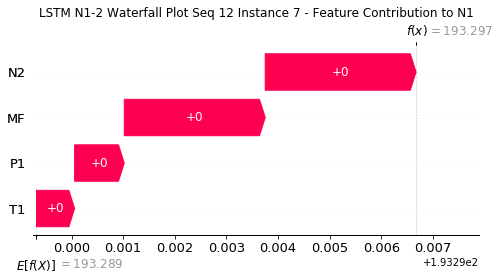

None

Contribution: [0.00092846 0.00069884 0.00285523 0.00262005]


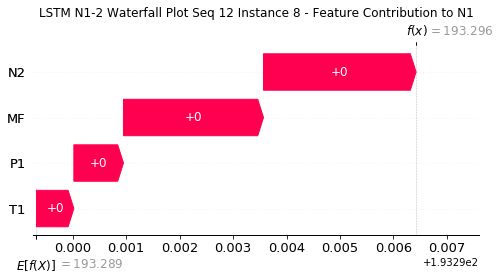

None

Contribution: [0.00091877 0.00070404 0.00283758 0.00263104]


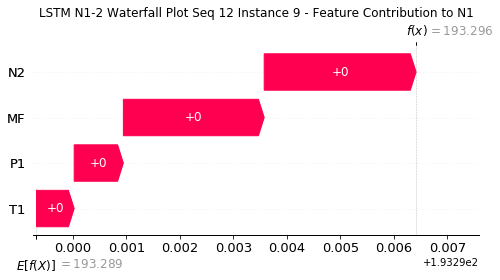

None

Contribution: [0.00091422 0.00071367 0.00281566 0.00261037]


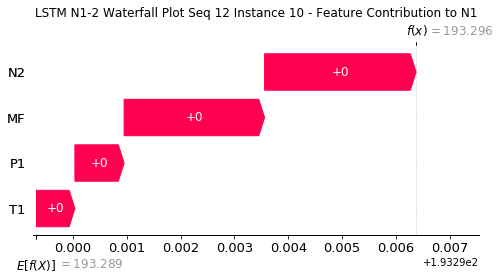

None

Contribution: [0.00092098 0.00071878 0.00282466 0.0026235 ]


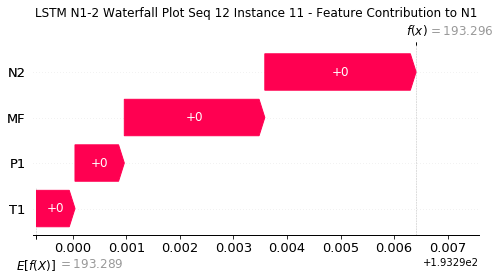

None

Contribution: [0.00089764 0.00071382 0.00282655 0.00259181]


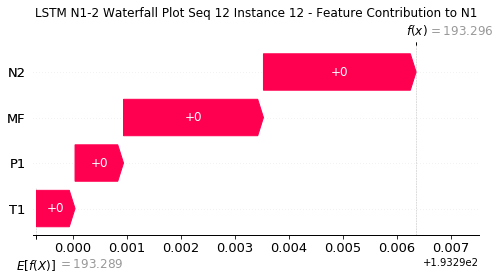

None

Contribution: [0.00094765 0.00074357 0.00291368 0.00271247]


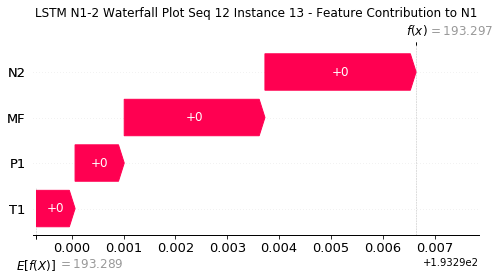

None

Contribution: [0.00100029 0.00078961 0.00303261 0.00287991]


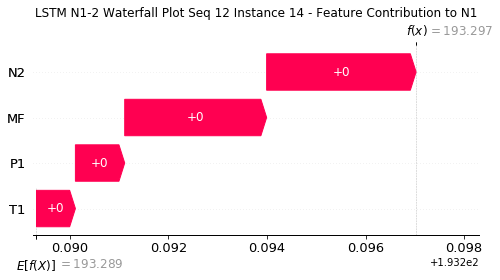

None

Contribution: [0.00104353 0.00082326 0.00320033 0.00298929]


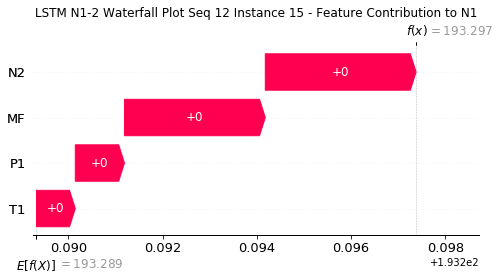

None

Contribution: [0.00113564 0.00089848 0.00348614 0.00325085]


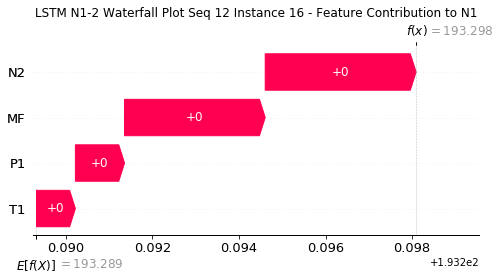

None

Contribution: [0.00127458 0.00100171 0.00396334 0.00365466]


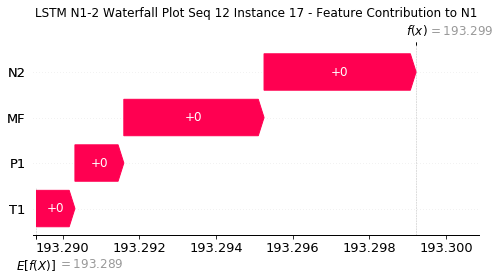

None

Contribution: [0.00157962 0.00125734 0.00484144 0.00452826]


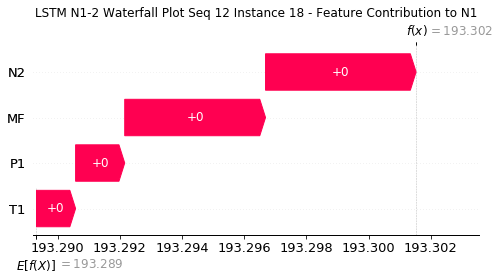

None

Contribution: [0.00209986 0.00167663 0.00644004 0.0060237 ]


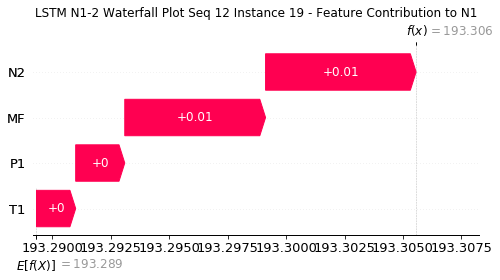

None

Contribution: [0.0031077  0.00249144 0.00954501 0.00894133]


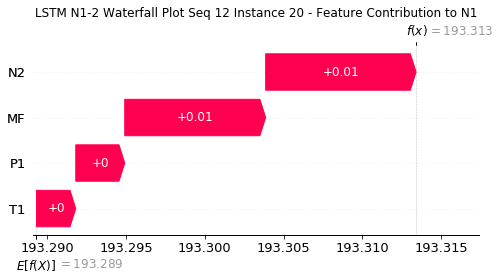

None

Contribution: [0.00511896 0.00413085 0.01576761 0.01477383]


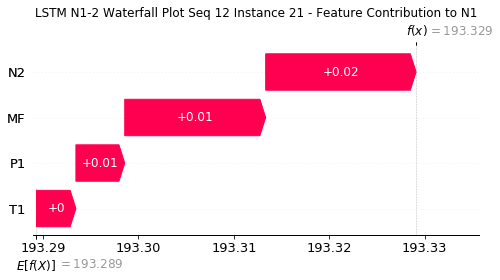

None

Contribution: [0.00911938 0.007386   0.02818237 0.02643871]


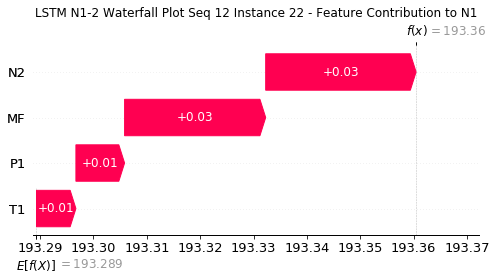

None

Contribution: [0.01645948 0.01361187 0.05103747 0.04767285]


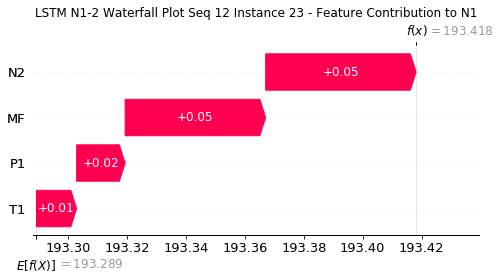

None

Contribution: [0.03056234 0.01634853 0.09198404 0.08824589]


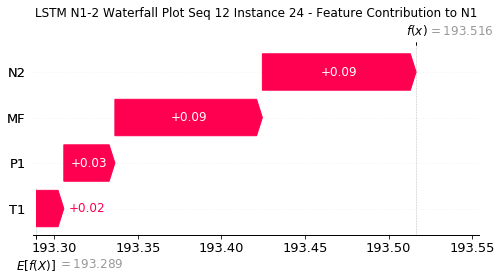

None

Contribution: [0.26904866 0.13047406 0.83337641 0.82132788]


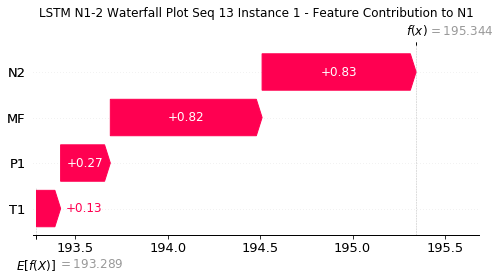

None

Contribution: [0.01489474 0.01168533 0.04499654 0.04326934]


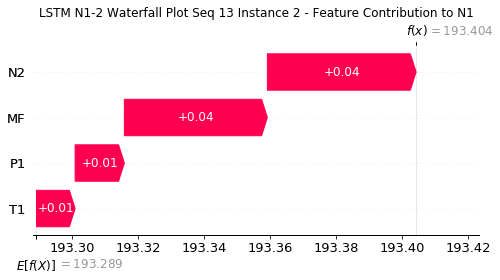

None

Contribution: [0.00261184 0.00213695 0.00834147 0.00752391]


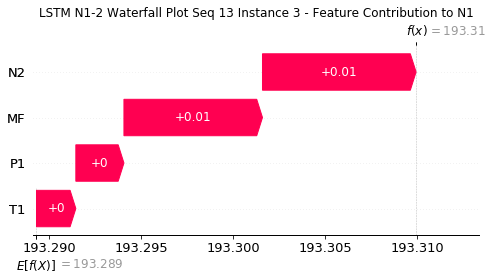

None

Contribution: [0.00141258 0.00106422 0.00441956 0.00407966]


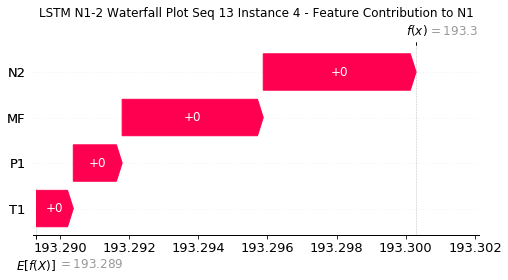

None

Contribution: [0.00117051 0.00089152 0.00358366 0.00333746]


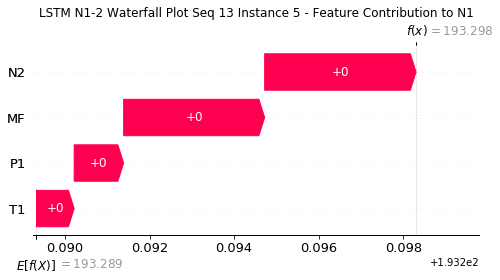

None

Contribution: [0.00097975 0.00075118 0.00305196 0.00283221]


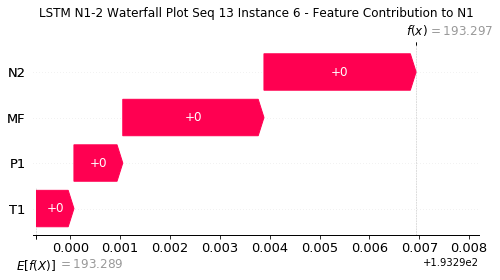

None

Contribution: [0.00090263 0.00068232 0.00288341 0.00262922]


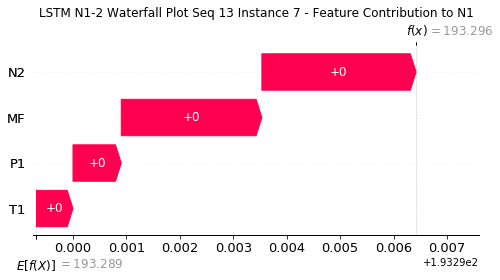

None

Contribution: [0.0008987  0.00064629 0.00284093 0.00261451]


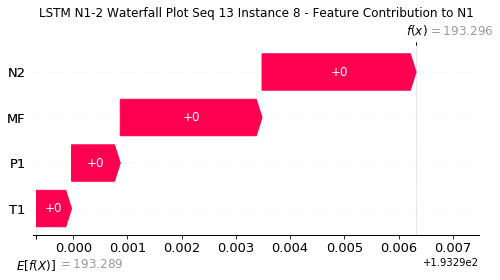

None

Contribution: [0.00089799 0.00066128 0.00282177 0.00260672]


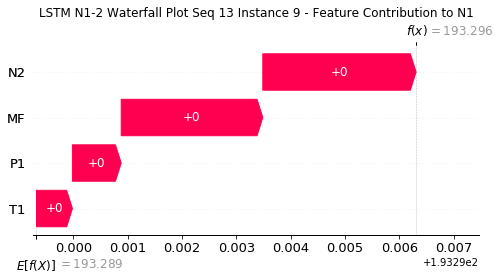

None

Contribution: [0.00091765 0.00066642 0.00282398 0.00264487]


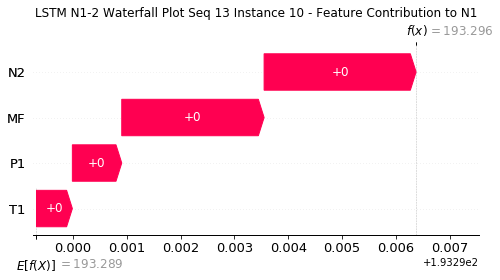

None

Contribution: [0.00091655 0.00066976 0.00283136 0.00264344]


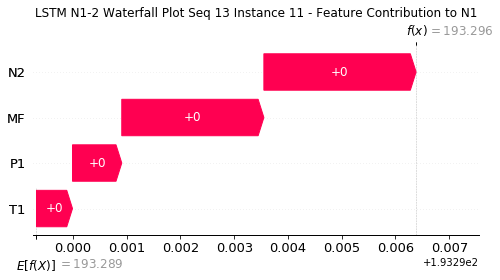

None

Contribution: [0.00092827 0.00067545 0.00285914 0.00268329]


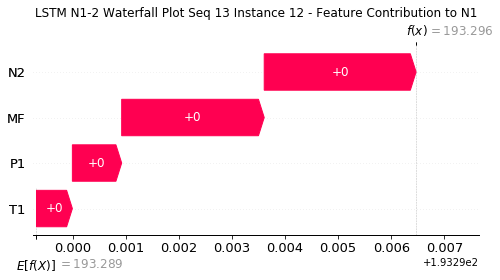

None

Contribution: [0.00094633 0.00069036 0.00292126 0.00272823]


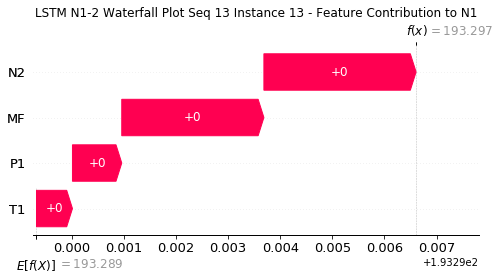

None

Contribution: [0.00095992 0.00069805 0.00301594 0.00277964]


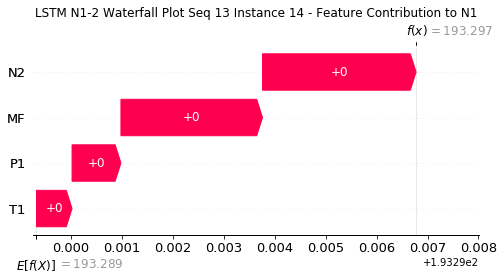

None

Contribution: [0.00103316 0.00075319 0.00320403 0.00298277]


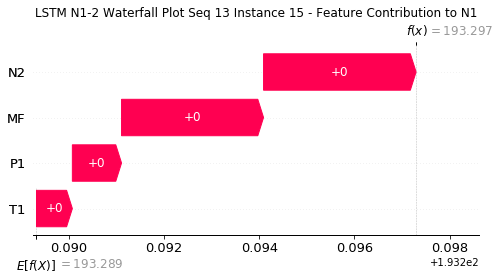

None

Contribution: [0.00112536 0.00082557 0.00349479 0.00325361]


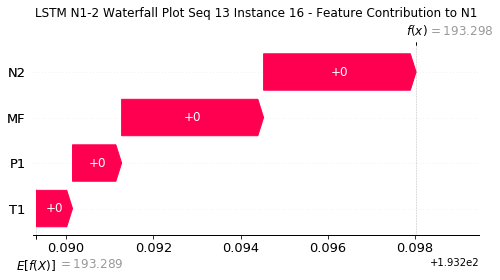

None

Contribution: [0.00127986 0.00101069 0.00399234 0.00370686]


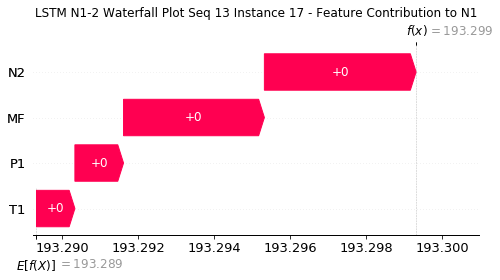

None

Contribution: [0.00154551 0.0011854  0.00484863 0.00448002]


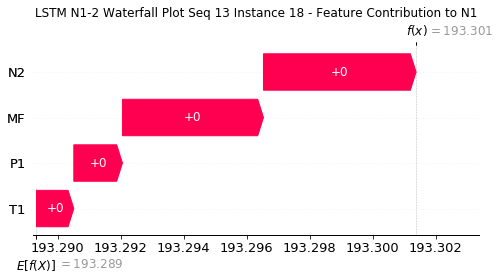

None

Contribution: [0.00206078 0.00157946 0.00645215 0.00597576]


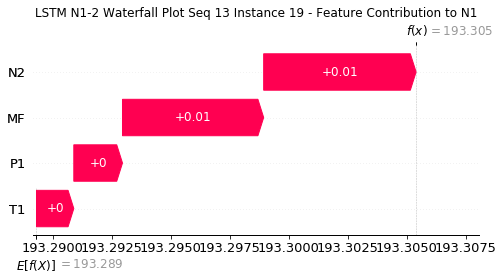

None

Contribution: [0.00305968 0.00236826 0.00956477 0.00887447]


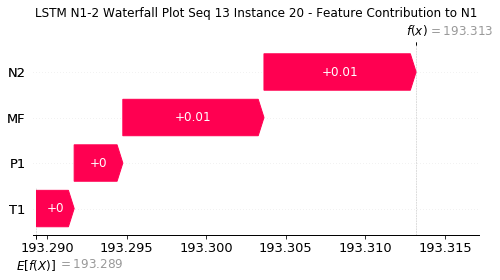

None

Contribution: [0.0050844  0.00387154 0.01581187 0.01475136]


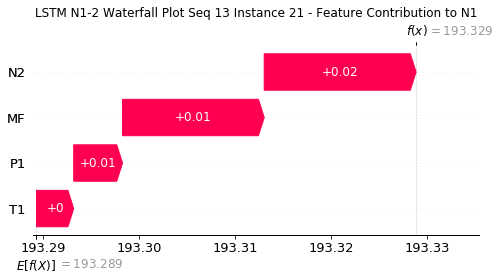

None

Contribution: [0.00904208 0.00713853 0.02826915 0.02633514]


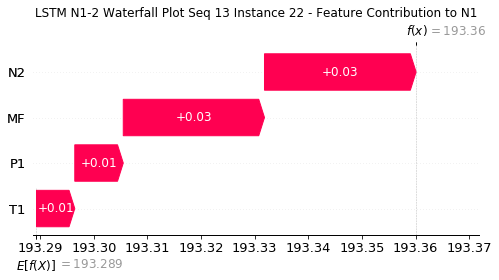

None

Contribution: [0.01595968 0.01369725 0.05109104 0.04747233]


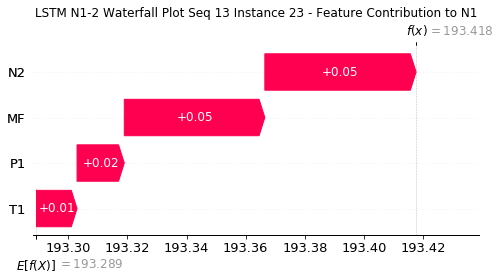

None

Contribution: [0.02836563 0.01227396 0.0920356  0.08833613]


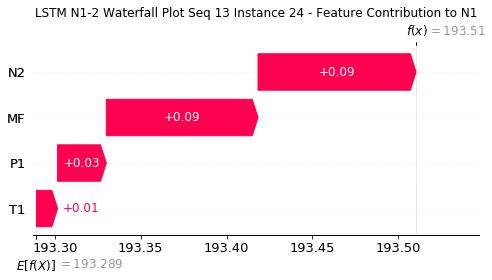

None

Contribution: [0.2492468  0.10331862 0.83846615 0.80030763]


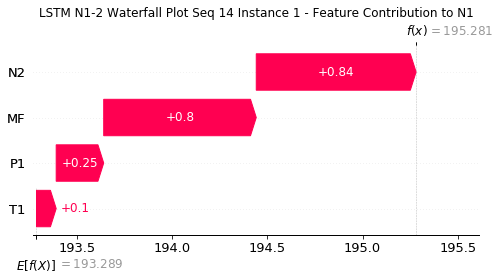

None

Contribution: [0.01462046 0.01151502 0.04550637 0.0429246 ]


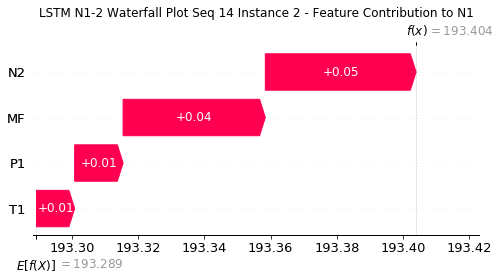

None

Contribution: [0.0026027  0.00211146 0.00838773 0.00751568]


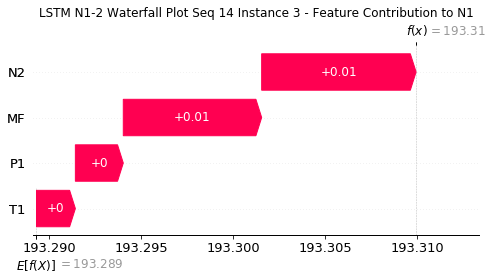

None

Contribution: [0.00138507 0.00106554 0.00439685 0.004028  ]


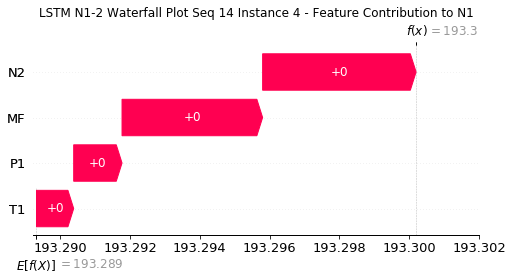

None

Contribution: [0.00111434 0.00080095 0.00354337 0.00325088]


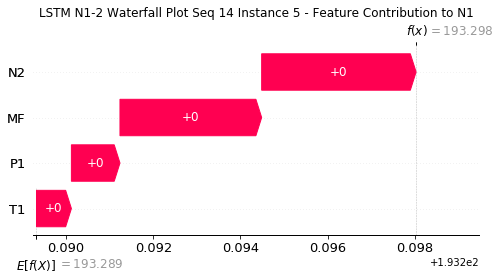

None

Contribution: [0.00096395 0.00076544 0.00304298 0.00280835]


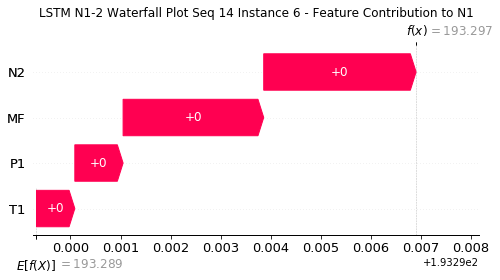

None

Contribution: [0.00090782 0.00073112 0.00289444 0.00265384]


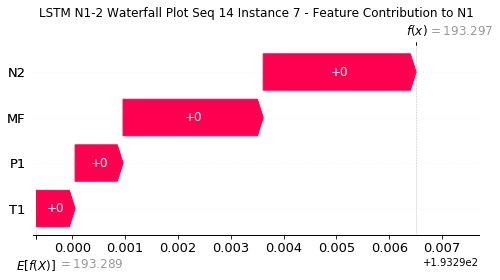

None

Contribution: [0.00089409 0.00075011 0.00285372 0.00262005]


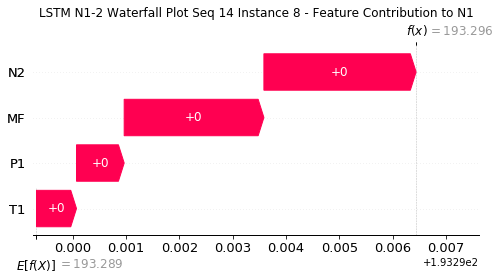

None

Contribution: [0.00089254 0.000746   0.00283252 0.00261635]


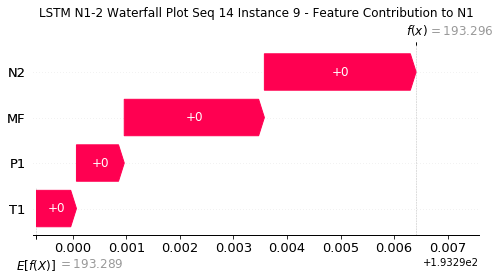

None

Contribution: [0.00088636 0.00071784 0.00281055 0.00259392]


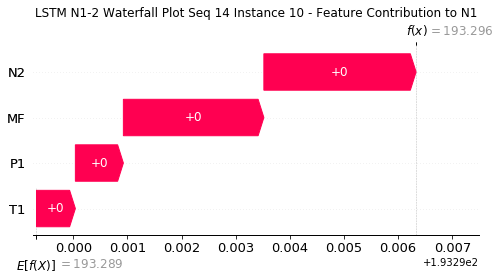

None

Contribution: [0.00088864 0.00071802 0.00281916 0.00259992]


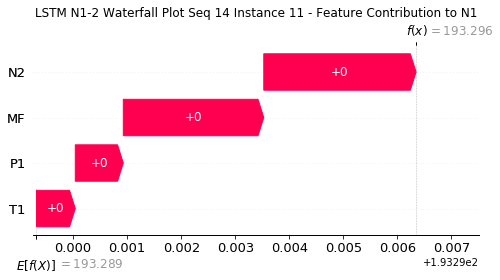

None

Contribution: [0.00088968 0.00073388 0.00285276 0.00264883]


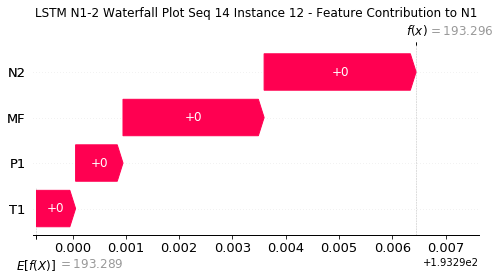

None

Contribution: [0.00091561 0.00075176 0.00290994 0.00268587]


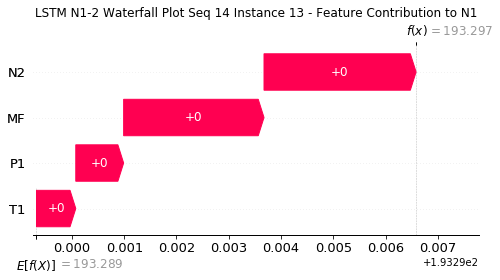

None

Contribution: [0.00093169 0.0007563  0.0030129  0.00278325]


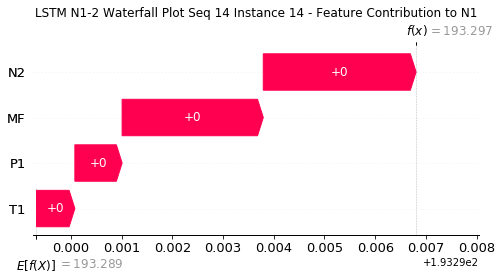

None

Contribution: [0.00100162 0.00082845 0.00319334 0.00294996]


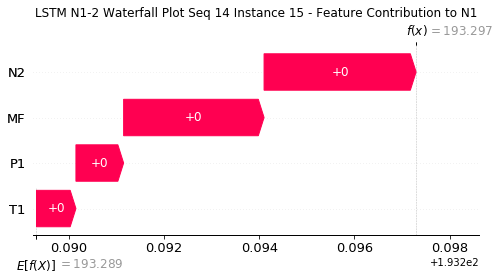

None

Contribution: [0.00109381 0.00091545 0.00348399 0.00322899]


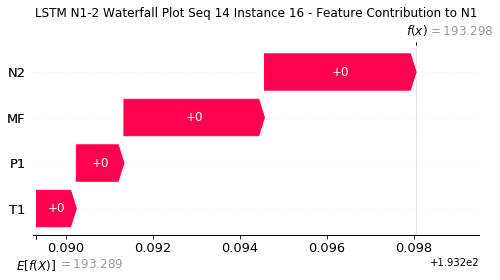

None

Contribution: [0.00124323 0.00098646 0.00397222 0.00368855]


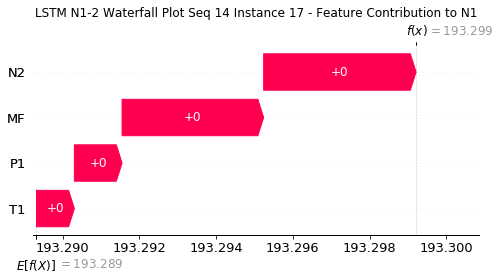

None

Contribution: [0.00152105 0.00128752 0.00483755 0.00448506]


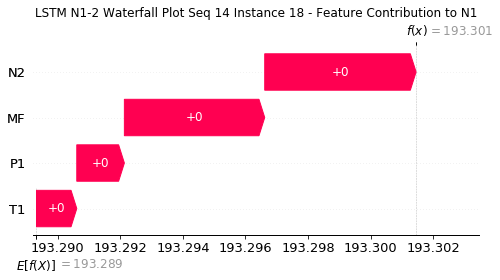

None

Contribution: [0.00202712 0.00173437 0.00643587 0.00598113]


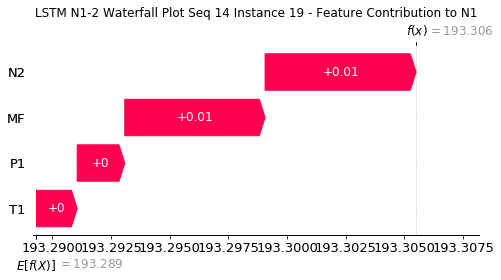

None

Contribution: [0.00301038 0.00261523 0.00954123 0.00887327]


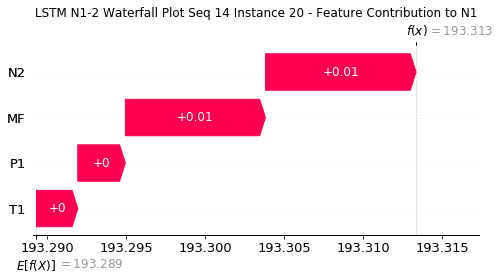

None

Contribution: [0.00496724 0.00436742 0.01576698 0.01471675]


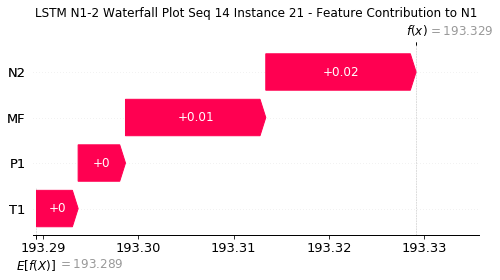

None

Contribution: [0.00889883 0.00794268 0.02823563 0.0264722 ]


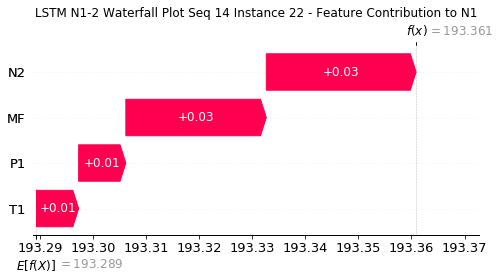

None

Contribution: [0.0162466  0.01514445 0.05113376 0.04827452]


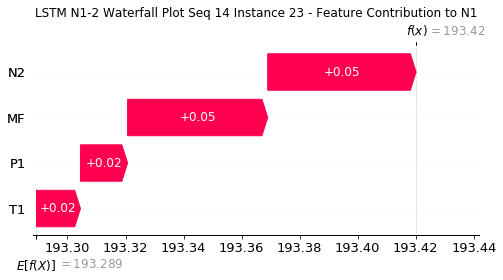

None

Contribution: [0.02900113 0.02242422 0.0919192  0.08872846]


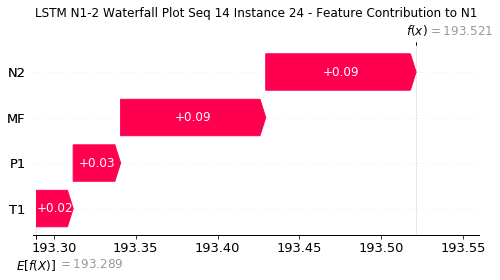

None

Contribution: [0.25355155 0.19612719 0.83128539 0.79420511]


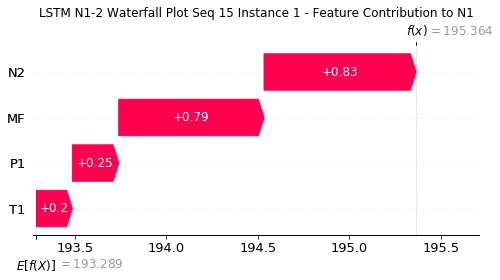

None

Contribution: [0.01456351 0.0125245  0.04468325 0.04267248]


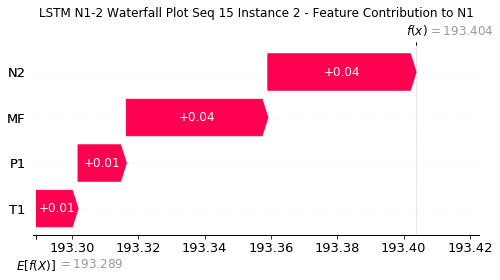

None

Contribution: [0.00254541 0.00238011 0.00829584 0.00739304]


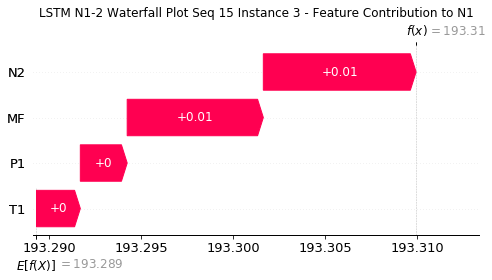

None

Contribution: [0.0013788  0.00121267 0.00441657 0.00401911]


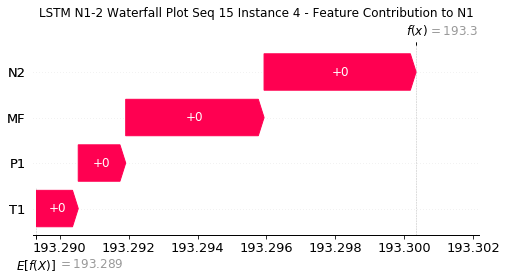

None

Contribution: [0.00113208 0.00100693 0.00357316 0.00328997]


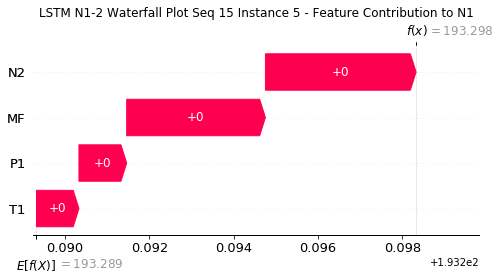

None

Contribution: [0.0009585  0.00084266 0.00304634 0.00279636]


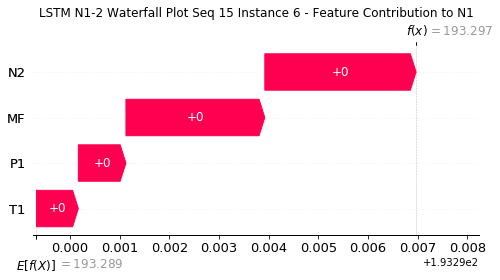

None

Contribution: [0.00089356 0.00076866 0.00289043 0.00263877]


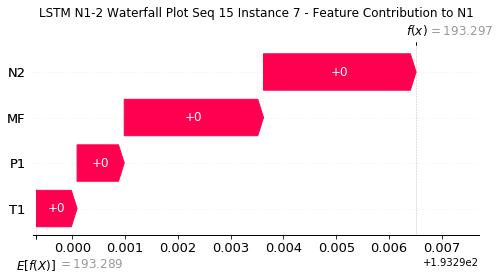

None

Contribution: [0.00090697 0.00076148 0.00285742 0.00263545]


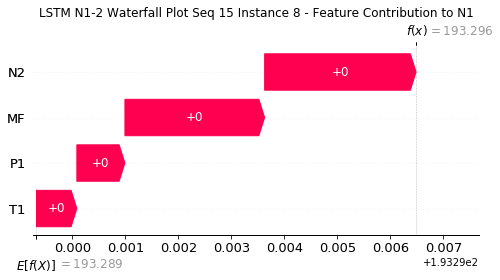

None

Contribution: [0.00088598 0.00076248 0.00282549 0.0025883 ]


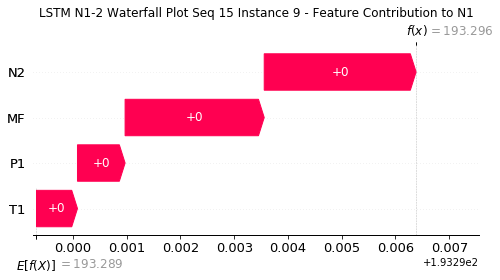

None

Contribution: [0.00088867 0.00074176 0.00281593 0.0026003 ]


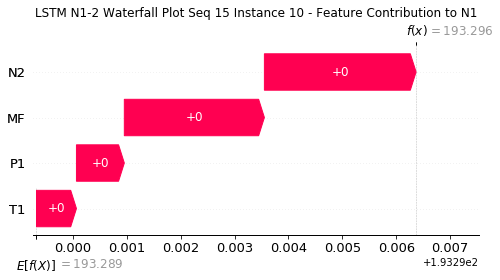

None

Contribution: [0.00088936 0.00074049 0.00282401 0.00260613]


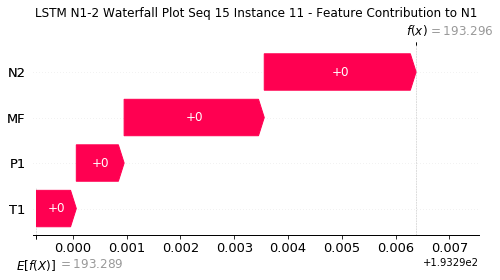

None

Contribution: [0.00089786 0.00075177 0.00285601 0.00264568]


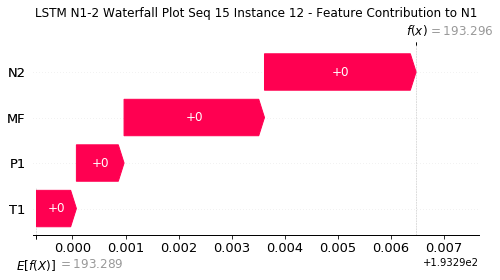

None

Contribution: [0.00091917 0.00075625 0.00291417 0.00269261]


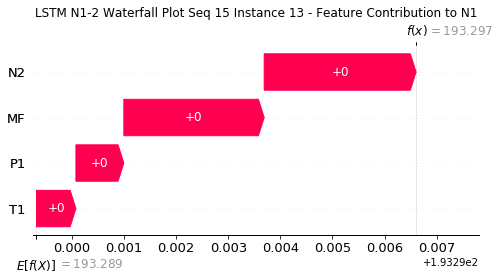

None

Contribution: [0.00095378 0.00075371 0.00302422 0.00280047]


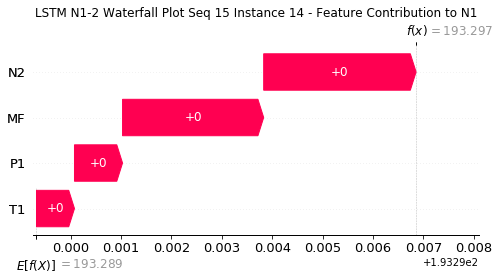

None

Contribution: [0.00100738 0.00081974 0.00319811 0.00295572]


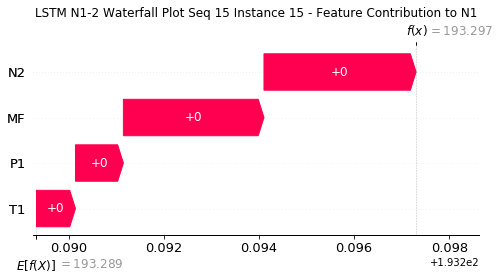

None

Contribution: [0.0010997  0.00090077 0.00348757 0.00322364]


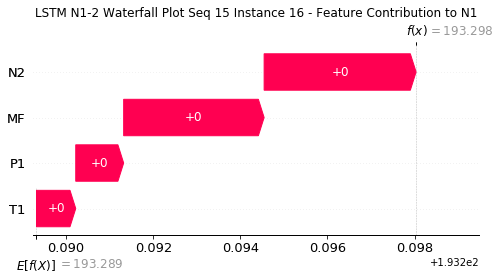

None

Contribution: [0.00125443 0.00101904 0.00397707 0.00366622]


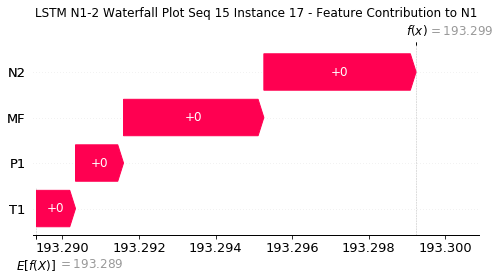

None

Contribution: [0.00152281 0.0012606  0.00483904 0.0044674 ]


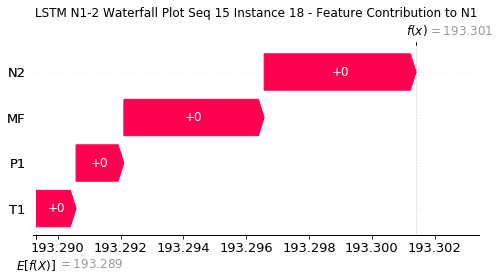

None

Contribution: [0.00203018 0.00168299 0.0064383  0.00595317]


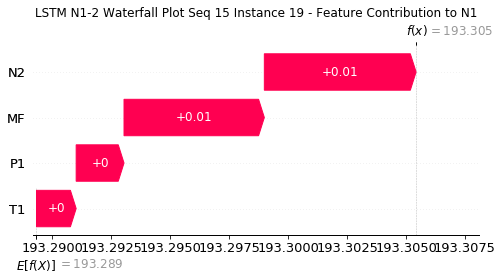

None

Contribution: [0.00301417 0.00249456 0.00954346 0.0088384 ]


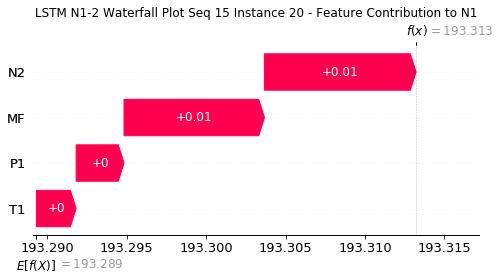

None

Contribution: [0.00499757 0.00411094 0.01577782 0.01465296]


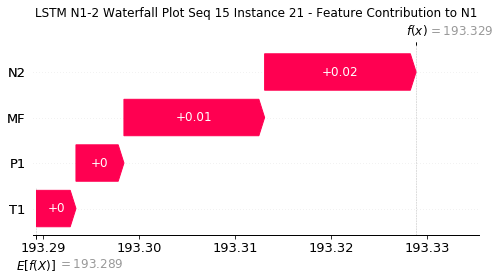

None

Contribution: [0.00890493 0.0073919  0.02821408 0.02616397]


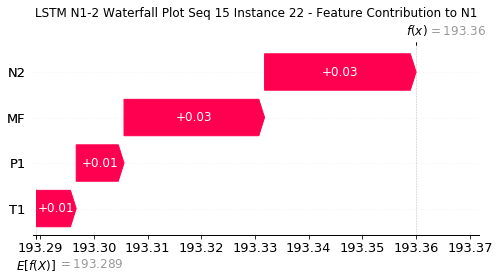

None

Contribution: [0.01589883 0.01349661 0.05107601 0.04734155]


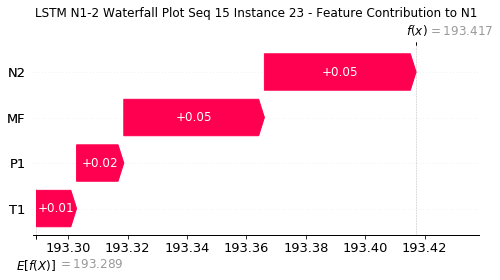

None

Contribution: [0.02883606 0.01705346 0.09231327 0.08965381]


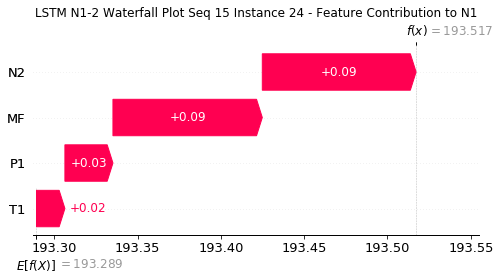

None

Contribution: [0.25443859 0.12309201 0.83952015 0.81945768]


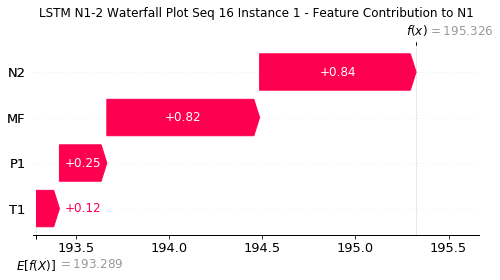

None

Contribution: [0.01482862 0.011869   0.04517339 0.04314132]


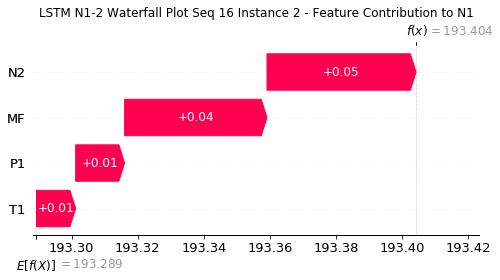

None

Contribution: [0.0025374  0.00222076 0.00834587 0.00743883]


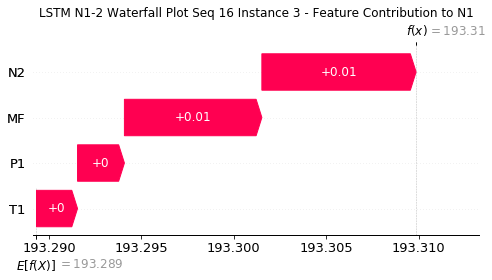

None

Contribution: [0.0013641  0.00112614 0.00440367 0.00401076]


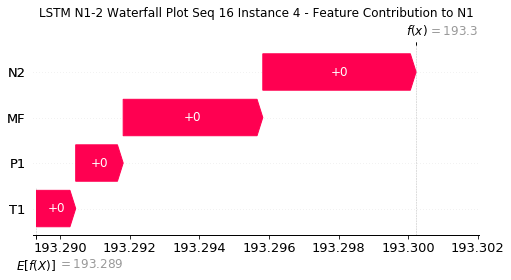

None

Contribution: [0.00112903 0.00093732 0.00357079 0.00329576]


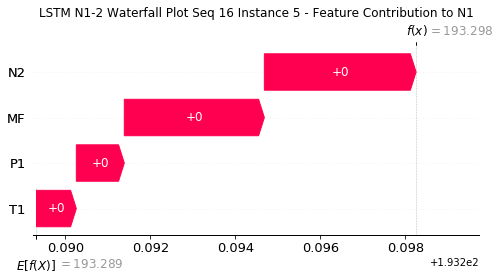

None

Contribution: [0.00095289 0.00079683 0.00304495 0.00279883]


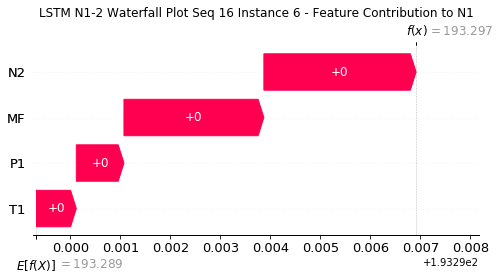

None

Contribution: [0.00090442 0.00074641 0.00290017 0.00267052]


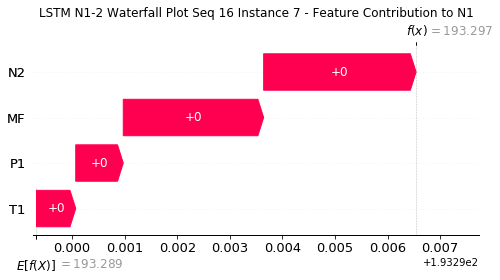

None

Contribution: [0.00088927 0.0007587  0.0028517  0.00261189]


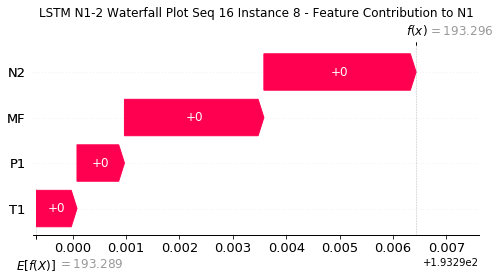

None

Contribution: [0.00089452 0.00073225 0.00283484 0.00262103]


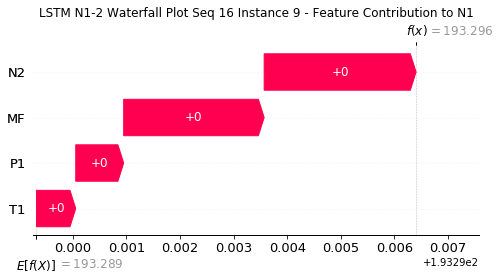

None

Contribution: [0.00089002 0.00073745 0.00281866 0.00260597]


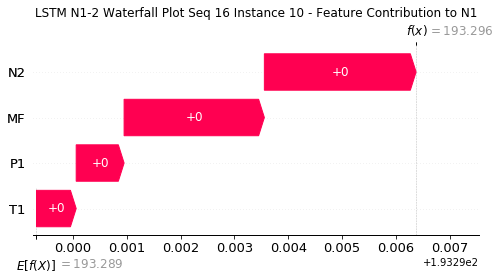

None

Contribution: [0.00089022 0.00073883 0.00282633 0.00261099]


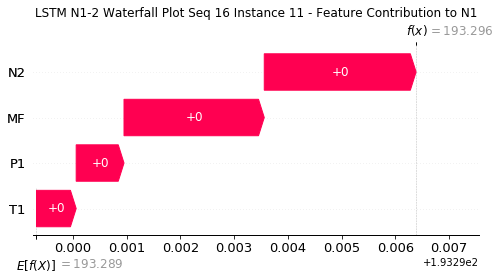

None

Contribution: [0.00089695 0.00077263 0.00285212 0.00262382]


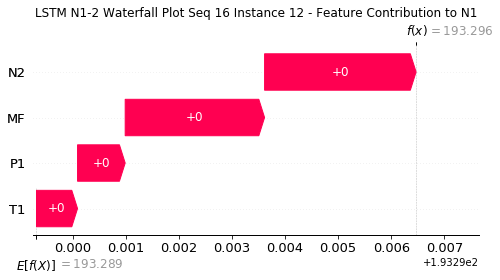

None

Contribution: [0.00092086 0.00076422 0.00291797 0.00270122]


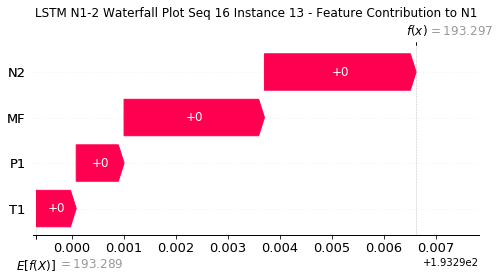

None

Contribution: [0.00095562 0.00079529 0.0030223  0.00278719]


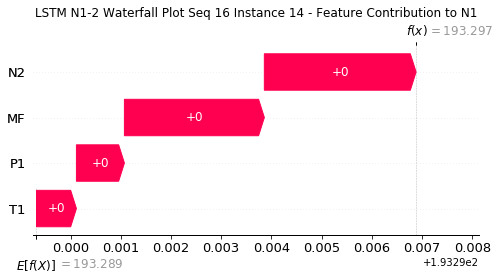

None

Contribution: [0.00100945 0.00083787 0.00320367 0.00296958]


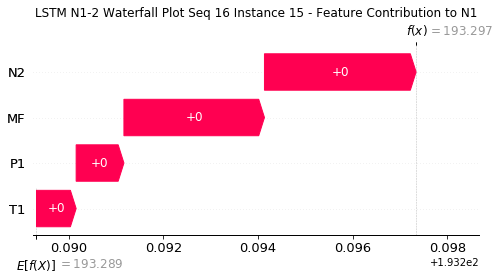

None

Contribution: [0.00109905 0.00091582 0.0034917  0.00323474]


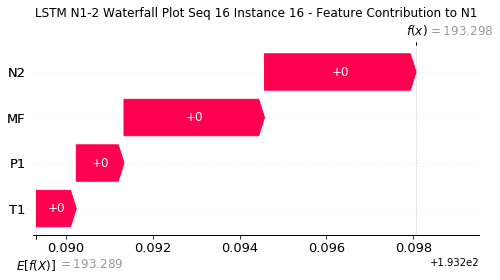

None

Contribution: [0.00125585 0.00101843 0.00397932 0.00366665]


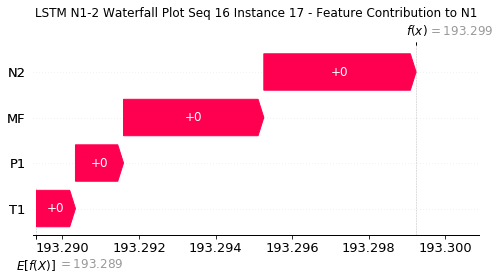

None

Contribution: [0.00151632 0.00127488 0.00484366 0.004485  ]


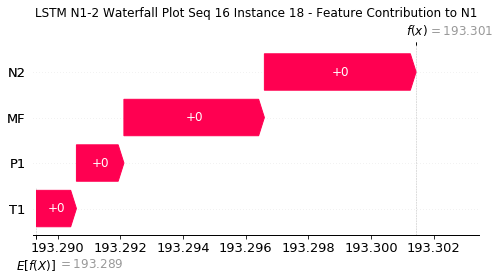

None

Contribution: [0.00202036 0.00170287 0.00644296 0.00597124]


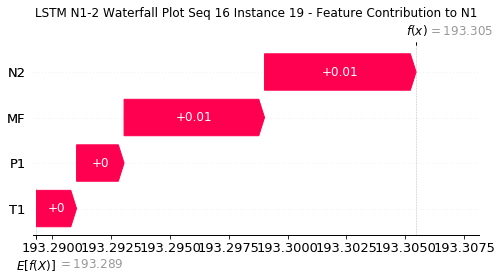

None

Contribution: [0.00299932 0.00253933 0.00955021 0.00886316]


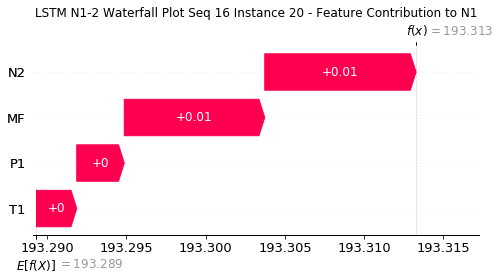

None

Contribution: [0.00497893 0.00421954 0.01578906 0.01469257]


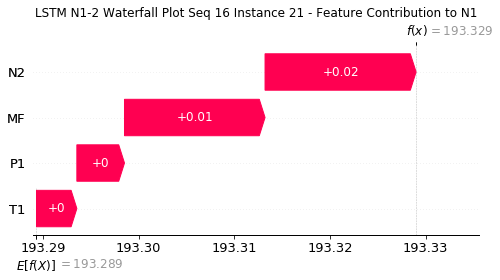

None

Contribution: [0.00886878 0.00772153 0.02824579 0.0262526 ]


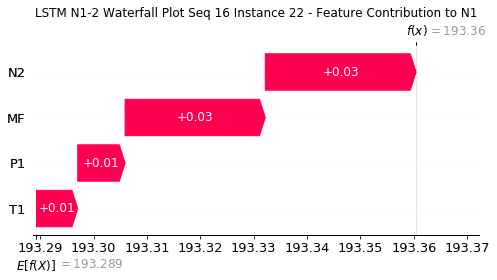

None

Contribution: [0.01612098 0.01452373 0.05110388 0.04722157]


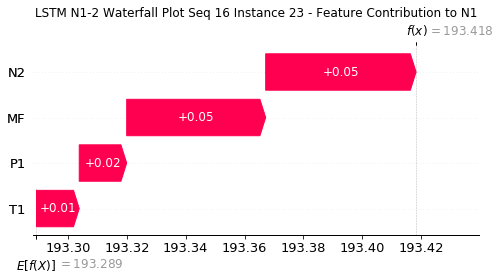

None

Contribution: [0.02901739 0.01531514 0.09201582 0.08846019]


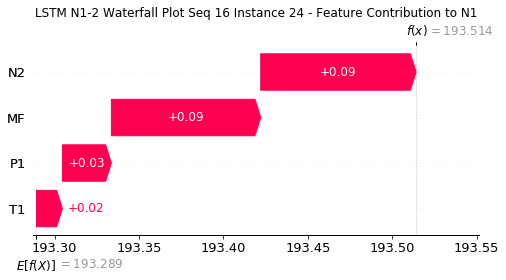

None

Contribution: [0.25845535 0.12370729 0.83873101 0.81964655]


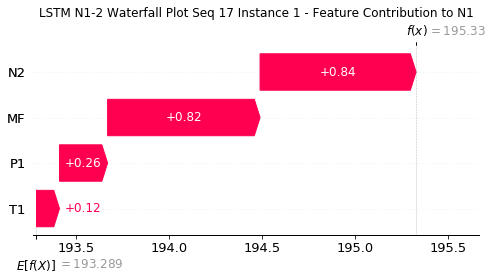

None

Contribution: [0.01482492 0.01150073 0.04526471 0.04363372]


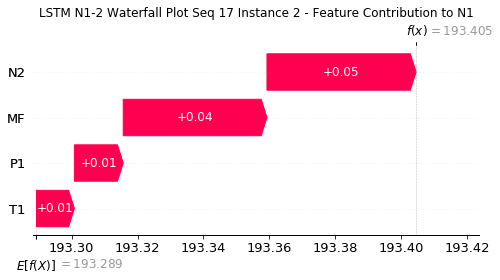

None

Contribution: [0.00256769 0.0021205  0.00836206 0.00749131]


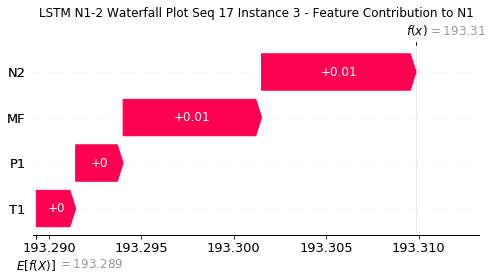

None

Contribution: [0.00137271 0.00106095 0.00440584 0.00402603]


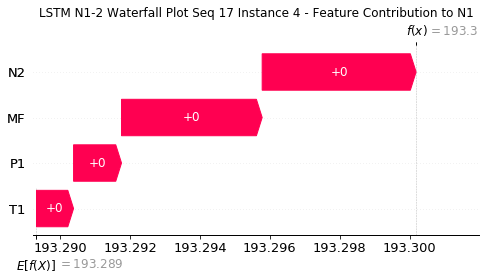

None

Contribution: [0.00112534 0.00091862 0.00357386 0.00329417]


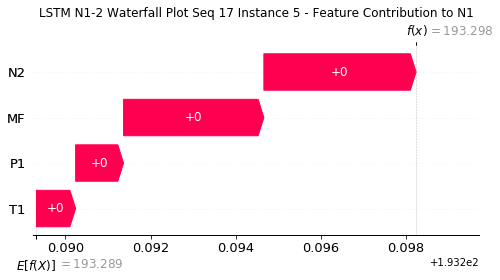

None

Contribution: [0.00095799 0.00076073 0.00304911 0.00280926]


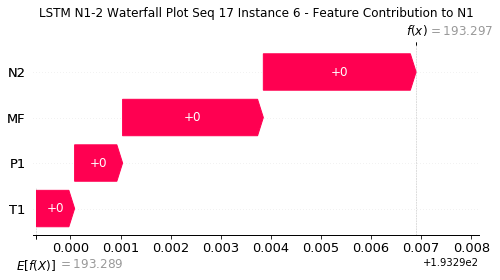

None

Contribution: [0.00090905 0.00074305 0.00290678 0.00268019]


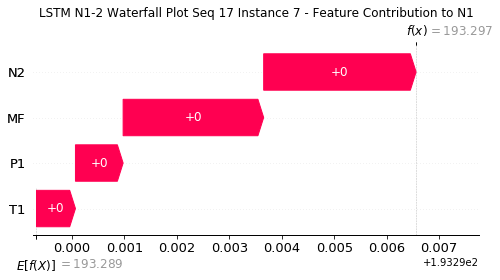

None

Contribution: [0.0008976  0.00072158 0.00286803 0.00265875]


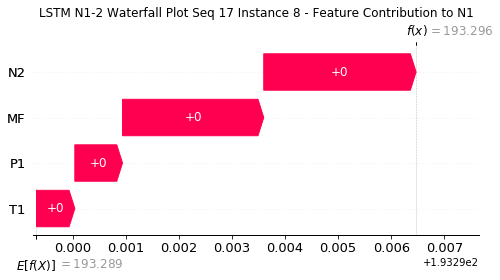

None

Contribution: [0.00088519 0.00071259 0.00283453 0.00261137]


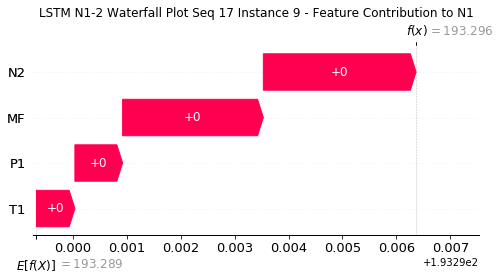

None

Contribution: [0.00088143 0.00068954 0.00281395 0.00258795]


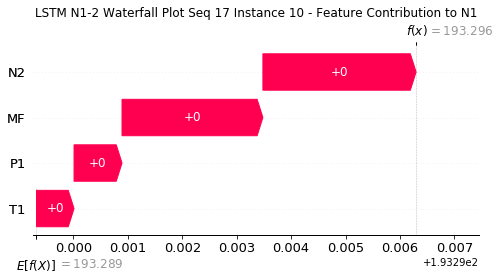

None

Contribution: [0.00088537 0.00069429 0.00282344 0.00259737]


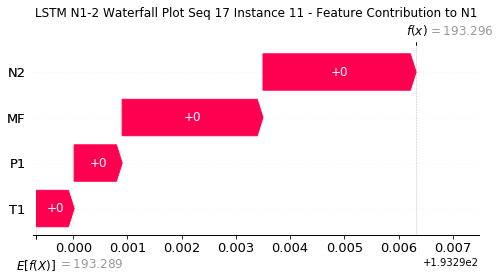

None

Contribution: [0.0008928  0.00072502 0.00285433 0.00262538]


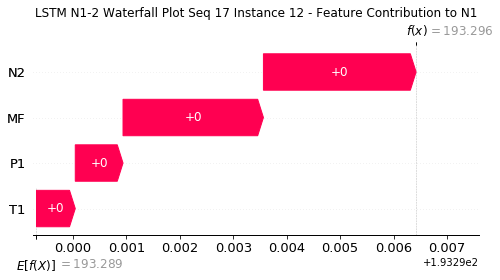

None

Contribution: [0.00091405 0.00071843 0.00291346 0.00267897]


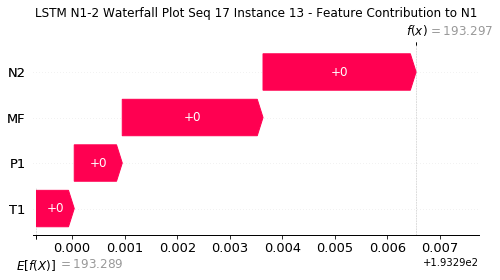

None

Contribution: [0.0009562  0.00074197 0.0030248  0.00282162]


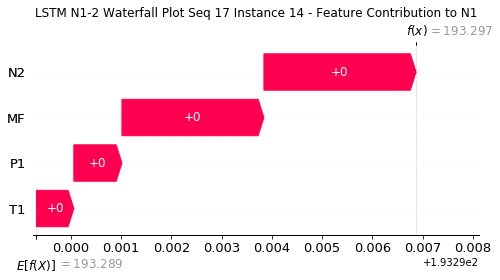

None

Contribution: [0.00100339 0.00079165 0.00319923 0.00294223]


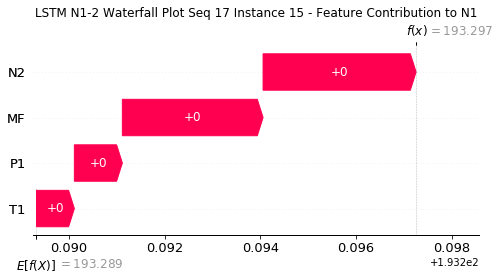

None

Contribution: [0.00109533 0.00086494 0.00349058 0.00321406]


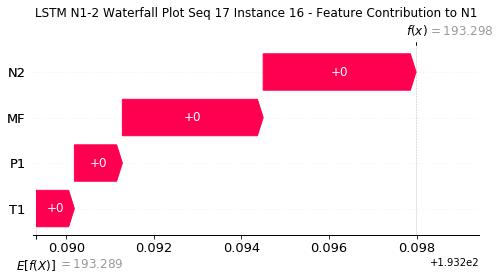

None

Contribution: [0.00125528 0.00098964 0.00397839 0.00370165]


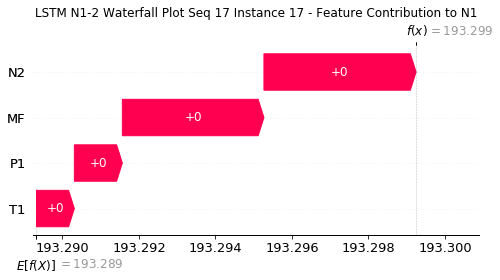

None

Contribution: [0.00152971 0.00122552 0.00484928 0.00447283]


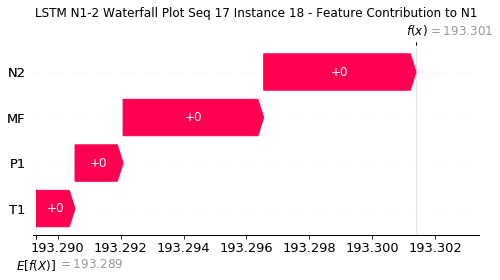

None

Contribution: [0.00203754 0.00163256 0.00645258 0.0059582 ]


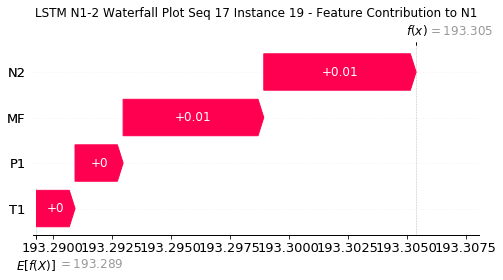

None

Contribution: [0.00302546 0.00243264 0.00956142 0.00883432]


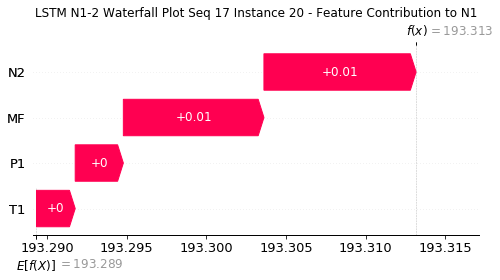

None

Contribution: [0.0049895  0.00401053 0.01580016 0.01461683]


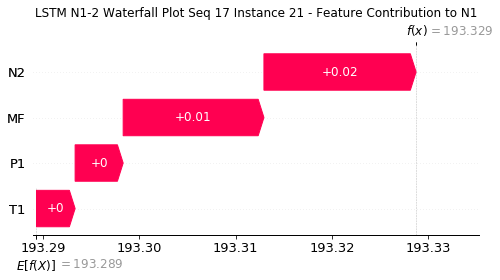

None

Contribution: [0.00896886 0.00729788 0.02828037 0.0262654 ]


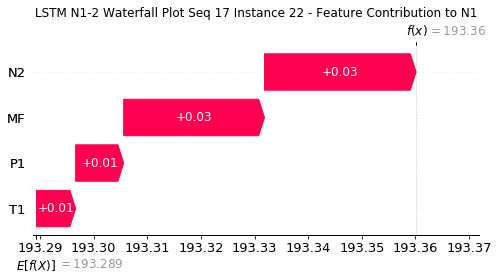

None

Contribution: [0.01643691 0.01328231 0.05128736 0.04823829]


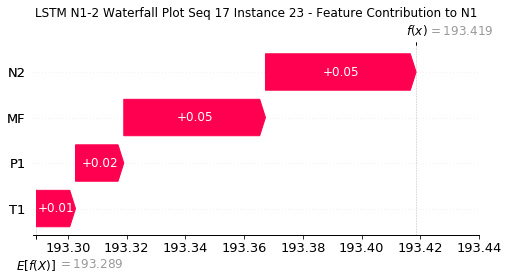

None

Contribution: [0.02860757 0.01129127 0.09185408 0.0878505 ]


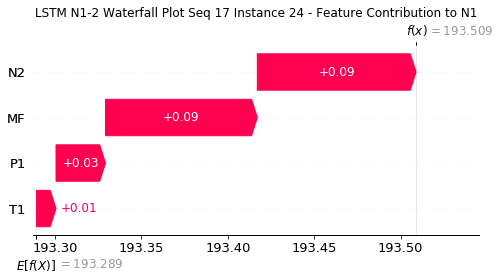

None

Contribution: [0.25663491 0.08830588 0.83945586 0.79896208]


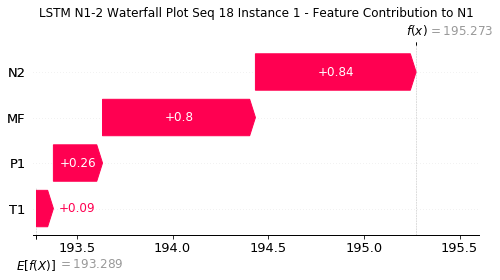

None

Contribution: [0.01496426 0.01127564 0.04583529 0.04350164]


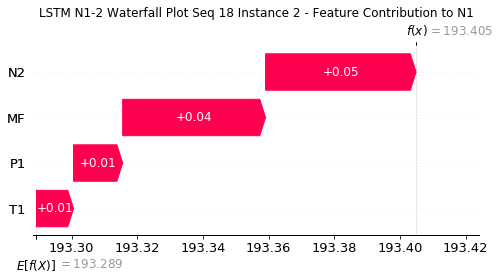

None

Contribution: [0.00258925 0.00204444 0.0084336  0.00752075]


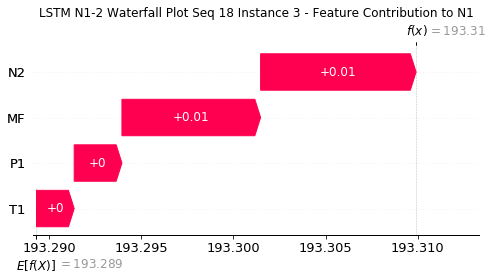

None

Contribution: [0.00137077 0.00101156 0.00439378 0.00399276]


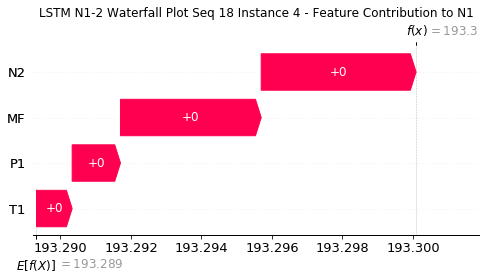

None

Contribution: [0.00112007 0.00087868 0.00358061 0.00327512]


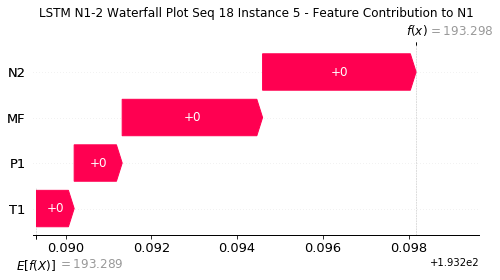

None

Contribution: [0.00095828 0.00072842 0.00304928 0.0027915 ]


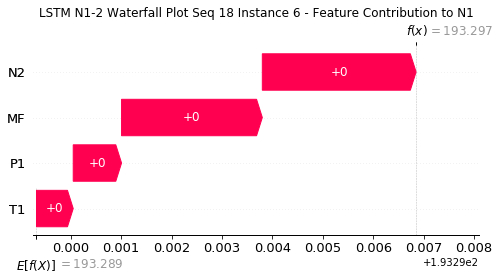

None

Contribution: [0.0008969  0.00067561 0.00289684 0.00263562]


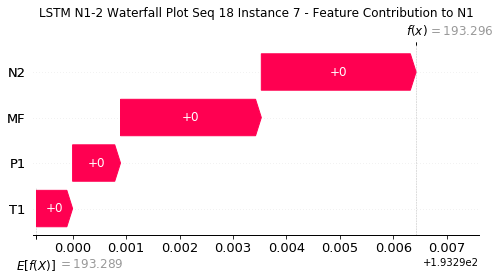

None

Contribution: [0.00089917 0.00066806 0.00286217 0.00262513]


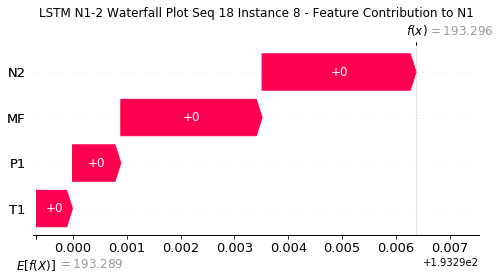

None

Contribution: [0.00087926 0.00066591 0.00282951 0.00258229]


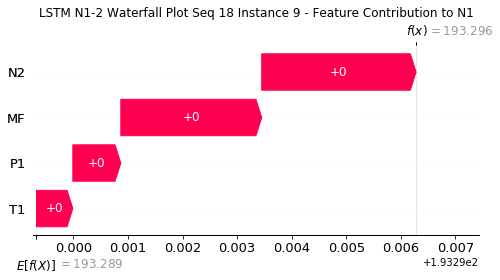

None

Contribution: [0.00088767 0.00067661 0.00282293 0.00258755]


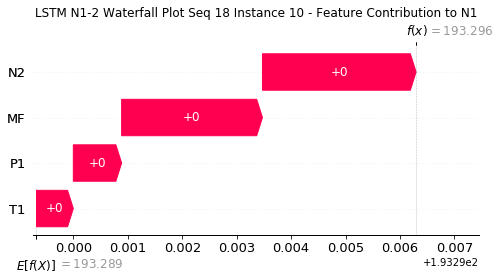

None

Contribution: [0.00089091 0.00067733 0.00283116 0.002594  ]


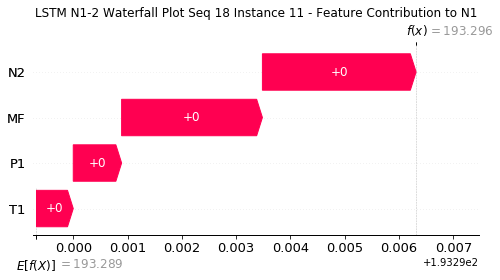

None

Contribution: [0.00089516 0.00068929 0.00284925 0.00260059]


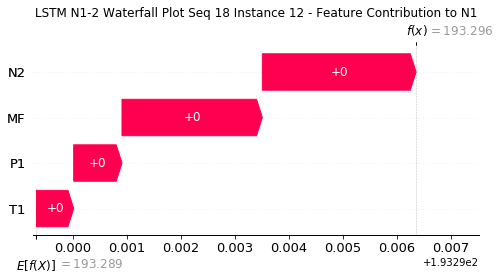

None

Contribution: [0.00092193 0.00070438 0.00292512 0.0026844 ]


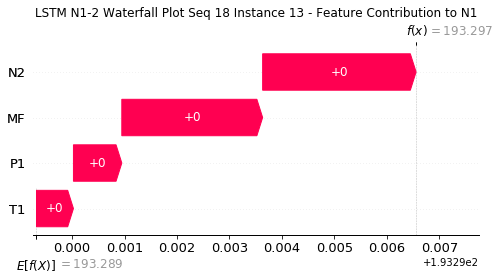

None

Contribution: [0.00095762 0.00075287 0.00303365 0.00277261]


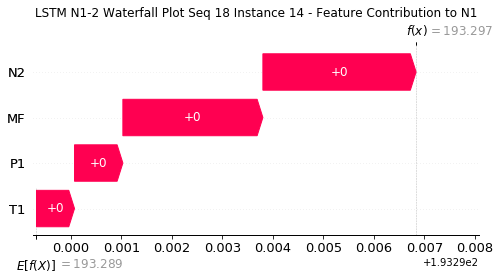

None

Contribution: [0.00101367 0.00077711 0.00321341 0.00294682]


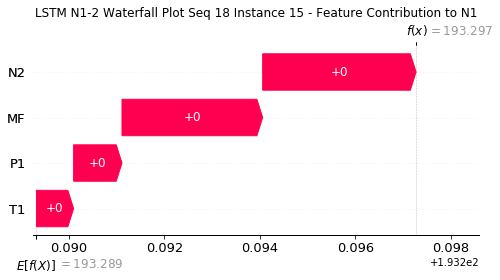

None

Contribution: [0.00110647 0.00084964 0.00350301 0.00320997]


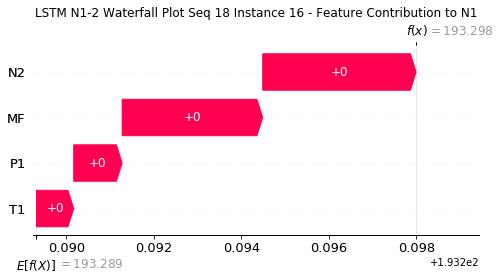

None

Contribution: [0.00125369 0.00093968 0.00399211 0.00364876]


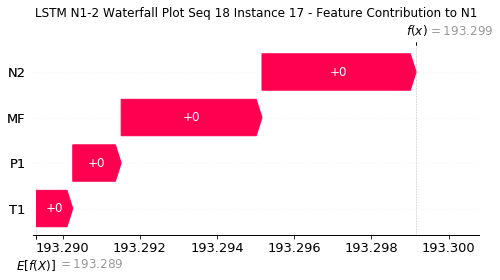

None

Contribution: [0.00154398 0.0011896  0.00486968 0.00447723]


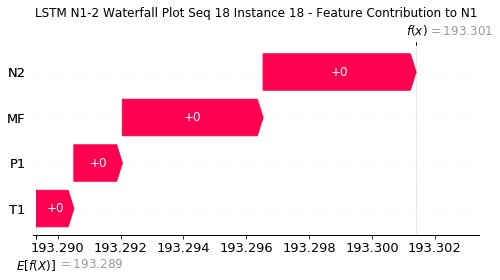

None

Contribution: [0.00205756 0.00159033 0.00648018 0.00596379]


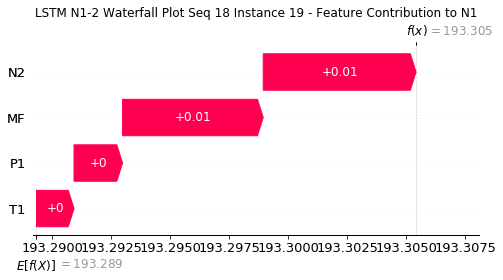

None

Contribution: [0.00305726 0.00237137 0.00961047 0.00887631]


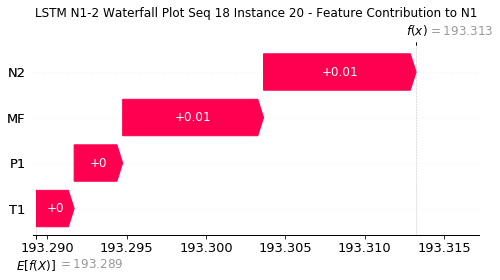

None

Contribution: [0.00504812 0.00394527 0.01587642 0.01466009]


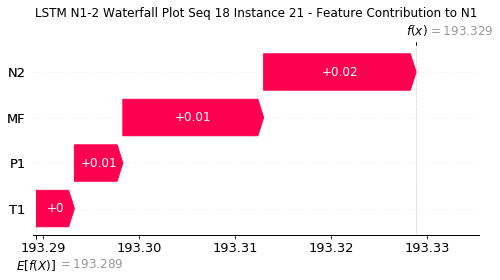

None

Contribution: [0.00902643 0.00708817 0.02838517 0.02627156]


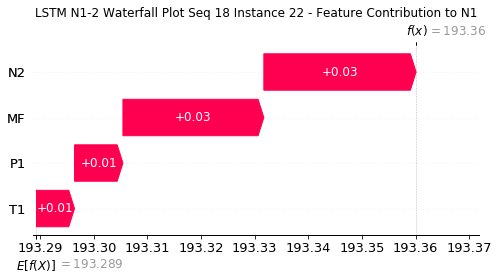

None

Contribution: [0.01612299 0.01273261 0.05130934 0.04761455]


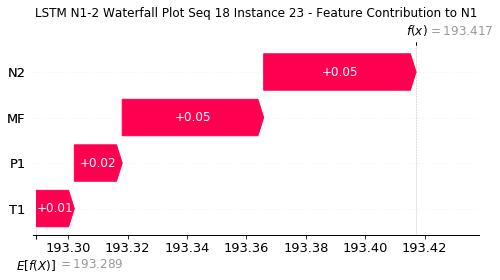

None

Contribution: [0.02887175 0.01142857 0.09250273 0.08863898]


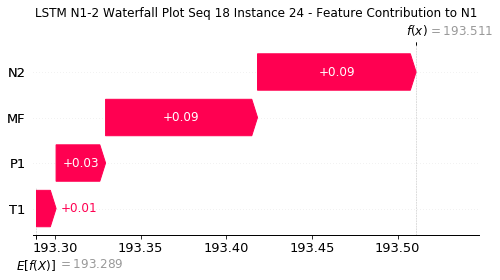

None

Contribution: [0.25919706 0.08687865 0.84593254 0.83383389]


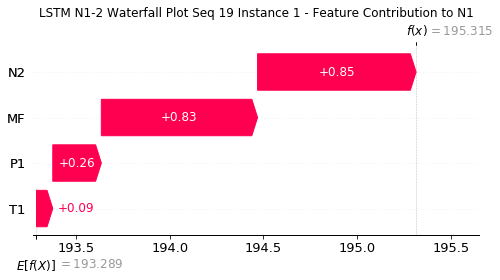

None

Contribution: [0.01494935 0.01127413 0.0454057  0.04369068]


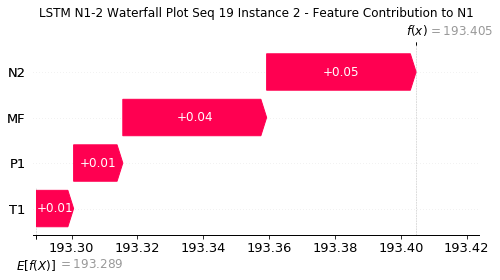

None

Contribution: [0.00259831 0.00217551 0.00836959 0.00752087]


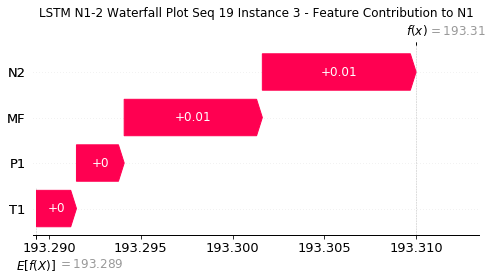

None

Contribution: [0.00139209 0.00109837 0.00441521 0.00404559]


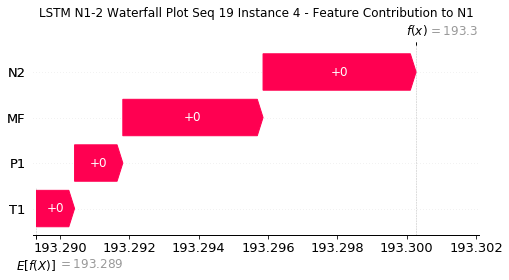

None

Contribution: [0.00114629 0.00089412 0.00357031 0.00328651]


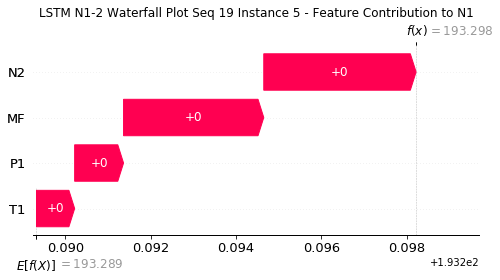

None

Contribution: [0.00097124 0.0007785  0.00305291 0.00281953]


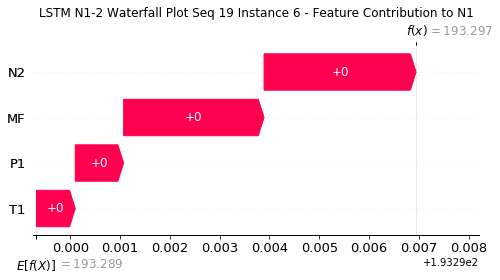

None

Contribution: [0.00093151 0.00073918 0.00291592 0.00269995]


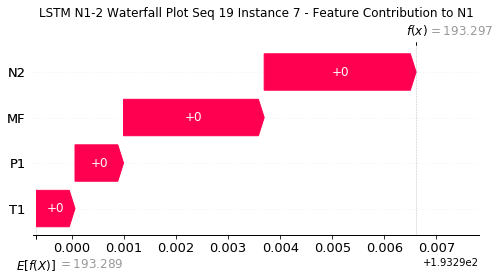

None

Contribution: [0.00092673 0.00071945 0.00287832 0.00269077]


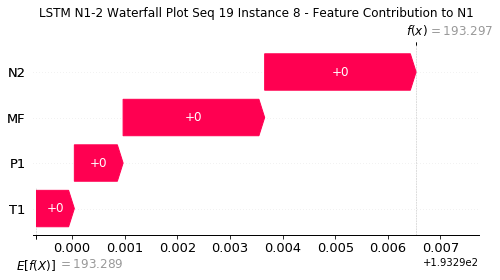

None

Contribution: [0.00090411 0.00074093 0.00284229 0.00262808]


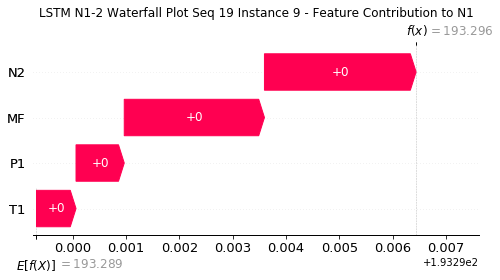

None

Contribution: [0.00089894 0.00071971 0.00282106 0.00260366]


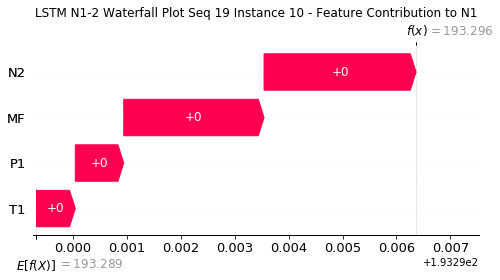

None

Contribution: [0.00090274 0.00071647 0.00283061 0.00261239]


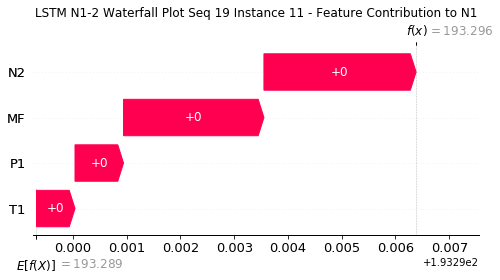

None

Contribution: [0.00092155 0.00072734 0.00286617 0.00266236]


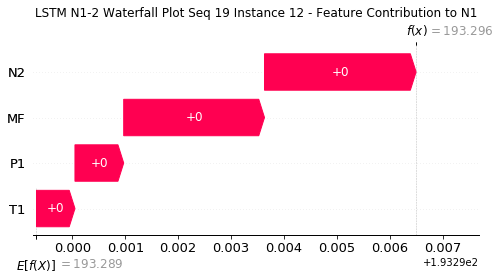

None

Contribution: [0.00093093 0.00074003 0.00291972 0.00269016]


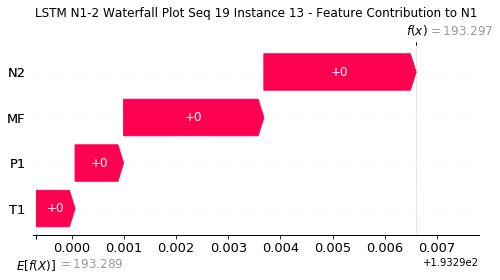

None

Contribution: [0.0009679  0.00075445 0.003031   0.00280807]


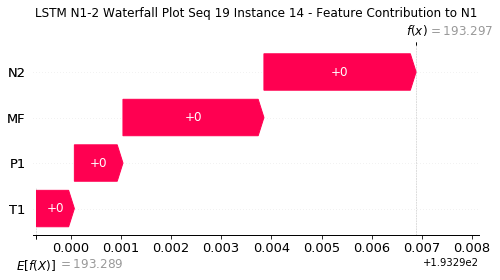

None

Contribution: [0.00101889 0.00080167 0.00320322 0.0029455 ]


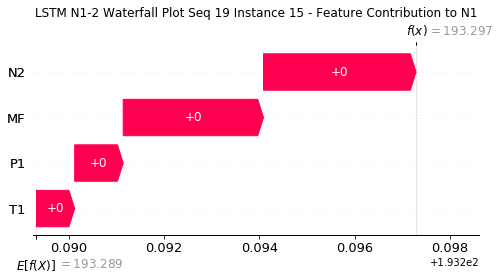

None

Contribution: [0.00110909 0.00087289 0.00349338 0.00321296]


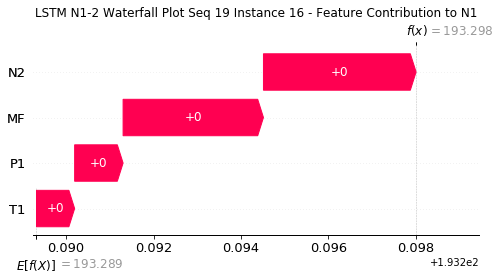

None

Contribution: [0.00127099 0.00099614 0.00400019 0.00370755]


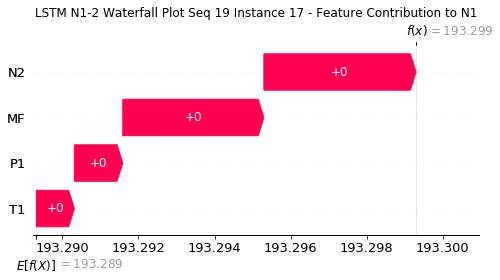

None

Contribution: [0.00154174 0.00120539 0.00485189 0.00445813]


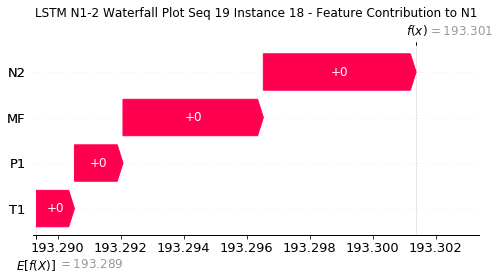

None

Contribution: [0.00205328 0.0016113  0.00645664 0.00594015]


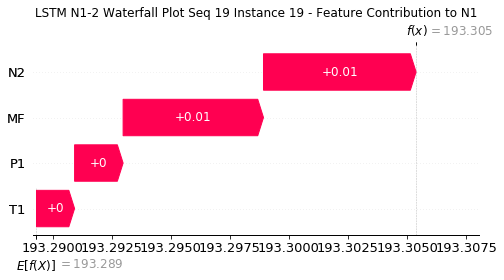

None

Contribution: [0.00305041 0.00241438 0.00957127 0.00881378]


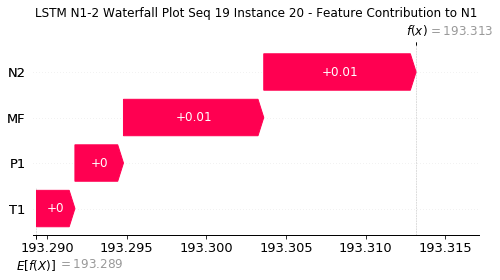

None

Contribution: [0.00503138 0.00401792 0.01581464 0.01457738]


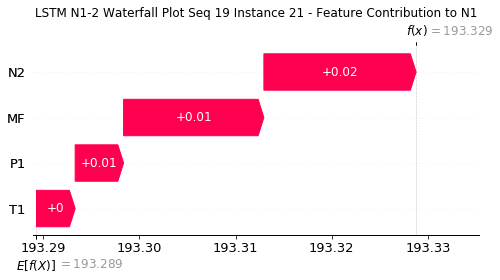

None

Contribution: [0.00896405 0.00722468 0.0282735  0.02601876]


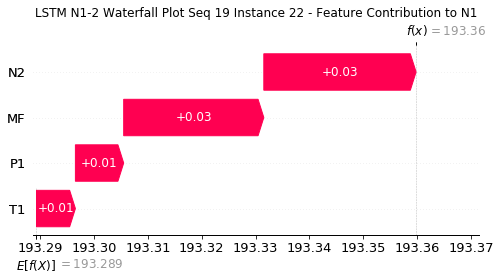

None

Contribution: [0.01624934 0.01317754 0.05126327 0.04770002]


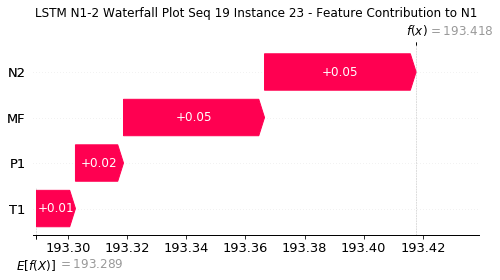

None

Contribution: [0.02979003 0.01253466 0.0925753  0.09029167]


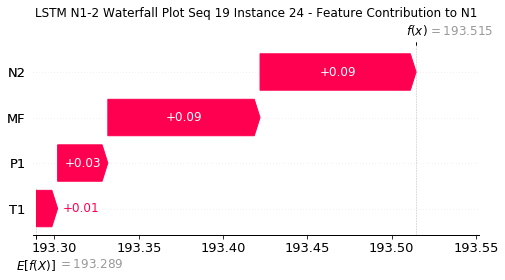

None

Contribution: [0.26567852 0.10001528 0.84321447 0.81510877]


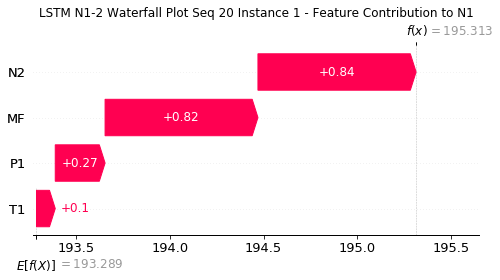

None

Contribution: [0.01474026 0.01116247 0.04545429 0.04295405]


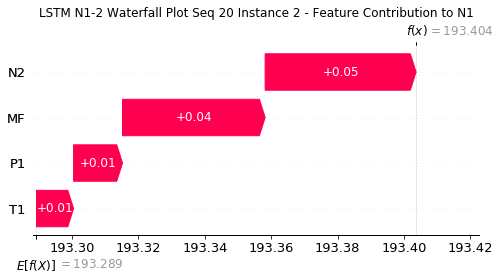

None

Contribution: [0.00259194 0.00210917 0.00838731 0.00748439]


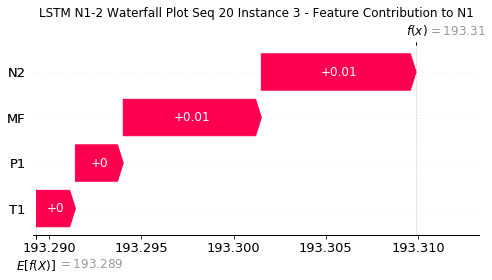

None

Contribution: [0.00138883 0.00105865 0.00440878 0.00402112]


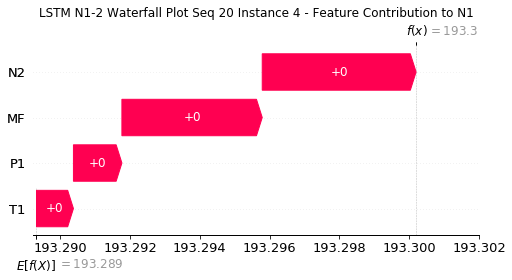

None

Contribution: [0.00113944 0.00089034 0.00357391 0.00327458]


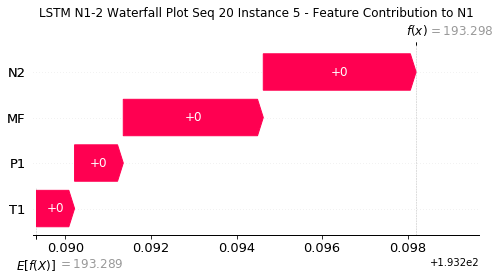

None

Contribution: [0.0009697  0.00075441 0.00305243 0.0028087 ]


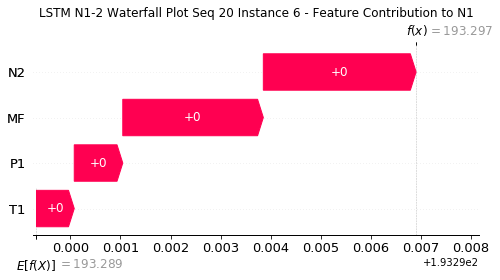

None

Contribution: [0.00092233 0.00070296 0.0029108  0.00268751]


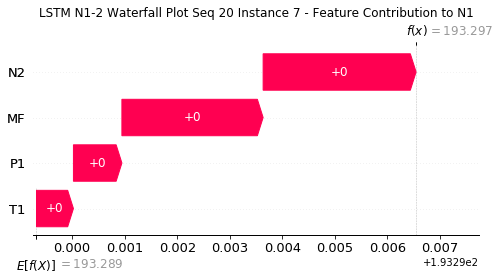

None

Contribution: [0.00091169 0.00070249 0.00286503 0.00262787]


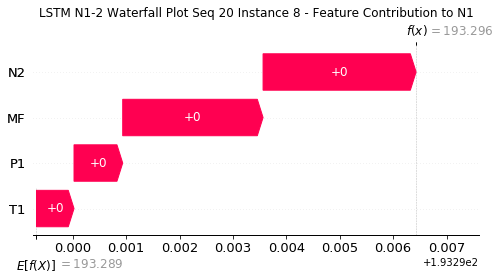

None

Contribution: [0.00090549 0.0007016  0.00284568 0.00263072]


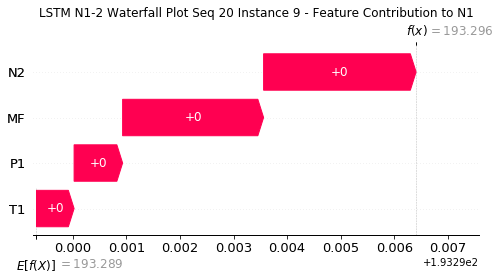

None

Contribution: [0.0008964  0.0006959  0.002818   0.00258907]


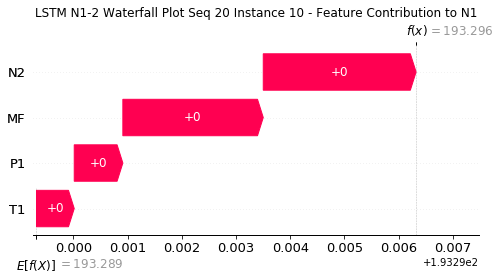

None

Contribution: [0.00089928 0.00069444 0.00282624 0.00259743]


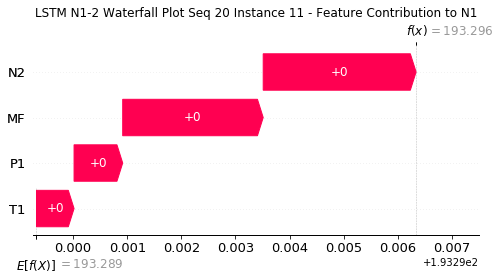

None

Contribution: [0.00091538 0.00073691 0.00284922 0.0026184 ]


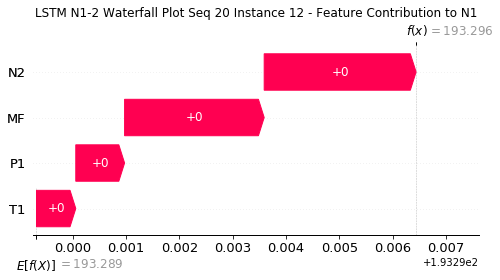

None

Contribution: [0.00092821 0.00071862 0.0029147  0.00267682]


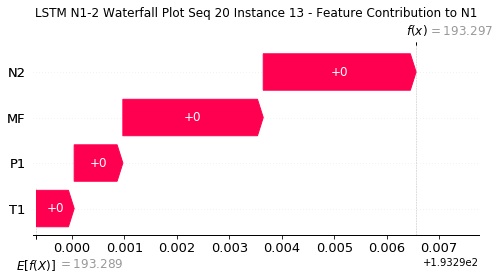

None

Contribution: [0.00095384 0.0007438  0.00301721 0.00276033]


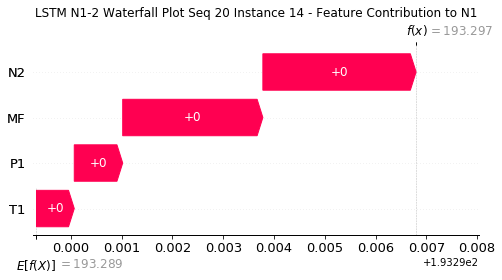

None

Contribution: [0.00102177 0.00078595 0.0032018  0.002949  ]


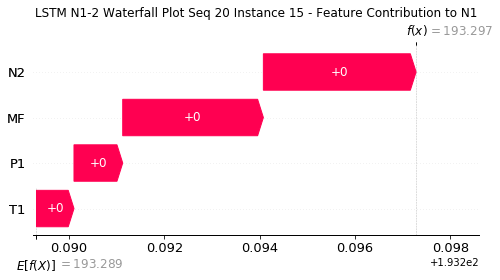

None

Contribution: [0.00111706 0.00085979 0.00349408 0.00322743]


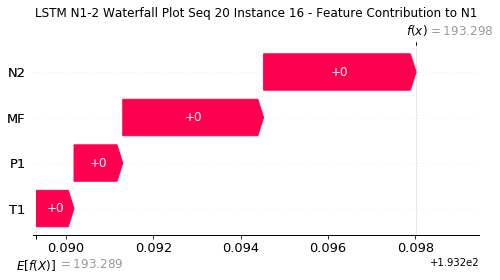

None

Contribution: [0.00128226 0.0009681  0.0039816  0.00368121]


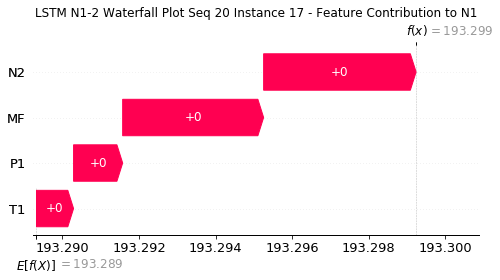

None

Contribution: [0.00154918 0.00119132 0.00484924 0.004478  ]


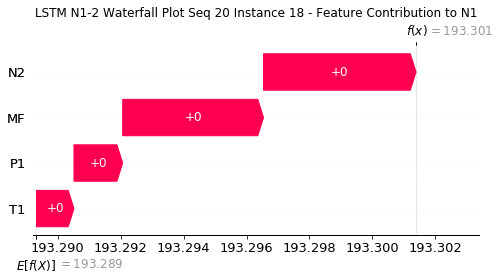

None

Contribution: [0.00206363 0.001594   0.00645348 0.00596714]


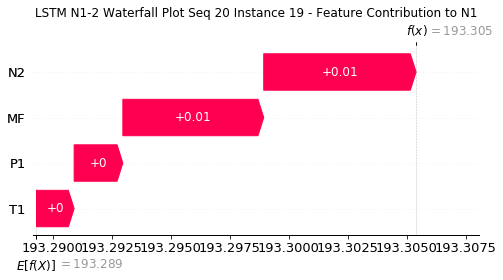

None

Contribution: [0.00305329 0.00237756 0.00955907 0.00882006]


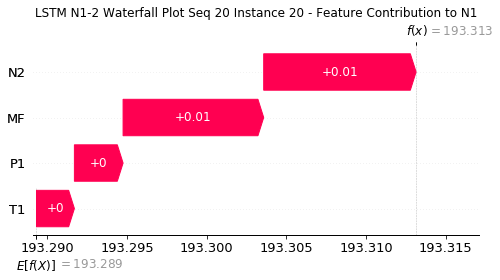

None

Contribution: [0.0050594  0.00396405 0.01580027 0.01462538]


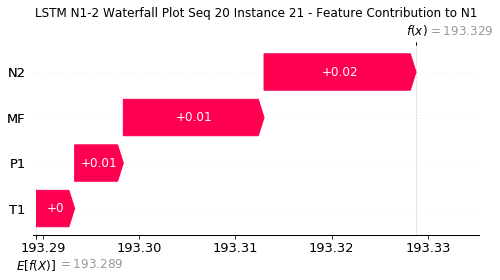

None

Contribution: [0.00900712 0.00713995 0.02822971 0.02604685]


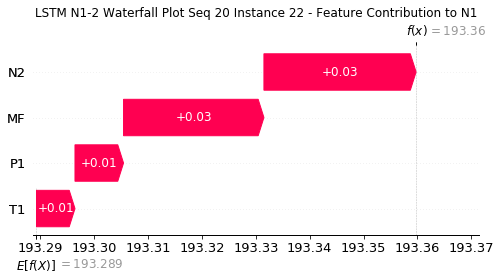

None

Contribution: [0.01616453 0.01352176 0.05111828 0.04691897]


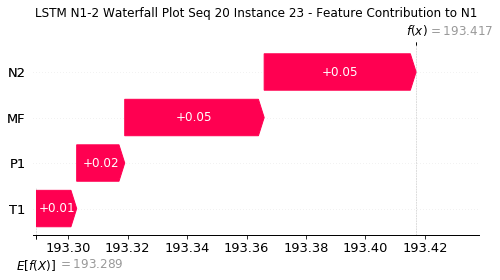

None

Contribution: [0.02966375 0.01429515 0.09216718 0.08855083]


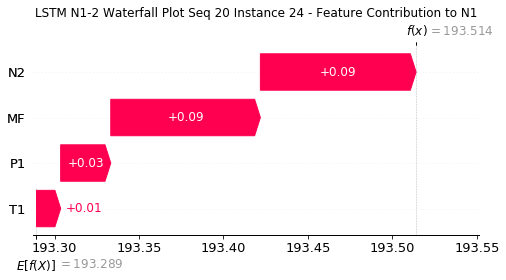

None

Contribution: [0.26019846 0.11286005 0.83858351 0.78704799]


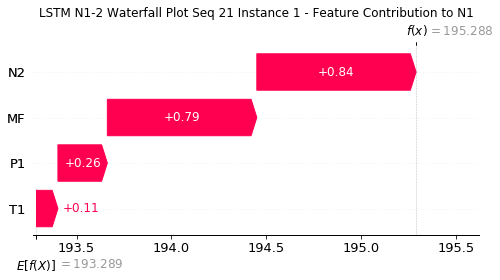

None

Contribution: [0.01516427 0.01161232 0.04569947 0.04377595]


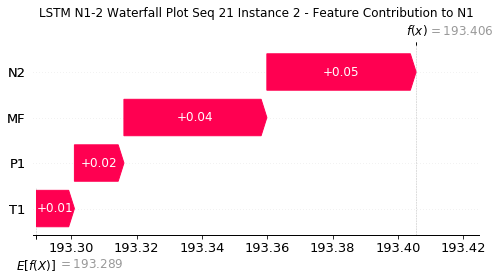

None

Contribution: [0.00259112 0.00212933 0.00840753 0.00748172]


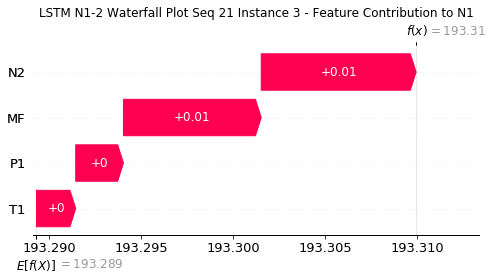

None

Contribution: [0.00137906 0.00106764 0.00440259 0.00400206]


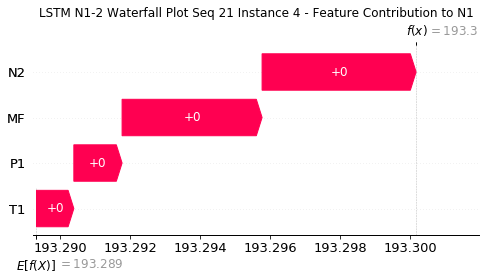

None

Contribution: [0.00114661 0.00084022 0.00356305 0.00328193]


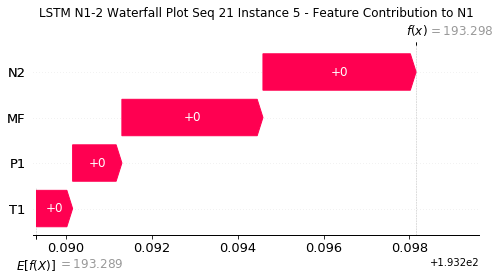

None

Contribution: [0.00096692 0.0007651  0.00305059 0.00280168]


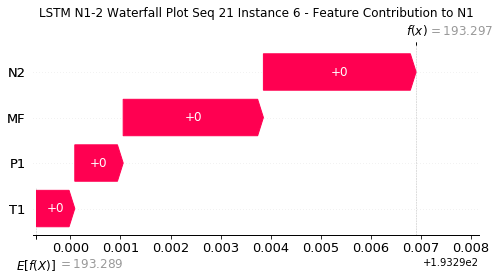

None

Contribution: [0.00093277 0.00074009 0.00290908 0.00268302]


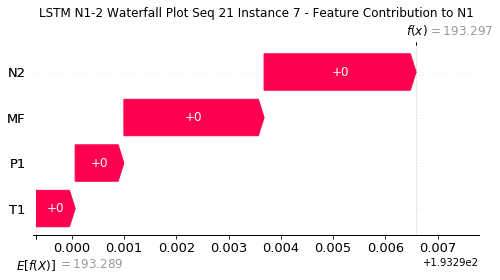

None

Contribution: [0.00091772 0.00075435 0.00286881 0.00264722]


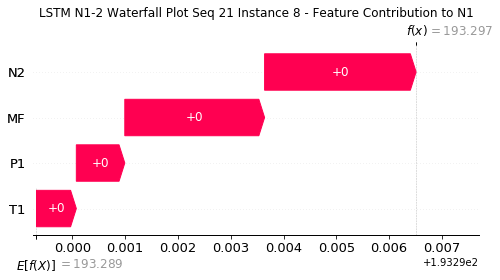

None

Contribution: [0.00090558 0.00074155 0.00284275 0.00262895]


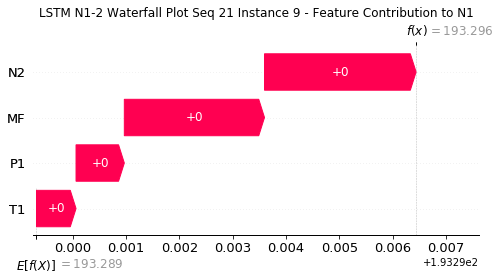

None

Contribution: [0.00088628 0.00070049 0.00281807 0.00258529]


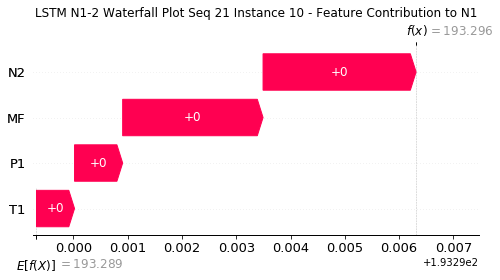

None

Contribution: [0.00089225 0.00070095 0.00282769 0.00259562]


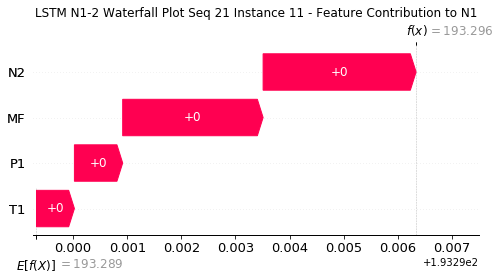

None

Contribution: [0.00092351 0.00071756 0.00286985 0.00266962]


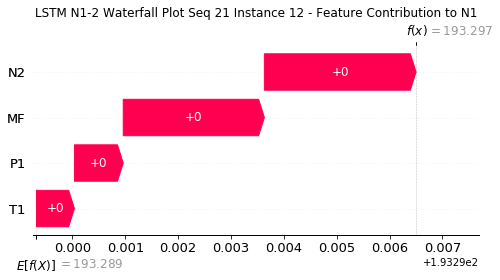

None

Contribution: [0.00092353 0.00072687 0.00291916 0.00268675]


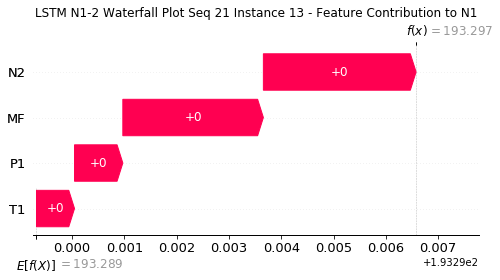

None

Contribution: [0.00097066 0.00075953 0.00303207 0.00279419]


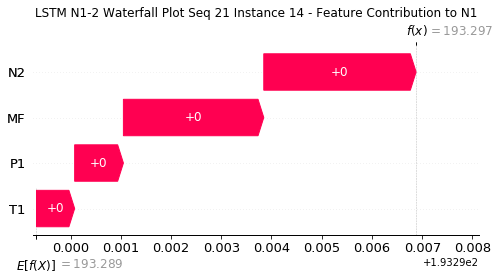

None

Contribution: [0.00103379 0.00076976 0.00321639 0.0029905 ]


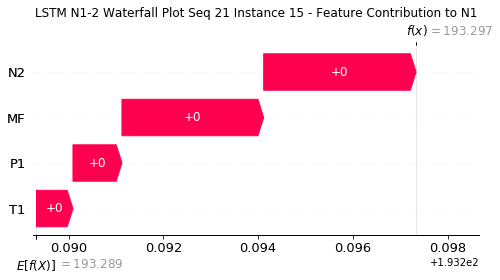

None

Contribution: [0.00112173 0.00084309 0.0035065  0.00324356]


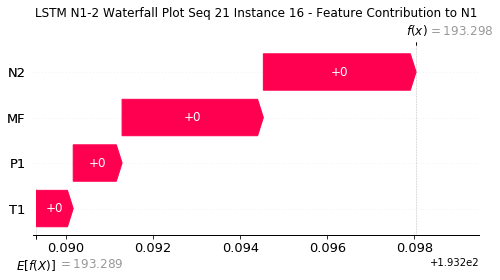

None

Contribution: [0.00127786 0.00095207 0.00400067 0.00369514]


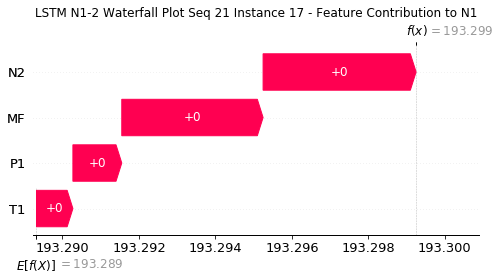

None

Contribution: [0.00156671 0.00118119 0.00487498 0.00451749]


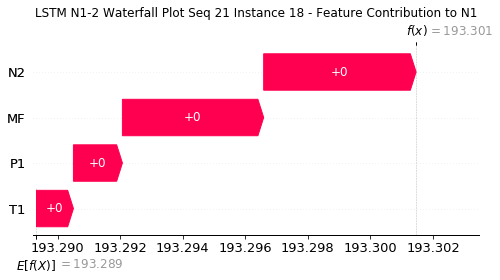

None

Contribution: [0.00206571 0.00154024 0.00647741 0.00598236]


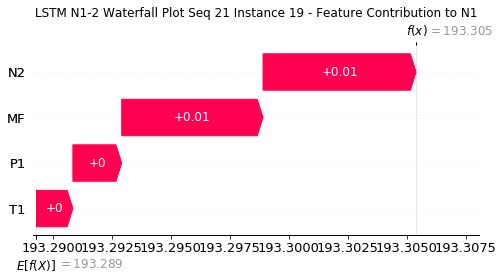

None

Contribution: [0.00306    0.00228769 0.00960888 0.00887743]


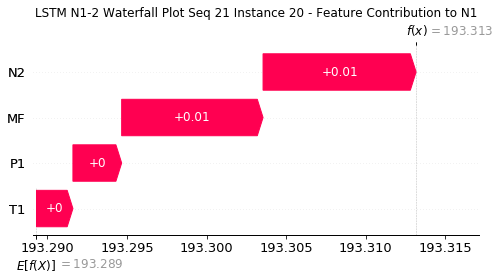

None

Contribution: [0.00504015 0.00378353 0.01586103 0.01468062]


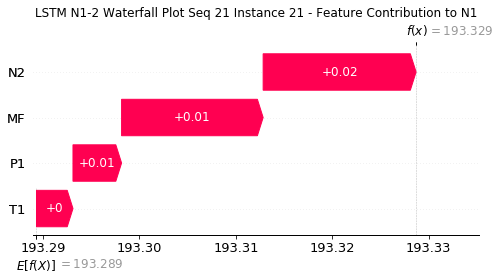

None

Contribution: [0.00900445 0.00672824 0.02837169 0.02625178]


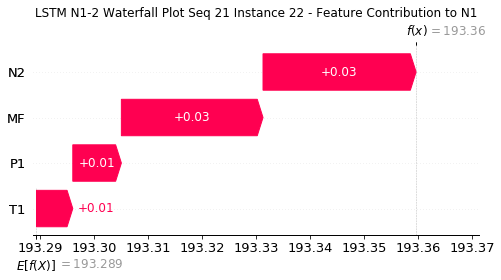

None

Contribution: [0.01629985 0.01187632 0.05132198 0.04756652]


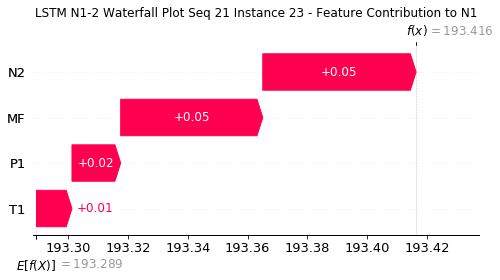

None

Contribution: [0.03084725 0.00816993 0.09281758 0.09087807]


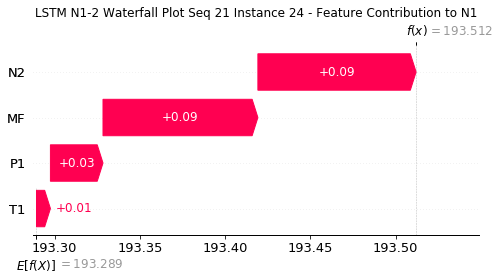

None

Contribution: [0.26257868 0.0423636  0.84356686 0.83119552]


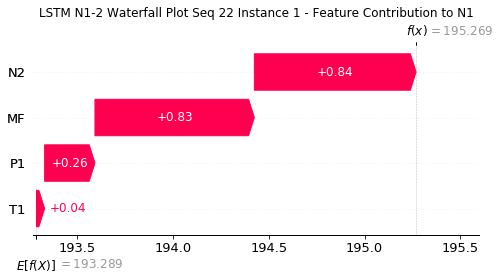

None

Contribution: [0.01509968 0.01044078 0.04581349 0.0441874 ]


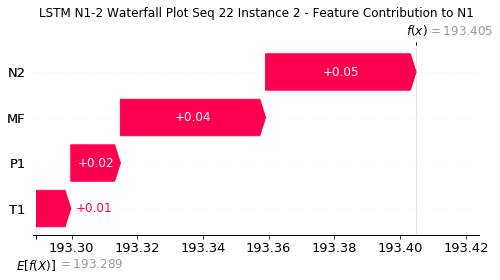

None

Contribution: [0.00262824 0.00190942 0.00840143 0.00757828]


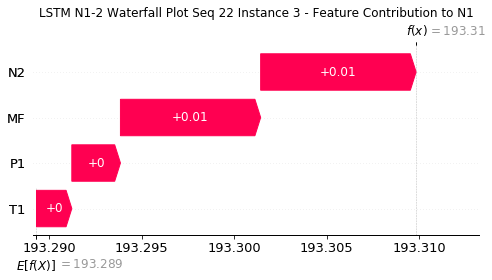

None

Contribution: [0.00138044 0.00101488 0.00437144 0.00401484]


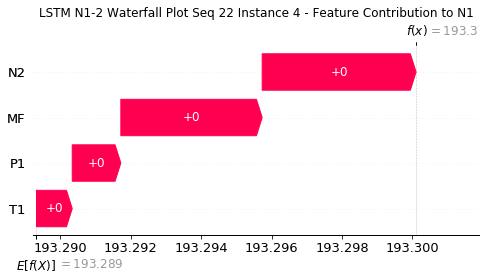

None

Contribution: [0.00112825 0.00085178 0.00355165 0.00328243]


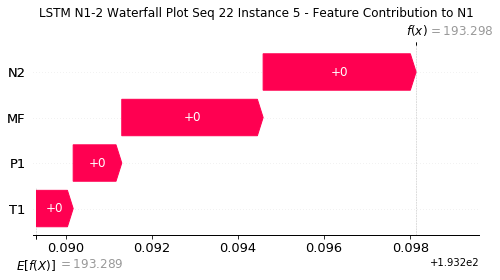

None

Contribution: [0.00097397 0.00075199 0.00303769 0.00279377]


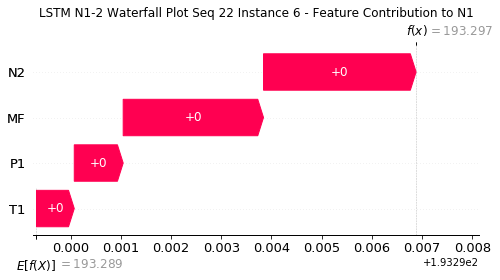

None

Contribution: [0.0009216  0.00070831 0.00289789 0.00268897]


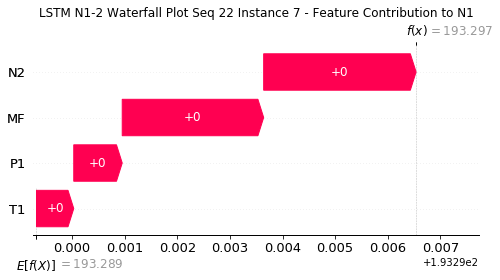

None

Contribution: [0.00091834 0.00074269 0.00286813 0.00268113]


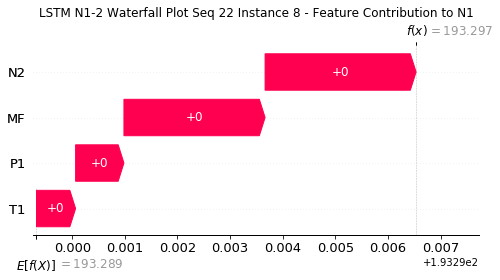

None

Contribution: [0.00091381 0.00071649 0.00283985 0.00265561]


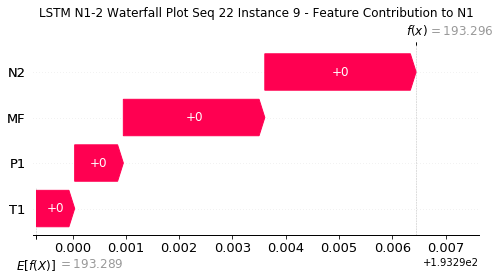

None

Contribution: [0.00089372 0.00071222 0.00282083 0.00263383]


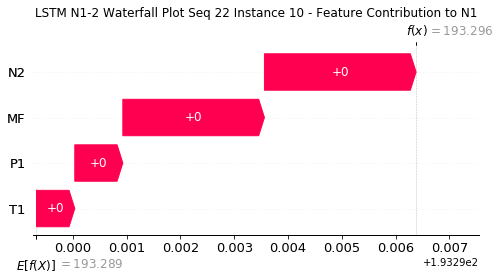

None

Contribution: [0.00089357 0.00069609 0.00282188 0.00261845]


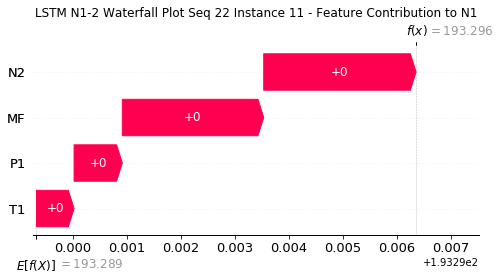

None

Contribution: [0.00090624 0.00070952 0.00285446 0.0026512 ]


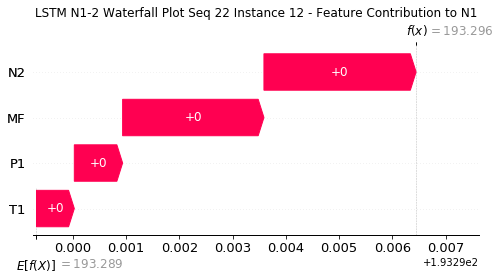

None

Contribution: [0.00094575 0.00072726 0.00293571 0.0027807 ]


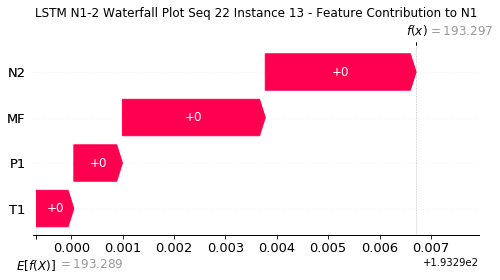

None

Contribution: [0.00095914 0.00075345 0.00302569 0.00280975]


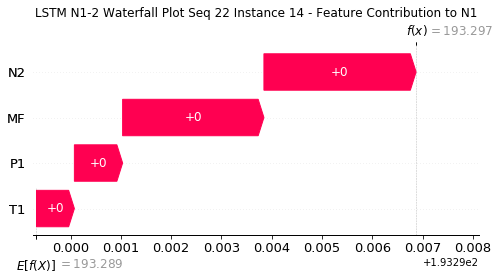

None

Contribution: [0.00101388 0.00079763 0.00320217 0.00295702]


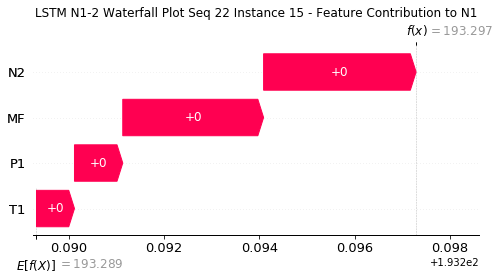

None

Contribution: [0.00111652 0.00088416 0.00350193 0.00325662]


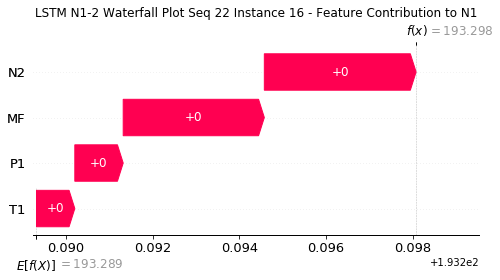

None

Contribution: [0.00127489 0.00100512 0.00399515 0.00372156]


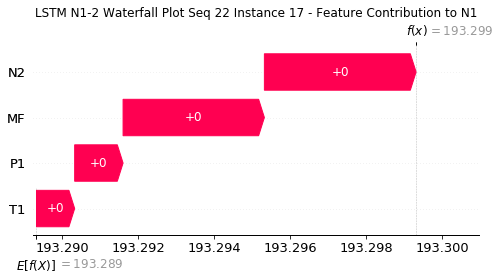

None

Contribution: [0.00157865 0.00123544 0.00486148 0.0045229 ]


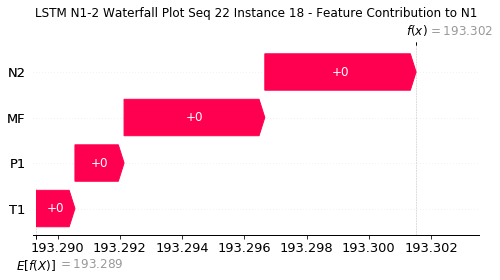

None

Contribution: [0.0020742  0.00164141 0.00647238 0.00602512]


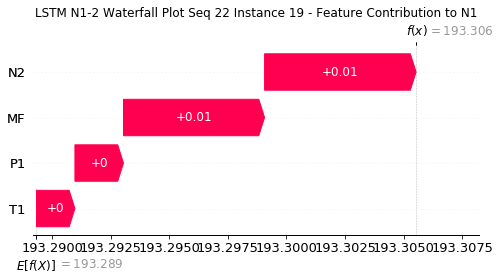

None

Contribution: [0.00307231 0.00244205 0.00960135 0.00895022]


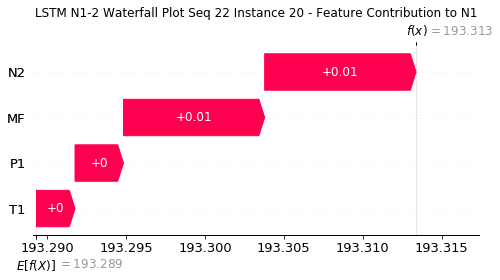

None

Contribution: [0.00505293 0.00403364 0.01585928 0.01477461]


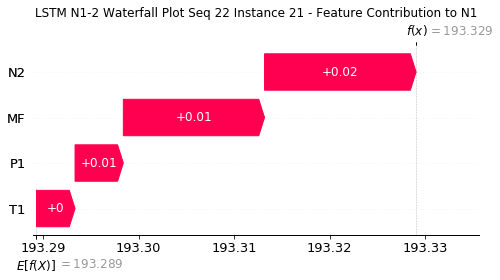

None

Contribution: [0.00903045 0.00725836 0.02838321 0.02650325]


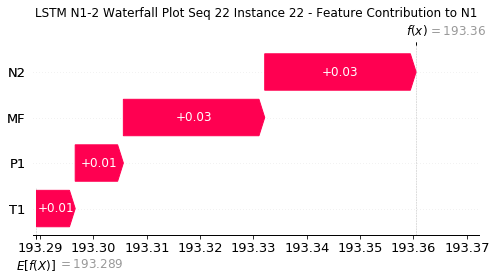

None

Contribution: [0.01617874 0.01276351 0.0513262  0.04784249]


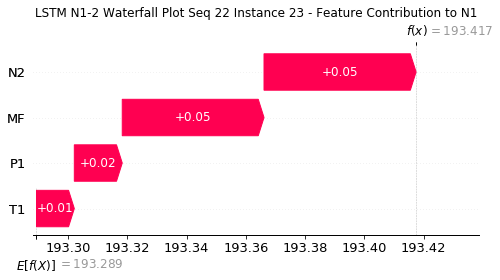

None

Contribution: [0.0270582  0.00847476 0.09199319 0.08763872]


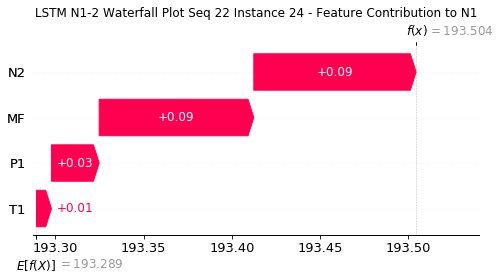

None

Contribution: [0.26567731 0.08370617 0.8421665  0.83709049]


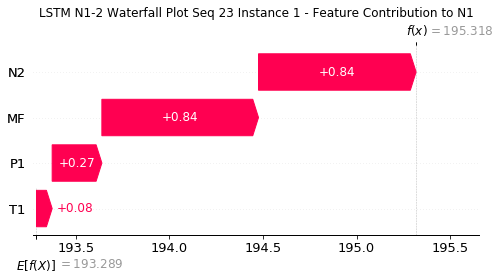

None

Contribution: [0.01494431 0.010989   0.04537236 0.04350263]


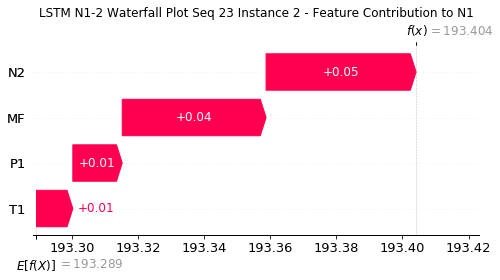

None

Contribution: [0.00262629 0.00207475 0.00837354 0.00751272]


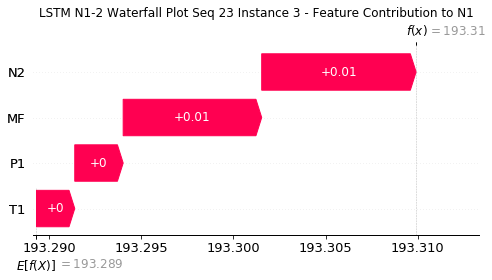

None

Contribution: [0.00139133 0.00105876 0.00440661 0.00400883]


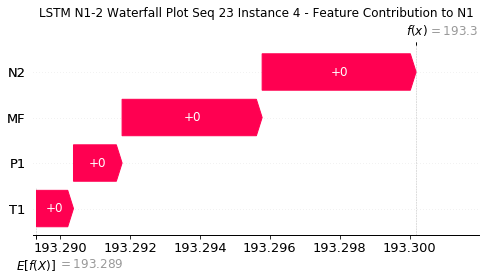

None

Contribution: [0.00113342 0.00087935 0.00356782 0.00327065]


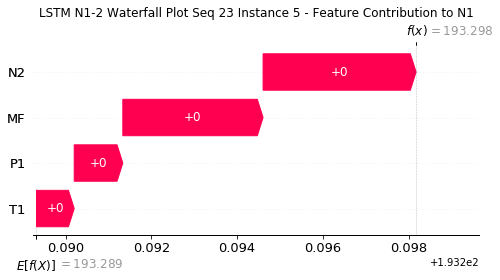

None

Contribution: [0.00098727 0.0007635  0.00305624 0.00281786]


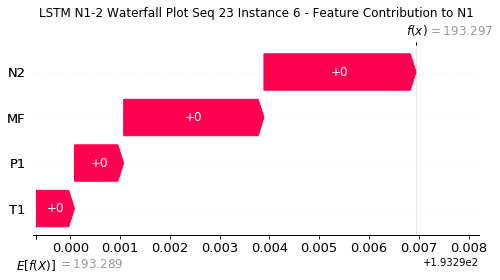

None

Contribution: [0.00092635 0.00072352 0.00290903 0.00267629]


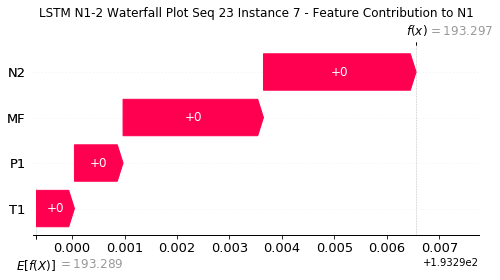

None

Contribution: [0.00092348 0.00070943 0.00286777 0.00265159]


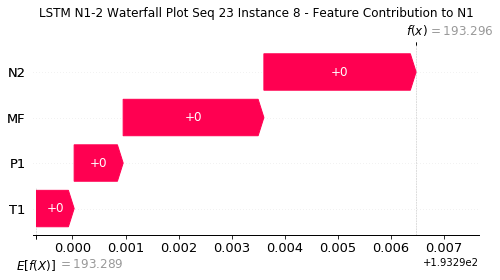

None

Contribution: [0.00091049 0.00072719 0.00284039 0.00260699]


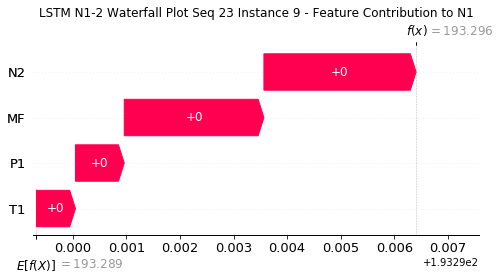

None

Contribution: [0.00090487 0.00071185 0.0028301  0.00262877]


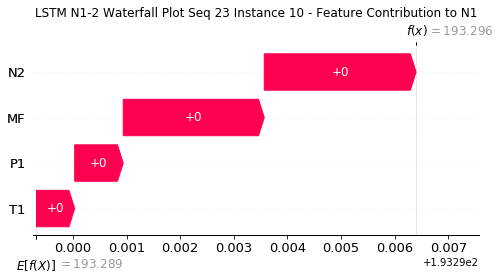

None

Contribution: [0.00090183 0.00070883 0.00283102 0.00261004]


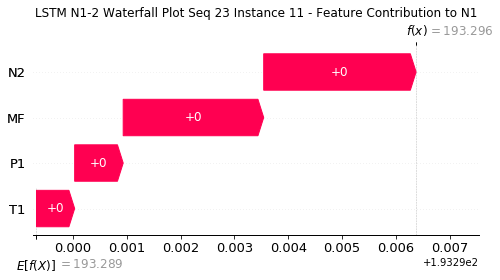

None

Contribution: [0.00091214 0.00071469 0.00285988 0.00263408]


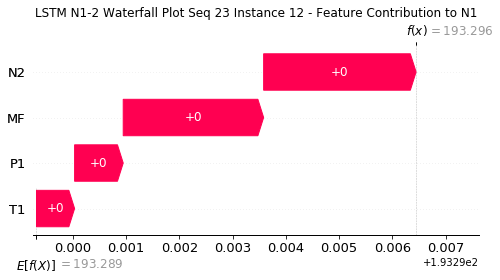

None

Contribution: [0.00093811 0.00073422 0.00292258 0.00269436]


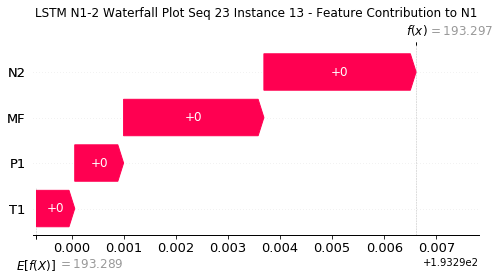

None

Contribution: [0.00096662 0.00075795 0.00302984 0.00279185]


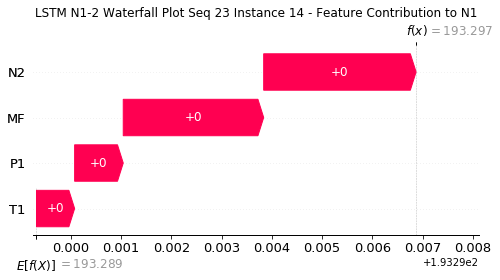

None

Contribution: [0.00102444 0.00078718 0.00319566 0.00291017]


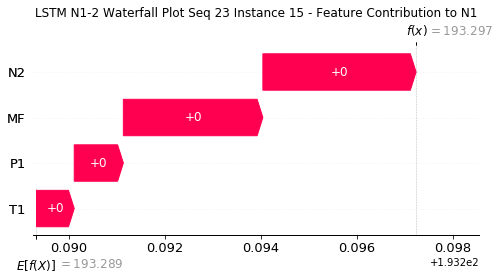

None

Contribution: [0.00112087 0.00087501 0.00350143 0.00322696]


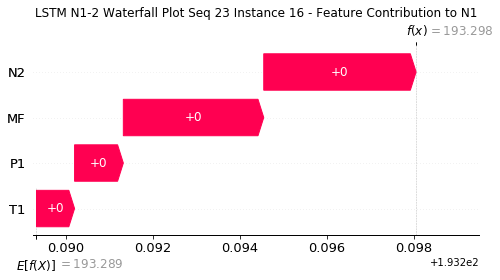

None

Contribution: [0.00127724 0.00099542 0.0039923  0.00368202]


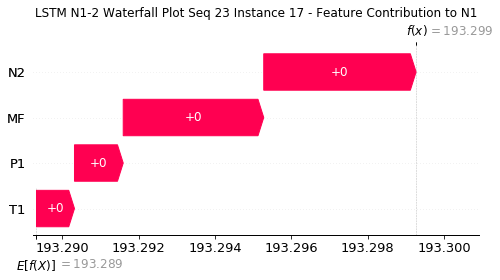

None

Contribution: [0.0015477  0.00120093 0.00484925 0.00444597]


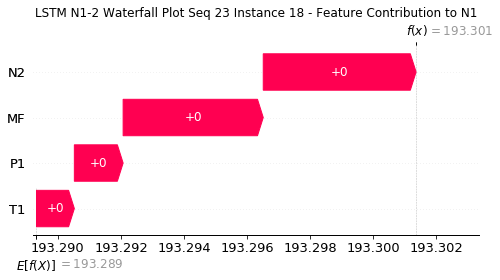

None

Contribution: [0.00207679 0.00160726 0.00646074 0.00595002]


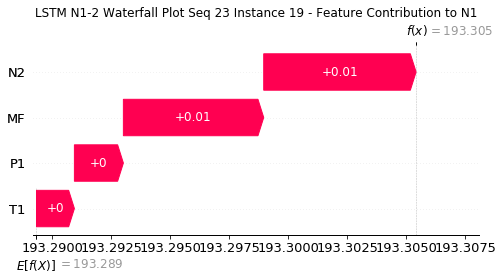

None

Contribution: [0.00307973 0.00240084 0.00958113 0.0088391 ]


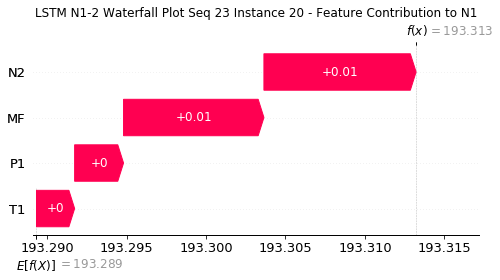

None

Contribution: [0.00508362 0.00399171 0.01582474 0.0146079 ]


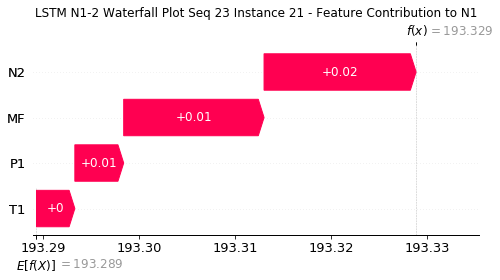

None

Contribution: [0.00908046 0.00721007 0.0283133  0.0262103 ]


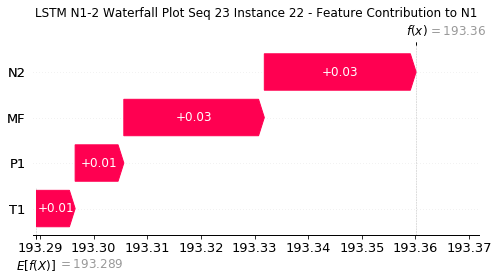

None

Contribution: [0.01649963 0.012872   0.0512681  0.04757655]


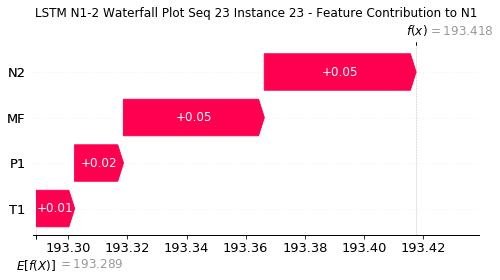

None

Contribution: [0.03151864 0.01049949 0.09266647 0.09014467]


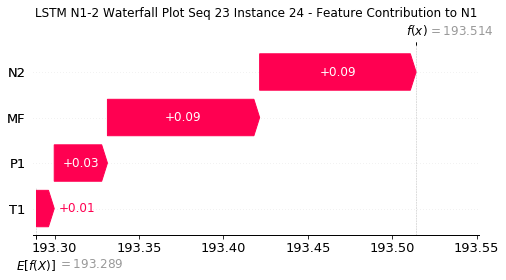

None

Contribution: [0.27093041 0.07640482 0.84407218 0.80801974]


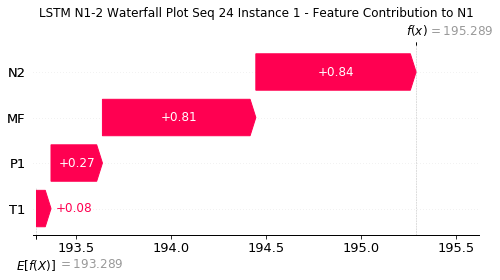

None

Contribution: [0.01519763 0.01096436 0.04565636 0.04341887]


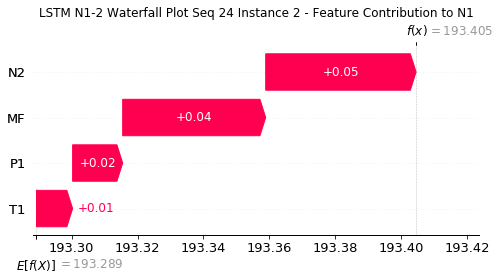

None

Contribution: [0.00261407 0.00204057 0.00839782 0.0074716 ]


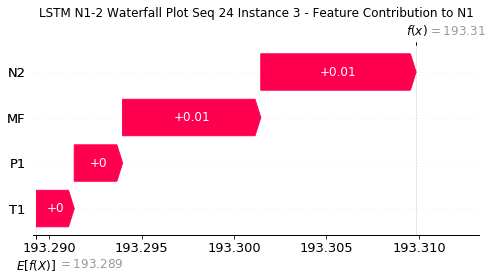

None

Contribution: [0.00139281 0.00100566 0.00439842 0.00400593]


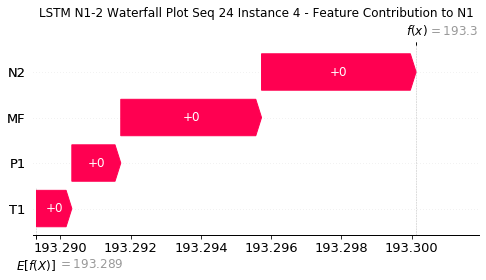

None

Contribution: [0.00113499 0.00084968 0.00356482 0.00326709]


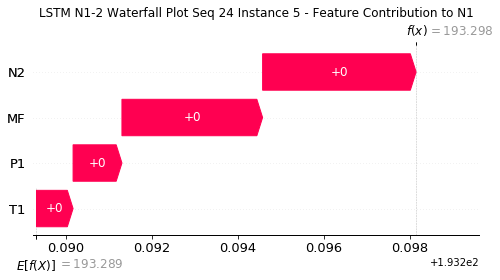

None

Contribution: [0.00097856 0.00072834 0.00304992 0.00282022]


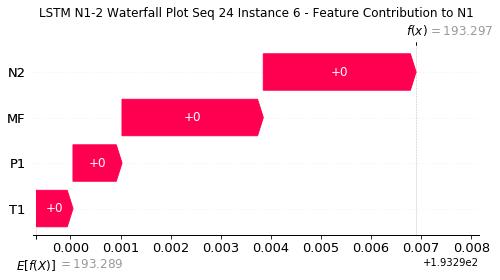

None

Contribution: [0.00092594 0.0007021  0.00290526 0.00267096]


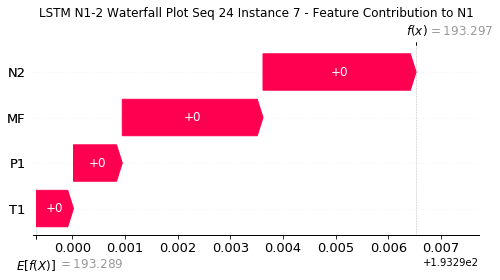

None

Contribution: [0.00091524 0.00067725 0.00286113 0.00263902]


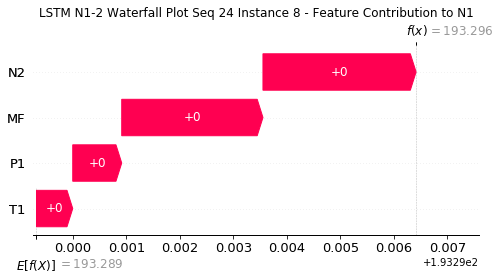

None

Contribution: [0.00090077 0.00067924 0.00283225 0.00260907]


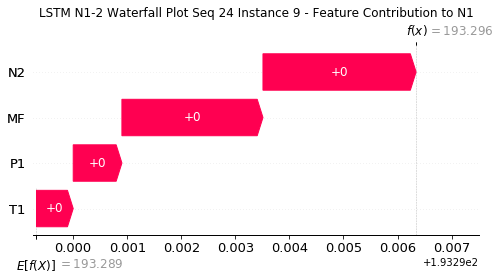

None

Contribution: [0.00090157 0.00067498 0.00281702 0.00259072]


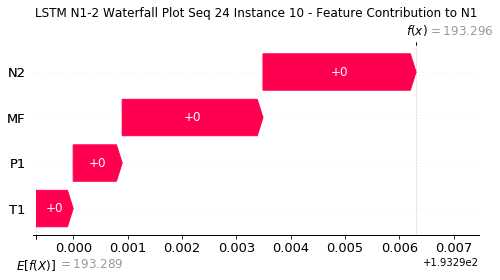

None

Contribution: [0.00090486 0.00070607 0.00282958 0.00261075]


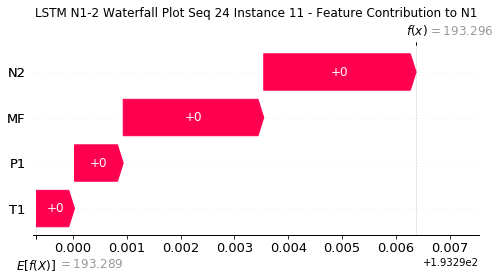

None

Contribution: [0.00091449 0.00071638 0.00285947 0.00264061]


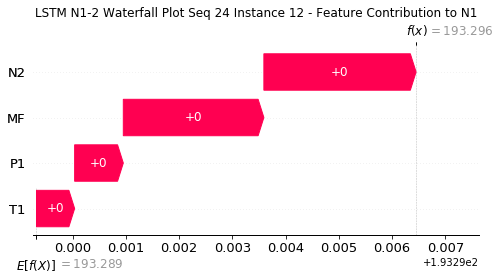

None

Contribution: [0.00093526 0.00074712 0.00291974 0.00270071]


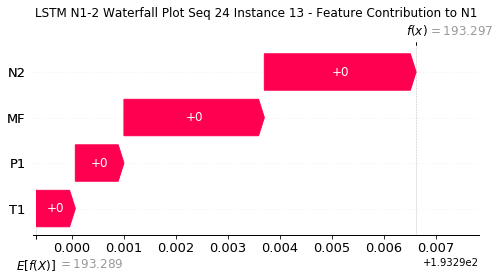

None

Contribution: [0.00097242 0.00076938 0.00303164 0.00280528]


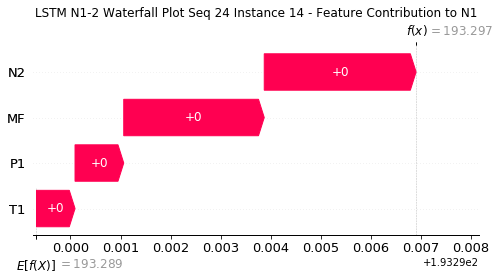

None

Contribution: [0.00102579 0.00082748 0.00321695 0.00296621]


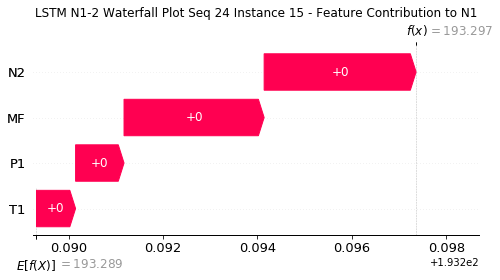

None

Contribution: [0.00112537 0.0009027  0.00350288 0.00324689]


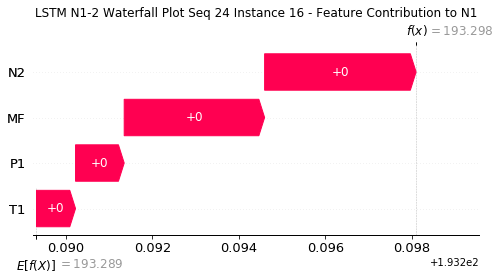

None

Contribution: [0.00127886 0.00103328 0.00398959 0.0036931 ]


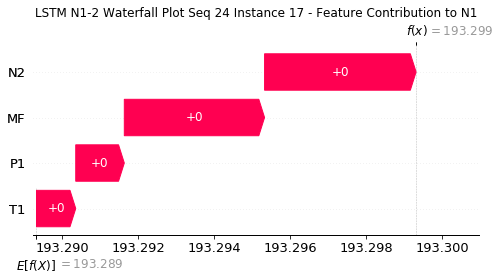

None

Contribution: [0.00156728 0.00129064 0.00484983 0.00450368]


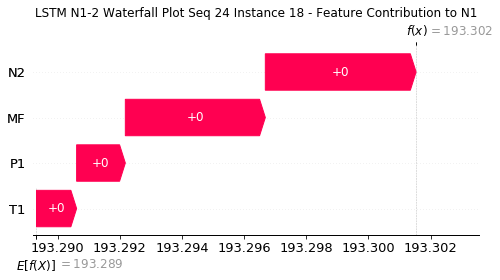

None

Contribution: [0.00208213 0.00168609 0.0064586  0.00599435]


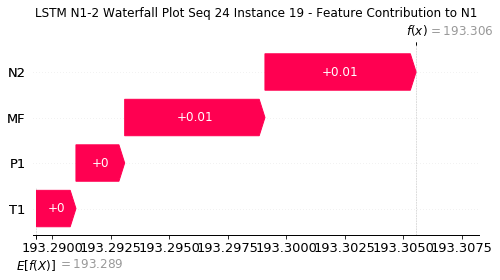

None

Contribution: [0.00308379 0.00252199 0.00957317 0.00888386]


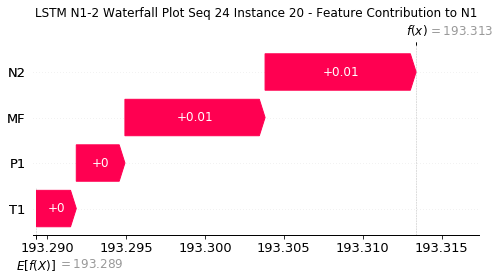

None

Contribution: [0.00510955 0.00420033 0.01581936 0.01470642]


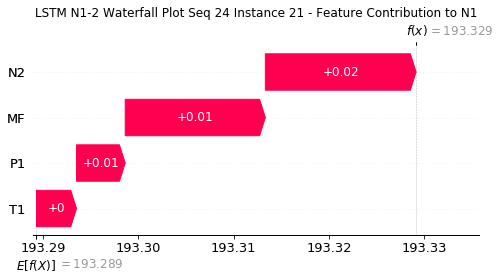

None

Contribution: [0.00912539 0.00763052 0.02830175 0.02632319]


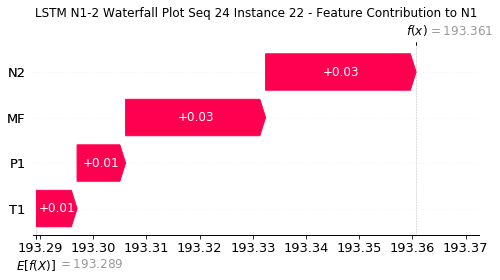

None

Contribution: [0.01659729 0.01362108 0.05129317 0.04800858]


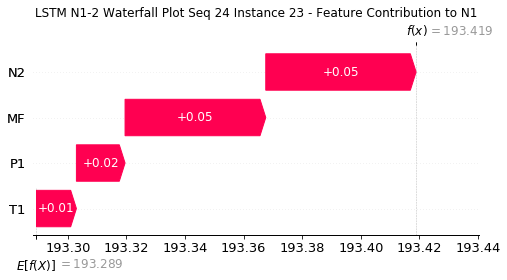

None

Contribution: [0.02838334 0.01154002 0.09212456 0.08715875]


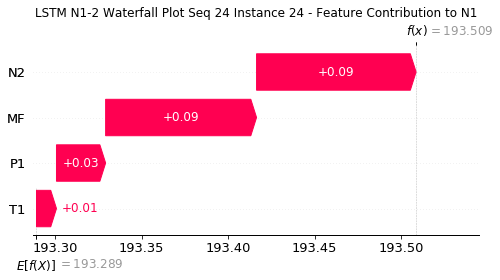

None

Contribution: [0.24661793 0.11477756 0.83644445 0.7593715 ]


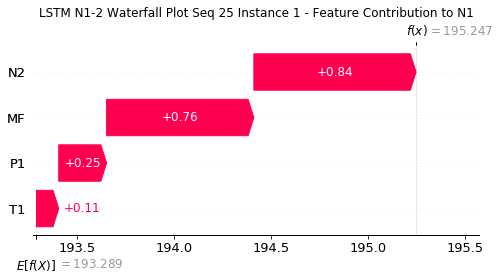

None

Contribution: [0.01509713 0.0116721  0.04589371 0.04343897]


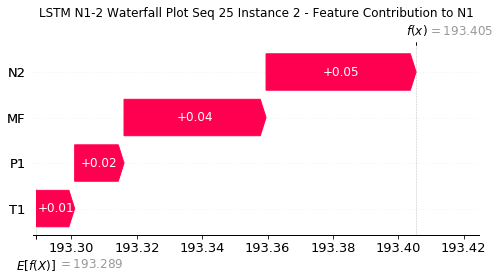

None

Contribution: [0.00260554 0.0021738  0.00841491 0.00748662]


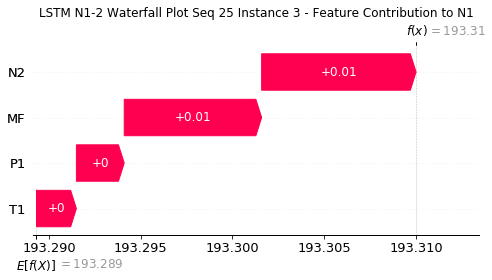

None

Contribution: [0.00139843 0.00107851 0.00440682 0.00403967]


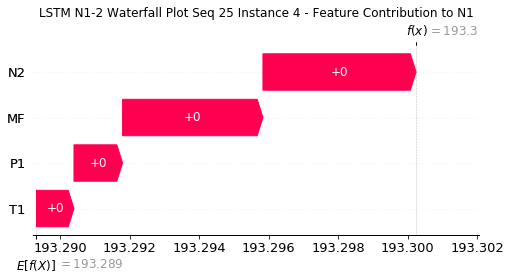

None

Contribution: [0.00113641 0.00089355 0.00356632 0.00328164]


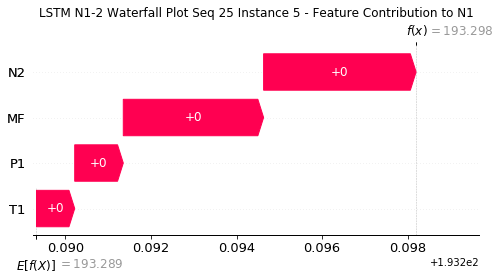

None

Contribution: [0.00094221 0.00074518 0.00302937 0.00274932]


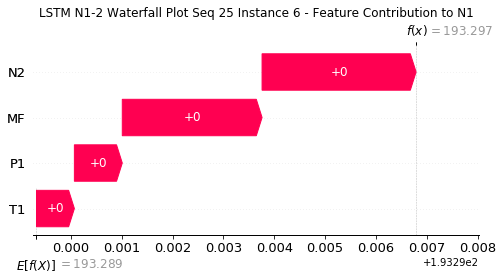

None

Contribution: [0.0009263  0.00073808 0.00290703 0.00268097]


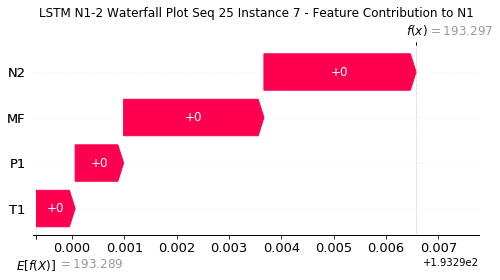

None

Contribution: [0.00090945 0.00072148 0.00285886 0.00262746]


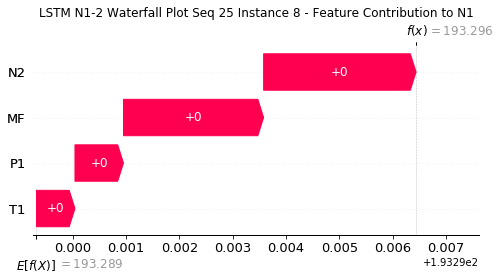

None

Contribution: [0.0009002  0.00071998 0.0028334  0.00261208]


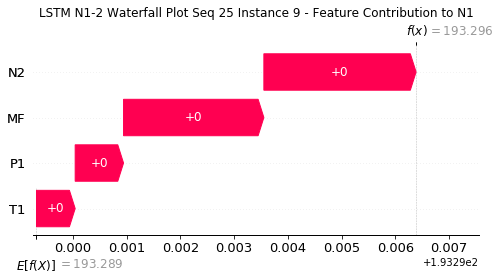

None

Contribution: [0.00090225 0.0007175  0.00281733 0.0025874 ]


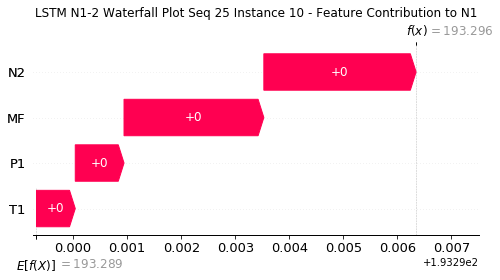

None

Contribution: [0.00089256 0.00071554 0.00282065 0.00259109]


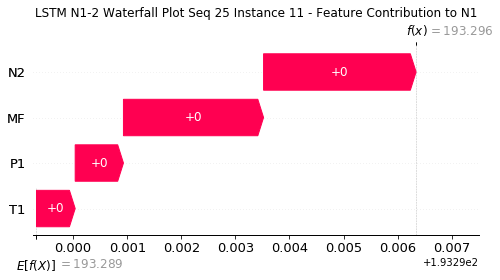

None

Contribution: [0.00090186 0.00072705 0.00285071 0.00262221]


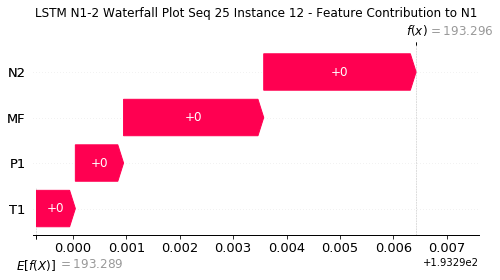

None

Contribution: [0.00090998 0.00073913 0.00290757 0.00266296]


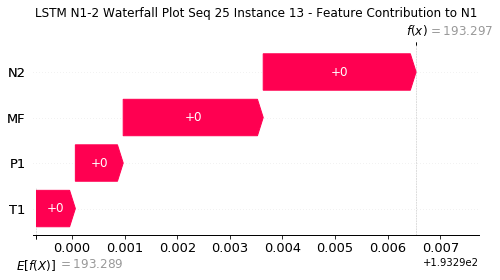

None

Contribution: [0.00095579 0.00077746 0.00302079 0.00277966]


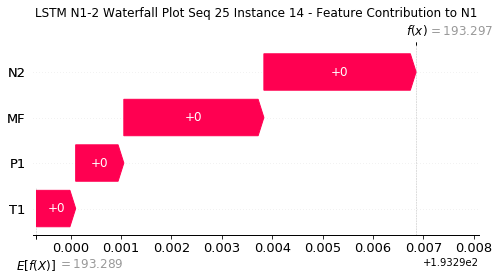

None

Contribution: [0.00103345 0.0008319  0.00320714 0.00296861]


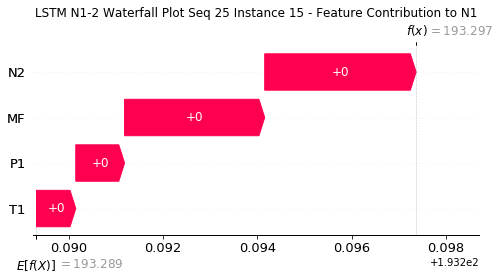

None

Contribution: [0.00110463 0.00090905 0.0034898  0.00321336]


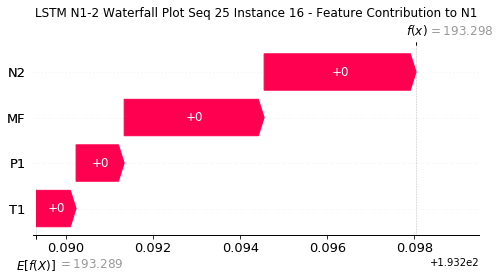

None

Contribution: [0.00126461 0.00104527 0.00398146 0.00367512]


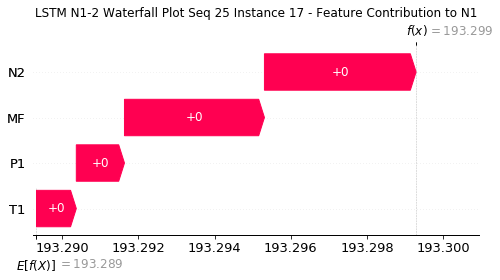

None

Contribution: [0.00156424 0.00132249 0.00485664 0.00452738]


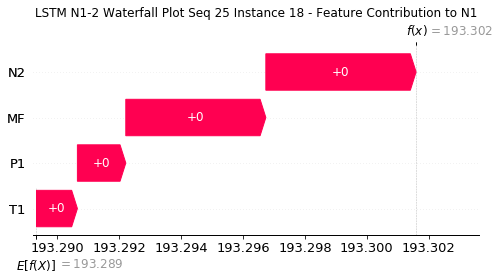

None

Contribution: [0.00206544 0.00173322 0.00645501 0.00599368]


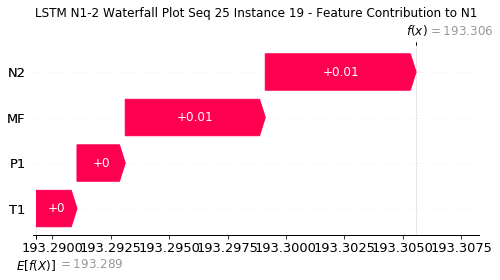

None

Contribution: [0.00306809 0.00259145 0.00957228 0.00890164]


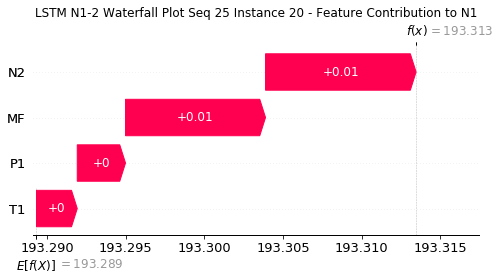

None

Contribution: [0.00507831 0.00432283 0.01581851 0.01474124]


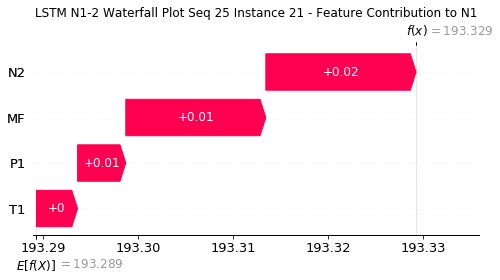

None

Contribution: [0.00907255 0.00778302 0.02829904 0.0263565 ]


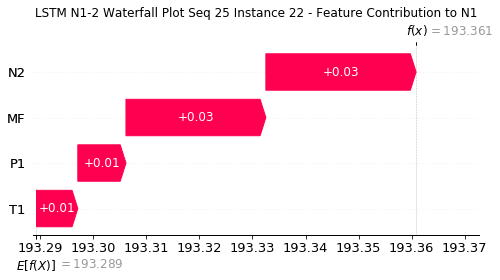

None

Contribution: [0.01648995 0.01418865 0.05129686 0.04802139]


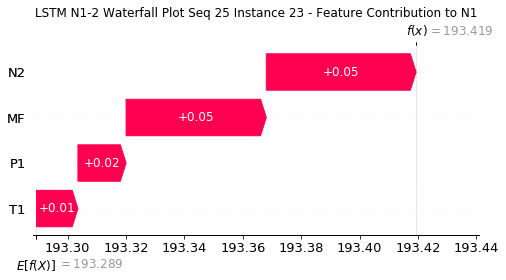

None

Contribution: [0.03012663 0.01738571 0.09282134 0.08985221]


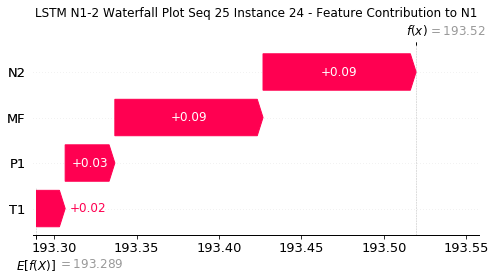

None

Contribution: [0.26766531 0.14598491 0.83664483 0.81290705]


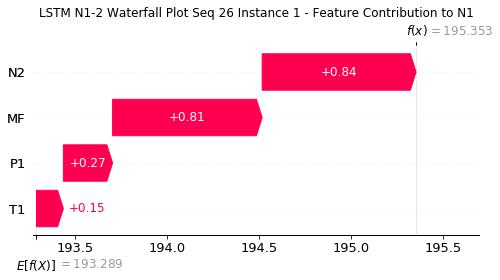

None

Contribution: [0.01486021 0.01191827 0.04484466 0.04290998]


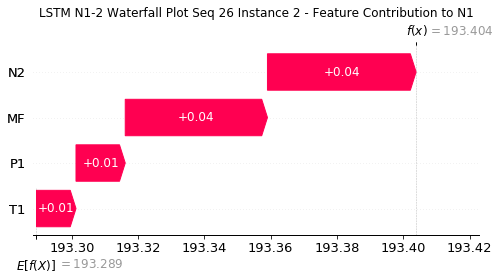

None

Contribution: [0.0025893  0.0022608  0.00831201 0.0074407 ]


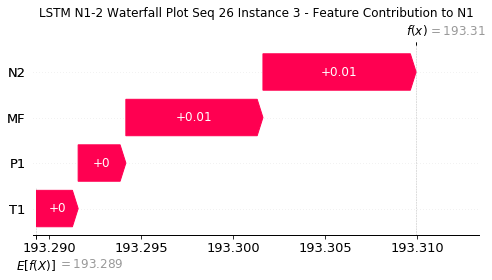

None

Contribution: [0.00136809 0.00111925 0.00440069 0.00398646]


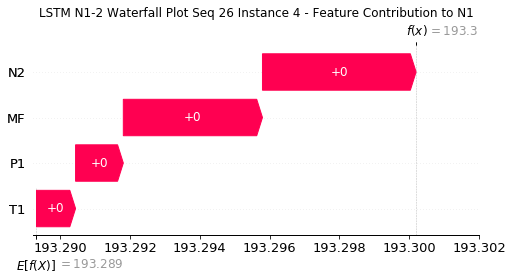

None

Contribution: [0.00111787 0.00091923 0.0035559  0.0032487 ]


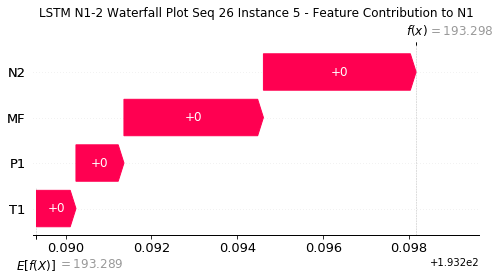

None

Contribution: [0.00096741 0.00079725 0.00304639 0.00280972]


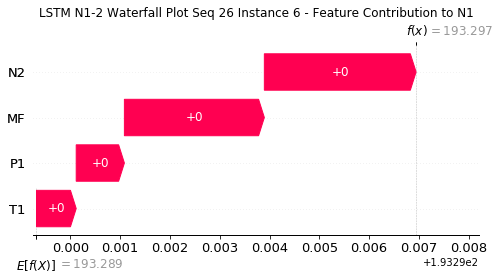

None

Contribution: [0.00091429 0.00075436 0.00289829 0.00266033]


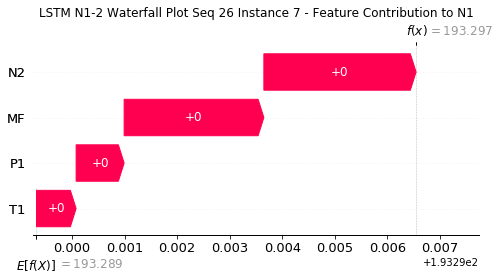

None

Contribution: [0.00091047 0.00073647 0.0028596  0.00263964]


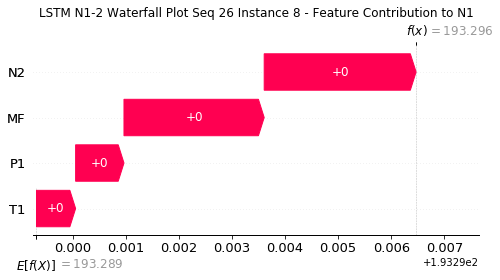

None

Contribution: [0.00092606 0.00073272 0.00284634 0.00266273]


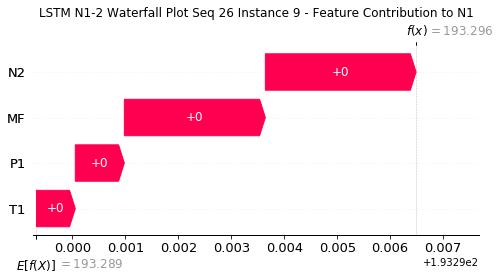

None

Contribution: [0.00090678 0.00073366 0.00282103 0.00261649]


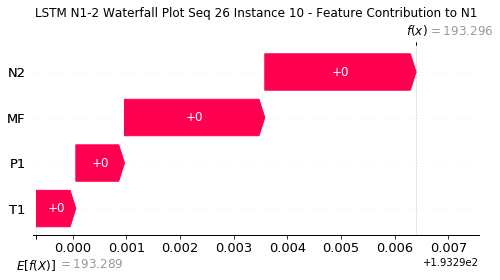

None

Contribution: [0.00089156 0.00073022 0.00281936 0.00260163]


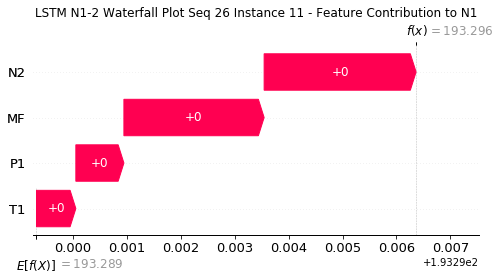

None

Contribution: [0.00089992 0.00073866 0.00284885 0.00262834]


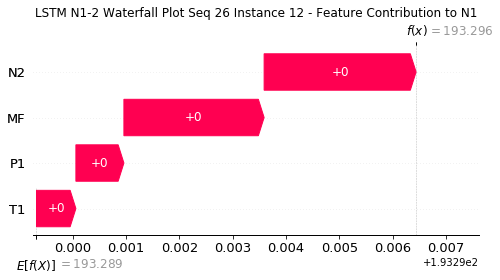

None

Contribution: [0.00093581 0.00078432 0.00292038 0.00271596]


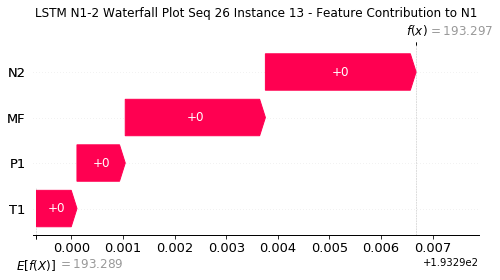

None

Contribution: [0.00095727 0.00078725 0.00302017 0.00279784]


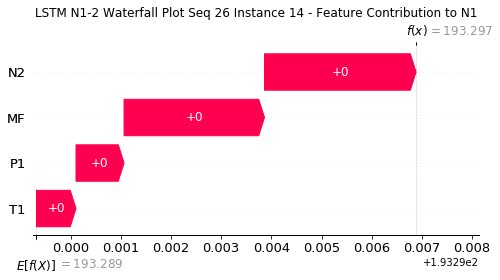

None

Contribution: [0.0010209  0.00084642 0.00319752 0.00296232]


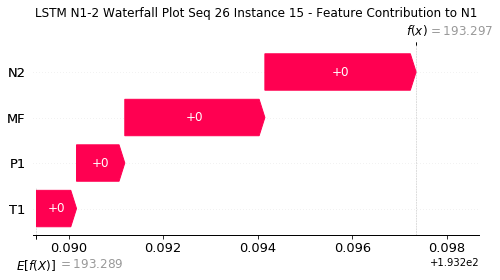

None

Contribution: [0.00111044 0.00091254 0.00348932 0.00323918]


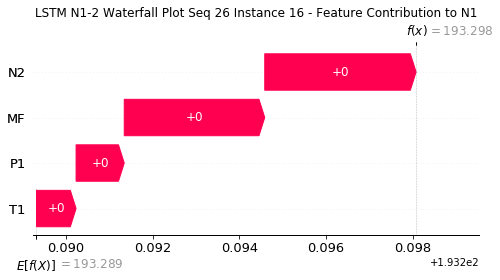

None

Contribution: [0.00126785 0.00103672 0.0039752  0.00368976]


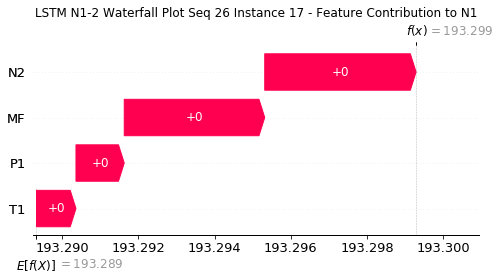

None

Contribution: [0.00154579 0.00127664 0.00483027 0.00446018]


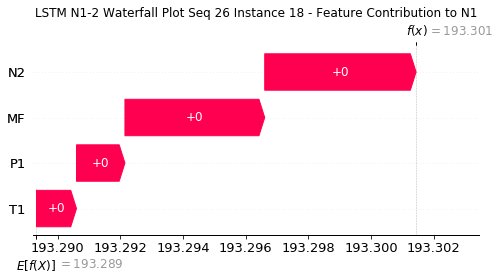

None

Contribution: [0.00205719 0.00168946 0.00643053 0.00598418]


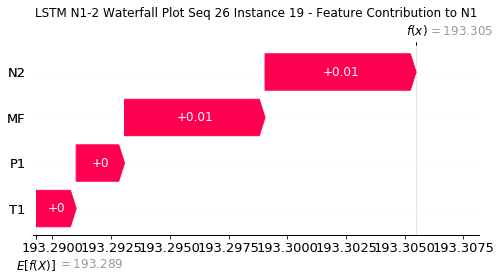

None

Contribution: [0.00305391 0.00251167 0.00953139 0.00888105]


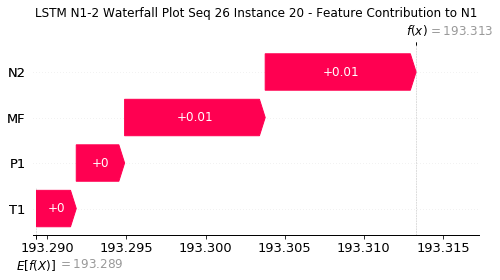

None

Contribution: [0.00504868 0.00417414 0.01574859 0.01472029]


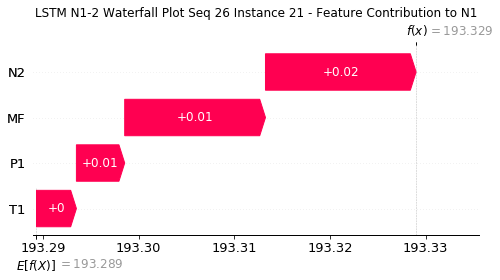

None

Contribution: [0.00906735 0.00751728 0.02819348 0.02641765]


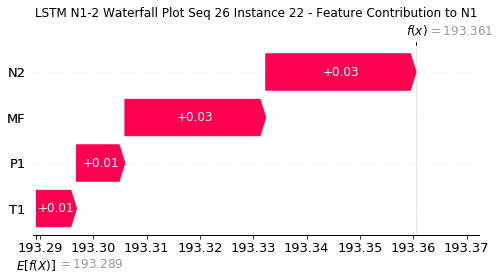

None

Contribution: [0.01655003 0.01377913 0.05115536 0.04840859]


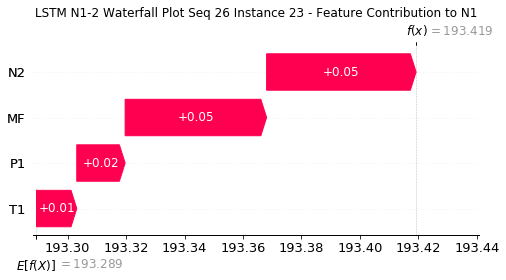

None

Contribution: [0.03016003 0.01544538 0.09260049 0.09173999]


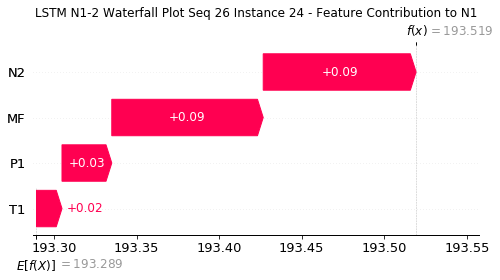

None

Contribution: [0.2534476  0.09229957 0.83952896 0.78797046]


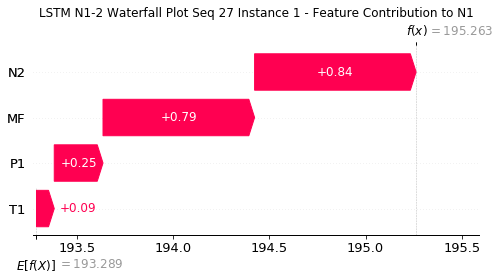

None

Contribution: [0.01497727 0.01154868 0.04581522 0.04378078]


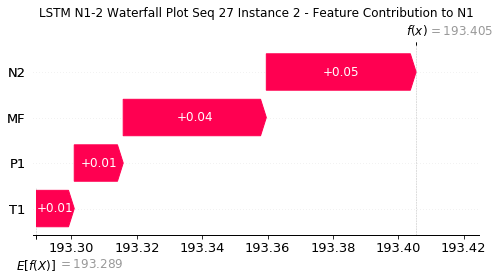

None

Contribution: [0.00259716 0.00222821 0.00841286 0.00754913]


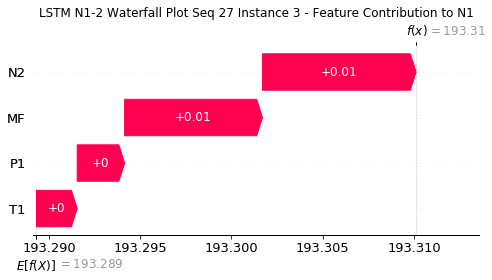

None

Contribution: [0.00138898 0.00109928 0.00440244 0.00400532]


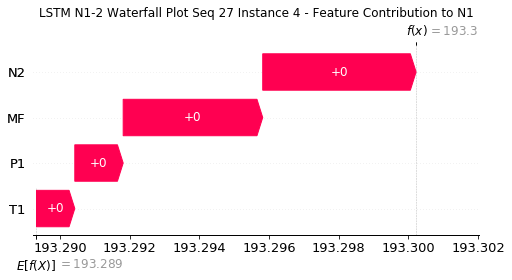

None

Contribution: [0.00113255 0.00091139 0.00356766 0.00326891]


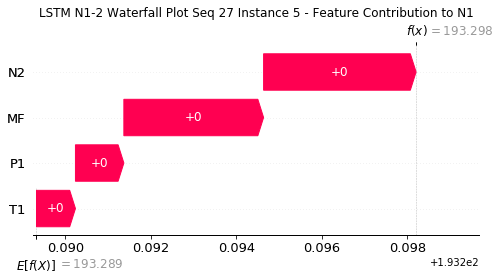

None

Contribution: [0.00096478 0.0007776  0.00304717 0.00279087]


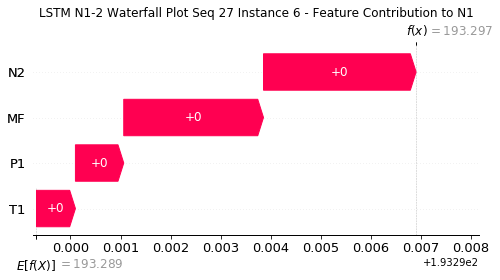

None

Contribution: [0.00092146 0.00074782 0.00290728 0.00267062]


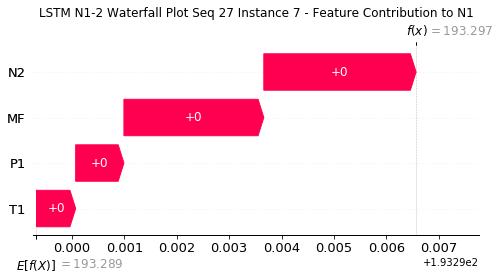

None

Contribution: [0.00090304 0.00072012 0.00285666 0.00262595]


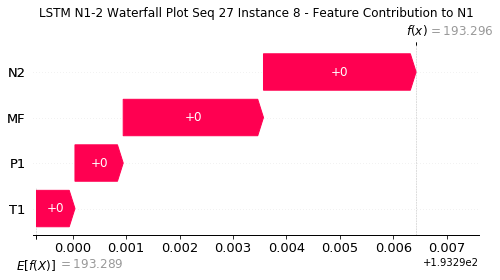

None

Contribution: [0.00087905 0.00065956 0.00281528 0.00257234]


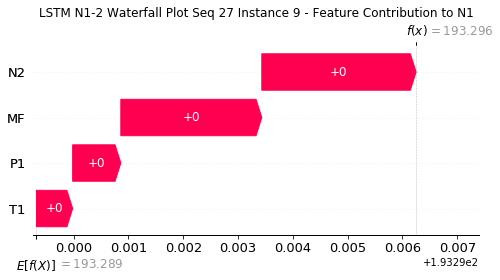

None

Contribution: [0.00088195 0.00071316 0.00281204 0.00257851]


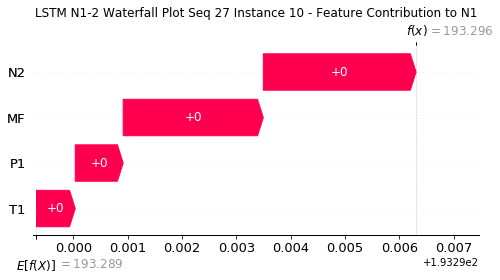

None

Contribution: [0.00089997 0.0007381  0.00282837 0.00260735]


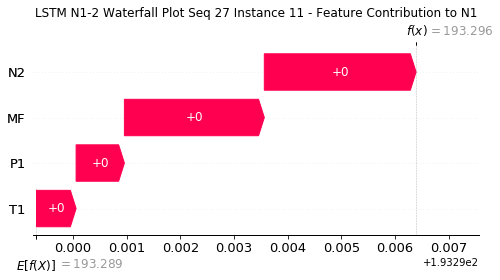

None

Contribution: [0.00090973 0.00074752 0.00285766 0.00263612]


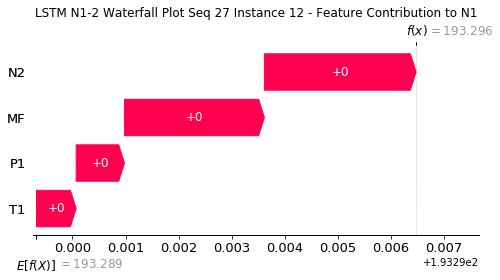

None

Contribution: [0.00092094 0.00077036 0.00291113 0.00266448]


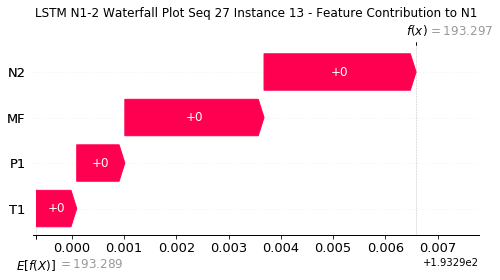

None

Contribution: [0.00095997 0.00079775 0.00302594 0.00279037]


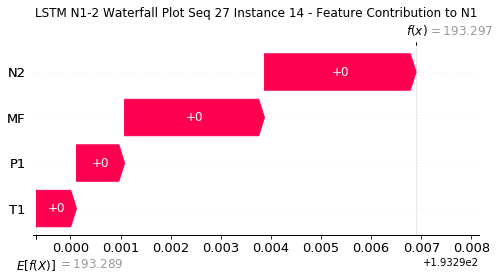

None

Contribution: [0.00101994 0.00084396 0.00319885 0.00293818]


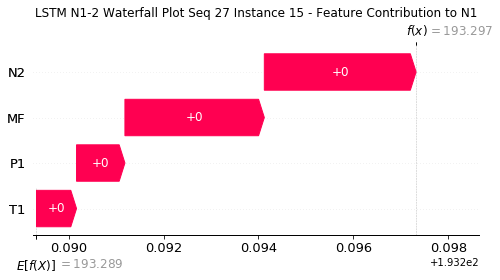

None

Contribution: [0.00111035 0.0009281  0.00349621 0.00323058]


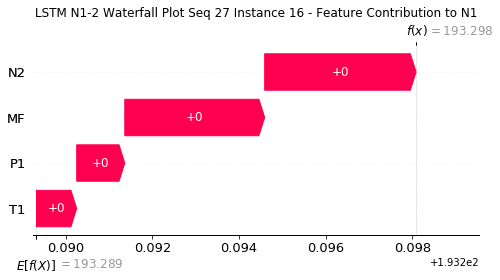

None

Contribution: [0.00126401 0.00105576 0.00398587 0.00368452]


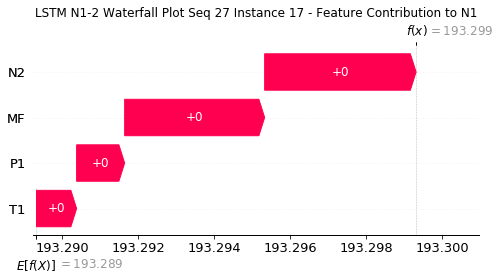

None

Contribution: [0.00156317 0.00133011 0.00486906 0.00456423]


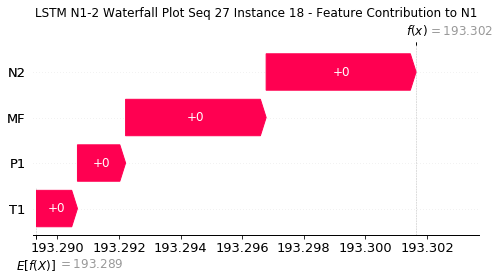

None

Contribution: [0.00204209 0.00172061 0.00645401 0.00596369]


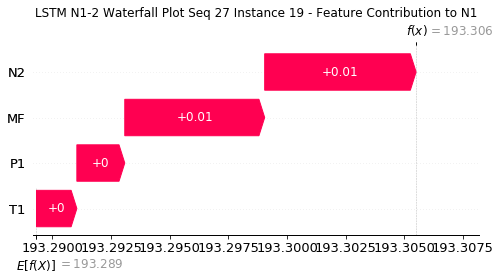

None

Contribution: [0.00302549 0.00256141 0.00956915 0.00884514]


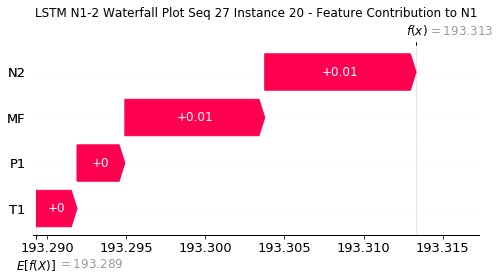

None

Contribution: [0.00498176 0.00425944 0.01580302 0.01459869]


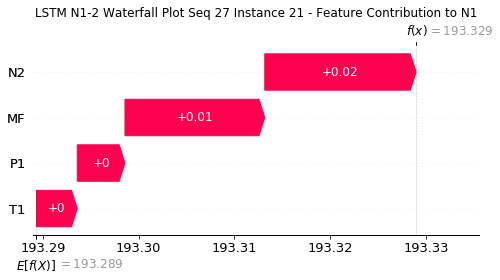

None

Contribution: [0.00890159 0.00768075 0.02826475 0.02615763]


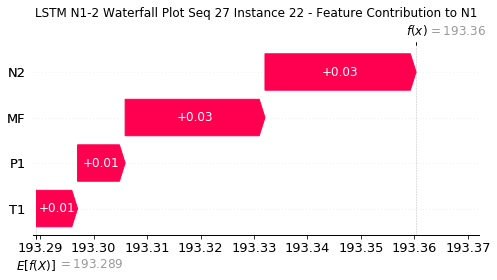

None

Contribution: [0.01593493 0.01387247 0.05112502 0.04722397]


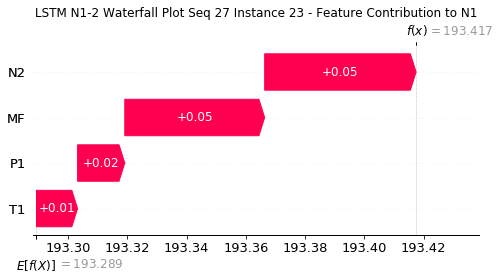

None

Contribution: [0.03028661 0.01585151 0.09217769 0.09027505]


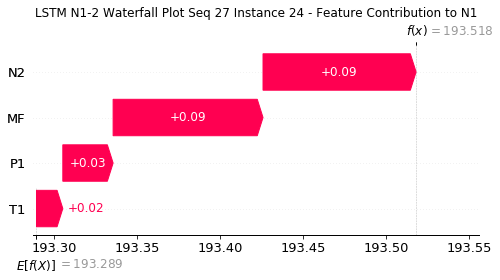

None

Contribution: [0.2829064  0.12571391 0.83417353 0.84318242]


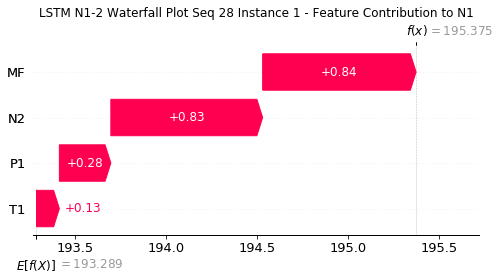

None

Contribution: [0.01504693 0.01176872 0.04473574 0.04327082]


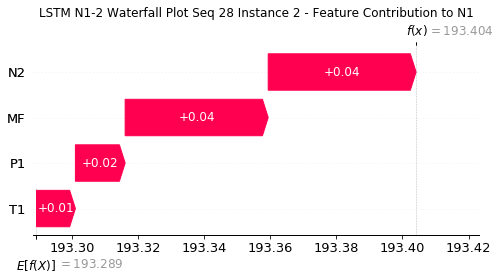

None

Contribution: [0.00261591 0.00225678 0.00831606 0.00756295]


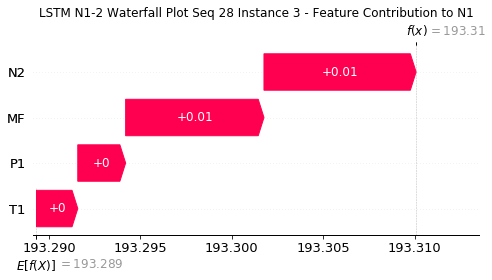

None

Contribution: [0.00141686 0.00122195 0.00445415 0.00407215]


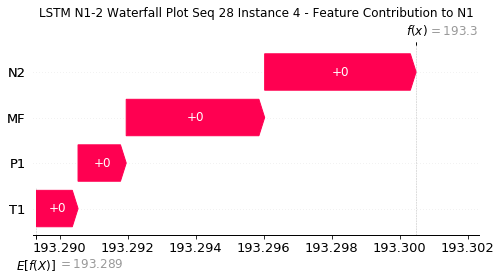

None

Contribution: [0.00114036 0.00097425 0.00358233 0.00328539]


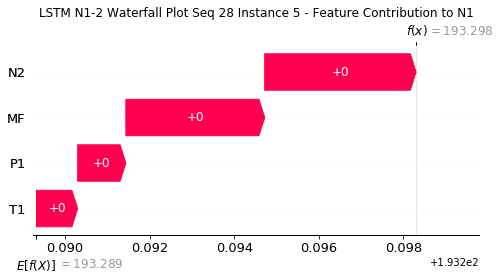

None

Contribution: [0.00100214 0.00086618 0.00308078 0.00287278]


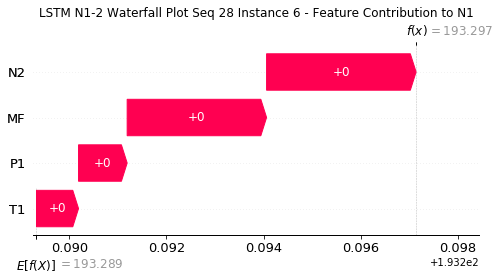

None

Contribution: [0.00093512 0.00077152 0.00291831 0.00268778]


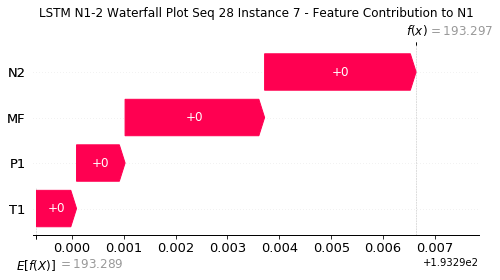

None

Contribution: [0.00092378 0.0007342  0.00286868 0.00265222]


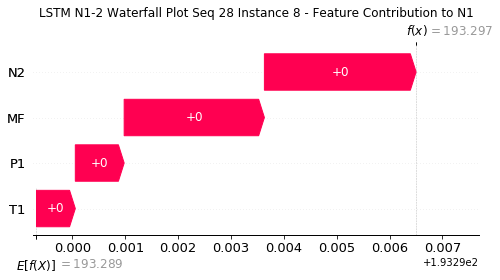

None

Contribution: [0.0009131  0.00072057 0.00284549 0.00265378]


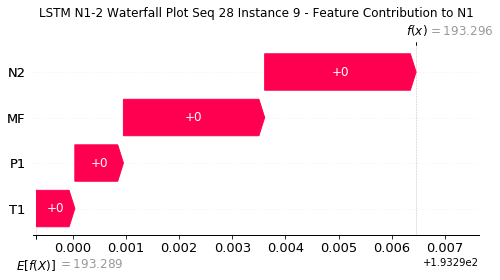

None

Contribution: [0.0008948  0.00070562 0.00281885 0.00258635]


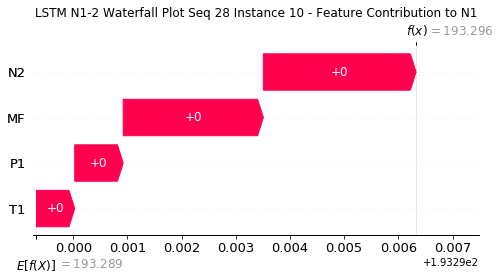

None

Contribution: [0.00091448 0.00074123 0.00283921 0.00262628]


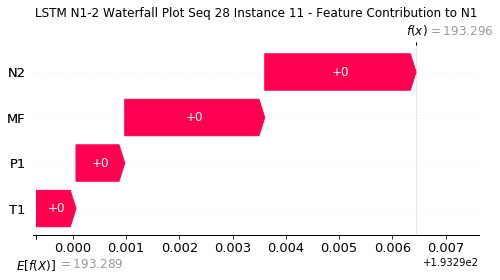

None

Contribution: [0.0009302  0.00073541 0.00286851 0.00265945]


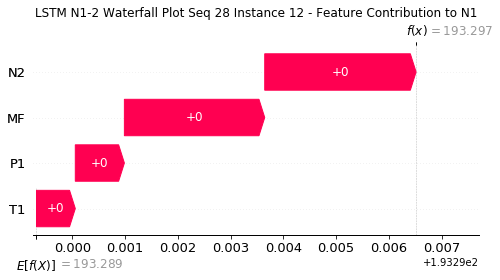

None

Contribution: [0.00091114 0.00074918 0.00291508 0.00267898]


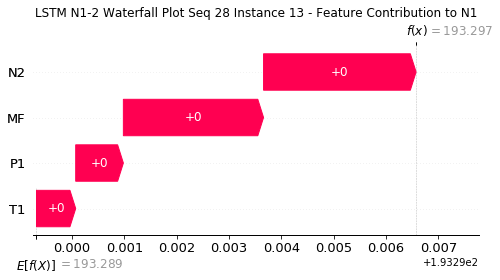

None

Contribution: [0.00099983 0.00073825 0.00304153 0.0028357 ]


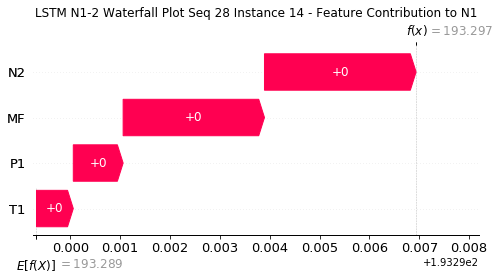

None

Contribution: [0.00102309 0.00075025 0.00320581 0.00296853]


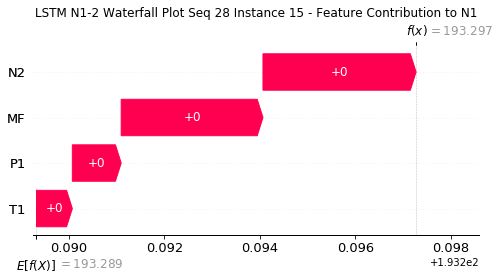

None

Contribution: [0.0011692  0.00079867 0.00351276 0.00328313]


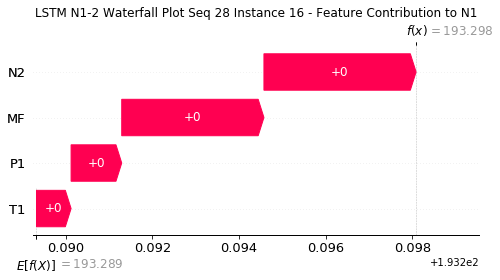

None

Contribution: [0.00133017 0.00085556 0.00399684 0.00372291]


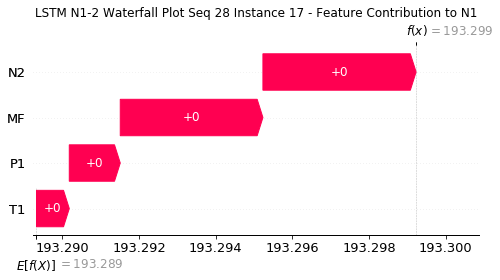

None

Contribution: [0.00150865 0.00119024 0.00483563 0.00436282]


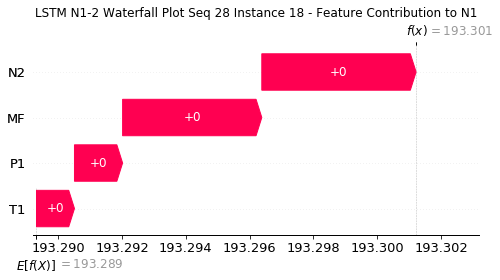

None

Contribution: [0.00223768 0.00122408 0.00648577 0.00611589]


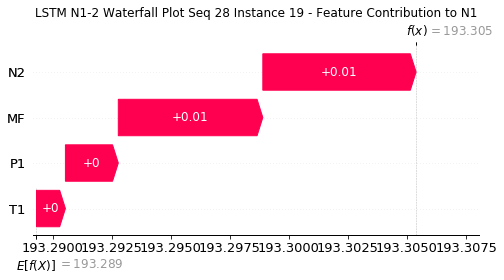

None

Contribution: [0.00332453 0.00175732 0.00961543 0.0090704 ]


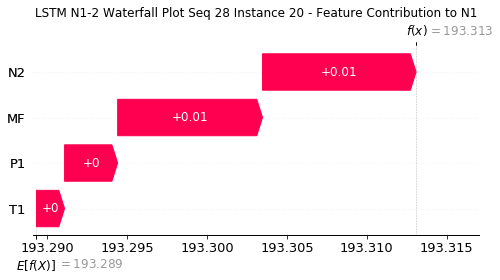

None

Contribution: [0.0055704  0.00280894 0.01590381 0.01510911]


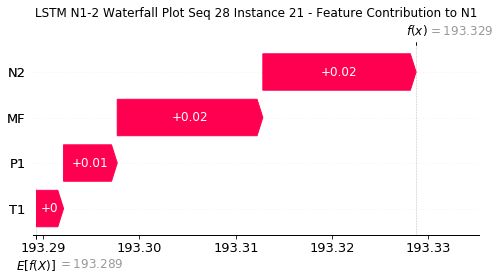

None

Contribution: [0.00983429 0.00502309 0.02841574 0.0268689 ]


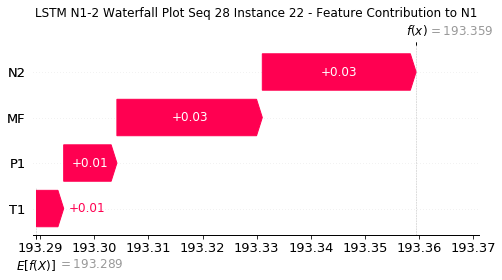

None

Contribution: [0.01840284 0.00793537 0.05158114 0.04959771]


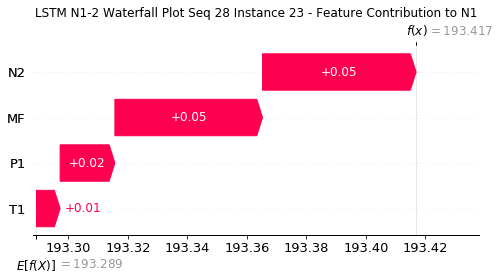

None

Contribution: [ 0.04057217 -0.01409981  0.09438833  0.09785606]


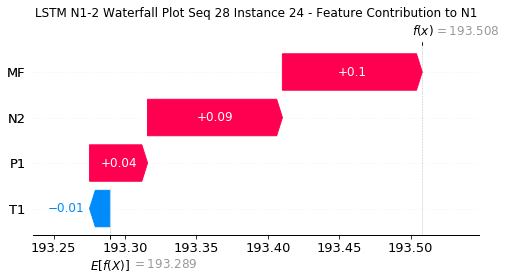

None

Contribution: [ 0.35405928 -0.19930091  0.86891932  0.84317284]


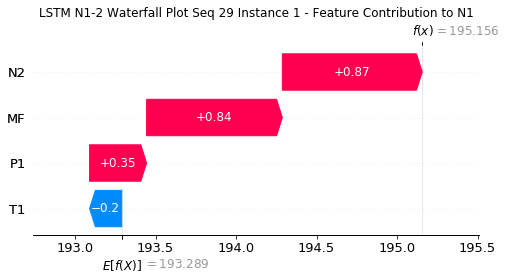

None

Contribution: [0.01767947 0.00701056 0.04758216 0.04657418]


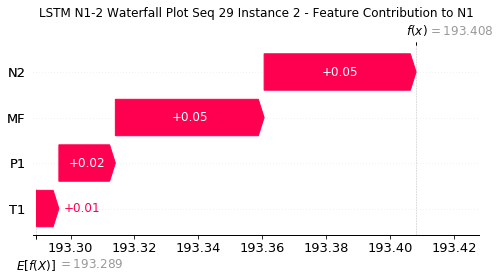

None

Contribution: [0.00298788 0.00137926 0.00863933 0.00788284]


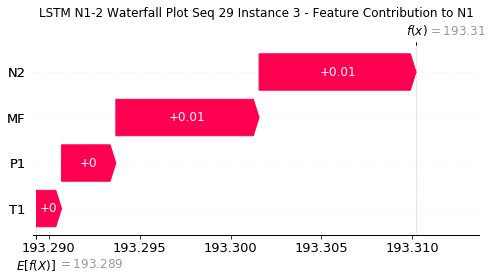

None

Contribution: [0.00156655 0.00051246 0.00441596 0.00411225]


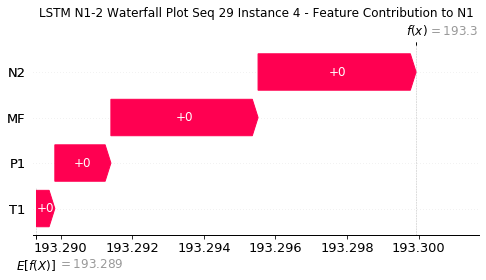

None

Contribution: [0.00126708 0.00051624 0.00359826 0.00336228]


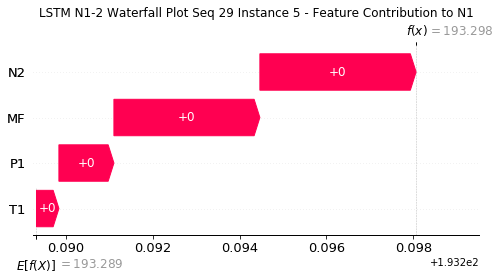

None

Contribution: [0.00100776 0.00044202 0.0030405  0.00277878]


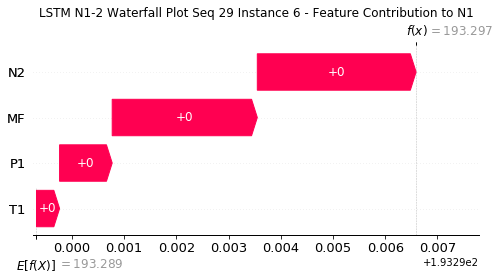

None

Contribution: [0.00102496 0.00044103 0.00292996 0.00274172]


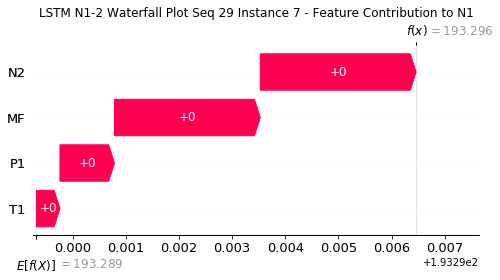

None

Contribution: [0.00100895 0.00040915 0.00288232 0.00269514]


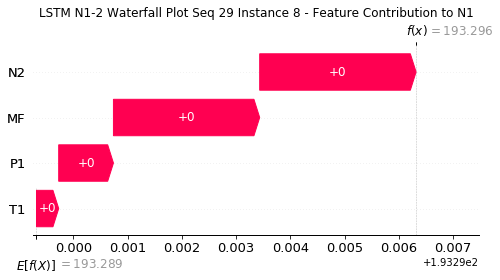

None

Contribution: [0.0010458  0.00042878 0.00288539 0.00277358]


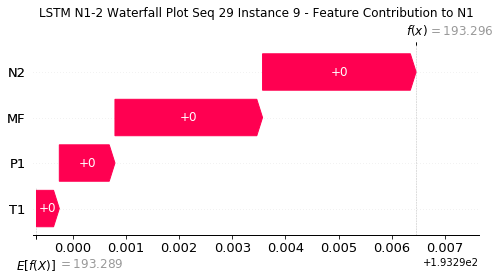

None

Contribution: [0.0010376  0.00042819 0.0028601  0.00271623]


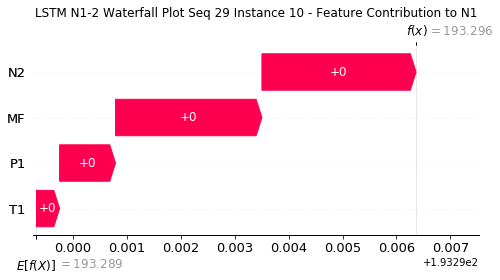

None

Contribution: [0.0010044  0.00045488 0.00285712 0.00269211]


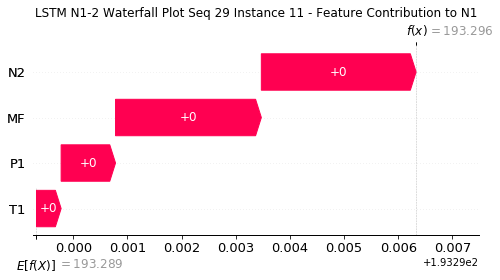

None

Contribution: [0.0010019  0.00047272 0.00288441 0.00270785]


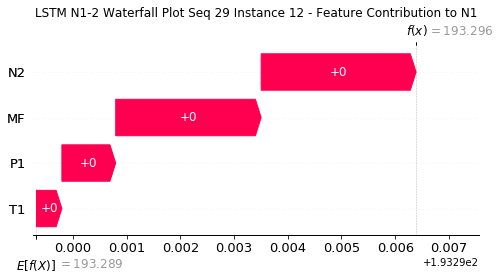

None

Contribution: [0.00104398 0.00045403 0.00295538 0.00279694]


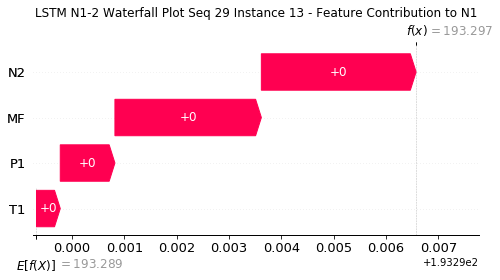

None

Contribution: [0.00105273 0.00054239 0.0030594  0.00287311]


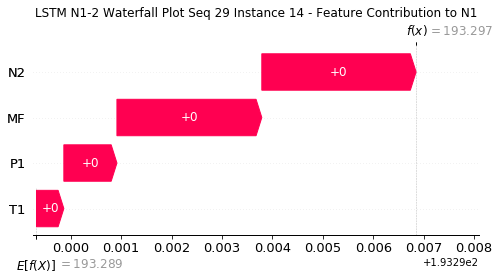

None

Contribution: [0.00106176 0.00070861 0.00322598 0.00297662]


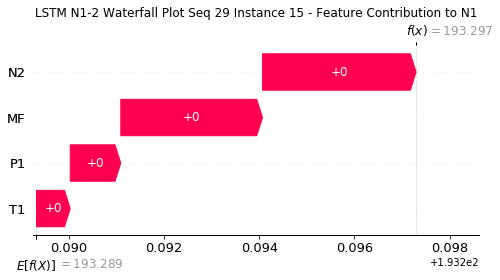

None

Contribution: [0.00118828 0.00070092 0.00353503 0.00329558]


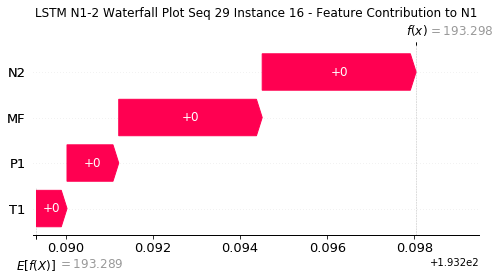

None

Contribution: [0.00133609 0.0008543  0.00403107 0.00374446]


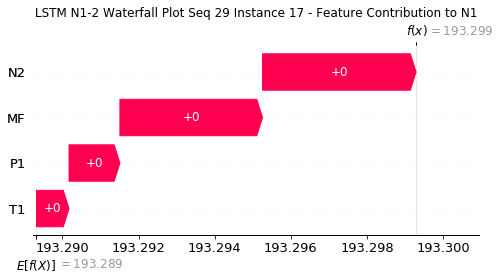

None

Contribution: [0.00150473 0.00117898 0.00487901 0.0044312 ]


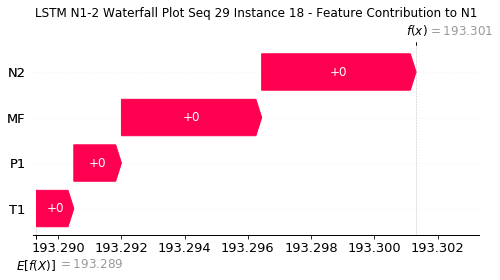

None

Contribution: [0.00207897 0.00153044 0.0065239  0.00600847]


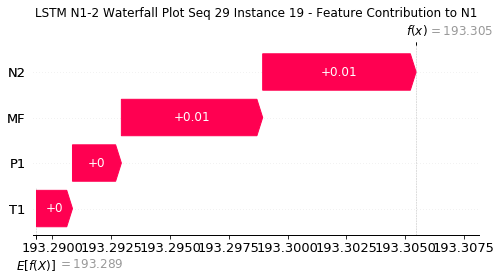

None

Contribution: [0.00307545 0.00233488 0.00967715 0.00892569]


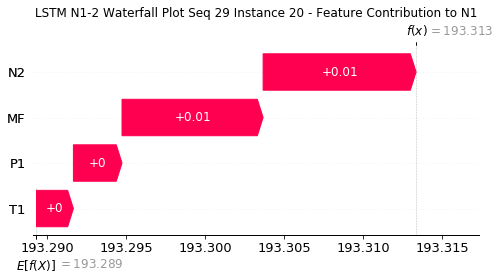

None

Contribution: [0.00507676 0.00390332 0.01598532 0.01481348]


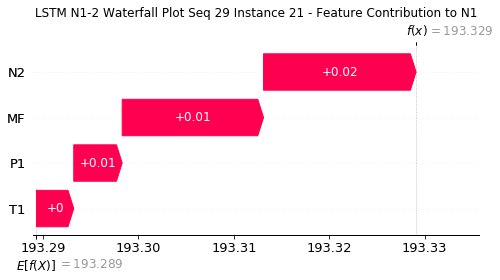

None

Contribution: [0.0091141  0.00718918 0.02856674 0.02654248]


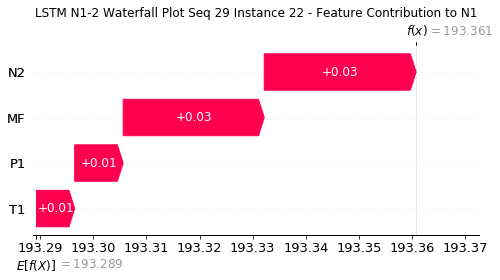

None

Contribution: [0.01607267 0.01272311 0.05160398 0.04777156]


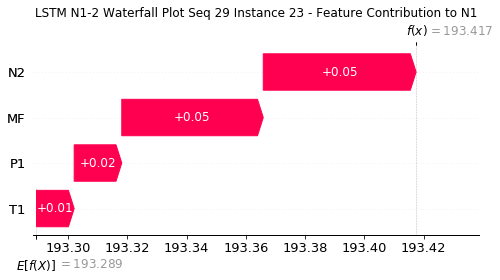

None

Contribution: [0.0247256  0.0031064  0.09225627 0.08399162]


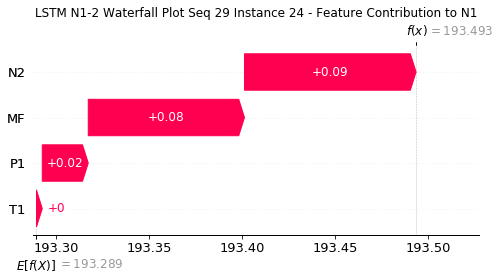

None

Contribution: [0.25621833 0.10729478 0.84319177 0.80962185]


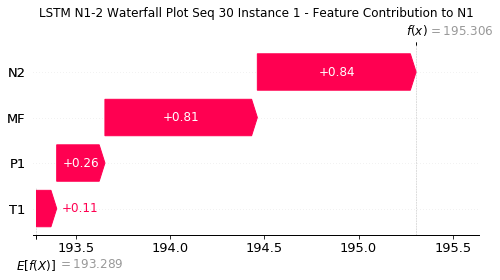

None

Contribution: [0.01508882 0.01103121 0.04551454 0.04378473]


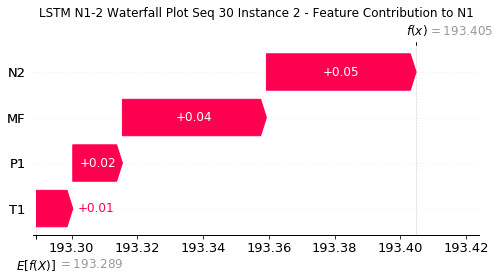

None

Contribution: [0.00262854 0.00228178 0.00838273 0.00748782]


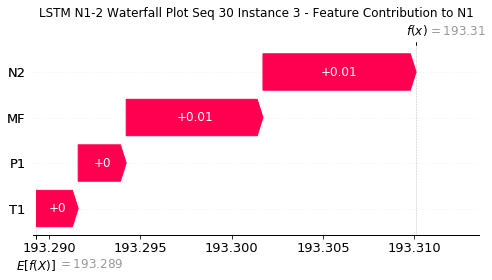

None

Contribution: [0.00138216 0.00115242 0.0044187  0.00400816]


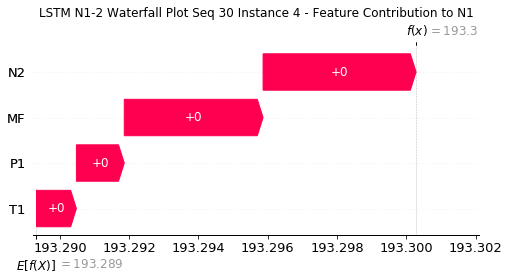

None

Contribution: [0.00112506 0.00093267 0.00357092 0.00325986]


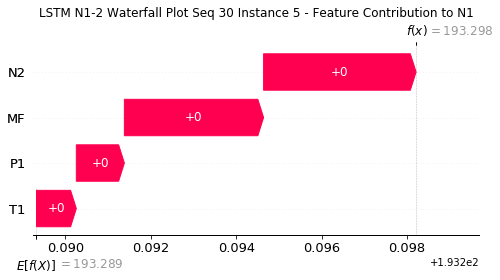

None

Contribution: [0.00097435 0.00077919 0.00305446 0.00279037]


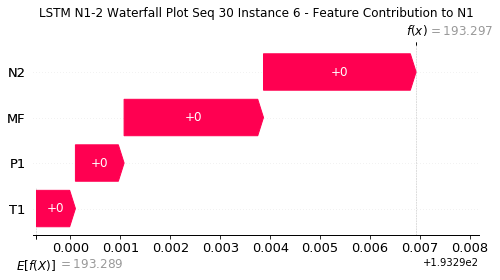

None

Contribution: [0.00091906 0.00076023 0.00291175 0.00266539]


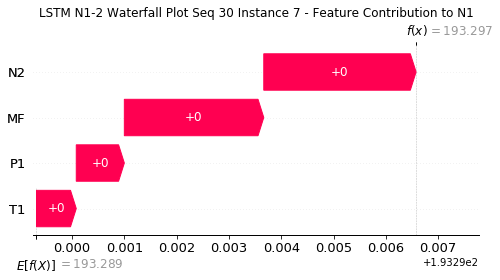

None

Contribution: [0.00090204 0.00071075 0.00285705 0.00260083]


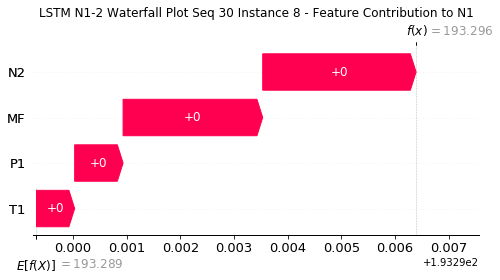

None

Contribution: [0.00088492 0.00068658 0.00282943 0.00258324]


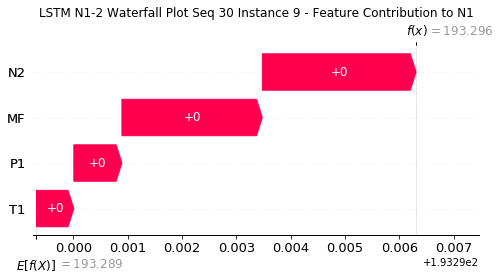

None

Contribution: [0.00088666 0.00068802 0.00281096 0.00254841]


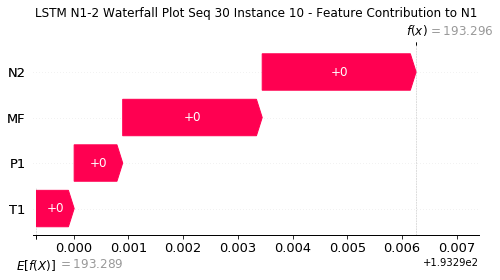

None

Contribution: [0.00088968 0.00070989 0.0028251  0.00258935]


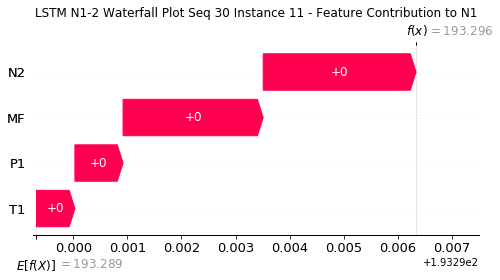

None

Contribution: [0.00089939 0.00072357 0.00285521 0.00262035]


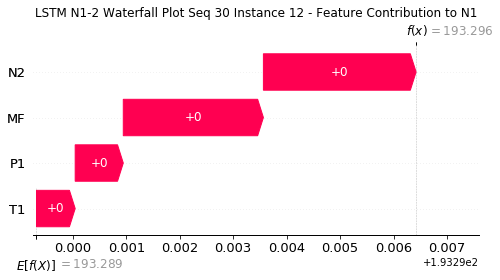

None

Contribution: [0.00091259 0.00072068 0.00290608 0.00263661]


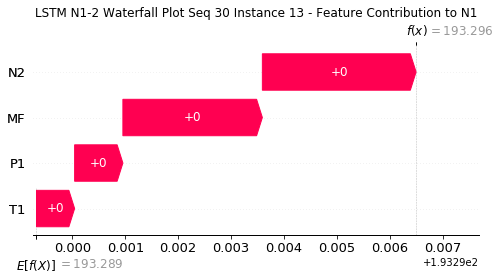

None

Contribution: [0.00095198 0.00076463 0.00302468 0.0027734 ]


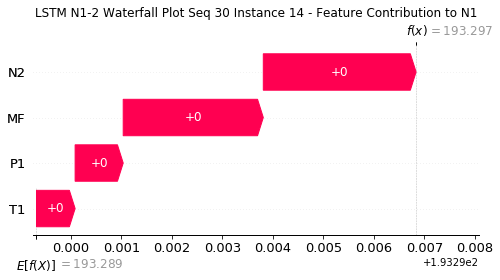

None

Contribution: [0.00102169 0.00083972 0.00320683 0.00294795]


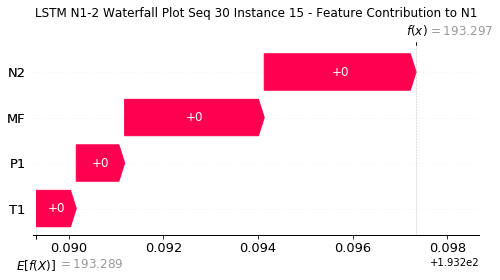

None

Contribution: [0.00110299 0.00088914 0.00349562 0.00321156]


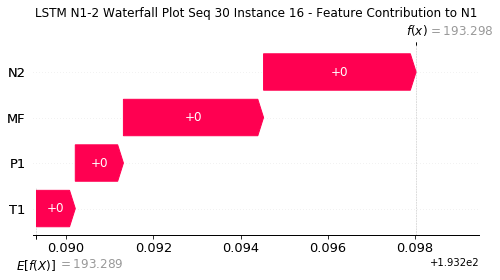

None

Contribution: [0.00126197 0.00102019 0.00398739 0.00367193]


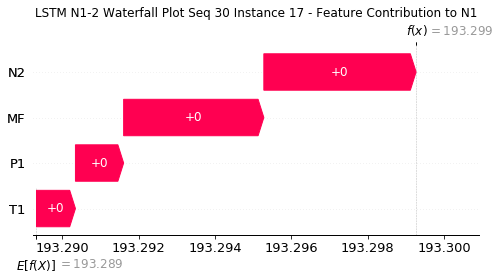

None

Contribution: [0.00154562 0.00122738 0.00484269 0.00442779]


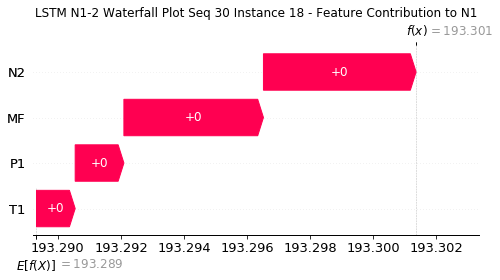

None

Contribution: [0.00205399 0.001707   0.00646293 0.00596513]


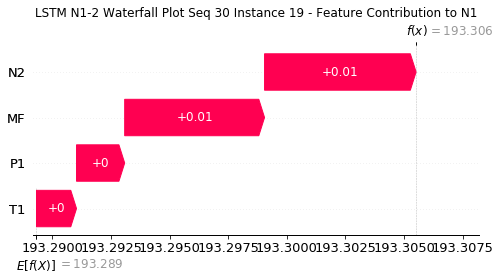

None

Contribution: [0.00305205 0.00254342 0.00958594 0.008866  ]


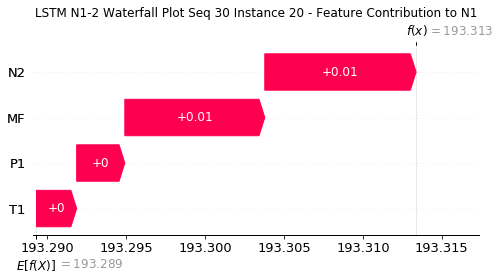

None

Contribution: [0.00503601 0.00422032 0.01584135 0.01464984]


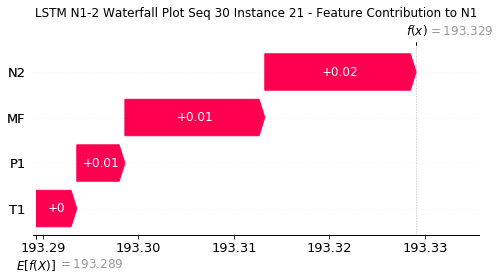

None

Contribution: [0.00900821 0.00748487 0.02833129 0.02622204]


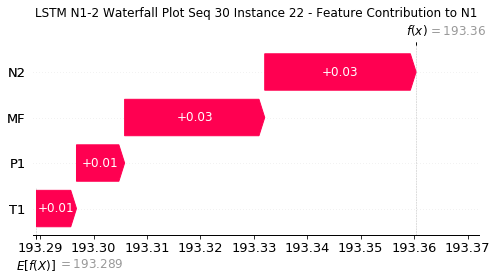

None

Contribution: [0.01620323 0.01379717 0.05128956 0.04743404]


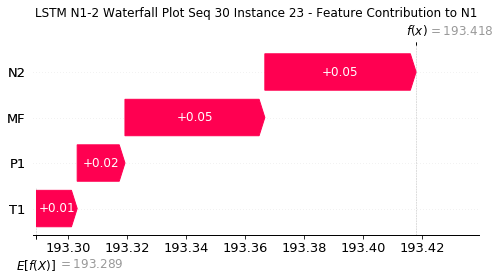

None

Contribution: [0.02780978 0.01615545 0.0928066  0.08667793]


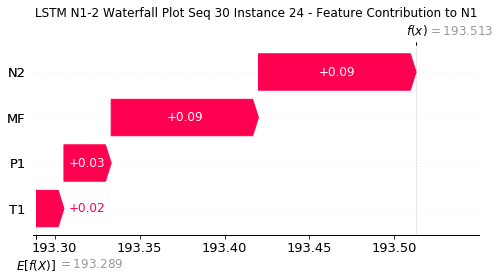

None

Contribution: [0.26358928 0.1079949  0.85134693 0.81829829]


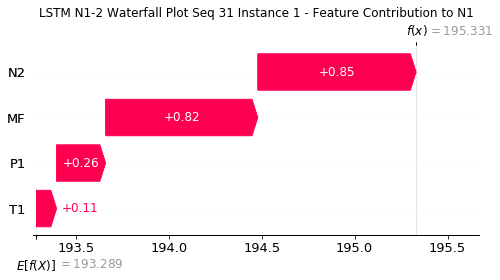

None

Contribution: [0.01475153 0.01142058 0.04537149 0.04294664]


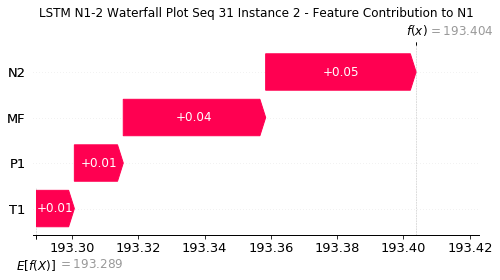

None

Contribution: [0.00253254 0.00221389 0.00836255 0.00736434]


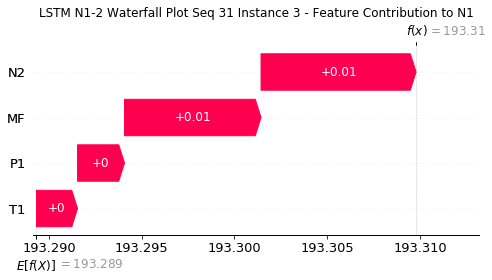

None

Contribution: [0.00141086 0.00113855 0.00444955 0.00406383]


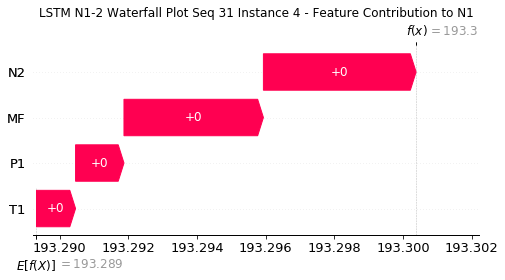

None

Contribution: [0.00114333 0.00092954 0.00358795 0.00329453]


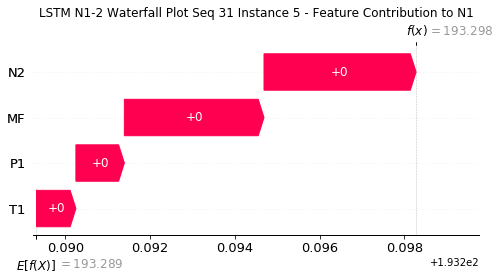

None

Contribution: [0.00097878 0.00080419 0.00306108 0.00280622]


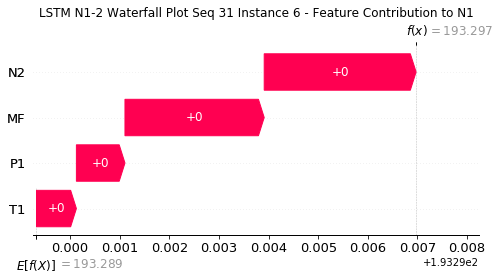

None

Contribution: [0.00092875 0.00075895 0.00292164 0.00268662]


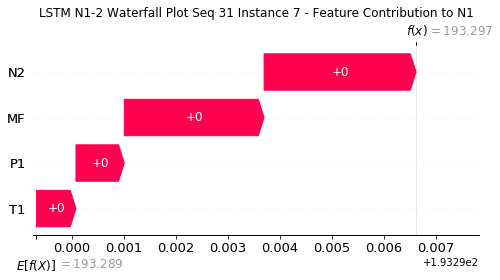

None

Contribution: [0.00089602 0.00070919 0.00285486 0.00260461]


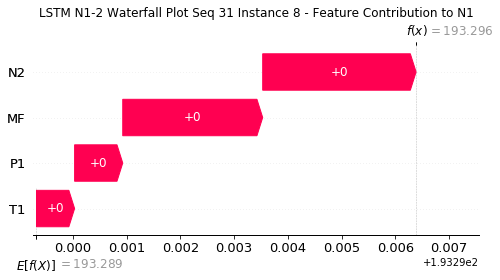

None

Contribution: [0.0008741  0.00070208 0.00281803 0.00253816]


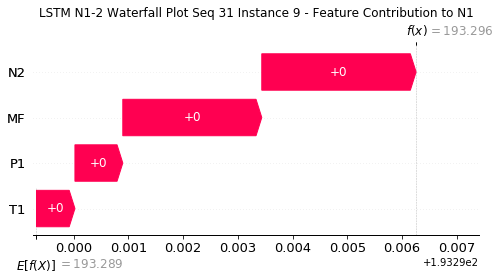

None

Contribution: [0.0008818  0.00069415 0.00281574 0.00258053]


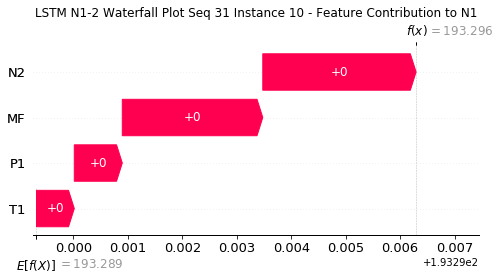

None

Contribution: [0.00090409 0.00073156 0.00283573 0.00260841]


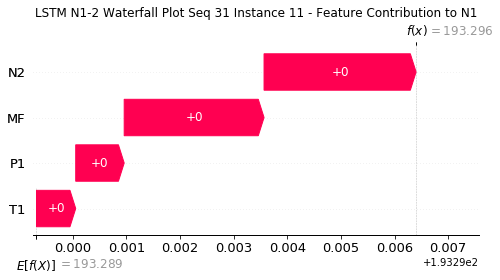

None

Contribution: [0.00091294 0.00074063 0.00286448 0.00263345]


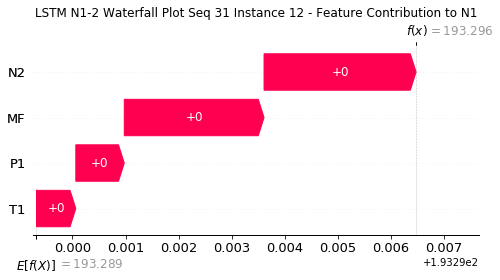

None

Contribution: [0.0009322  0.00074796 0.00292616 0.00270401]


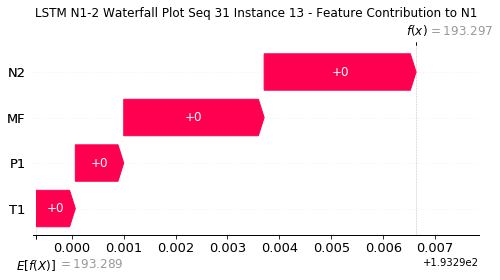

None

Contribution: [0.00096484 0.0007765  0.00303263 0.00279073]


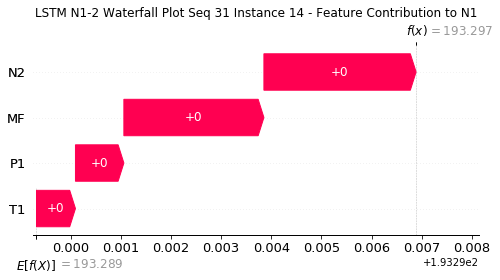

None

Contribution: [0.00100845 0.00081916 0.00320595 0.00290644]


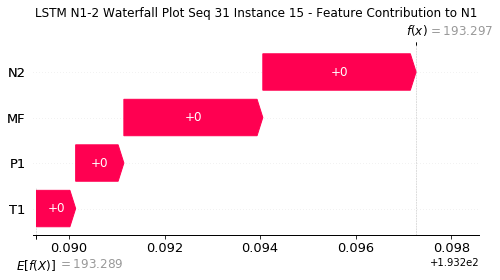

None

Contribution: [0.0011126  0.00089444 0.00349769 0.00321518]


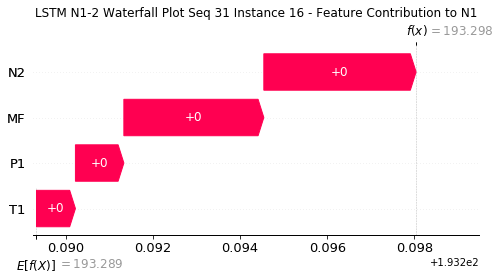

None

Contribution: [0.00126634 0.00102187 0.00398677 0.00366767]


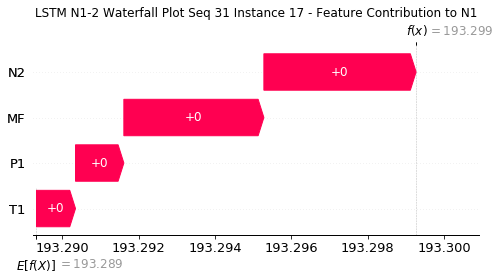

None

Contribution: [0.00157342 0.00129222 0.00486839 0.00453206]


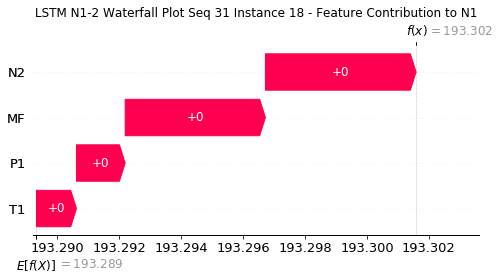

None

Contribution: [0.00205067 0.00165211 0.00645727 0.00594999]


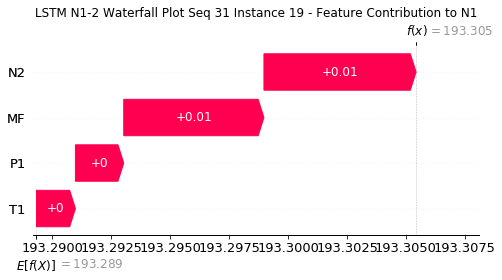

None

Contribution: [0.00303881 0.00246407 0.00957419 0.00883485]


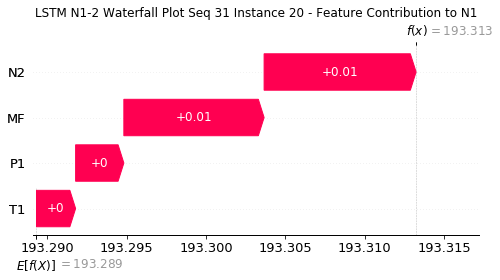

None

Contribution: [0.00501881 0.00406592 0.01582424 0.01463617]


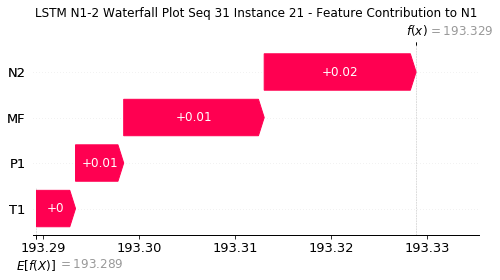

None

Contribution: [0.00896161 0.00731143 0.02829115 0.02618964]


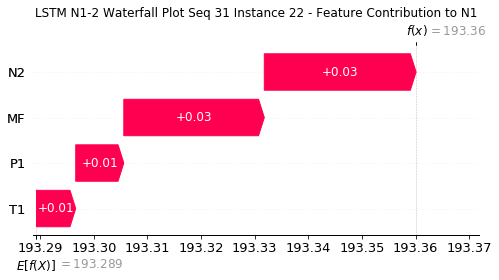

None

Contribution: [0.01609051 0.01309654 0.05122199 0.04728778]


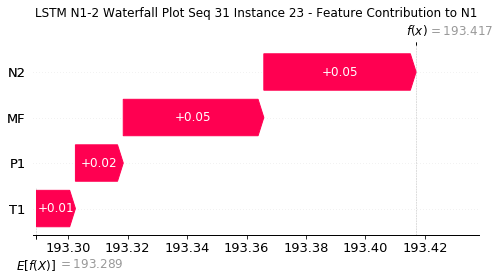

None

Contribution: [0.02959916 0.01493815 0.09439537 0.08821327]


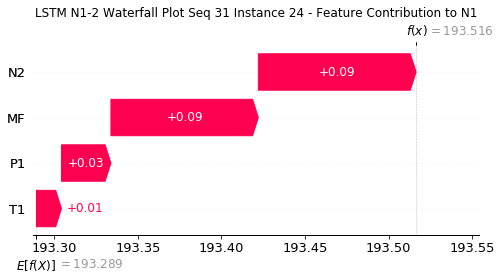

None

Contribution: [0.27901496 0.11246527 0.85694554 0.85083819]


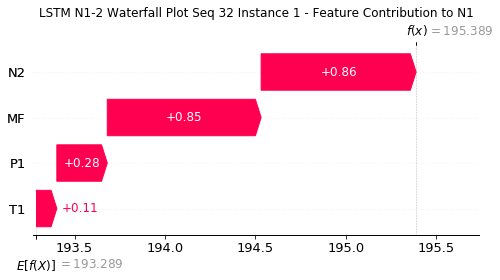

None

Contribution: [0.01501969 0.01099335 0.04496871 0.0434021 ]


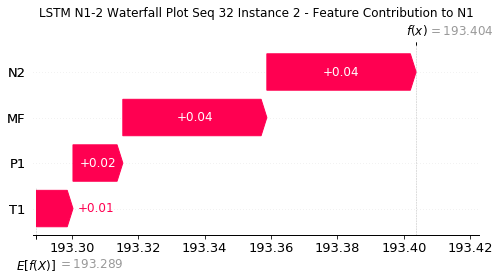

None

Contribution: [0.00261819 0.0020454  0.00837177 0.00755182]


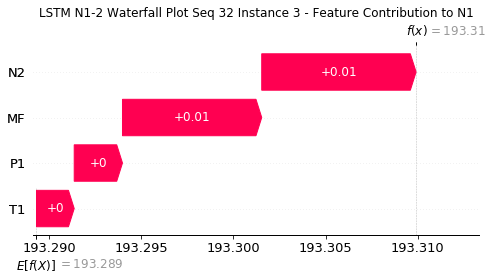

None

Contribution: [0.00138582 0.00109677 0.00444276 0.00402254]


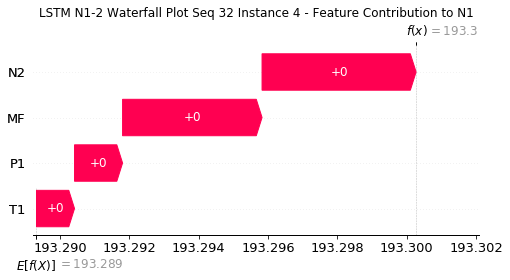

None

Contribution: [0.00112474 0.00090126 0.00357909 0.00326122]


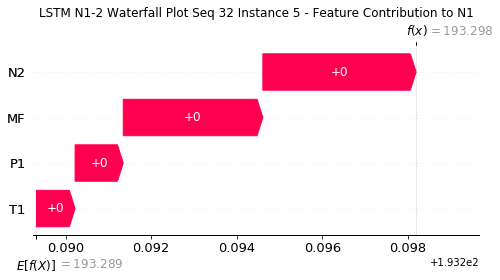

None

Contribution: [0.00093787 0.00077951 0.00303238 0.00275513]


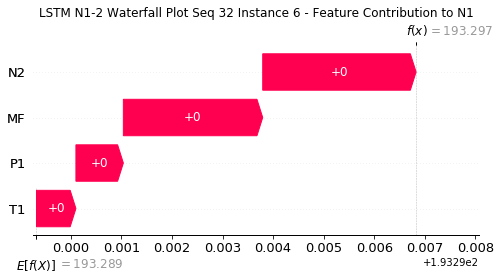

None

Contribution: [0.00091697 0.00073963 0.002918   0.00266978]


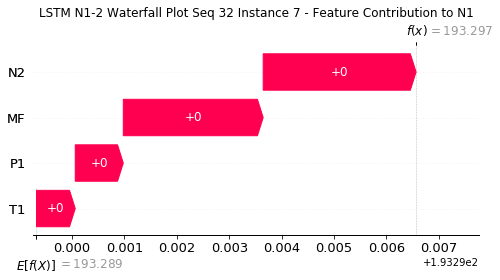

None

Contribution: [0.00091341 0.00073283 0.00288429 0.00266843]


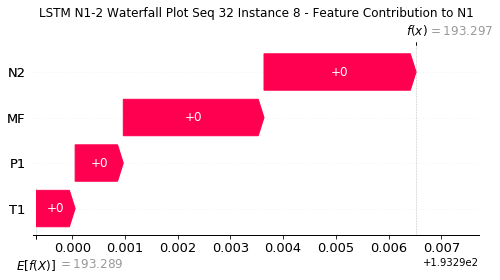

None

Contribution: [0.00091417 0.00074448 0.00286748 0.00268941]


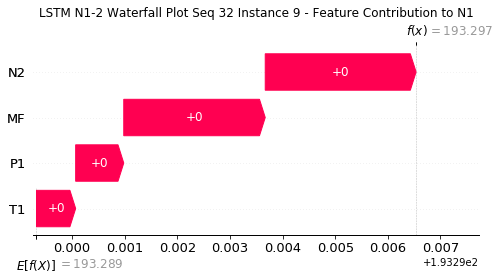

None

Contribution: [0.00089569 0.00073608 0.00284237 0.00261941]


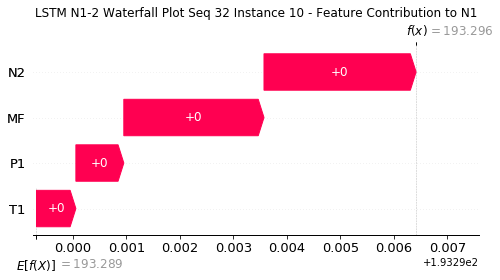

None

Contribution: [0.00089423 0.00071321 0.00284047 0.00260756]


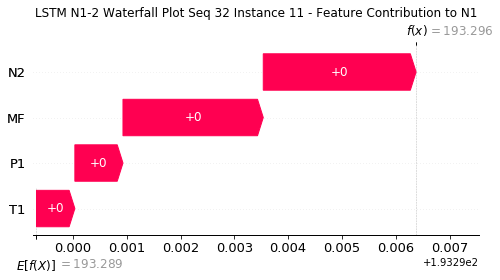

None

Contribution: [0.00090463 0.00071737 0.0028702  0.00263745]


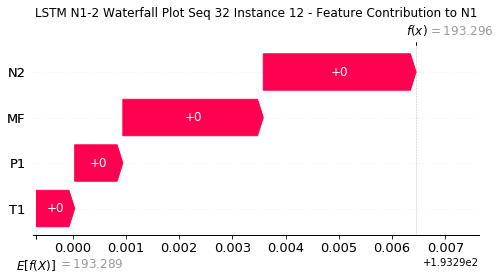

None

Contribution: [0.00091268 0.00071957 0.0029225  0.00265915]


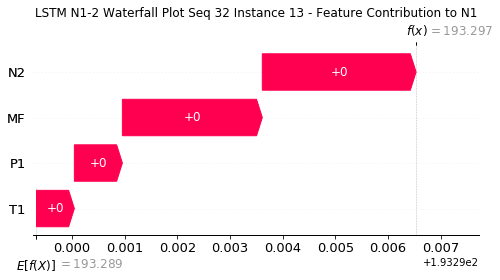

None

Contribution: [0.00095657 0.00075423 0.00303946 0.00279441]


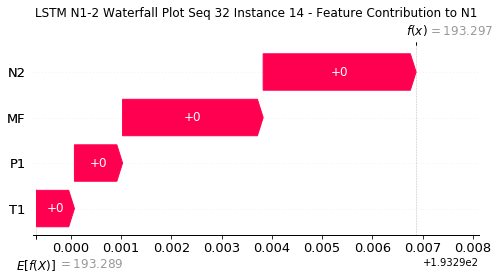

None

Contribution: [0.00097639 0.00074513 0.00319225 0.0029193 ]


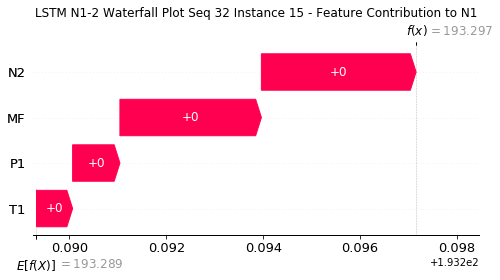

None

Contribution: [0.00110687 0.00086694 0.0035096  0.00322838]


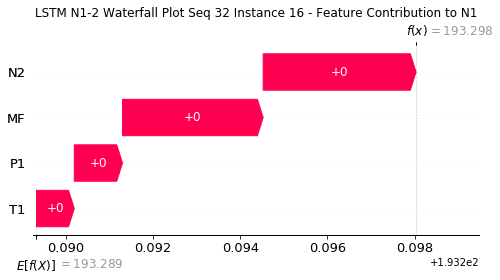

None

Contribution: [0.00126091 0.00098616 0.00399995 0.00367489]


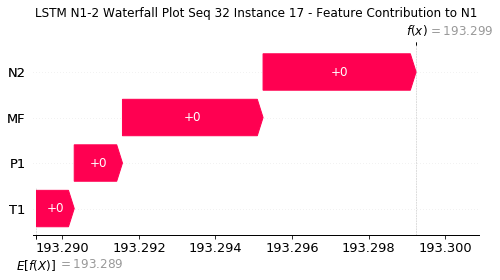

None

Contribution: [0.00153822 0.00118302 0.00487469 0.00449221]


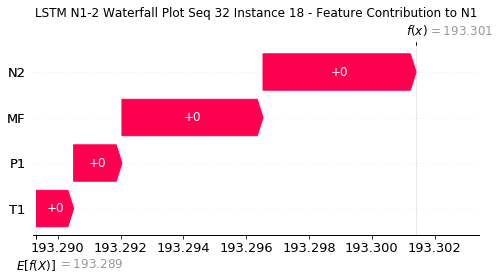

None

Contribution: [0.00204938 0.00158347 0.00647703 0.00596558]


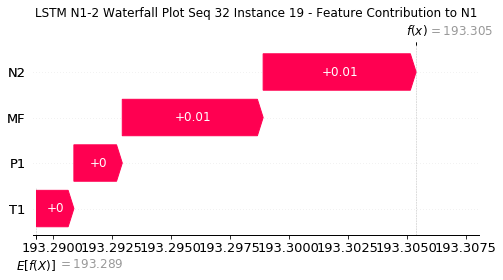

None

Contribution: [0.00303775 0.00236262 0.00960178 0.0088475 ]


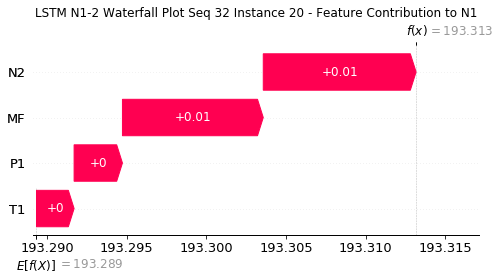

None

Contribution: [0.00502359 0.00390953 0.01587228 0.01466171]


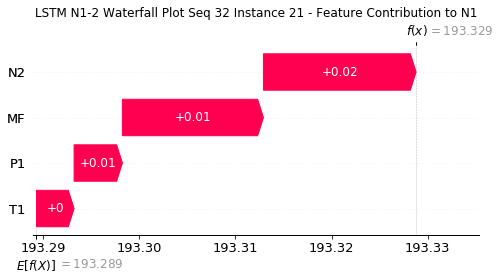

None

Contribution: [0.00896473 0.00705494 0.02839213 0.02621575]


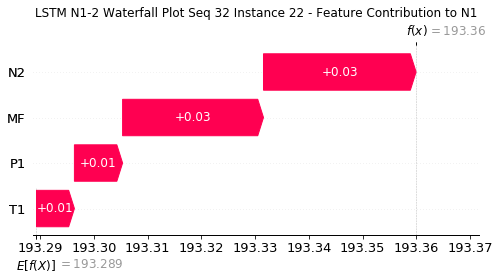

None

Contribution: [0.01623228 0.01271908 0.05149301 0.04761086]


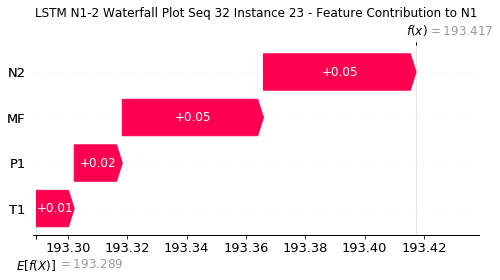

None

Contribution: [0.02949386 0.01576162 0.09426151 0.08939733]


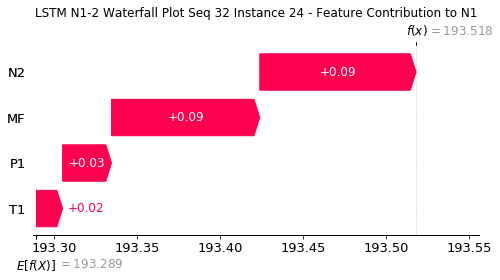

None

Contribution: [0.26095062 0.09674816 0.86136268 0.8198828 ]


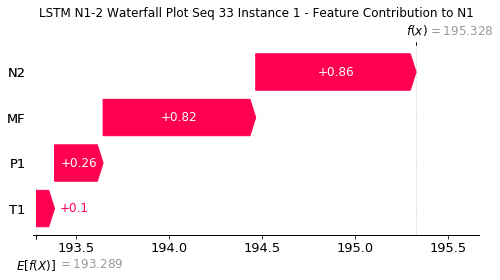

None

Contribution: [0.01500513 0.01113251 0.04579644 0.04377962]


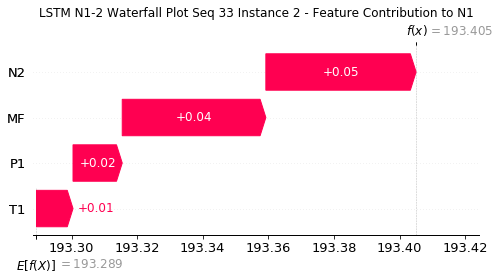

None

Contribution: [0.00259622 0.0021097  0.00846068 0.00753233]


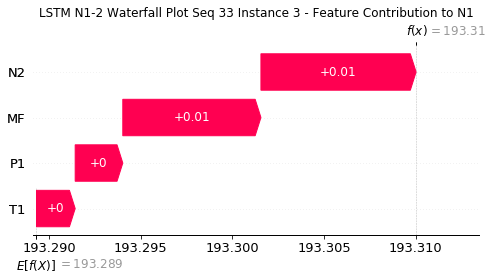

None

Contribution: [0.00135597 0.00103322 0.00443897 0.00402042]


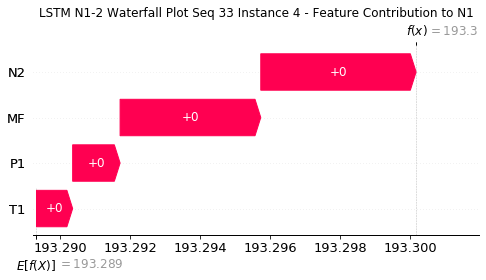

None

Contribution: [0.00110679 0.00085316 0.00358839 0.00326874]


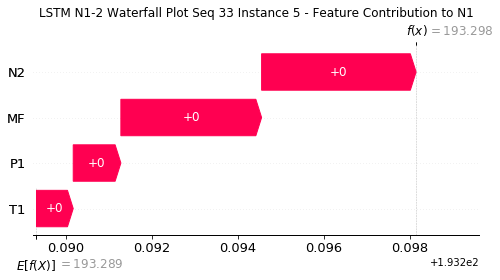

None

Contribution: [0.00094835 0.00075979 0.00305681 0.00277882]


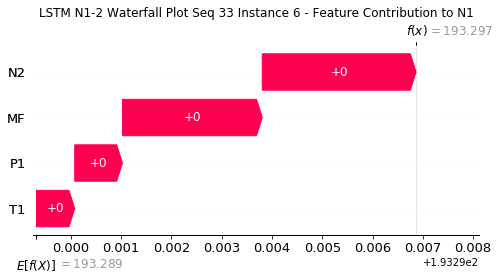

None

Contribution: [0.00090295 0.00069442 0.00292192 0.00266827]


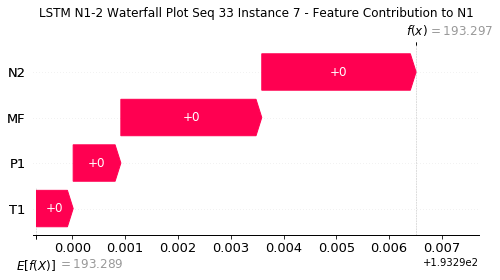

None

Contribution: [0.00090667 0.00065407 0.00287111 0.0026152 ]


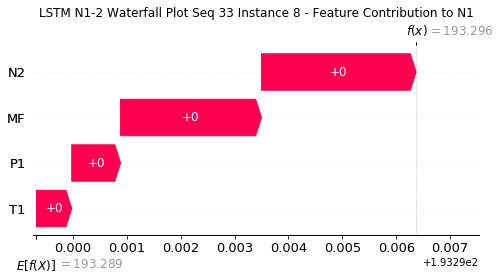

None

Contribution: [0.00090115 0.00069516 0.00285112 0.00263327]


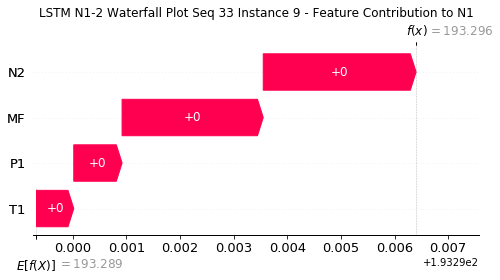

None

Contribution: [0.00088769 0.00063775 0.00282537 0.00257729]


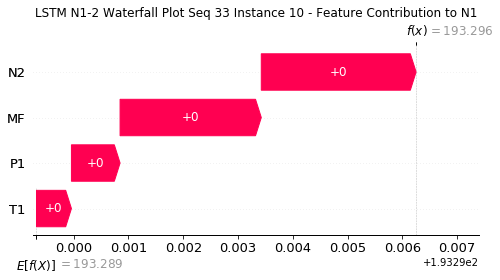

None

Contribution: [0.00088105 0.00066387 0.00283588 0.00259886]


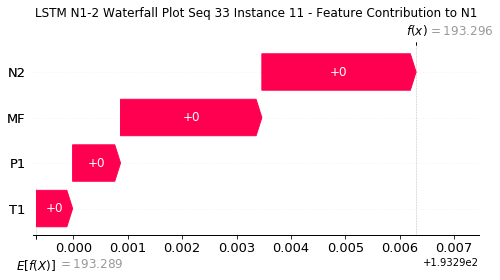

None

Contribution: [0.00089138 0.00067177 0.00286708 0.00262808]


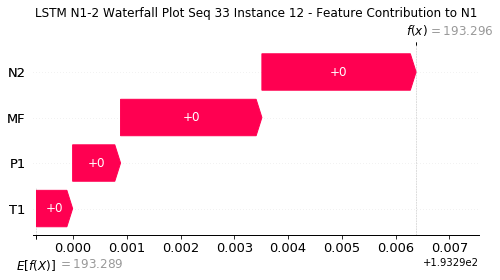

None

Contribution: [0.00093238 0.00069099 0.0029333  0.00270812]


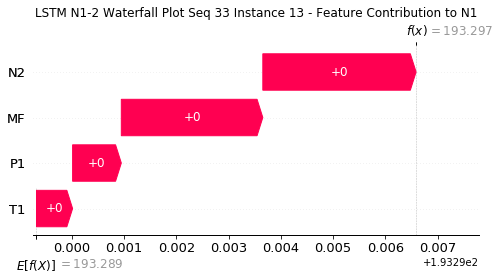

None

Contribution: [0.00094736 0.00070431 0.00303679 0.00279022]


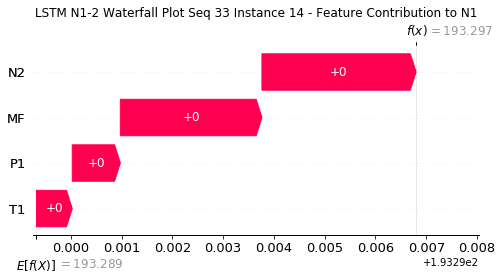

None

Contribution: [0.00099037 0.00073867 0.00320129 0.00290732]


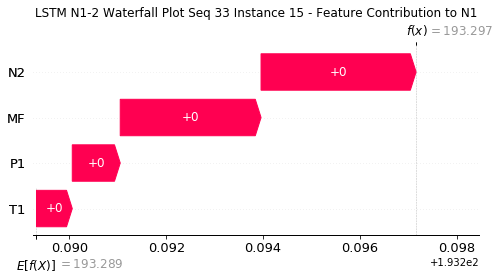

None

Contribution: [0.00109402 0.00081134 0.00350504 0.00321533]


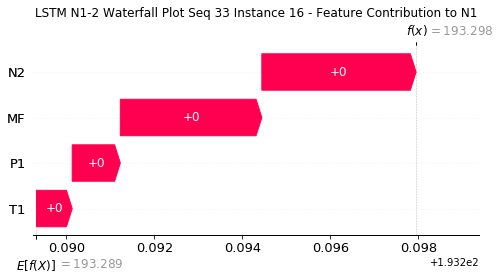

None

Contribution: [0.0012417  0.00092243 0.00399657 0.00366397]


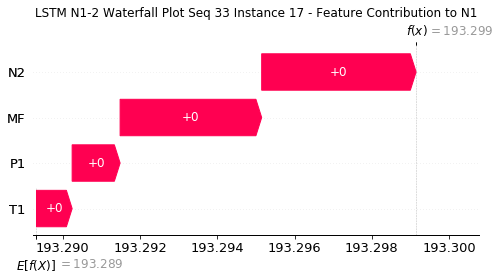

None

Contribution: [0.00155629 0.00111575 0.00488204 0.00452924]


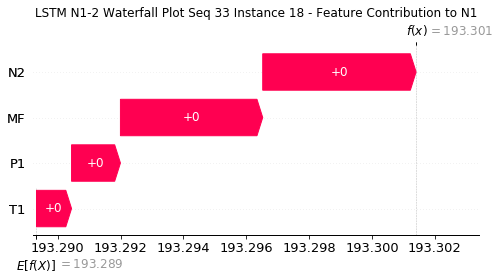

None

Contribution: [0.00202673 0.00149636 0.00648486 0.005971  ]


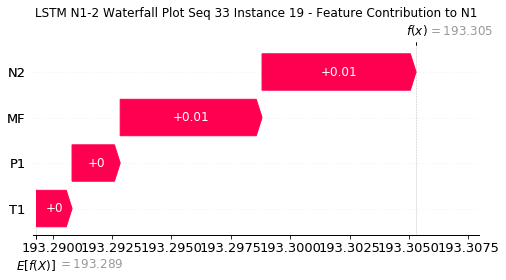

None

Contribution: [0.00300001 0.00222892 0.00961406 0.00886443]


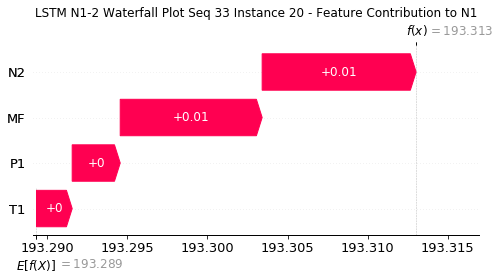

None

Contribution: [0.00497824 0.00367512 0.01588309 0.01472576]


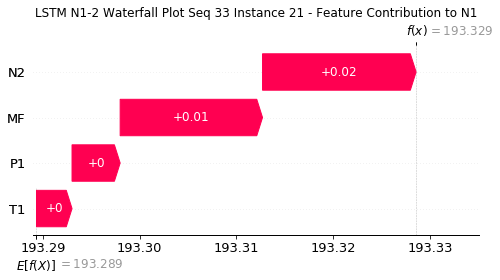

None

Contribution: [0.00886122 0.00657043 0.02835681 0.02628085]


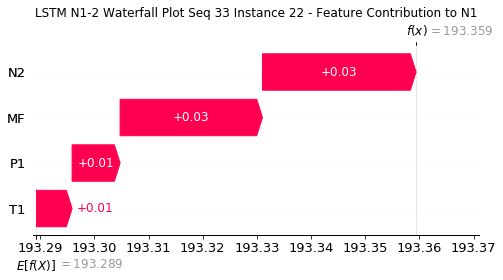

None

Contribution: [0.01603245 0.01152195 0.05131636 0.04795496]


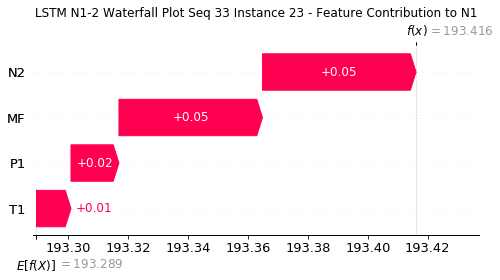

None

Contribution: [0.02728819 0.00488804 0.09220169 0.08962169]


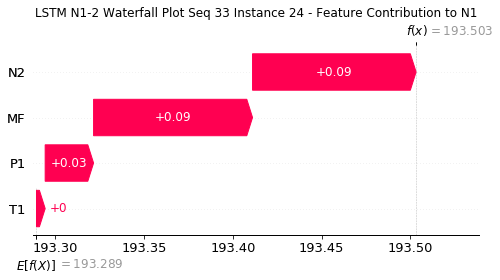

None

Contribution: [0.23412645 0.02937289 0.85078258 0.78713395]


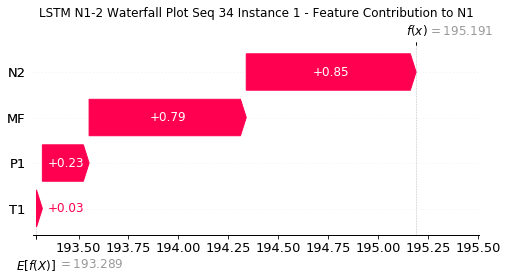

None

Contribution: [0.01526566 0.01034361 0.04700777 0.04474629]


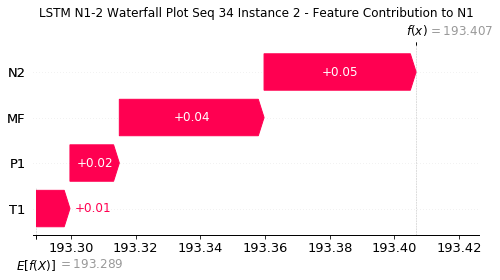

None

Contribution: [0.00258342 0.00193992 0.00855054 0.00751576]


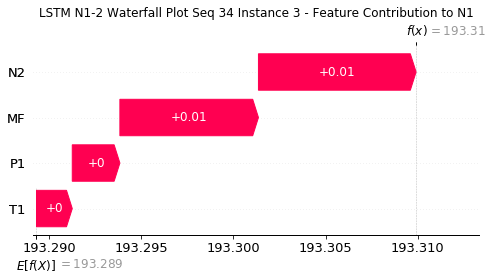

None

Contribution: [0.00134233 0.00095606 0.00441508 0.0040314 ]


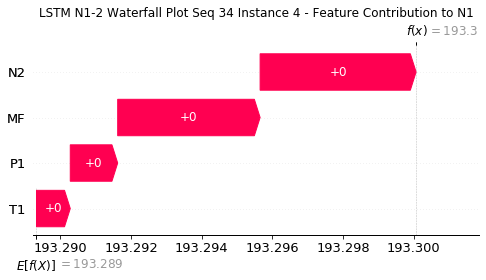

None

Contribution: [0.0011002  0.0008038  0.00359189 0.00328644]


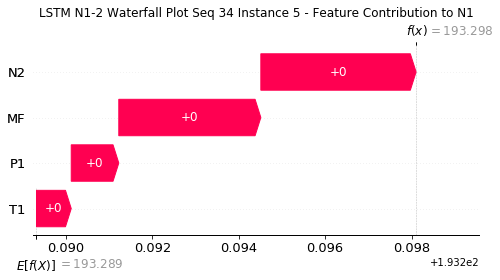

None

Contribution: [0.0009183  0.0006754  0.00306293 0.00279981]


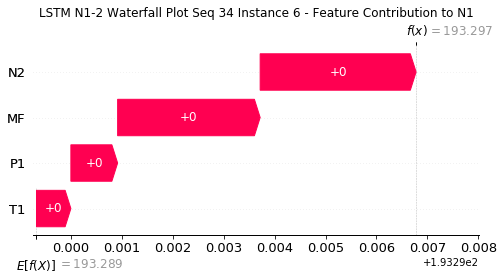

None

Contribution: [0.00089204 0.00065703 0.00292727 0.00268252]


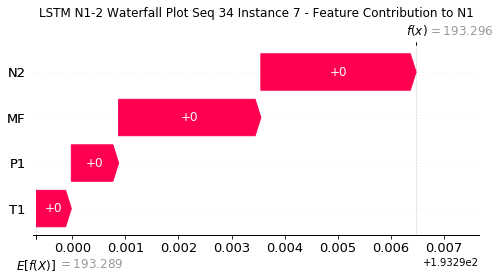

None

Contribution: [0.00086504 0.0006479  0.00288259 0.00264792]


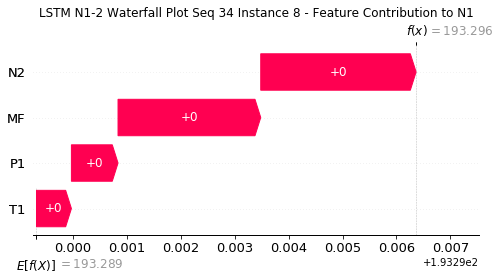

None

Contribution: [0.00082593 0.0006271  0.00284107 0.00258234]


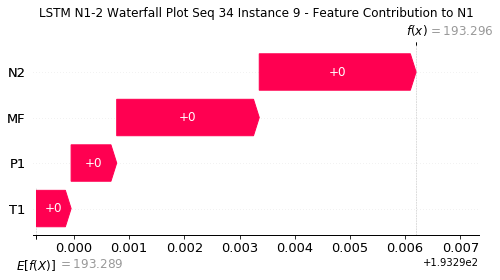

None

Contribution: [0.0008321  0.00062738 0.00282613 0.00255518]


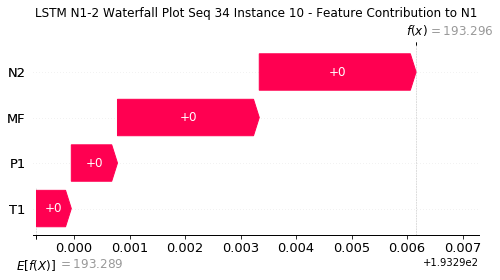

None

Contribution: [0.0008669  0.00063014 0.00284223 0.00259245]


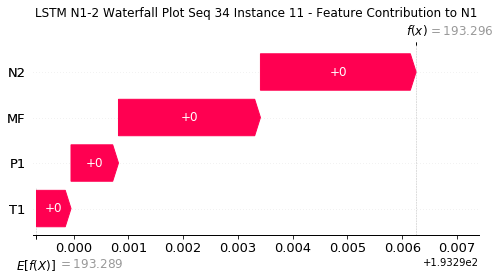

None

Contribution: [0.00088087 0.00064038 0.00287557 0.00263208]


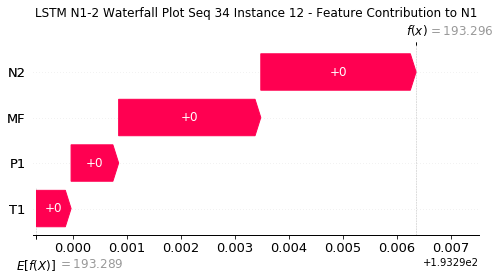

None

Contribution: [0.00089103 0.00067413 0.00293736 0.00267215]


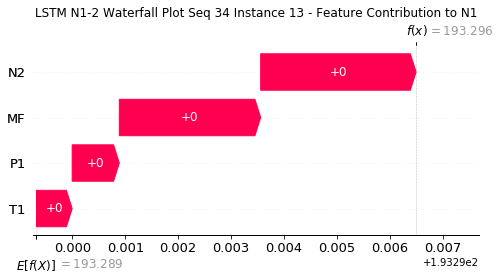

None

Contribution: [0.00093291 0.00067802 0.00304651 0.00278513]


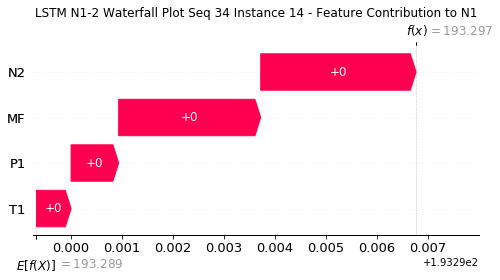

None

Contribution: [0.00096889 0.0006993  0.00321621 0.00291879]


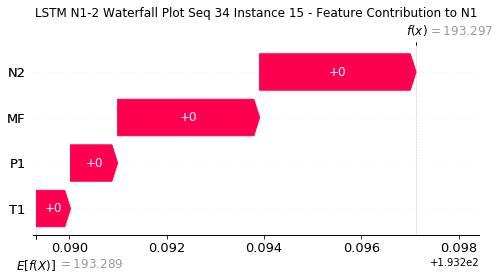

None

Contribution: [0.0010834  0.00078352 0.0035236  0.00322562]


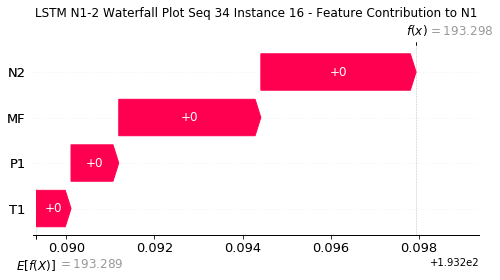

None

Contribution: [0.00123539 0.00089132 0.00401975 0.00367758]


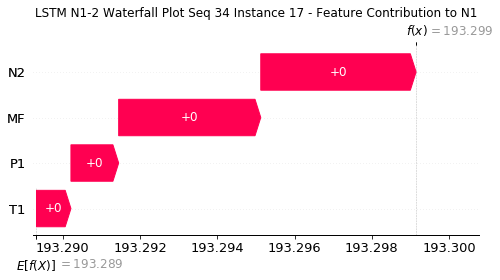

None

Contribution: [0.00152959 0.00113208 0.00490918 0.00454109]


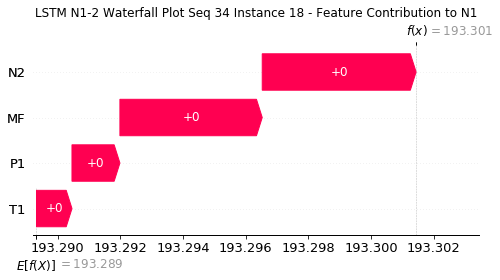

None

Contribution: [0.00203249 0.0014734  0.00652989 0.00602421]


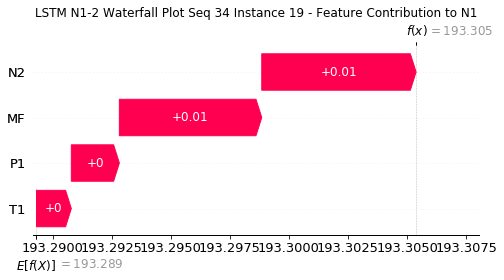

None

Contribution: [0.0030109  0.0021969  0.00968207 0.00892683]


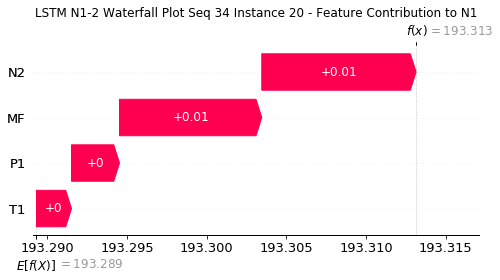

None

Contribution: [0.00497952 0.00366247 0.01598213 0.01475641]


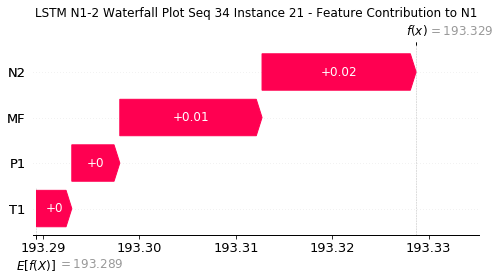

None

Contribution: [0.00882034 0.00651446 0.02851982 0.02621234]


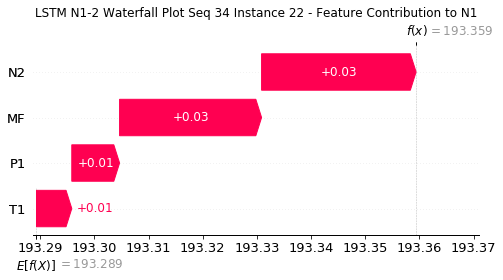

None

Contribution: [0.0159302  0.01144616 0.05151973 0.04765342]


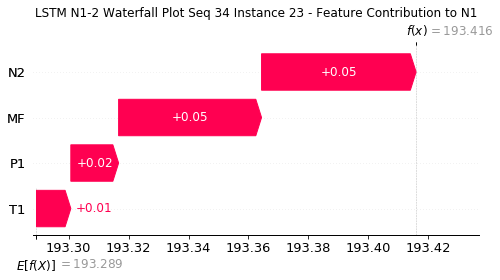

None

Contribution: [0.02708923 0.00337922 0.09264957 0.08818111]


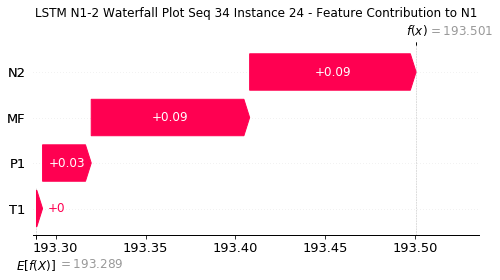

None

In [33]:
#Waterfall Plot for Local Accuracy & Consistency metrics - Full features
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("LSTM N1-2 Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution to N1" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [34]:
#Define New LSTM without probabilistic layers for Consistency metrics

inputs = tf.keras.Input(shape=(24,3),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model3 = tf.keras.Model(inputs=inputs, outputs=layer4)
model3.summary()

Model: "functional_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 24, 3)]           0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 24, 860)           2972160   
_________________________________________________________________
dense_5 (Dense)              (None, 24, 123)           105903    
_________________________________________________________________
dense_6 (Dense)              (None, 24, 1)             124       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 3,078,187
Trainable params: 3,078,187
Non-trainable params: 0
_________________________________________________________________


In [35]:
#Extract only weights for 3 variables excluding MF

a = model2.layers[1].get_weights()[0][0:3]
a = [a,model2.layers[1].get_weights()[1],model2.layers[1].get_weights()[2]]

In [36]:
#Transfer weights from previous LSTM to new LSTM with only Aleatoric Layer Output

model3.layers[0].set_weights(model2.layers[0].get_weights())
model3.layers[1].set_weights(a)
model3.layers[2].set_weights(model2.layers[2].get_weights())
model3.layers[3].set_weights(model2.layers[3].get_weights())
model3.layers[4].set_weights(model2.layers[4].get_weights())

In [37]:
#Load xtest and delete MF

xtrain_file = "xtrain.csv"
xtrain = pd.read_csv(xtrain_file, index_col=False)
xtrain = xtrain.drop(['MF'],axis=1)

#Load xtest and delete MF

xtest_file = "xtest.csv"
xtest = pd.read_csv(xtest_file, index_col=False)
xtest = xtest.drop(['MF'],axis=1)

#Xtest to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,3)

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,3)

In [38]:
#Prediction with features excluding MF 

preds3 = model3(xtest)
y4 = preds3
y4 = tf.keras.backend.get_value(y4)
tens_draw4 = y4

In [39]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = features.drop(['MF'],axis=1)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2'], dtype='<U2')

Contribution: [0.30899104 0.05432156 1.9282904 ]


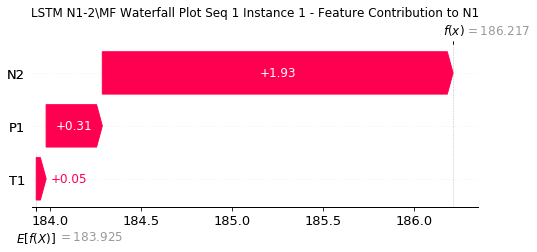

None

Contribution: [0.03096839 0.0163326  0.13584592]


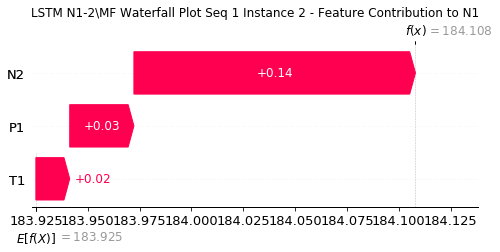

None

Contribution: [0.00237451 0.00059938 0.01200872]


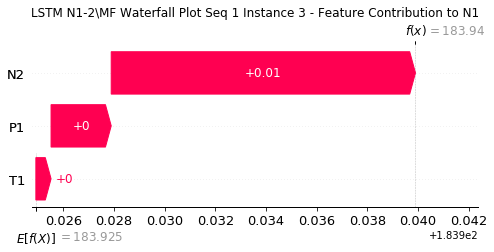

None

Contribution: [0.00202322 0.00221652 0.00711024]


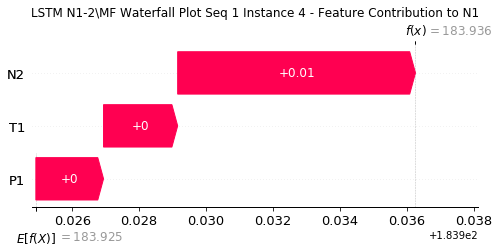

None

Contribution: [0.00180551 0.00191041 0.00624368]


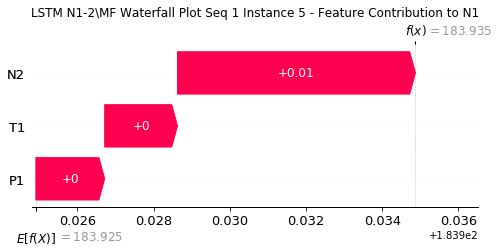

None

Contribution: [0.00155302 0.00169964 0.00540109]


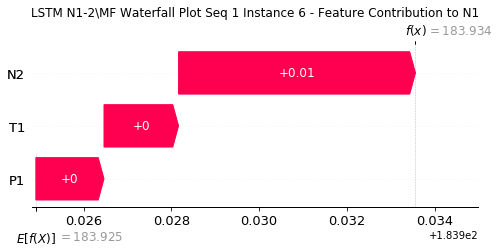

None

Contribution: [0.00153464 0.00165765 0.00525437]


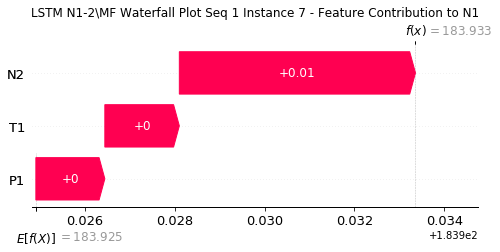

None

Contribution: [0.00149785 0.00169278 0.00522485]


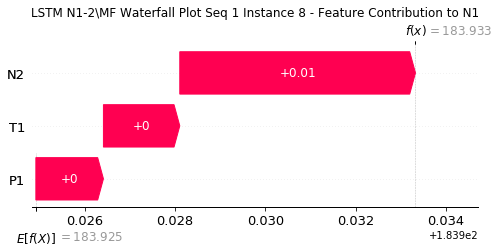

None

Contribution: [0.00152531 0.00166731 0.00526053]


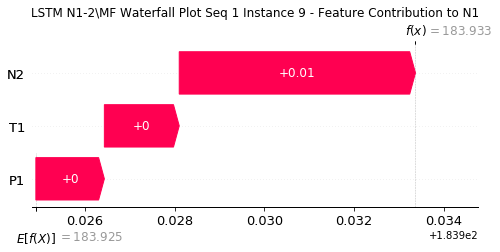

None

Contribution: [0.00152904 0.00162718 0.00529074]


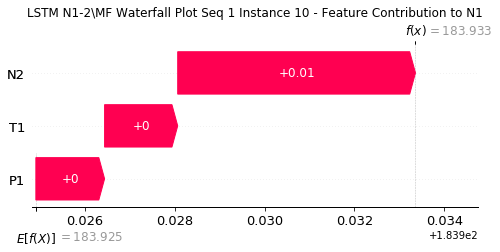

None

Contribution: [0.00158093 0.0016662  0.00544209]


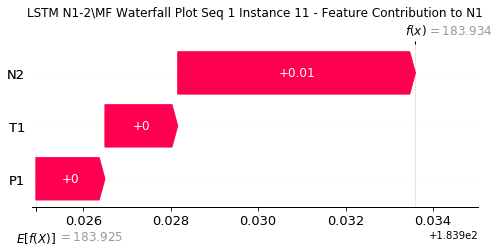

None

Contribution: [0.00167591 0.00169967 0.00566052]


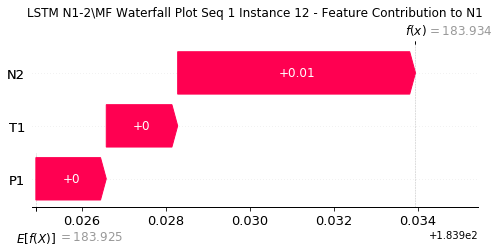

None

Contribution: [0.00175715 0.00182606 0.00601083]


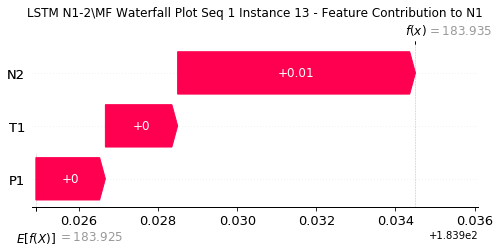

None

Contribution: [0.0018657  0.00196257 0.00651884]


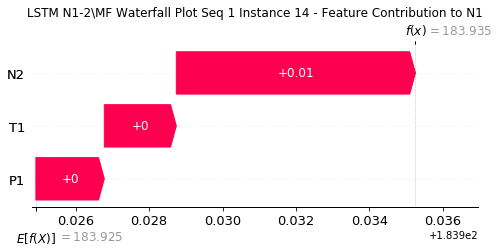

None

Contribution: [0.00216657 0.00221445 0.00734532]


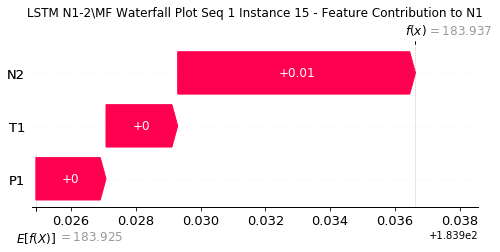

None

Contribution: [0.00253733 0.00258203 0.00857559]


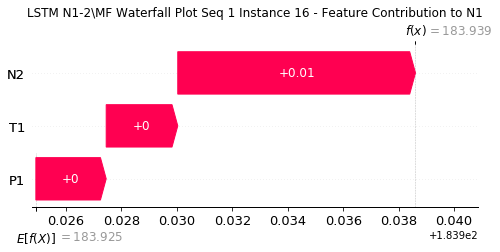

None

Contribution: [0.00308506 0.00320043 0.01053722]


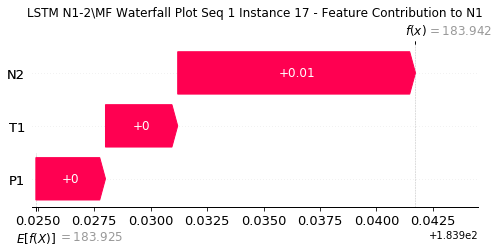

None

Contribution: [0.00407702 0.0040945  0.0136313 ]


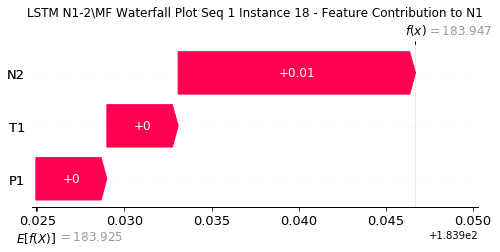

None

Contribution: [0.00561769 0.00561656 0.01874375]


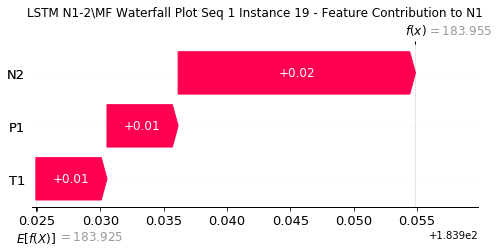

None

Contribution: [0.00818568 0.00816106 0.02726455]


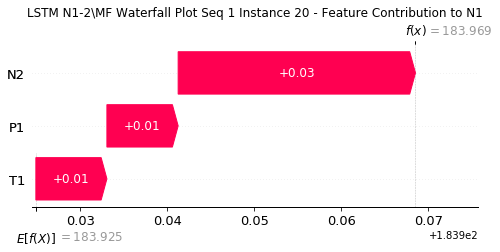

None

Contribution: [0.01241454 0.01243242 0.04146239]


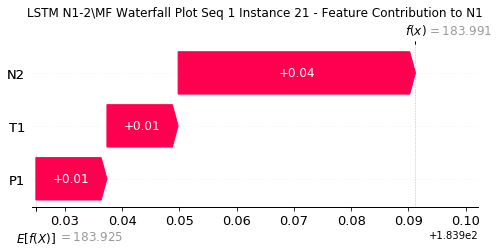

None

Contribution: [0.01923238 0.0193487  0.06455656]


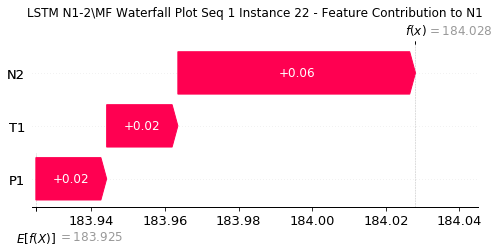

None

Contribution: [0.02840076 0.02987179 0.09818976]


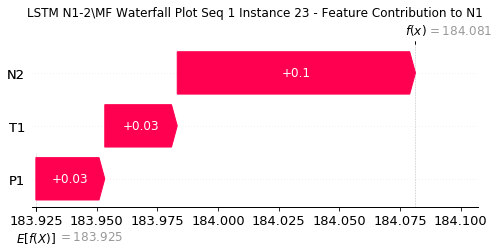

None

Contribution: [0.03575745 0.03148219 0.14228008]


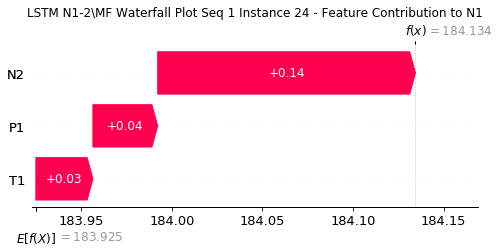

None

Contribution: [0.41663387 0.22936751 1.91276504]


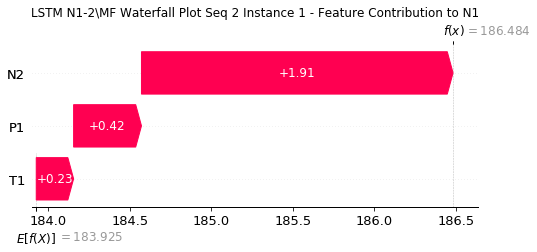

None

Contribution: [0.03472979 0.03074035 0.13192593]


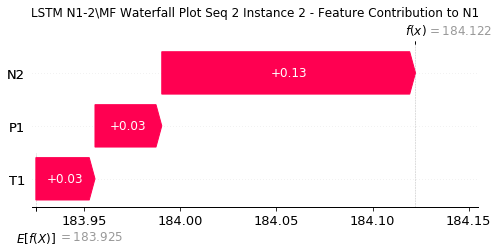

None

Contribution: [0.00273471 0.0016925  0.01176666]


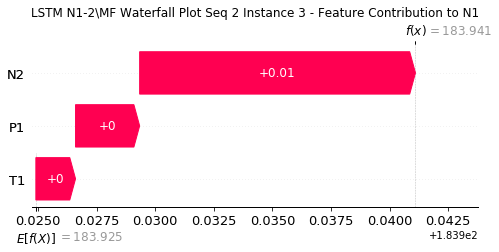

None

Contribution: [0.00210814 0.00241998 0.00718702]


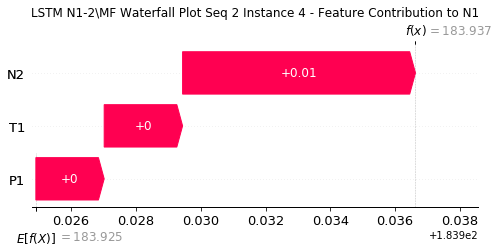

None

Contribution: [0.00183954 0.00204721 0.00619593]


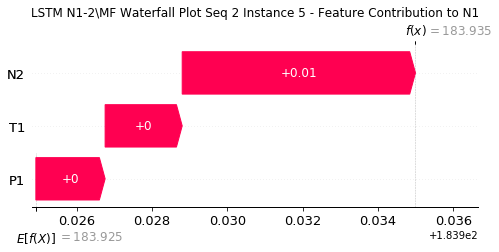

None

Contribution: [0.00158491 0.00180913 0.00536478]


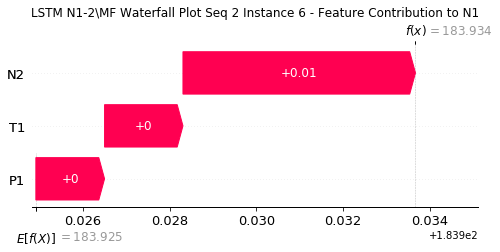

None

Contribution: [0.00153149 0.0016981  0.00516866]


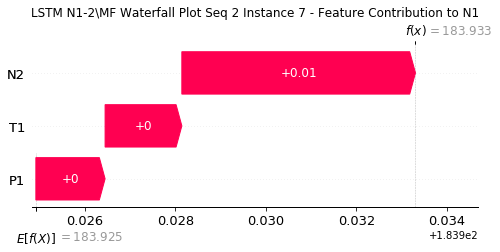

None

Contribution: [0.00151227 0.00168688 0.00513611]


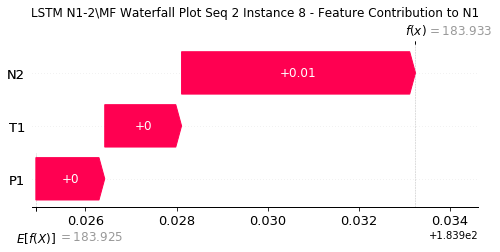

None

Contribution: [0.00154998 0.00166015 0.00516885]


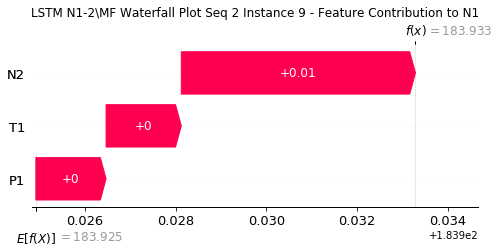

None

Contribution: [0.00154483 0.00174244 0.00523452]


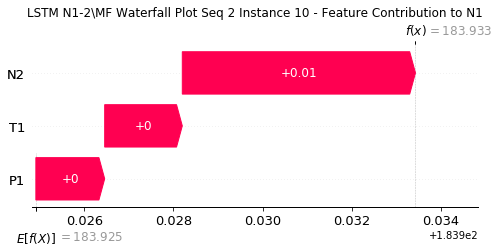

None

Contribution: [0.00158953 0.00178934 0.0053836 ]


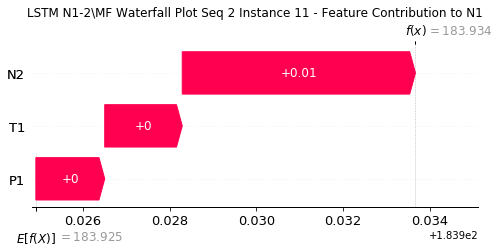

None

Contribution: [0.0016652  0.00177545 0.00558651]


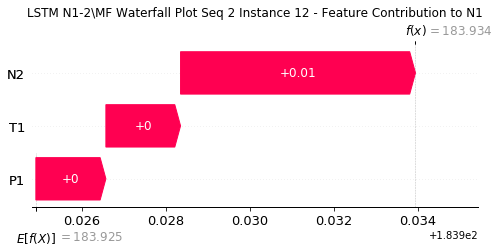

None

Contribution: [0.00176114 0.00192605 0.00593497]


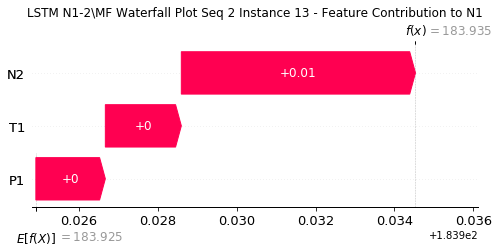

None

Contribution: [0.00187309 0.00208203 0.00644294]


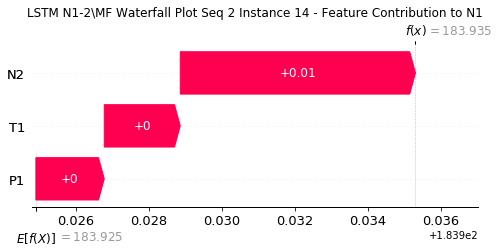

None

Contribution: [0.00215333 0.00233828 0.00723734]


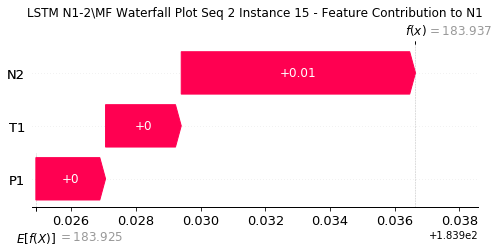

None

Contribution: [0.00252072 0.00273776 0.00844027]


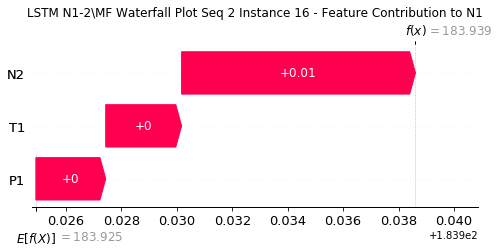

None

Contribution: [0.00303435 0.00325625 0.01033024]


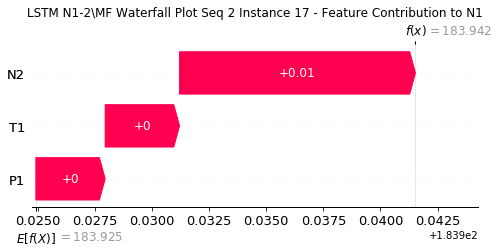

None

Contribution: [0.00402524 0.00423615 0.01339632]


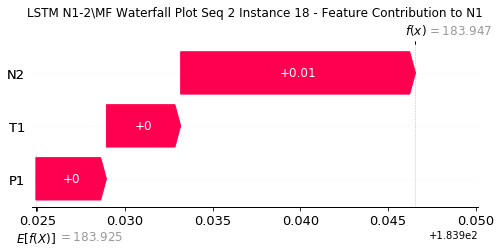

None

Contribution: [0.00555038 0.00580865 0.01841237]


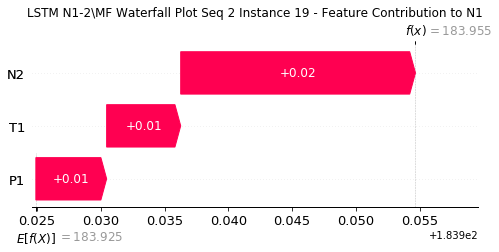

None

Contribution: [0.00810078 0.00829047 0.02680015]


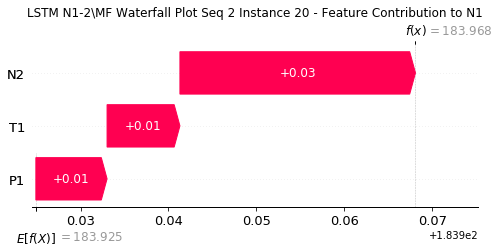

None

Contribution: [0.01232003 0.01276924 0.04077055]


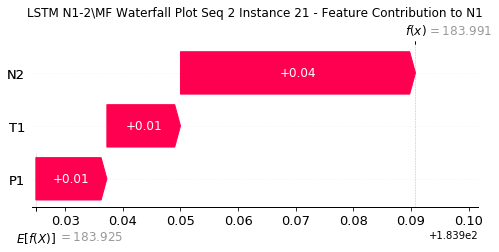

None

Contribution: [0.01917239 0.02041354 0.06352717]


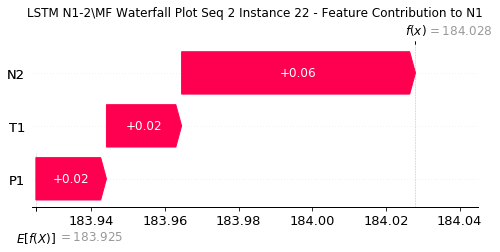

None

Contribution: [0.02749664 0.02905236 0.09647205]


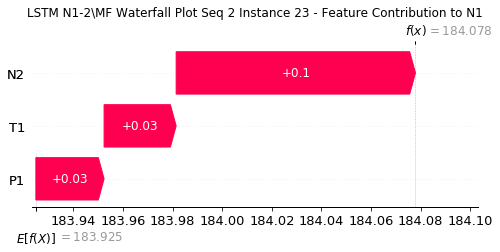

None

Contribution: [0.03265973 0.00578801 0.14151707]


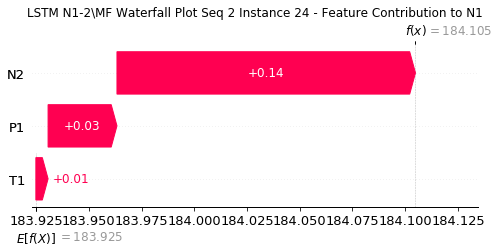

None

Contribution: [ 0.36144073 -0.47883241  1.98495194]


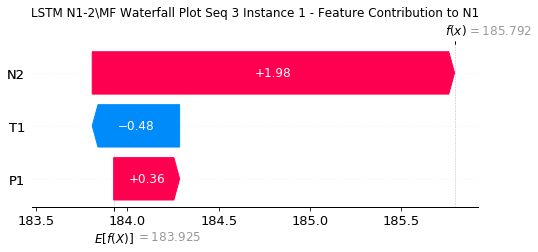

None

Contribution: [ 0.03410882 -0.00613603  0.14166907]


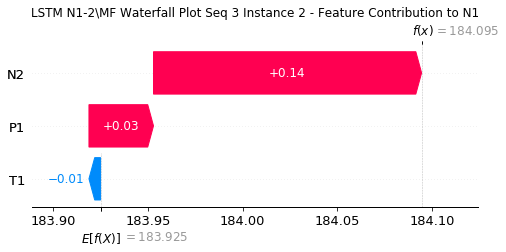

None

Contribution: [ 0.00276695 -0.00278495  0.01244834]


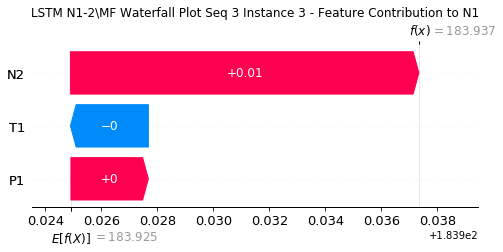

None

Contribution: [0.00201382 0.00166531 0.00701444]


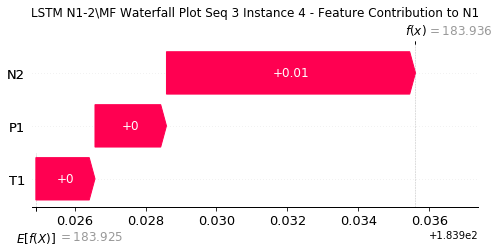

None

Contribution: [0.00182167 0.00148647 0.00630679]


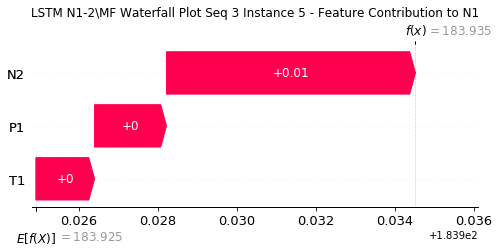

None

Contribution: [0.00158351 0.0013121  0.00548467]


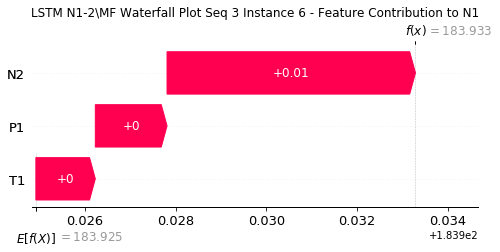

None

Contribution: [0.00151014 0.00124131 0.00529871]


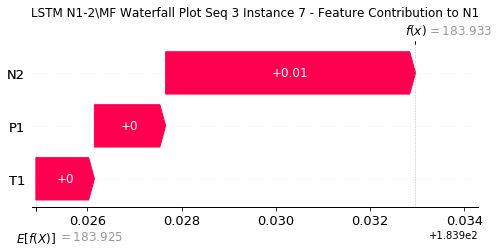

None

Contribution: [0.00154924 0.00112384 0.00526673]


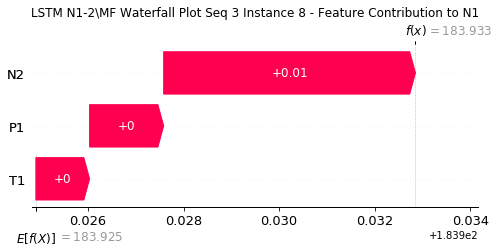

None

Contribution: [0.00152862 0.00117959 0.00530814]


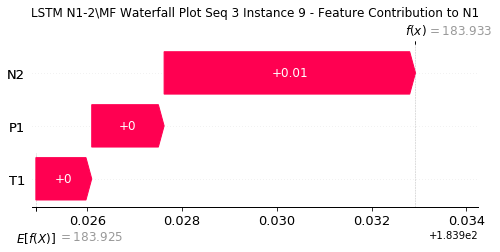

None

Contribution: [0.00155683 0.00123242 0.00538931]


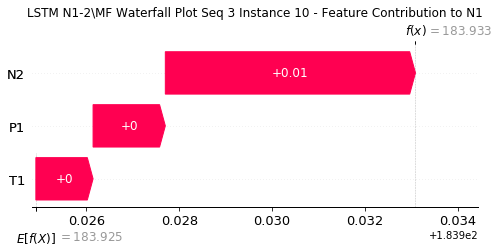

None

Contribution: [0.00160477 0.00127613 0.00554891]


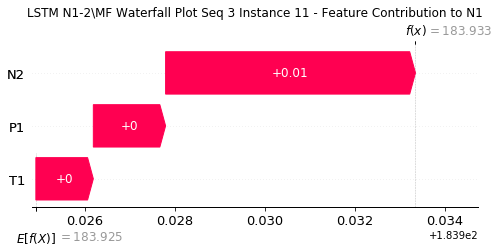

None

Contribution: [0.00168172 0.0012891  0.00576122]


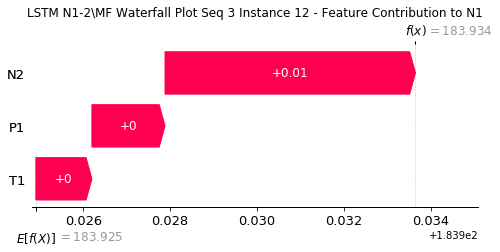

None

Contribution: [0.00178305 0.00139832 0.00614657]


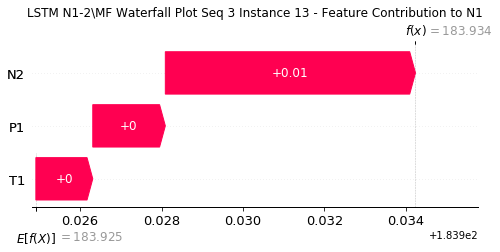

None

Contribution: [0.00195715 0.00154125 0.00669142]


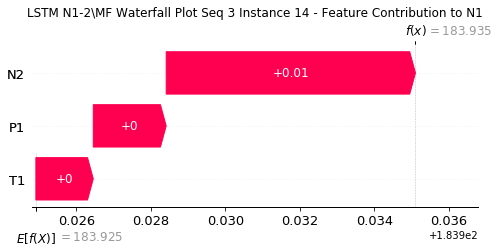

None

Contribution: [0.00219632 0.00170382 0.00754898]


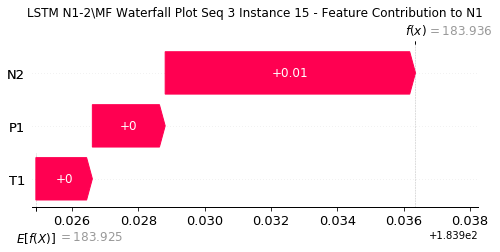

None

Contribution: [0.00258539 0.00197276 0.00884224]


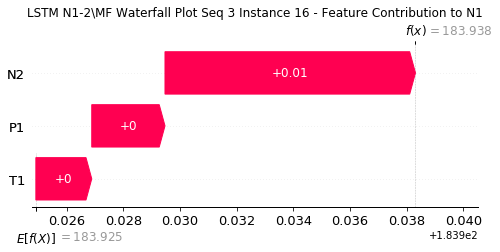

None

Contribution: [0.00321395 0.00246921 0.01087181]


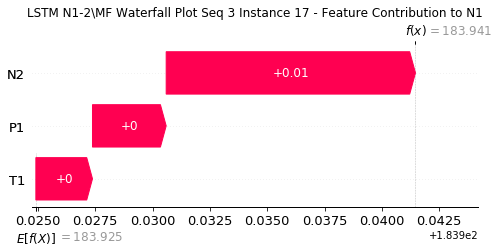

None

Contribution: [0.00414845 0.00321859 0.01413223]


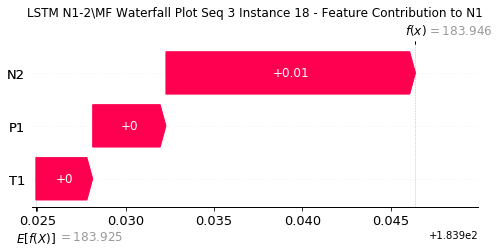

None

Contribution: [0.00572479 0.00438202 0.01944352]


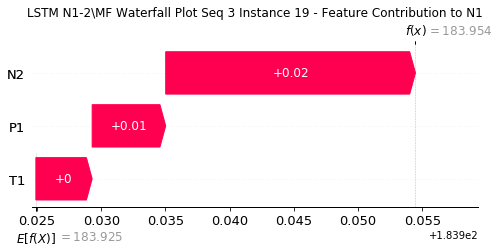

None

Contribution: [0.0083192  0.00635991 0.0282215 ]


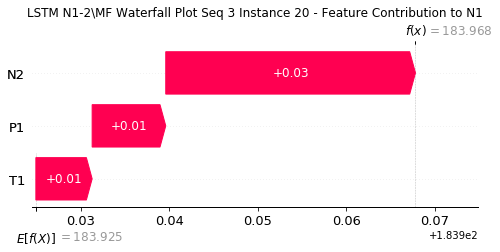

None

Contribution: [0.01259558 0.00937829 0.04272129]


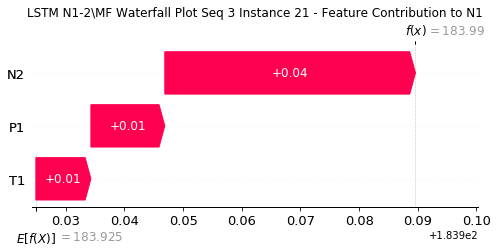

None

Contribution: [0.01942258 0.01406811 0.06603673]


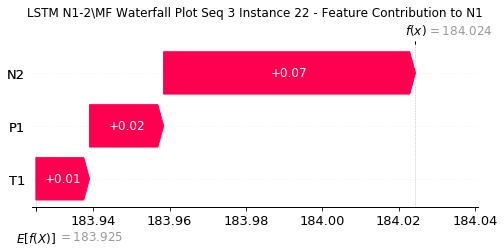

None

Contribution: [0.0285459  0.01472464 0.09936501]


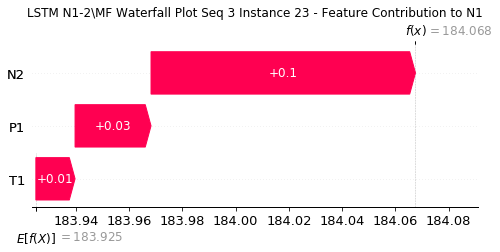

None

Contribution: [ 0.03215438 -0.03033559  0.14132985]


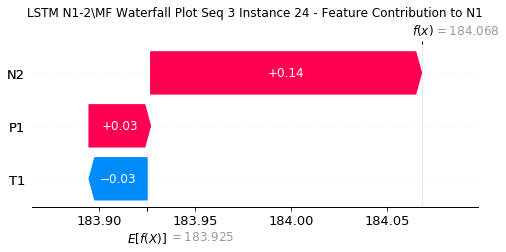

None

Contribution: [ 0.33246372 -0.91111091  1.95411958]


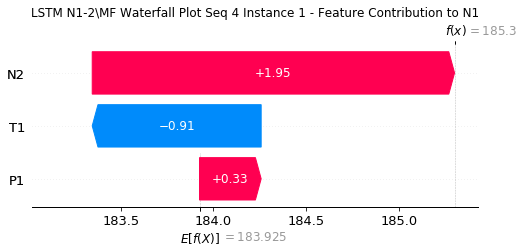

None

Contribution: [ 0.03310258 -0.02507802  0.14344462]


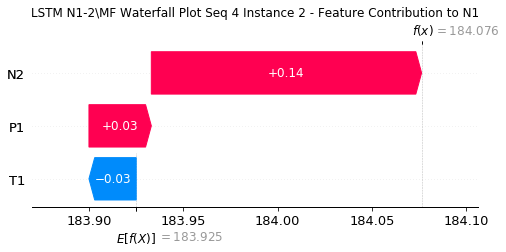

None

Contribution: [ 0.00296709 -0.00241084  0.01274695]


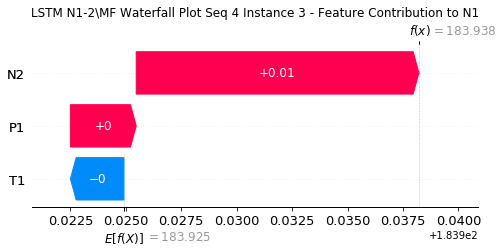

None

Contribution: [0.00196363 0.00163158 0.00684941]


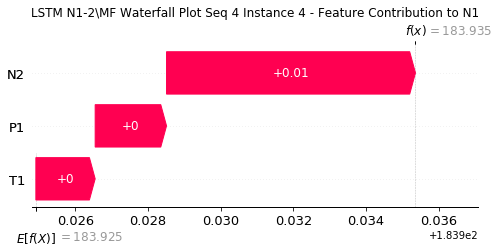

None

Contribution: [0.0018364  0.00162055 0.00630618]


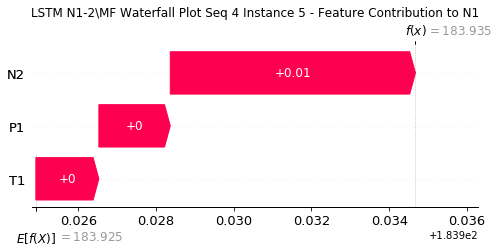

None

Contribution: [0.00160301 0.00133962 0.00554456]


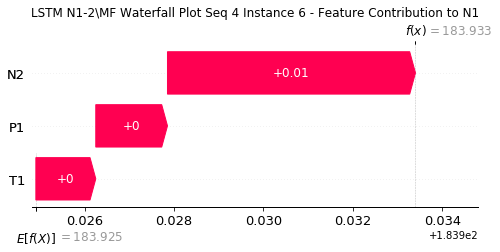

None

Contribution: [0.00158886 0.00125948 0.00540919]


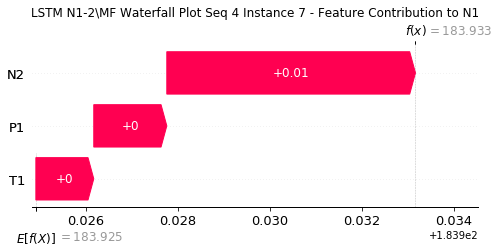

None

Contribution: [0.00156987 0.00122077 0.00539072]


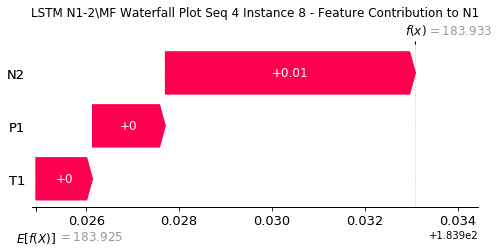

None

Contribution: [0.00156095 0.00126227 0.00542615]


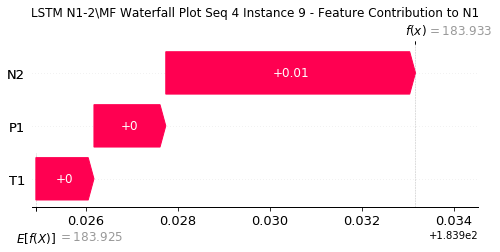

None

Contribution: [0.00159243 0.00126352 0.00549119]


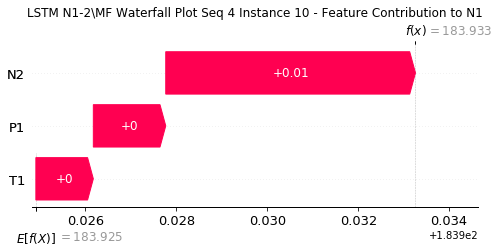

None

Contribution: [0.00164914 0.00128768 0.00565106]


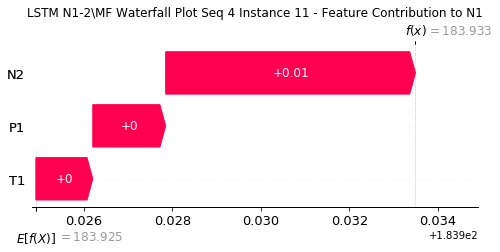

None

Contribution: [0.00164574 0.00125039 0.00585726]


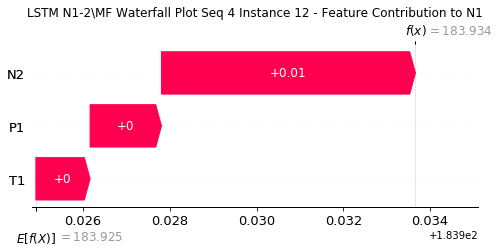

None

Contribution: [0.00182905 0.00140013 0.00626625]


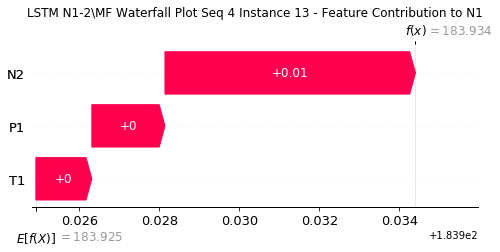

None

Contribution: [0.00201991 0.00147065 0.00684174]


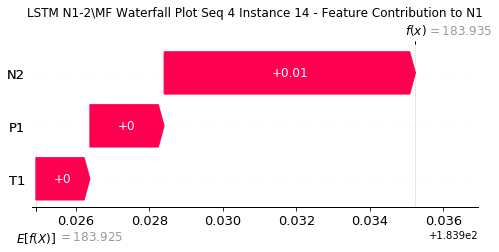

None

Contribution: [0.00227064 0.00168717 0.00772021]


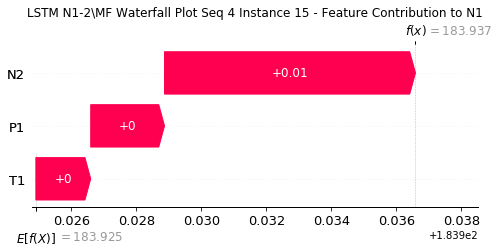

None

Contribution: [0.00266648 0.00197104 0.00906195]


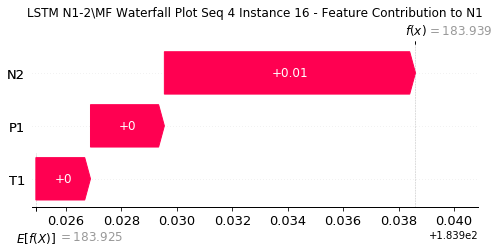

None

Contribution: [0.00334999 0.00245816 0.01117399]


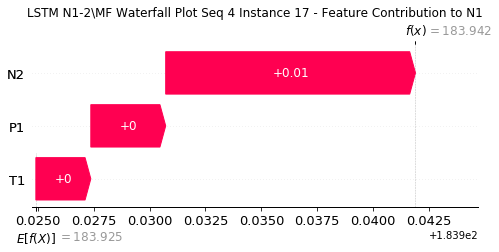

None

Contribution: [0.00431244 0.00314383 0.01451994]


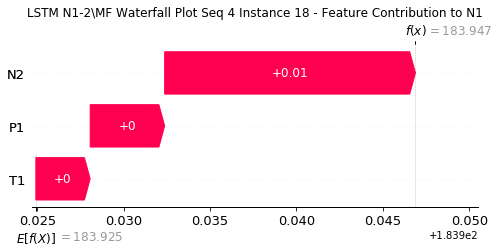

None

Contribution: [0.00593191 0.00432056 0.01999076]


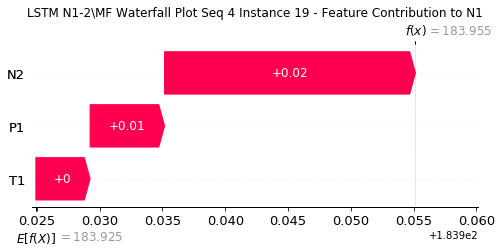

None

Contribution: [0.00858888 0.00624208 0.0289831 ]


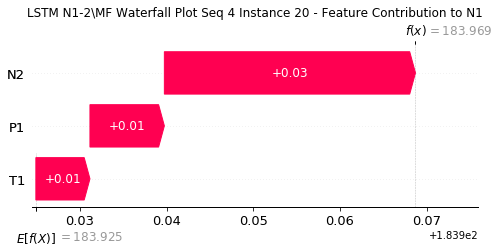

None

Contribution: [0.01289659 0.00931277 0.04378135]


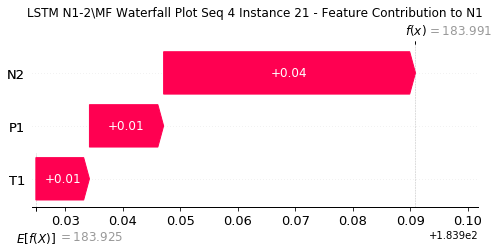

None

Contribution: [0.01971752 0.01386943 0.06730392]


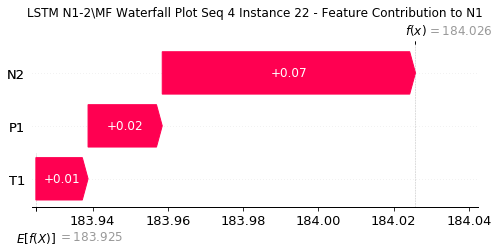

None

Contribution: [0.02914122 0.01625239 0.10070712]


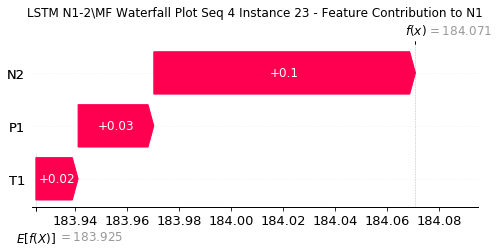

None

Contribution: [ 0.03375117 -0.03219427  0.14385461]


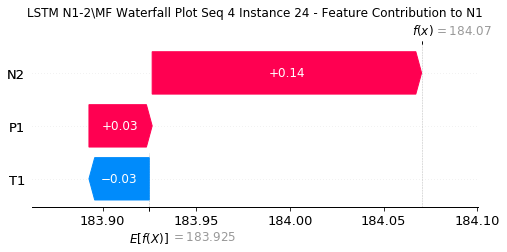

None

Contribution: [ 0.37959547 -1.03969647  1.97944186]


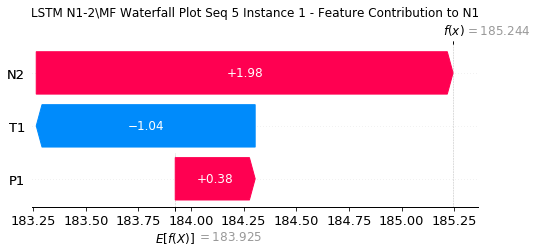

None

Contribution: [ 0.03562911 -0.03828648  0.14425799]


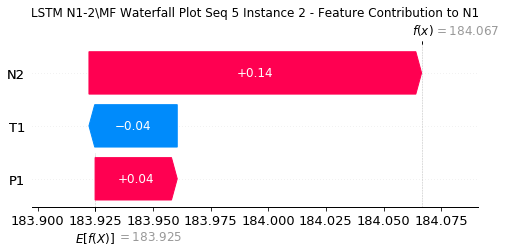

None

Contribution: [ 0.00298446 -0.00380305  0.01297963]


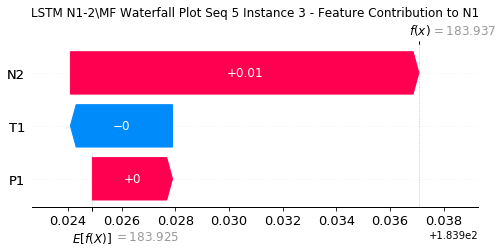

None

Contribution: [0.00195248 0.00143675 0.00681608]


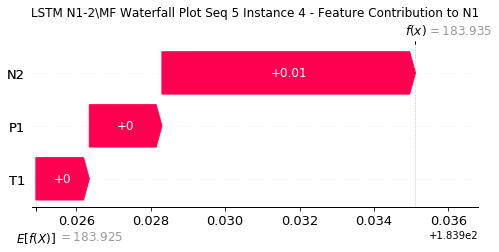

None

Contribution: [0.0018425  0.00131147 0.0062791 ]


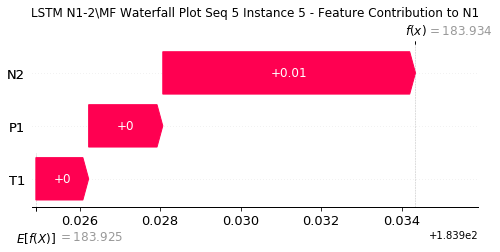

None

Contribution: [0.00160188 0.00119878 0.005554  ]


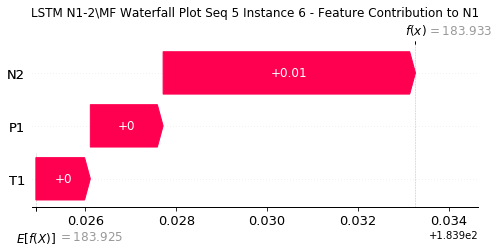

None

Contribution: [0.00157702 0.00114473 0.0054258 ]


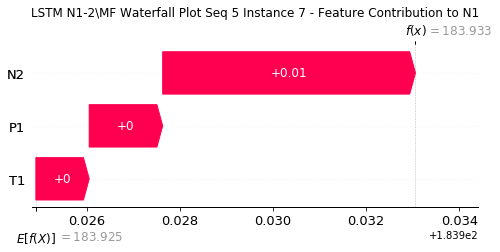

None

Contribution: [0.00153382 0.00113303 0.00539611]


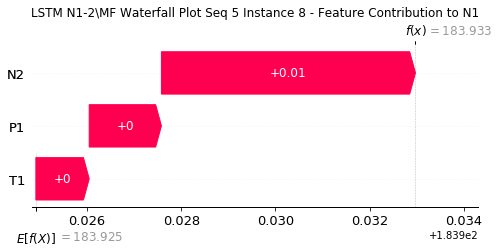

None

Contribution: [0.00157952 0.00118632 0.00545587]


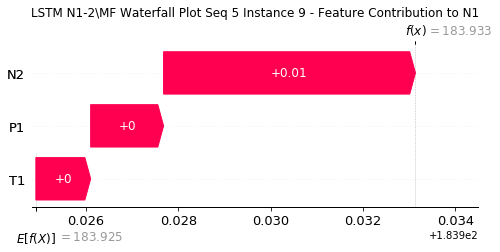

None

Contribution: [0.00161088 0.00119098 0.00551961]


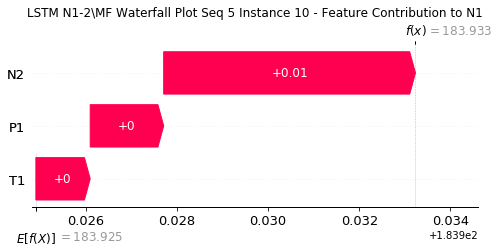

None

Contribution: [0.00166156 0.00121185 0.00568157]


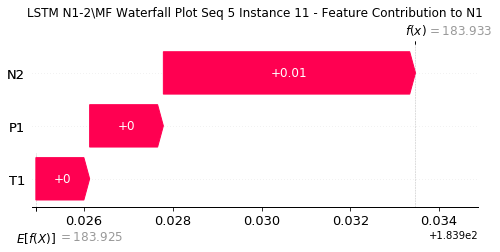

None

Contribution: [0.00169384 0.00128233 0.00591194]


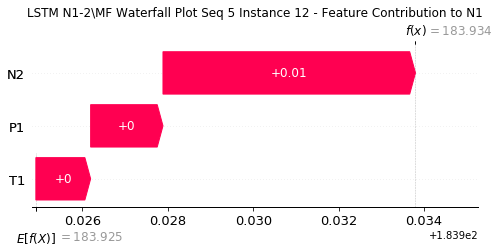

None

Contribution: [0.00185009 0.00134797 0.00630632]


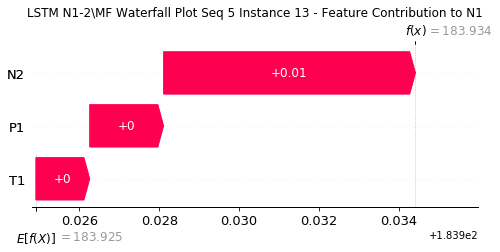

None

Contribution: [0.00204076 0.00147791 0.00687255]


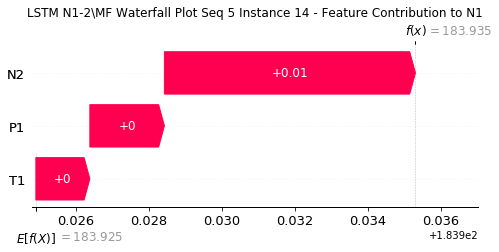

None

Contribution: [0.00229192 0.00163169 0.00776904]


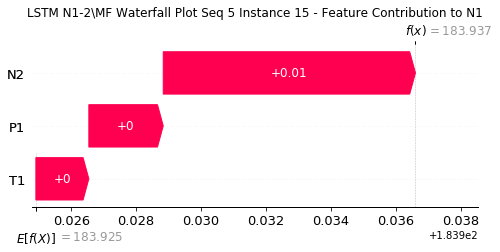

None

Contribution: [0.00268369 0.00189597 0.00911495]


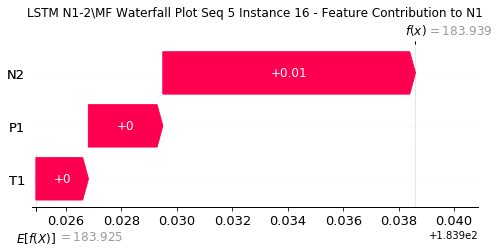

None

Contribution: [0.00326836 0.00229976 0.01121655]


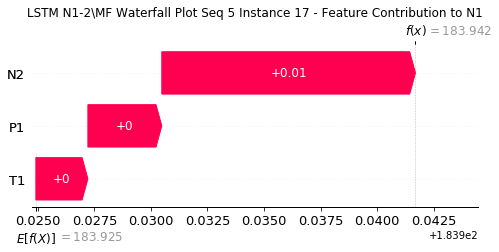

None

Contribution: [0.00430211 0.00300892 0.0146057 ]


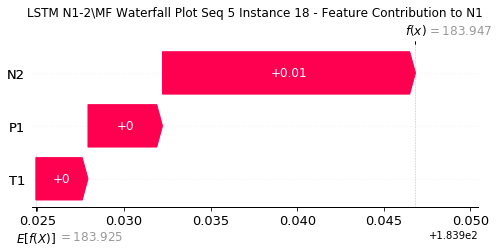

None

Contribution: [0.00591831 0.00414489 0.02010418]


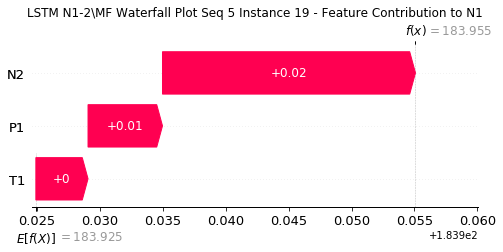

None

Contribution: [0.00856756 0.00608057 0.02914347]


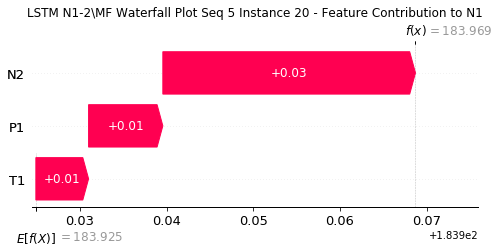

None

Contribution: [0.01291134 0.00914495 0.04398156]


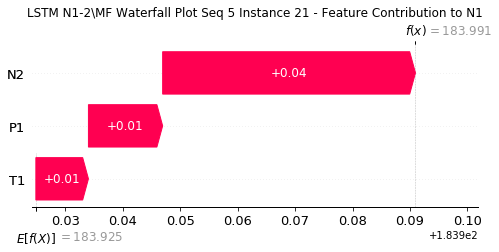

None

Contribution: [0.01966843 0.01359209 0.06755575]


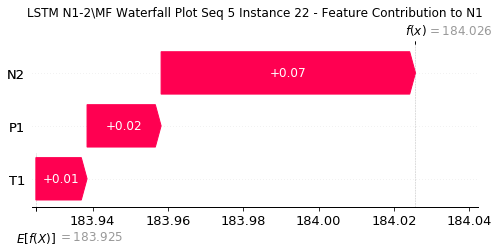

None

Contribution: [0.02807716 0.01620954 0.10084688]


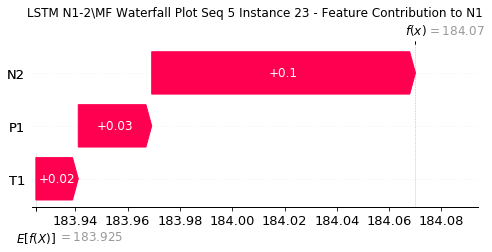

None

Contribution: [ 0.02982586 -0.03347     0.14384809]


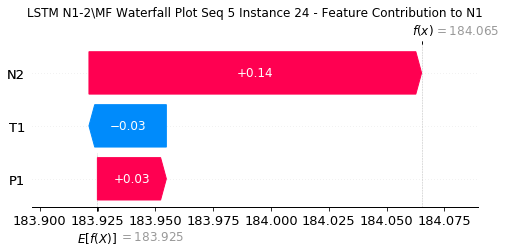

None

Contribution: [ 0.32874255 -0.92064665  1.97866151]


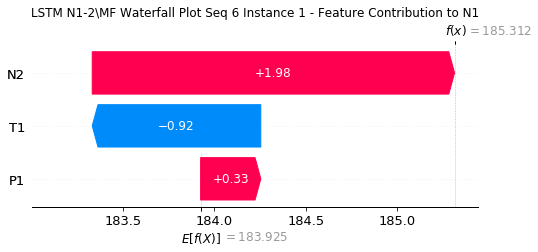

None

Contribution: [ 0.03506625 -0.03168681  0.1439258 ]


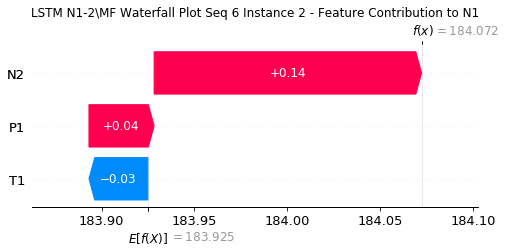

None

Contribution: [ 0.00280608 -0.00289435  0.01266831]


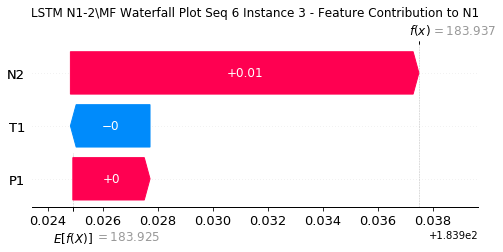

None

Contribution: [0.00194717 0.00156265 0.00681619]


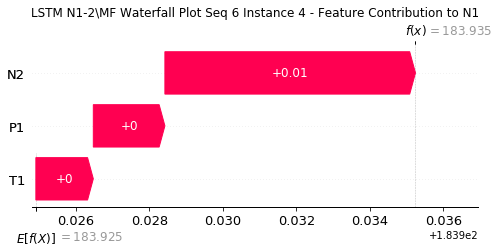

None

Contribution: [0.00176152 0.00144322 0.00624234]


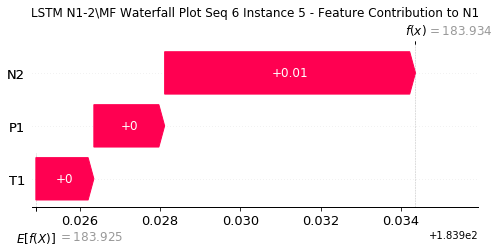

None

Contribution: [0.00158851 0.00129416 0.00551956]


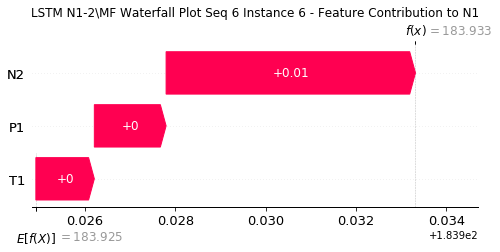

None

Contribution: [0.0015415  0.00122516 0.00537699]


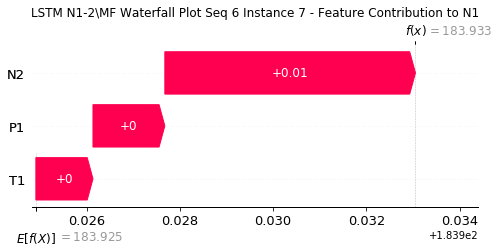

None

Contribution: [0.00150882 0.00125446 0.00537841]


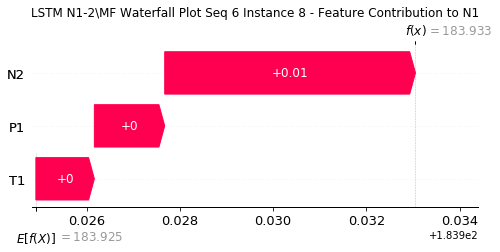

None

Contribution: [0.00156458 0.00122897 0.00542117]


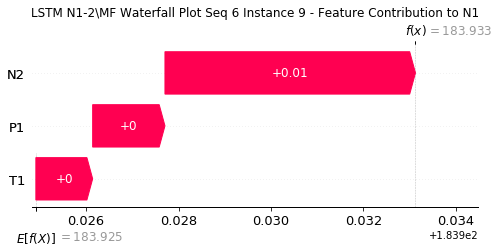

None

Contribution: [0.00158559 0.00124557 0.00548203]


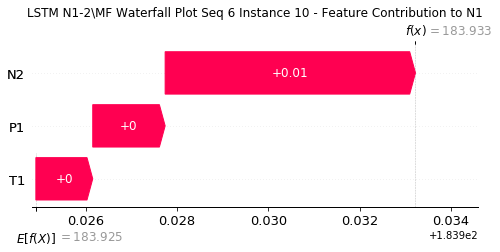

None

Contribution: [0.00163709 0.00127965 0.00564223]


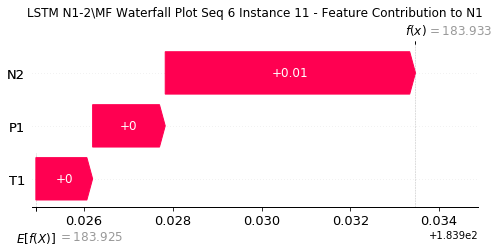

None

Contribution: [0.00174881 0.00133517 0.0058755 ]


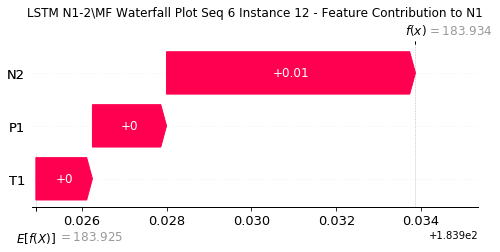

None

Contribution: [0.001825   0.00141385 0.00626092]


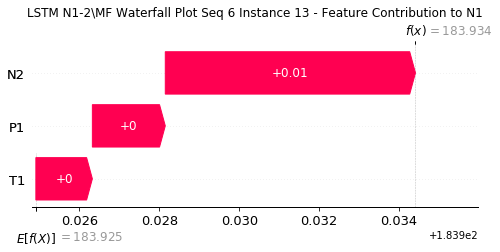

None

Contribution: [0.00200355 0.00149833 0.00679388]


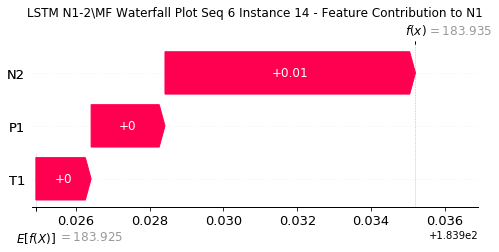

None

Contribution: [0.00226309 0.00171812 0.00770552]


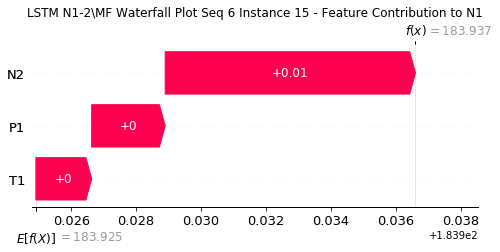

None

Contribution: [0.00267673 0.00201727 0.00904416]


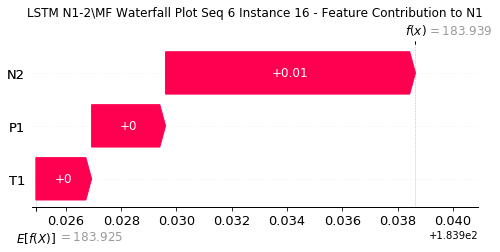

None

Contribution: [0.00326669 0.00255327 0.01113684]


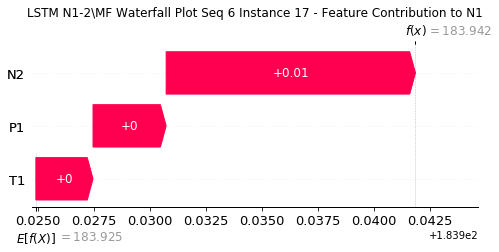

None

Contribution: [0.00430096 0.00328385 0.01447675]


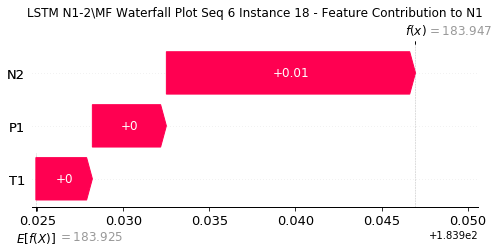

None

Contribution: [0.00594839 0.00453103 0.01993801]


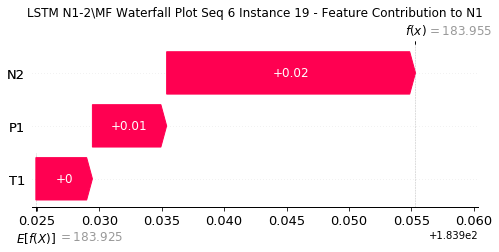

None

Contribution: [0.00862271 0.00664484 0.02893481]


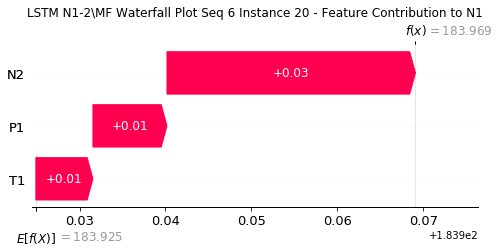

None

Contribution: [0.0130666  0.00991723 0.04375001]


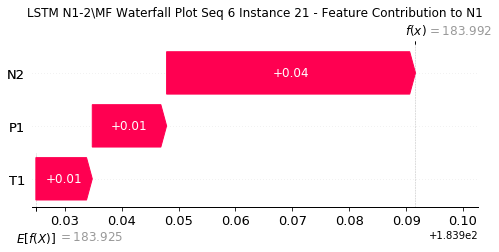

None

Contribution: [0.01994251 0.01494424 0.06730686]


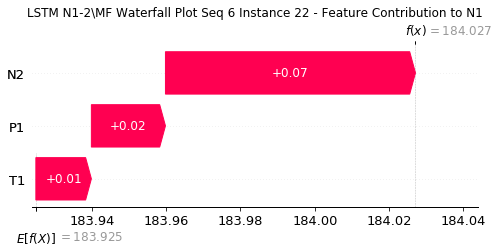

None

Contribution: [0.02854726 0.01829947 0.10078803]


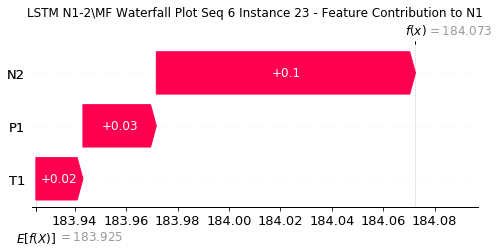

None

Contribution: [ 0.03438952 -0.02091408  0.14492471]


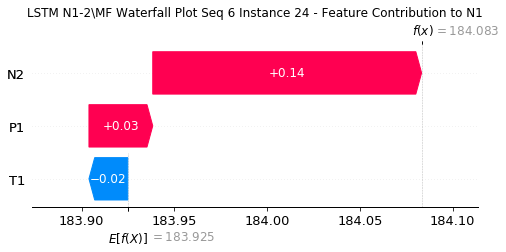

None

Contribution: [ 0.35434974 -0.74791109  1.99919507]


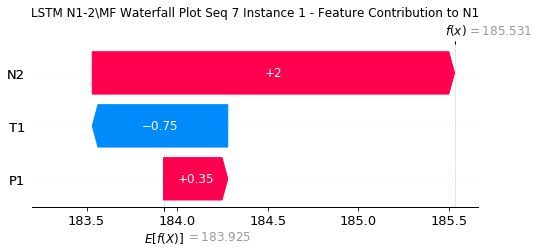

None

Contribution: [ 0.03424244 -0.02685625  0.14305479]


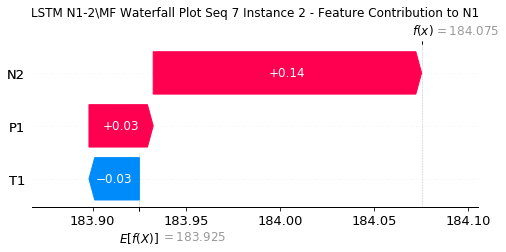

None

Contribution: [ 0.00291044 -0.00354367  0.01266899]


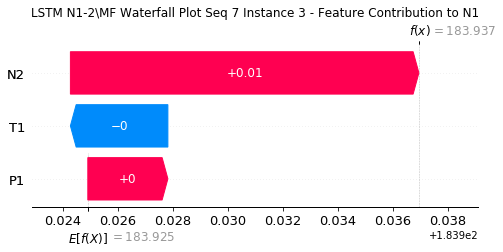

None

Contribution: [0.0019945  0.00150408 0.00693333]


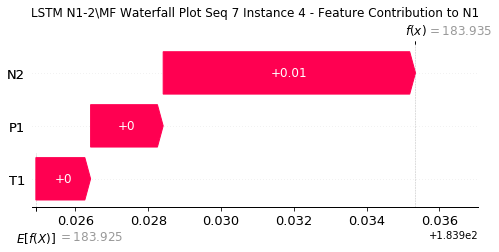

None

Contribution: [0.00180992 0.00141471 0.00630601]


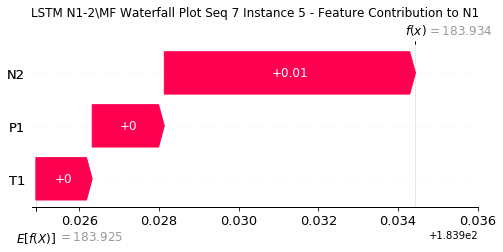

None

Contribution: [0.00160062 0.00120628 0.00553087]


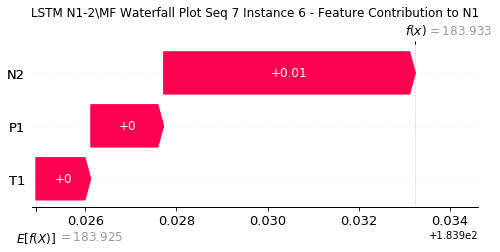

None

Contribution: [0.00154233 0.00107189 0.00533548]


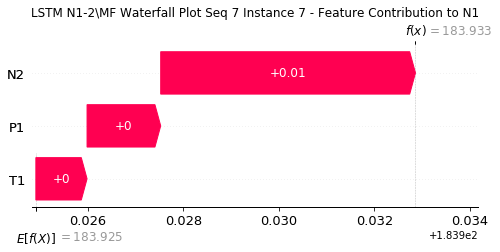

None

Contribution: [0.00156675 0.00117917 0.00534803]


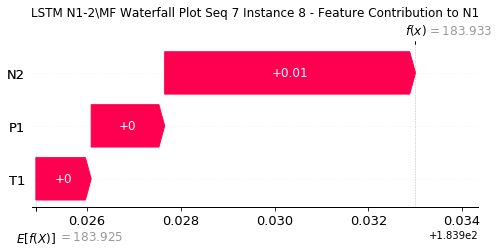

None

Contribution: [0.00156004 0.00115261 0.00537337]


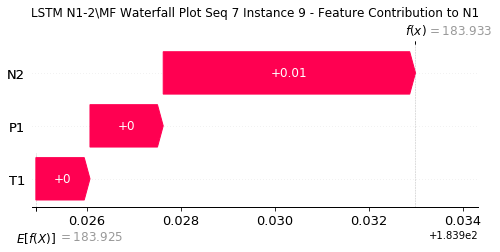

None

Contribution: [0.00158913 0.00110242 0.00546728]


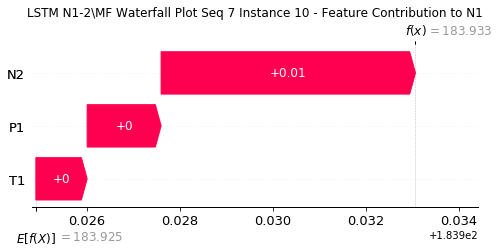

None

Contribution: [0.00163764 0.00110906 0.0056259 ]


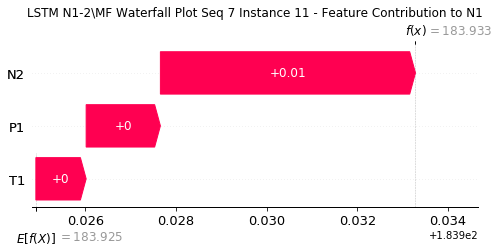

None

Contribution: [0.00171816 0.00104728 0.00585133]


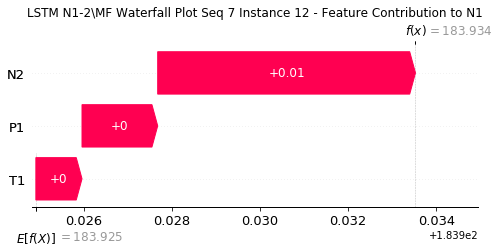

None

Contribution: [0.00181803 0.00120788 0.00623969]


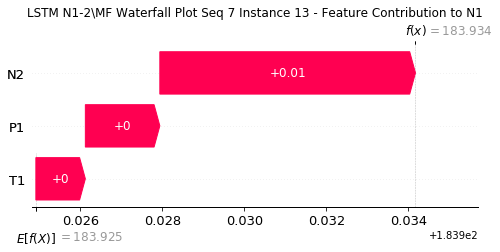

None

Contribution: [0.00199848 0.00124667 0.00681754]


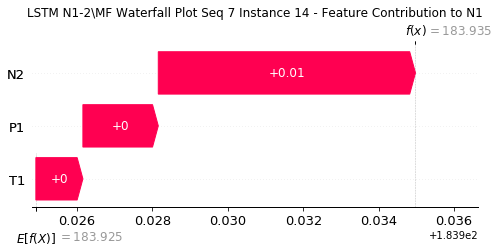

None

Contribution: [0.00224333 0.0014314  0.00768577]


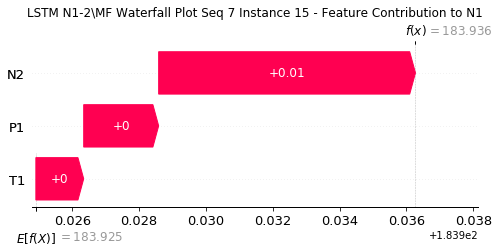

None

Contribution: [0.00264312 0.00167375 0.00902667]


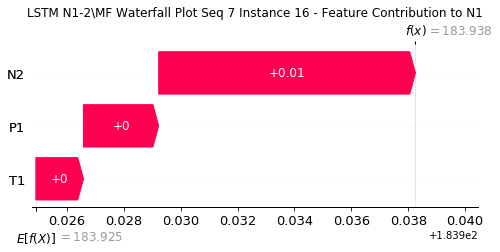

None

Contribution: [0.00328279 0.00203553 0.01110028]


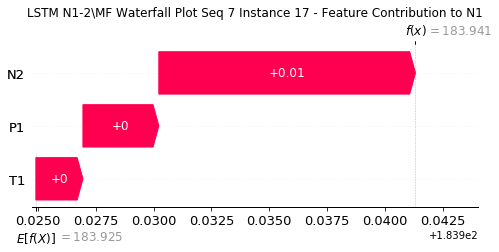

None

Contribution: [0.00422917 0.00266758 0.01444714]


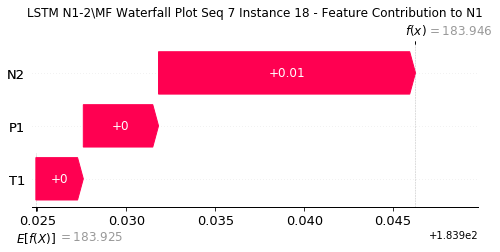

None

Contribution: [0.00583712 0.00367215 0.01989226]


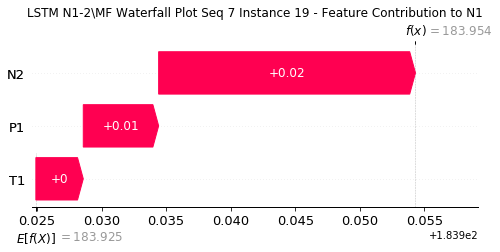

None

Contribution: [0.00845981 0.00535275 0.02883078]


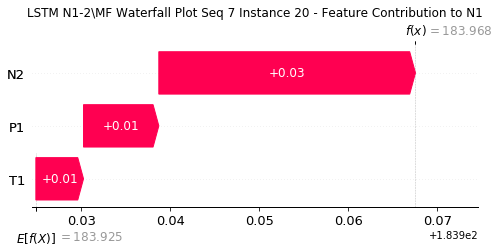

None

Contribution: [0.01279147 0.00795706 0.04358722]


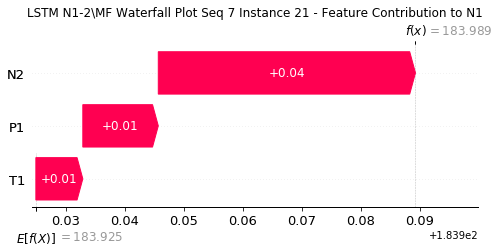

None

Contribution: [0.01953371 0.01185136 0.06705614]


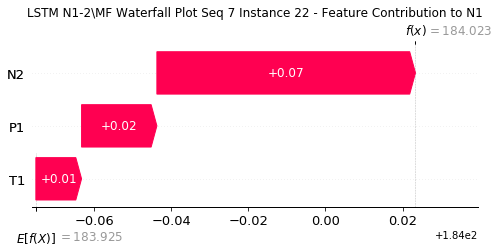

None

Contribution: [0.02862986 0.01144043 0.10039535]


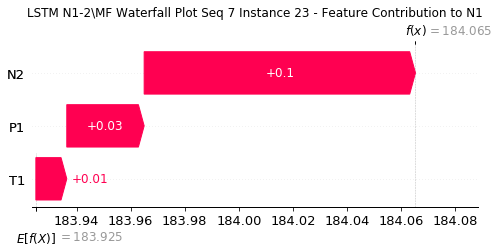

None

Contribution: [ 0.03272778 -0.05081277  0.14475908]


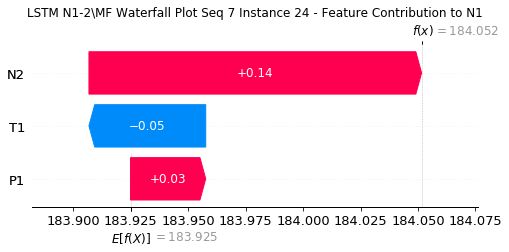

None

Contribution: [ 0.33249962 -1.38998065  2.01466995]


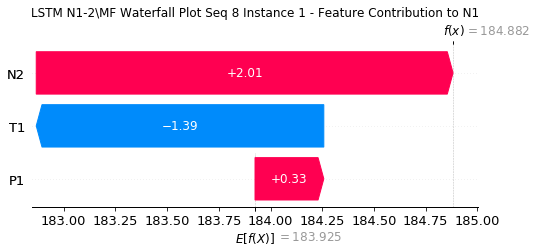

None

Contribution: [ 0.03211027 -0.04893544  0.14863112]


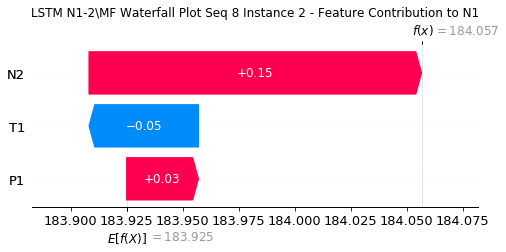

None

Contribution: [ 0.00327711 -0.00516632  0.01325506]


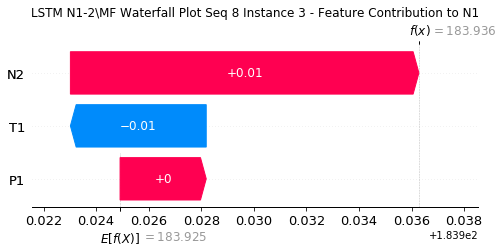

None

Contribution: [0.00189017 0.00114719 0.00663899]


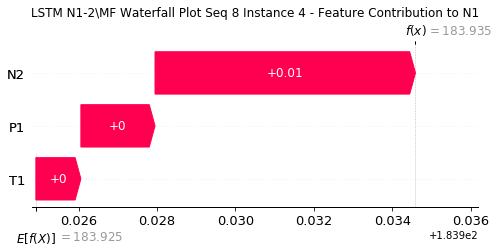

None

Contribution: [0.00181887 0.00127313 0.00628066]


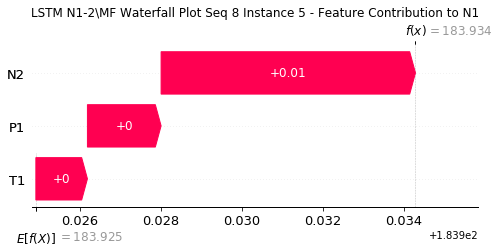

None

Contribution: [0.00159319 0.00102932 0.00558436]


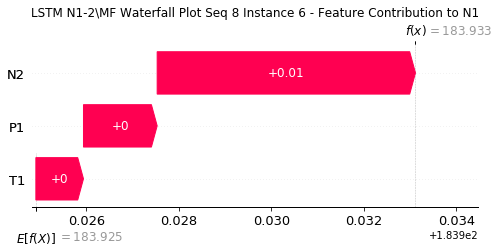

None

Contribution: [0.00157845 0.00108211 0.00551207]


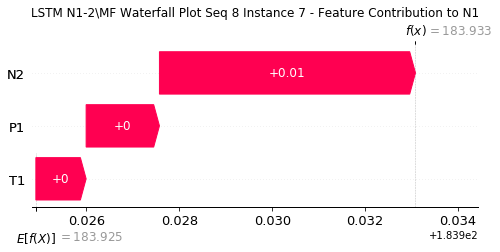

None

Contribution: [0.00156177 0.00100528 0.0054971 ]


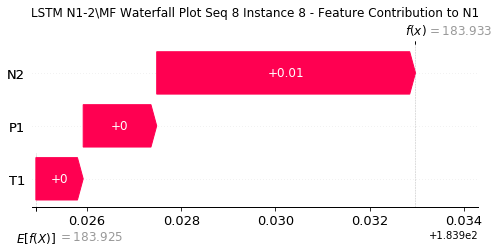

None

Contribution: [0.00156981 0.00111207 0.00554971]


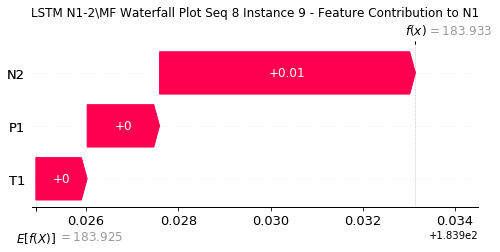

None

Contribution: [0.00161709 0.00104086 0.00561208]


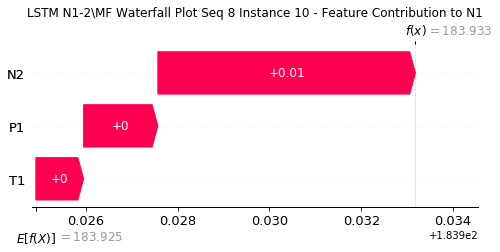

None

Contribution: [0.0016701  0.00105831 0.0057776 ]


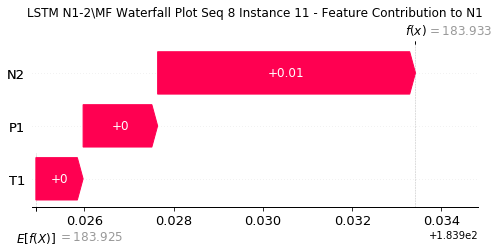

None

Contribution: [0.00171523 0.00107688 0.00601554]


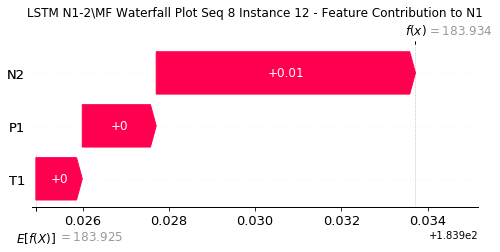

None

Contribution: [0.00188442 0.00120285 0.00644087]


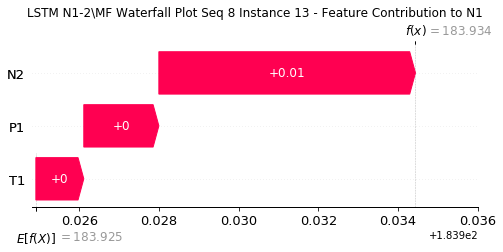

None

Contribution: [0.00207749 0.00123391 0.0070397 ]


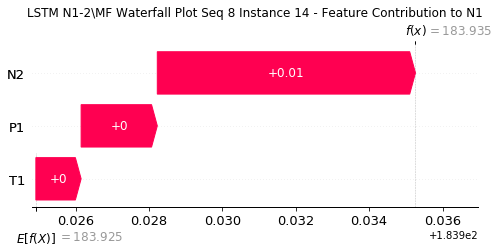

None

Contribution: [0.00230603 0.00144859 0.00795047]


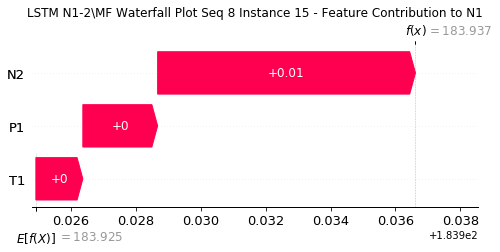

None

Contribution: [0.00265784 0.00166178 0.00932129]


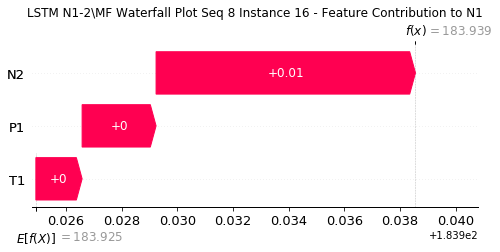

None

Contribution: [0.00330797 0.00213176 0.01152601]


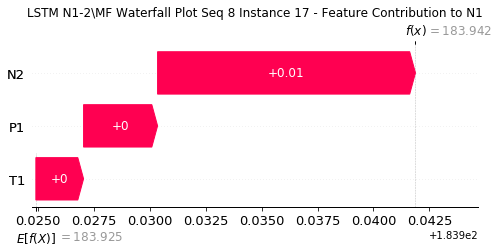

None

Contribution: [0.00437611 0.00274144 0.01500373]


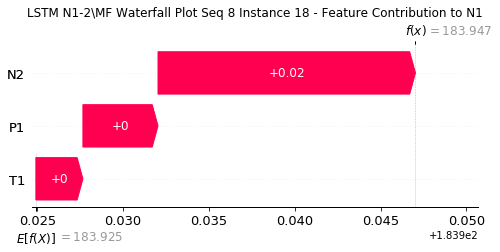

None

Contribution: [0.00599    0.00378025 0.0206328 ]


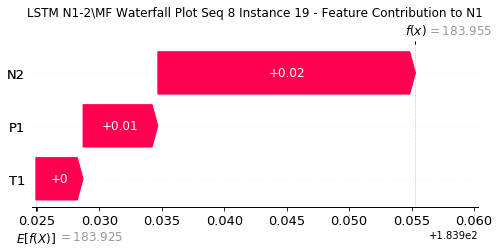

None

Contribution: [0.00886419 0.00568514 0.02992191]


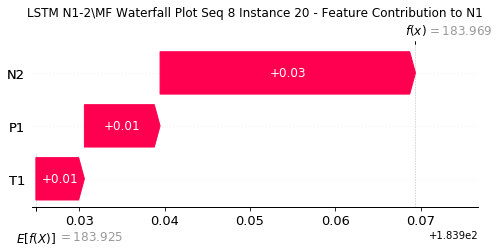

None

Contribution: [0.01306722 0.00837091 0.04500525]


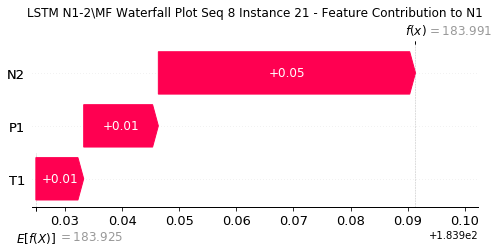

None

Contribution: [0.02032085 0.01208397 0.06914424]


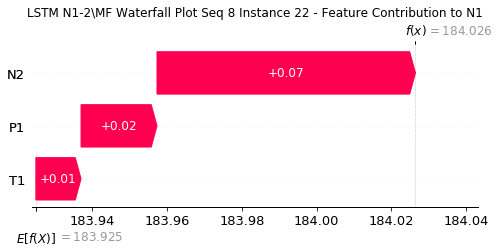

None

Contribution: [0.02793366 0.00969925 0.10259277]


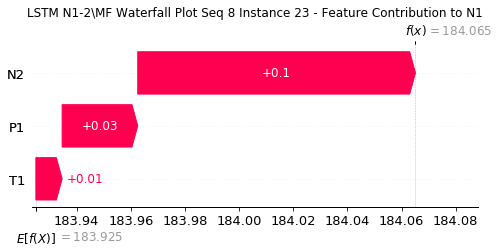

None

Contribution: [ 0.01947016 -0.05645023  0.13874419]


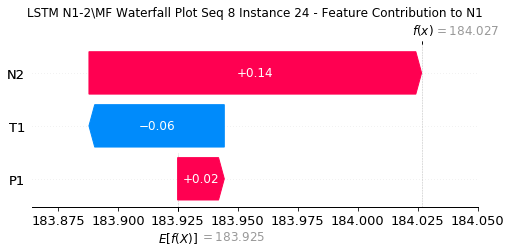

None

Contribution: [ 0.39548242 -1.21826707  1.97338081]


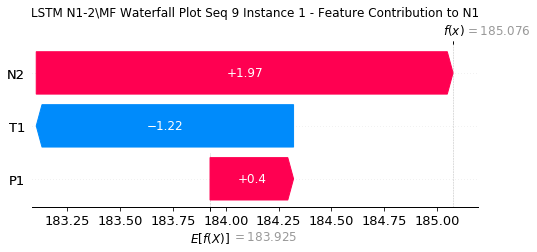

None

Contribution: [ 0.03268364 -0.05809087  0.14621036]


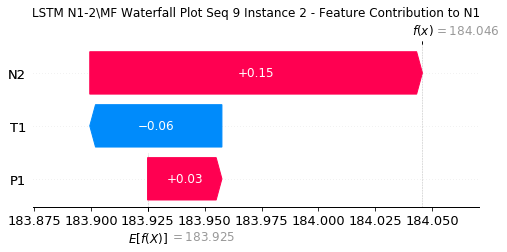

None

Contribution: [ 0.00228124 -0.00423375  0.01321738]


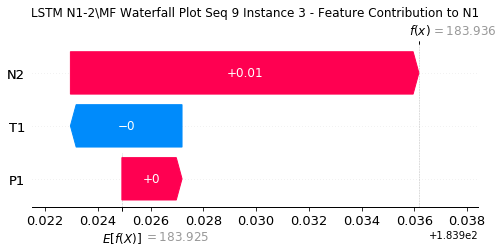

None

Contribution: [0.00183828 0.00136946 0.00669474]


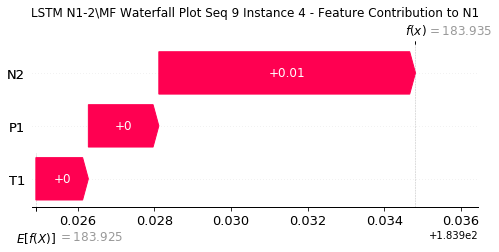

None

Contribution: [0.00160323 0.00115956 0.00617698]


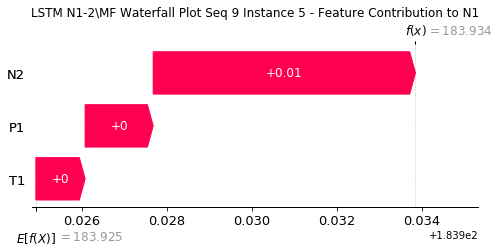

None

Contribution: [0.00155062 0.00121843 0.00554784]


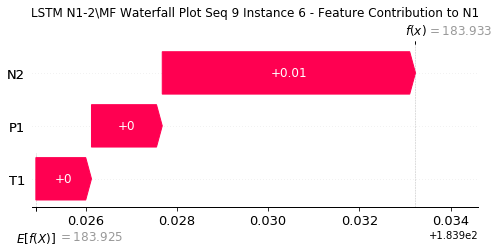

None

Contribution: [0.00157096 0.0014029  0.00547311]


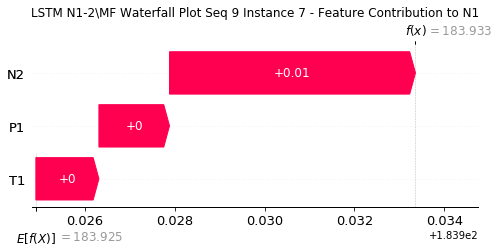

None

Contribution: [0.00159489 0.00148884 0.00549519]


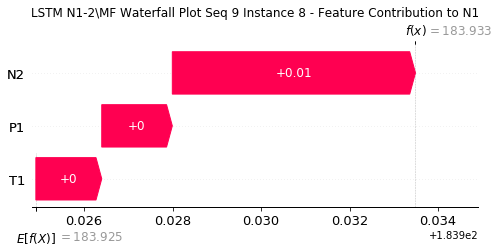

None

Contribution: [0.00161577 0.00133951 0.00550616]


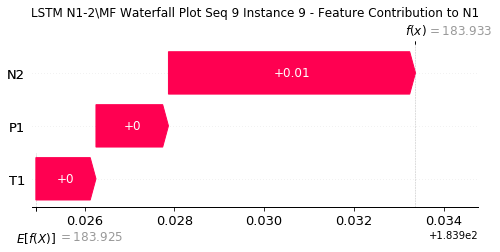

None

Contribution: [0.00162828 0.00127544 0.00555274]


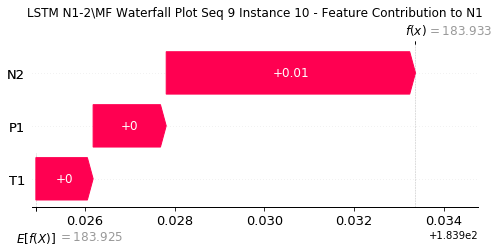

None

Contribution: [0.00167747 0.0013326  0.00571514]


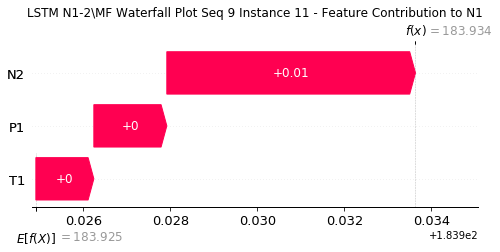

None

Contribution: [0.00172723 0.00140399 0.00593238]


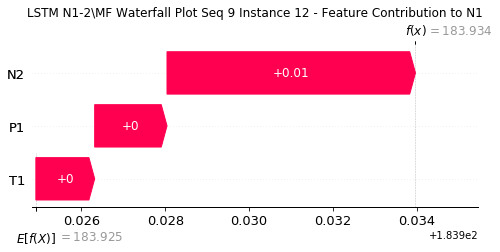

None

Contribution: [0.00187392 0.00147886 0.00633339]


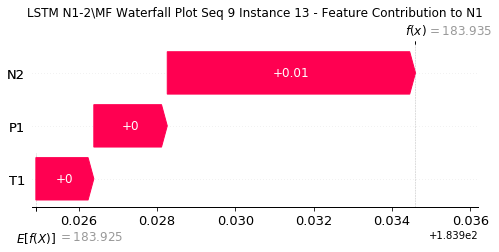

None

Contribution: [0.00206195 0.00156501 0.00690994]


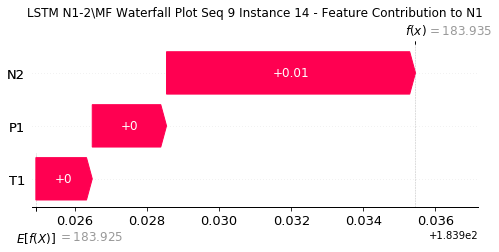

None

Contribution: [0.00234173 0.00188745 0.00780966]


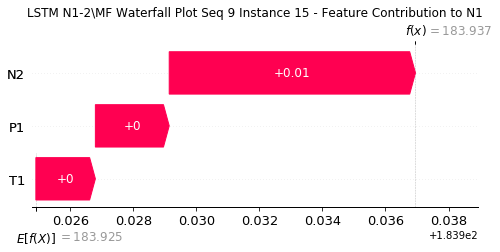

None

Contribution: [0.00277397 0.00223855 0.00917335]


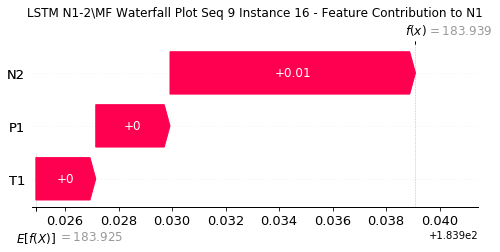

None

Contribution: [0.00330382 0.00286224 0.01128859]


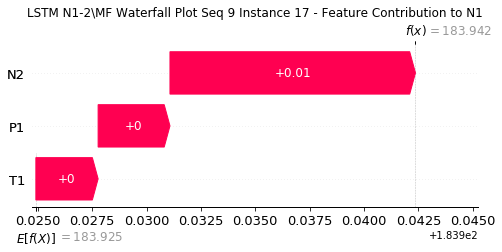

None

Contribution: [0.00437687 0.00356946 0.01467192]


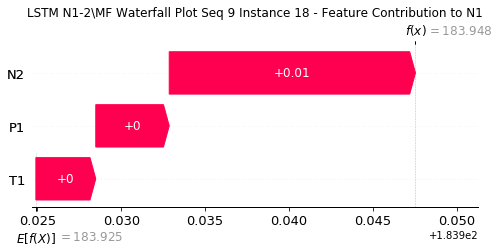

None

Contribution: [0.00607015 0.00492017 0.02020247]


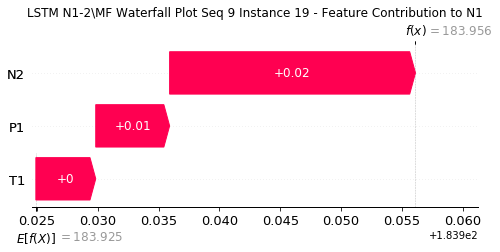

None

Contribution: [0.00877539 0.00705739 0.02926473]


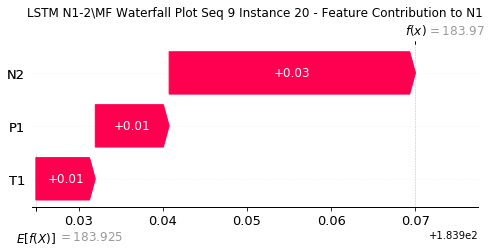

None

Contribution: [0.01346929 0.01081229 0.04420693]


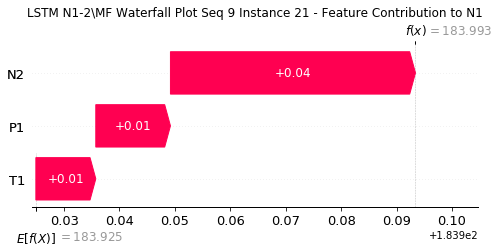

None

Contribution: [0.02028783 0.01597925 0.06783367]


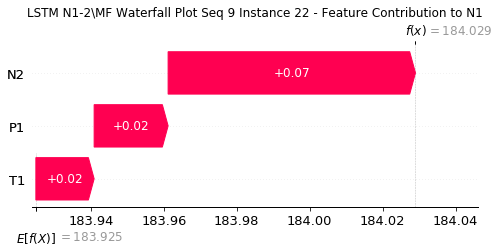

None

Contribution: [0.02825687 0.02287039 0.10082207]


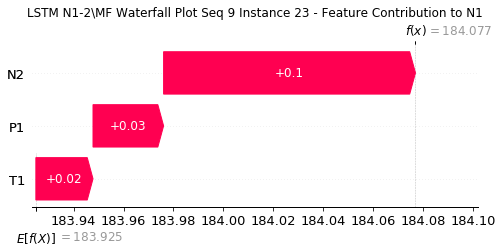

None

Contribution: [ 0.03497086 -0.00443211  0.14490672]


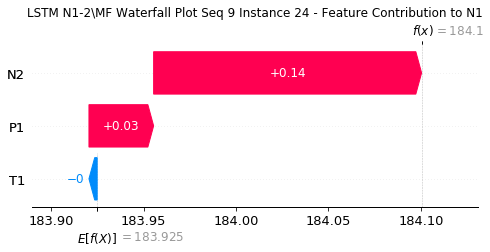

None

Contribution: [ 0.31568372 -0.52819628  1.93541022]


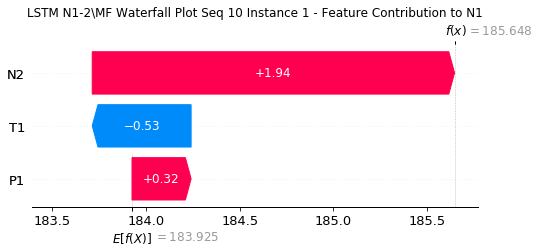

None

Contribution: [ 0.03058334 -0.01180703  0.14031673]


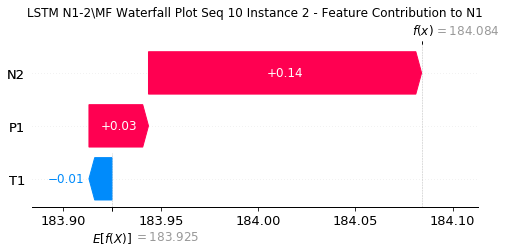

None

Contribution: [ 0.00307281 -0.00223185  0.01232264]


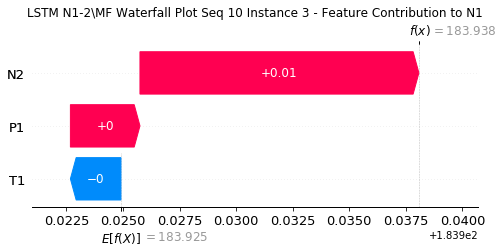

None

Contribution: [0.00204292 0.00172884 0.00694655]


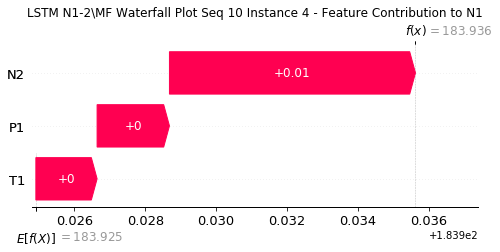

None

Contribution: [0.00184121 0.00162616 0.00627787]


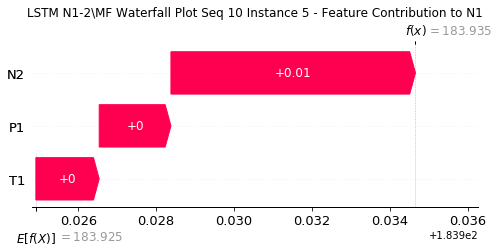

None

Contribution: [0.00161906 0.00137444 0.00548224]


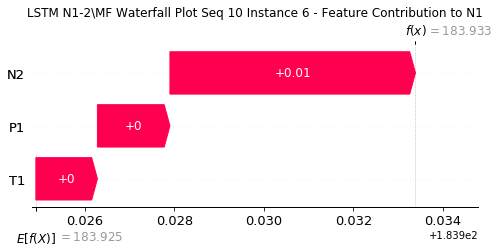

None

Contribution: [0.00152416 0.00128757 0.00530947]


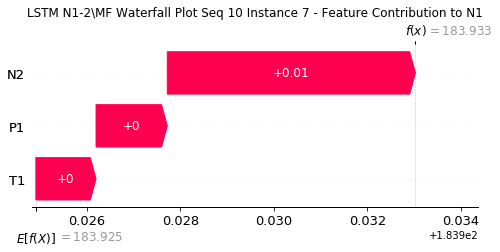

None

Contribution: [0.00162778 0.0013219  0.0053485 ]


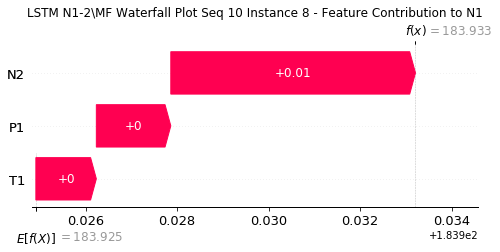

None

Contribution: [0.00157194 0.00129654 0.00535683]


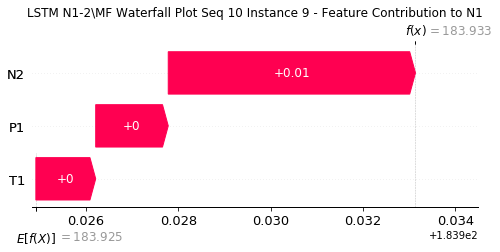

None

Contribution: [0.00162113 0.00129521 0.00542448]


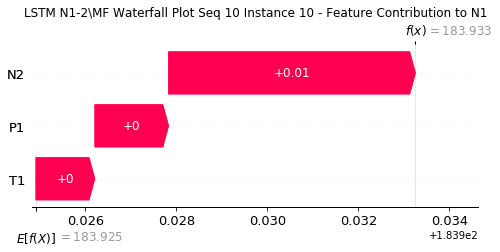

None

Contribution: [0.00166552 0.00132186 0.0055757 ]


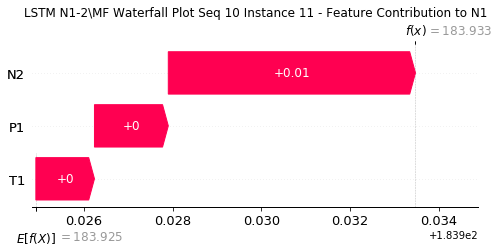

None

Contribution: [0.0017178  0.00128381 0.0057798 ]


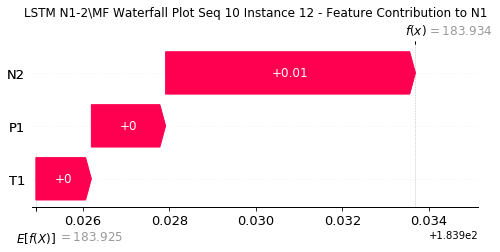

None

Contribution: [0.00185933 0.00144158 0.00618411]


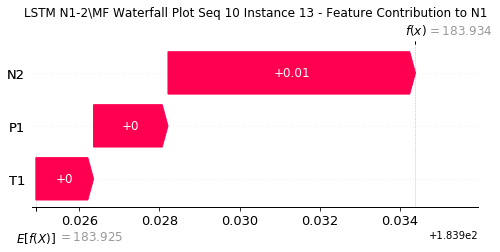

None

Contribution: [0.00201446 0.00162563 0.00674834]


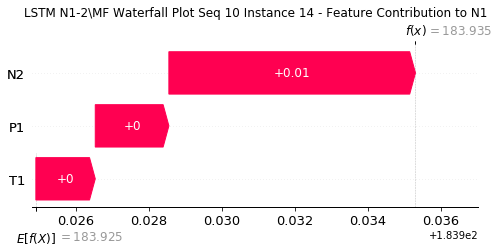

None

Contribution: [0.00229464 0.001758   0.00760014]


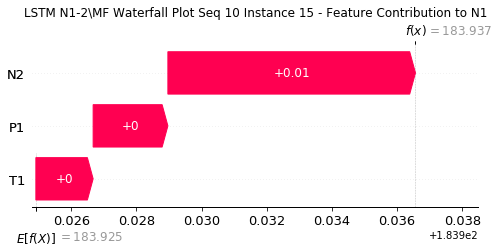

None

Contribution: [0.00269828 0.00204899 0.00890614]


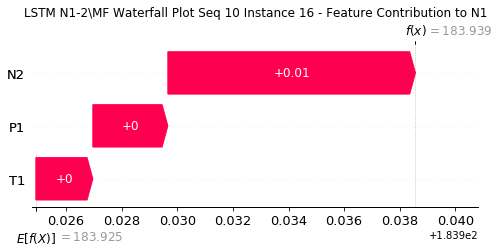

None

Contribution: [0.00329972 0.00249937 0.01094587]


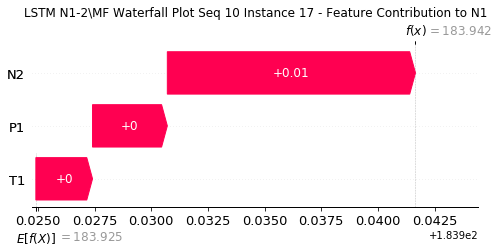

None

Contribution: [0.00431677 0.00324676 0.01421488]


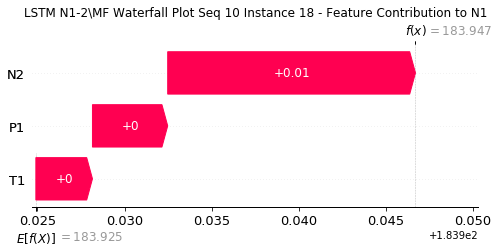

None

Contribution: [0.0059605  0.00443631 0.01957227]


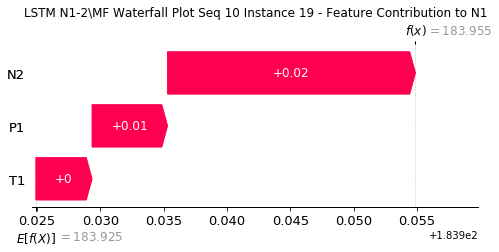

None

Contribution: [0.00868565 0.0063555  0.02842316]


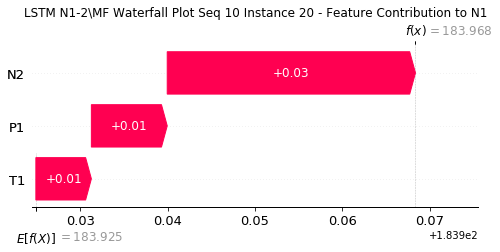

None

Contribution: [0.01320093 0.00955943 0.04309039]


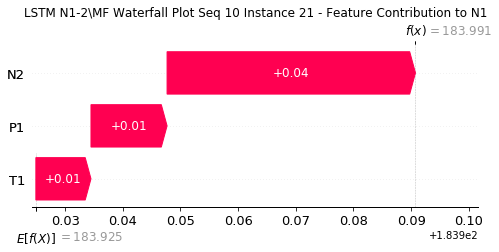

None

Contribution: [0.02032704 0.01430002 0.0665124 ]


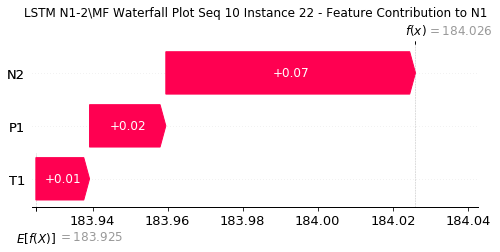

None

Contribution: [0.02970272 0.01903945 0.09982379]


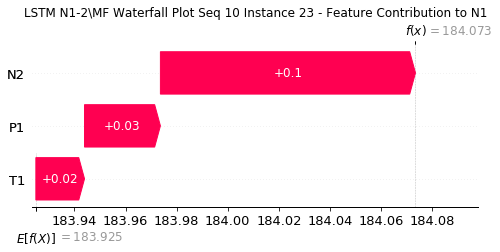

None

Contribution: [ 0.04058257 -0.01387243  0.14492789]


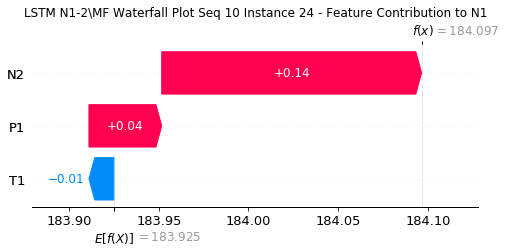

None

Contribution: [ 0.52480061 -0.65226288  1.97844904]


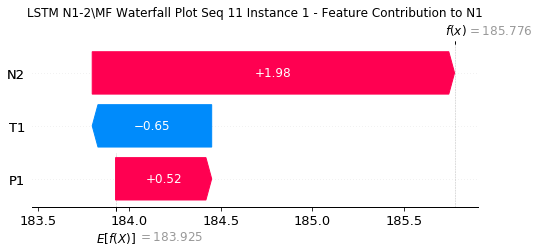

None

Contribution: [ 0.04473714 -0.00481584  0.14073249]


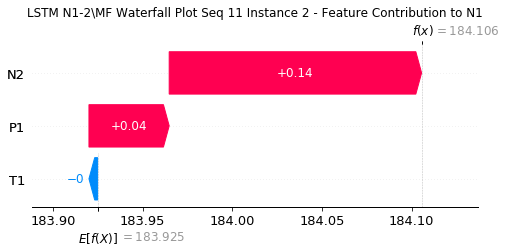

None

Contribution: [ 0.00419593 -0.00318103  0.01237218]


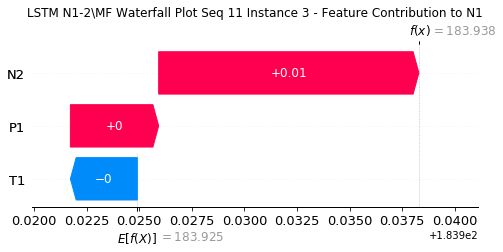

None

Contribution: [0.00219752 0.00152479 0.00700051]


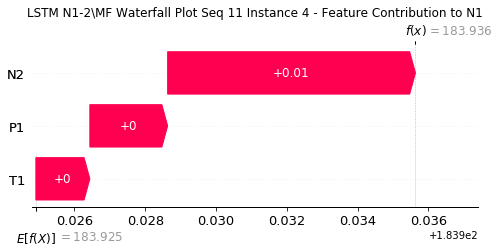

None

Contribution: [0.00201894 0.00166719 0.00631745]


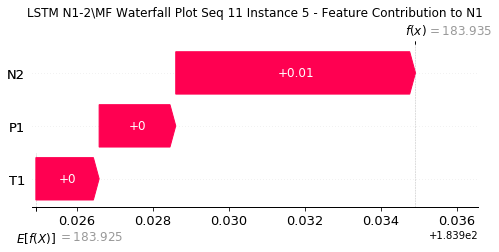

None

Contribution: [0.00173053 0.0012581  0.00548642]


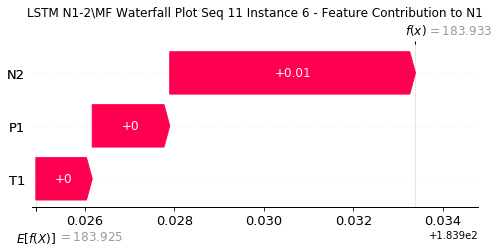

None

Contribution: [0.00169515 0.00139756 0.00537925]


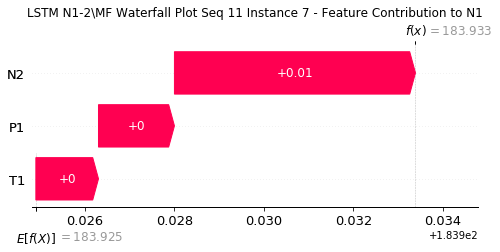

None

Contribution: [0.0016937  0.00135942 0.00536772]


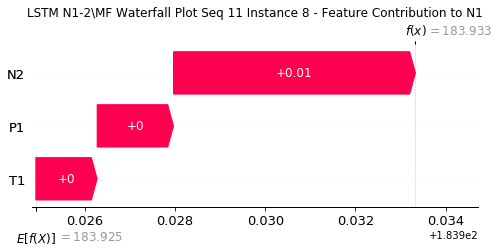

None

Contribution: [0.00169466 0.00140928 0.00539304]


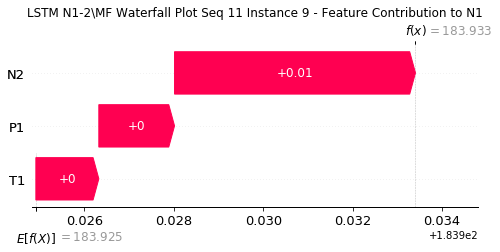

None

Contribution: [0.00166549 0.0008569  0.00535829]


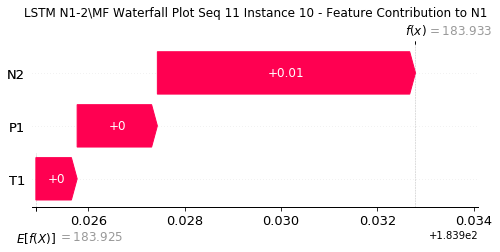

None

Contribution: [0.00171536 0.00089027 0.00550795]


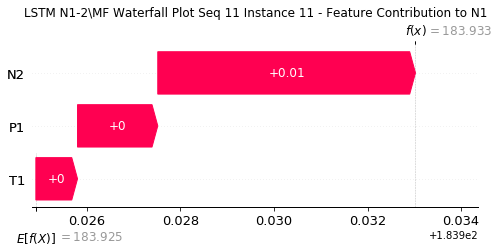

None

Contribution: [0.00172889 0.00060366 0.00569203]


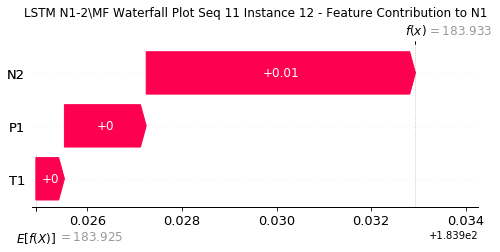

None

Contribution: [0.00189486 0.00096905 0.00610166]


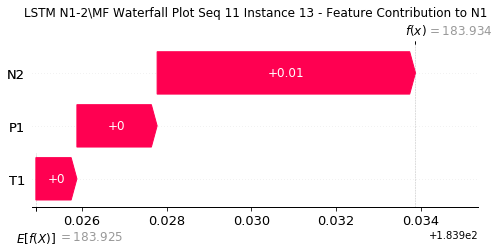

None

Contribution: [0.00203805 0.00074686 0.00665353]


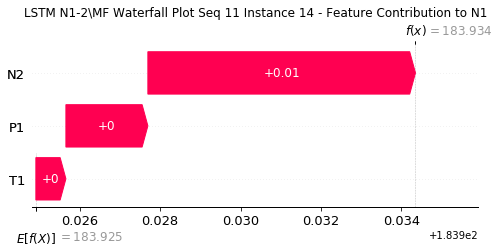

None

Contribution: [0.00232929 0.00120282 0.00750339]


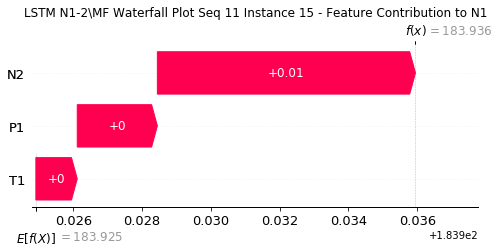

None

Contribution: [0.00274518 0.00151688 0.00880095]


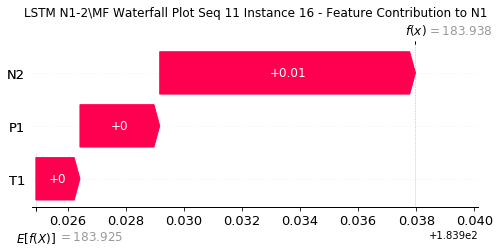

None

Contribution: [0.0034325  0.00219677 0.01086759]


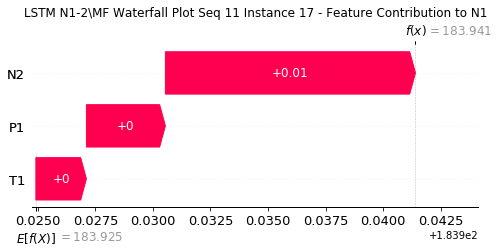

None

Contribution: [0.00442959 0.00297134 0.0140697 ]


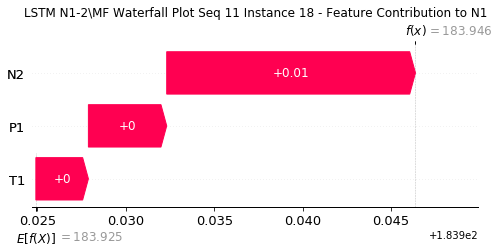

None

Contribution: [0.00610849 0.00414263 0.01935583]


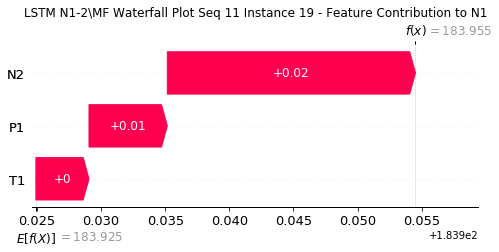

None

Contribution: [0.00886896 0.00609881 0.02809275]


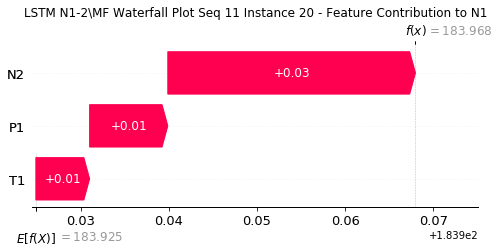

None

Contribution: [0.01337547 0.00857086 0.0425722 ]


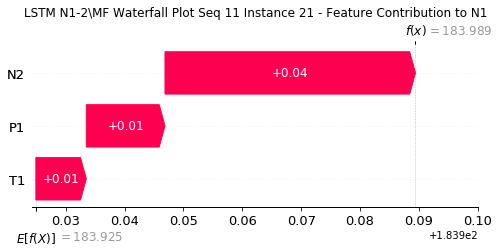

None

Contribution: [0.02066491 0.01386842 0.06573847]


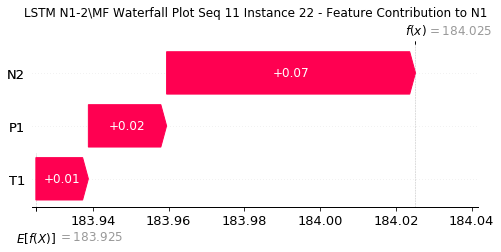

None

Contribution: [0.03223464 0.02428067 0.09949457]


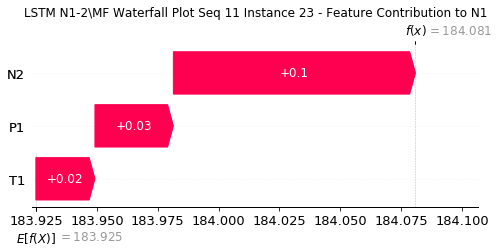

None

Contribution: [0.0499892  0.00736977 0.14574434]


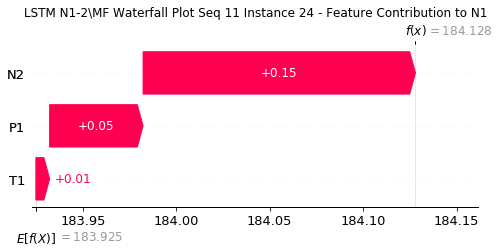

None

Contribution: [ 0.63227845 -0.37941769  1.96559581]


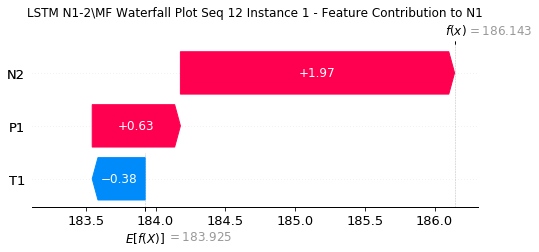

None

Contribution: [0.04409554 0.00808298 0.1363236 ]


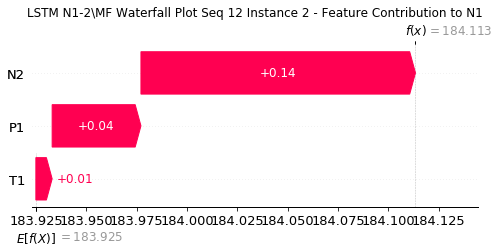

None

Contribution: [ 0.00425166 -0.00101343  0.01202593]


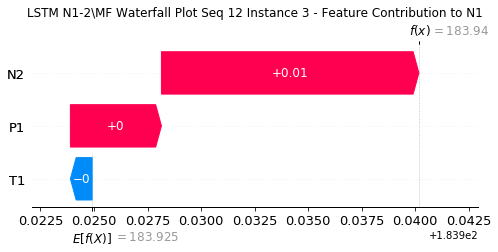

None

Contribution: [0.0022604  0.00200623 0.00709101]


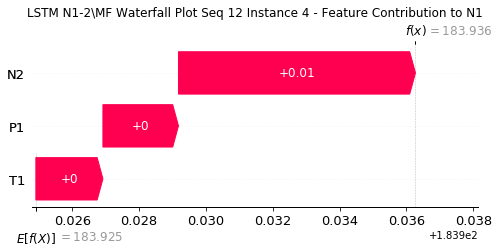

None

Contribution: [0.00191424 0.00176239 0.00621803]


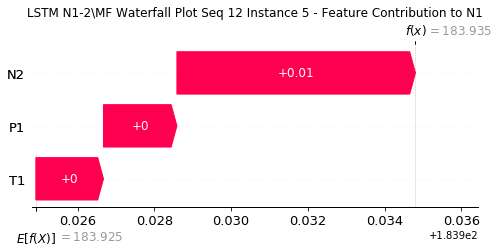

None

Contribution: [0.00173104 0.00155519 0.00540342]


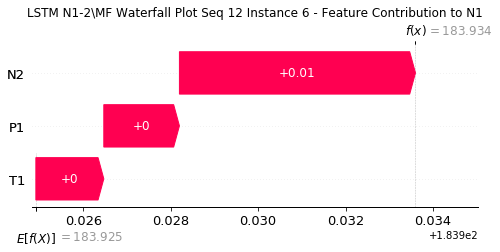

None

Contribution: [0.00172699 0.00152726 0.00526761]


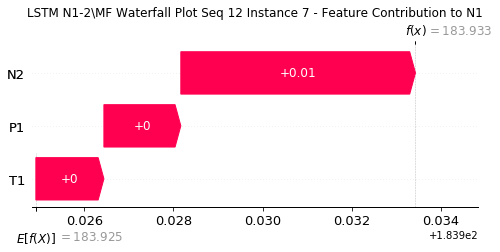

None

Contribution: [0.00168205 0.00145355 0.00521175]


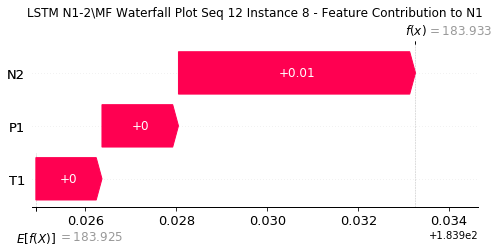

None

Contribution: [0.00168545 0.00148408 0.00525074]


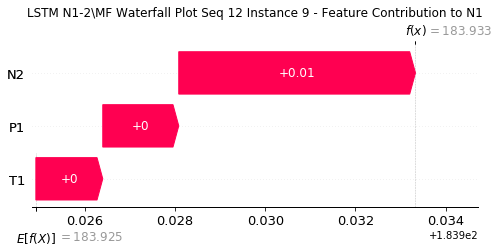

None

Contribution: [0.0017073  0.00153201 0.00529773]


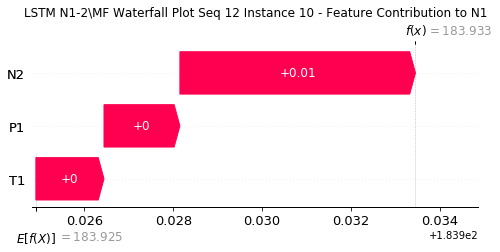

None

Contribution: [0.00176625 0.00157869 0.00544967]


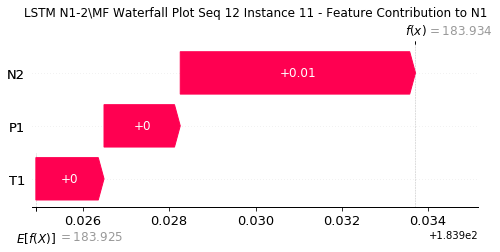

None

Contribution: [0.00175854 0.00160904 0.00561173]


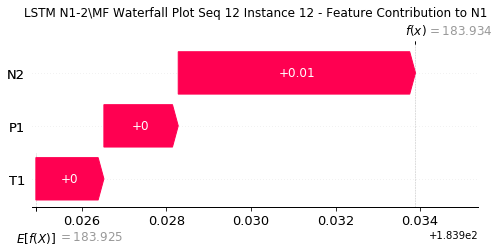

None

Contribution: [0.00194518 0.00173667 0.00601636]


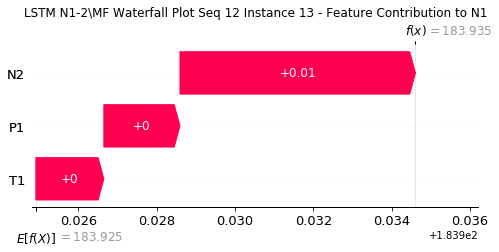

None

Contribution: [0.00216156 0.00193    0.00656368]


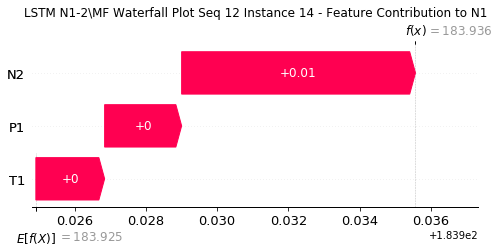

None

Contribution: [0.00238792 0.0021247  0.00735527]


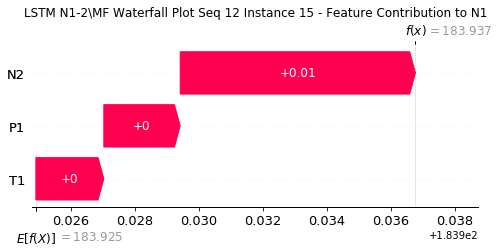

None

Contribution: [0.00278375 0.00247181 0.0085821 ]


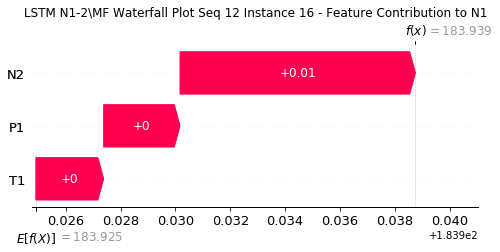

None

Contribution: [0.0033511  0.00294553 0.01049106]


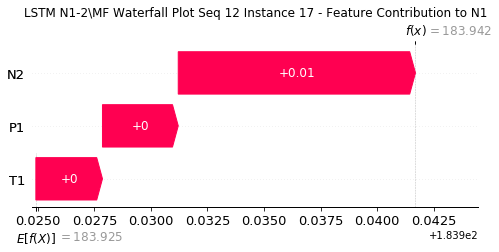

None

Contribution: [0.00443392 0.00392998 0.01364062]


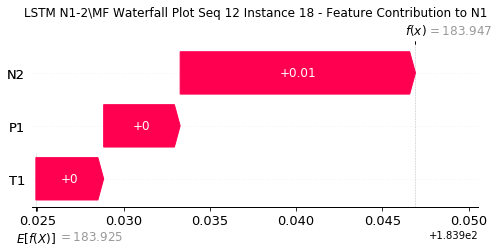

None

Contribution: [0.00609074 0.00539997 0.01875609]


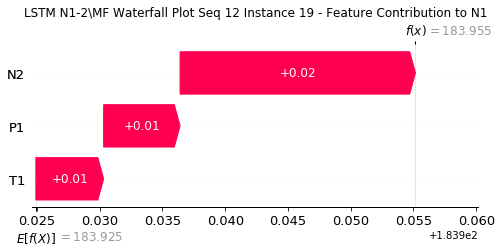

None

Contribution: [0.00883695 0.00784687 0.02726651]


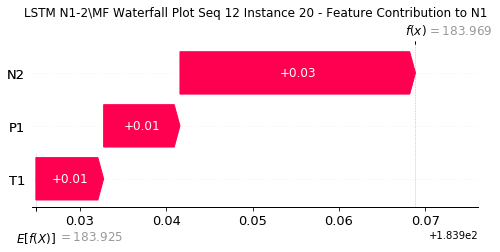

None

Contribution: [0.01338292 0.0119346  0.04143962]


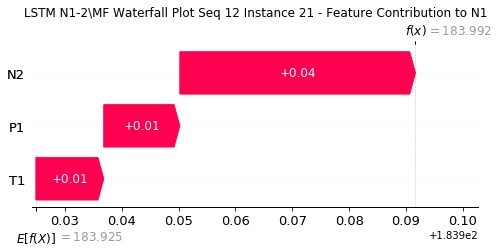

None

Contribution: [0.02071544 0.01832924 0.06433364]


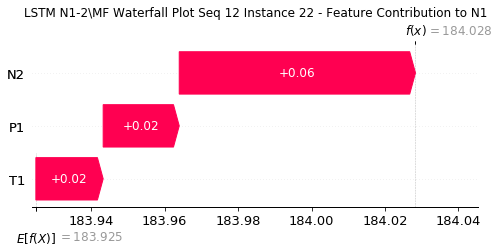

None

Contribution: [0.03141721 0.02744664 0.09749292]


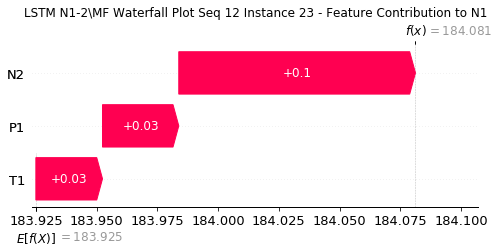

None

Contribution: [0.04835351 0.02349556 0.143309  ]


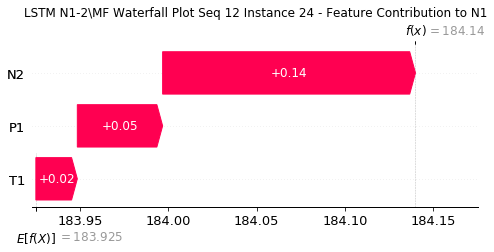

None

Contribution: [0.64137554 0.05947145 1.91437028]


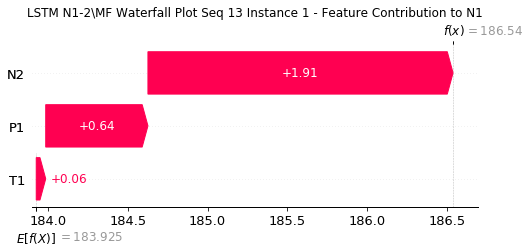

None

Contribution: [0.04588399 0.01561251 0.13249813]


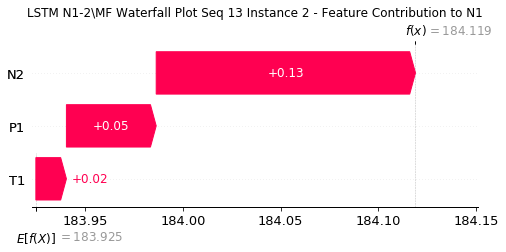

None

Contribution: [ 0.00402984 -0.00115341  0.01181075]


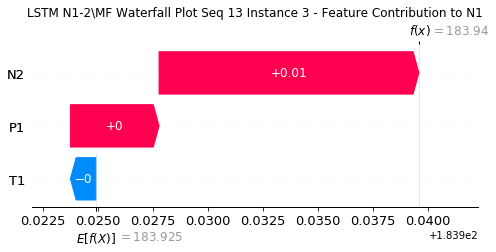

None

Contribution: [0.00228118 0.00201109 0.00719548]


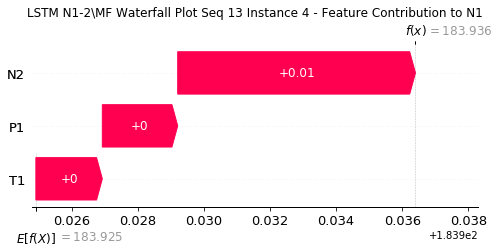

None

Contribution: [0.00202783 0.00176024 0.00624549]


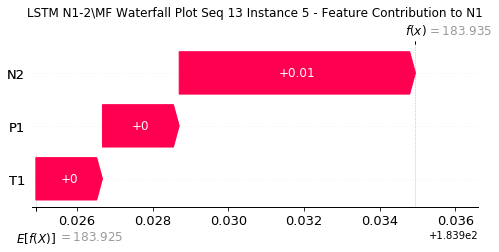

None

Contribution: [0.00170115 0.00150413 0.00536391]


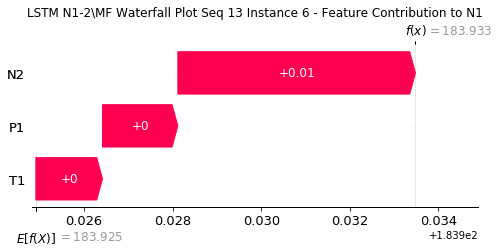

None

Contribution: [0.00157582 0.00137643 0.00513802]


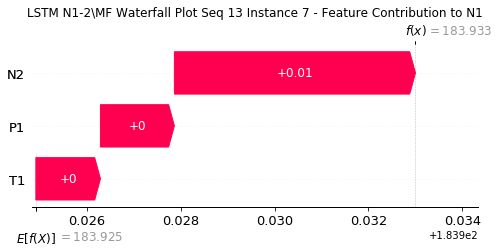

None

Contribution: [0.00159299 0.00130697 0.00511942]


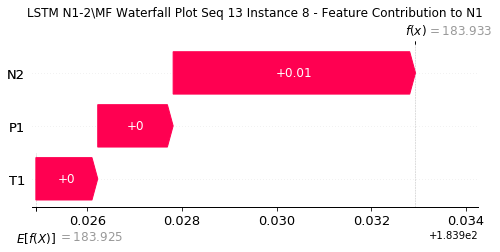

None

Contribution: [0.00161978 0.00136162 0.00516193]


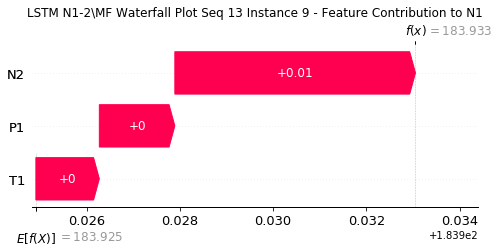

None

Contribution: [0.00169573 0.00139492 0.00525551]


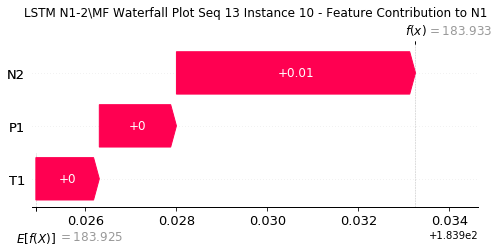

None

Contribution: [0.0017351  0.00143492 0.0054028 ]


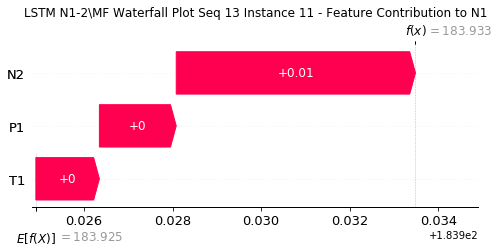

None

Contribution: [0.00181006 0.00148587 0.00561207]


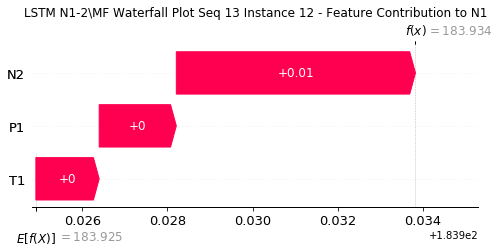

None

Contribution: [0.00191859 0.00157323 0.00596343]


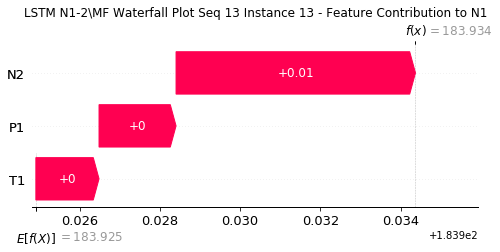

None

Contribution: [0.0020342  0.00165952 0.00646044]


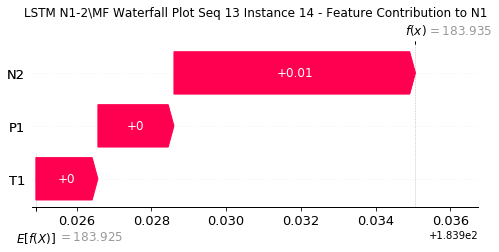

None

Contribution: [0.00232878 0.00189438 0.00727247]


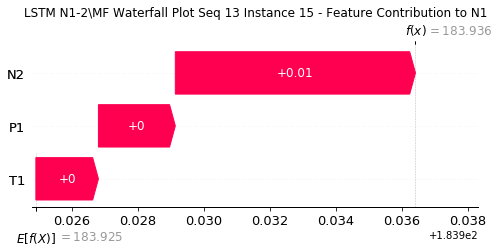

None

Contribution: [0.00271393 0.00221271 0.00848635]


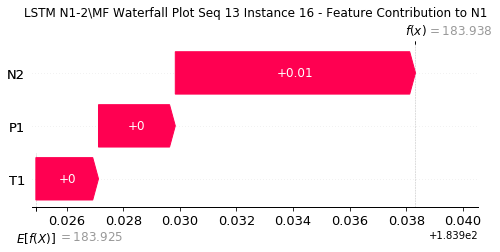

None

Contribution: [0.00331291 0.0029201  0.01040995]


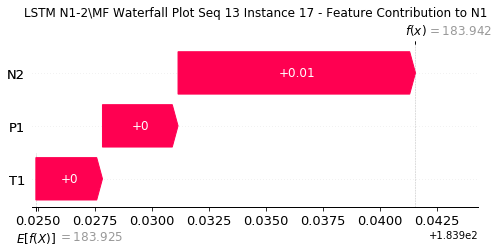

None

Contribution: [0.00424765 0.00361454 0.01344572]


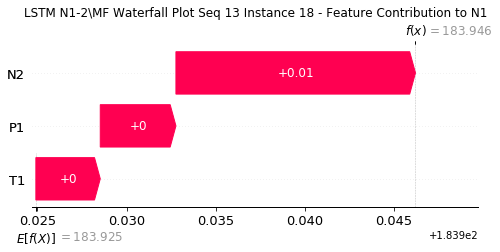

None

Contribution: [0.00585161 0.00495746 0.01848268]


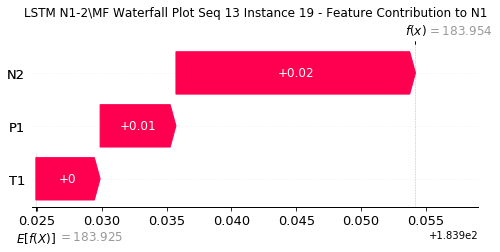

None

Contribution: [0.0085255  0.00727693 0.02688544]


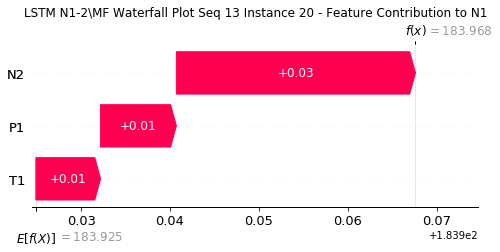

None

Contribution: [0.01307239 0.01089996 0.04096597]


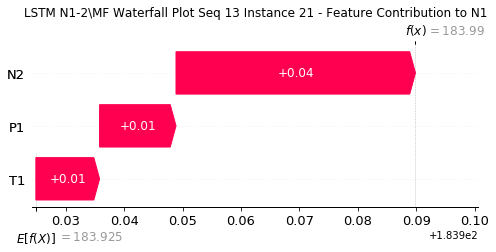

None

Contribution: [0.02023279 0.01736505 0.06381167]


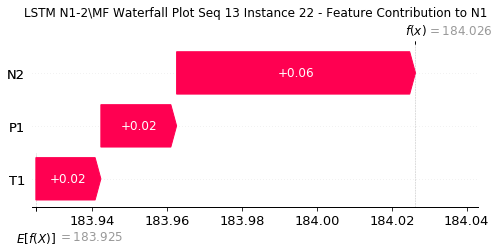

None

Contribution: [0.02958108 0.02754383 0.09680132]


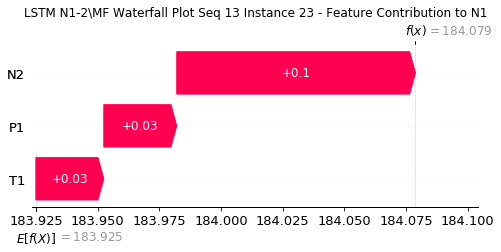

None

Contribution: [0.04291815 0.01414132 0.14273165]


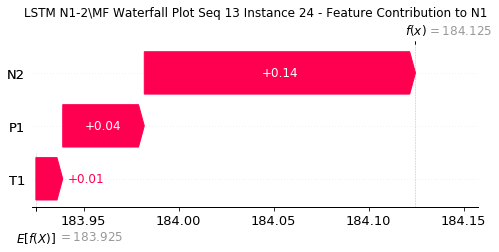

None

Contribution: [ 0.542424   -0.07402409  1.9239799 ]


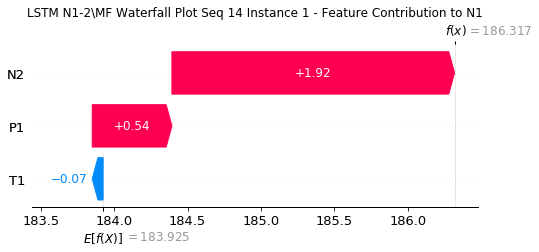

None

Contribution: [0.0397324  0.01127161 0.13347194]


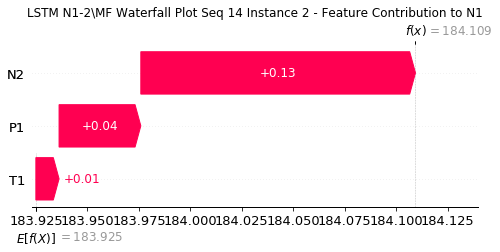

None

Contribution: [ 0.00385625 -0.00127087  0.0119532 ]


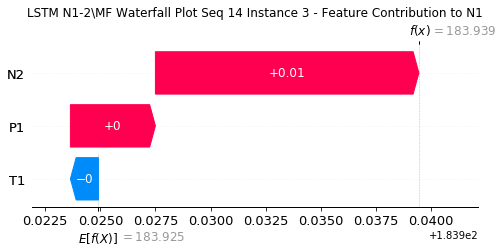

None

Contribution: [0.0022135  0.00200707 0.00711278]


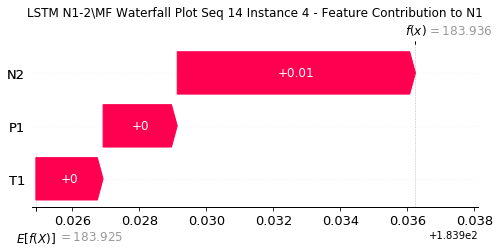

None

Contribution: [0.0019022  0.00155709 0.00616157]


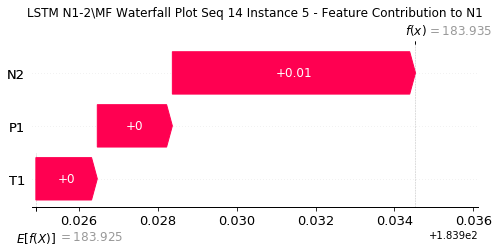

None

Contribution: [0.00167228 0.00154769 0.00536921]


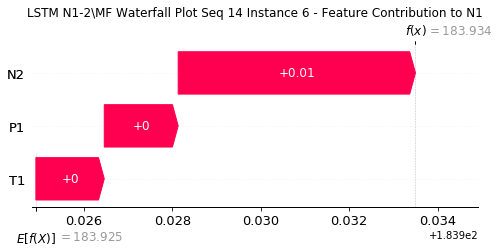

None

Contribution: [0.00159629 0.00150278 0.00519161]


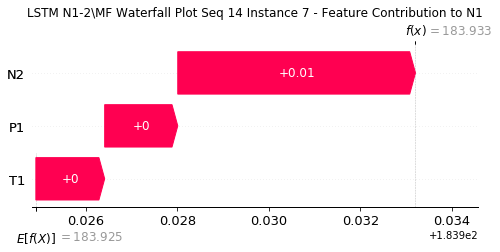

None

Contribution: [0.0015932  0.00156804 0.00518659]


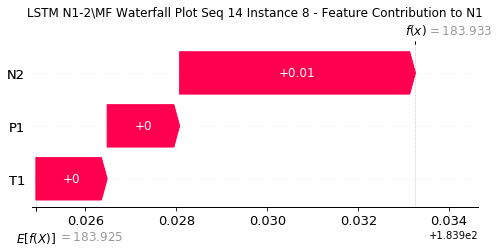

None

Contribution: [0.00161669 0.00157738 0.00522011]


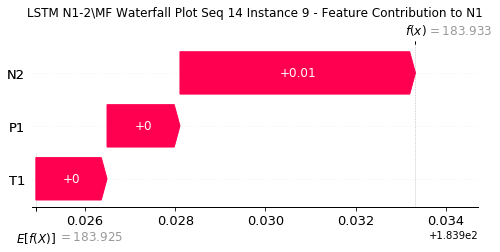

None

Contribution: [0.00163269 0.00153283 0.00526337]


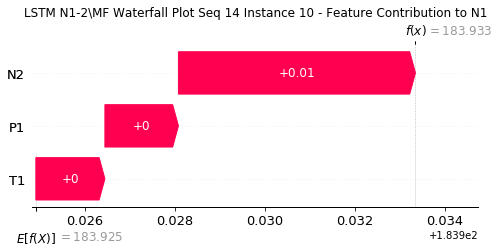

None

Contribution: [0.00167861 0.00156669 0.00541176]


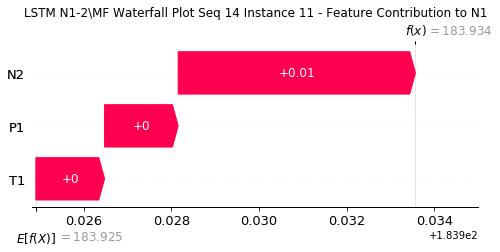

None

Contribution: [0.00172527 0.001646   0.00563519]


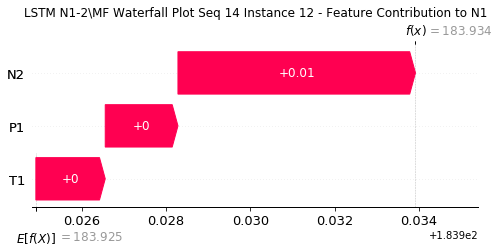

None

Contribution: [0.00185269 0.00174673 0.00597761]


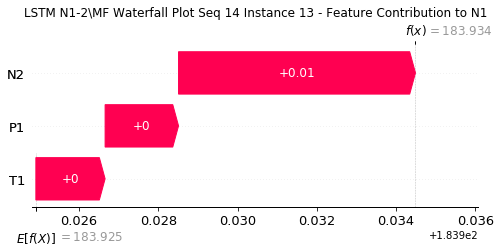

None

Contribution: [0.00196967 0.00182909 0.00648964]


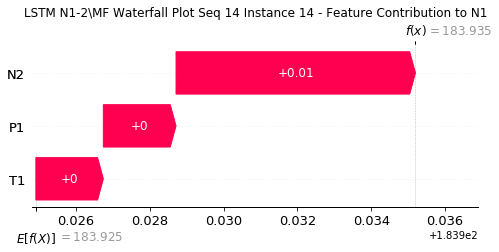

None

Contribution: [0.00225671 0.00212435 0.00729643]


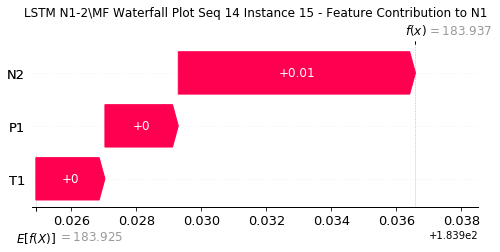

None

Contribution: [0.0026397  0.0025027  0.00851839]


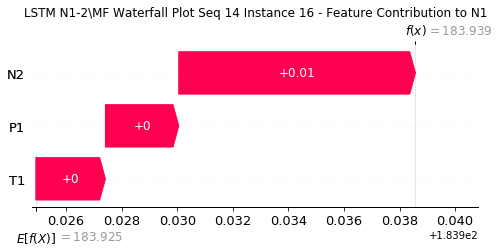

None

Contribution: [0.00322252 0.00286801 0.01043101]


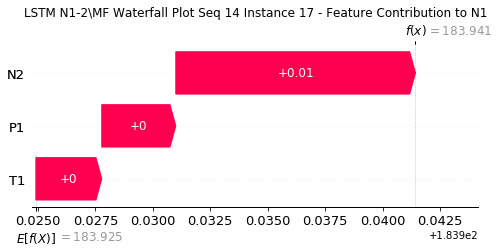

None

Contribution: [0.00420035 0.00399768 0.01352253]


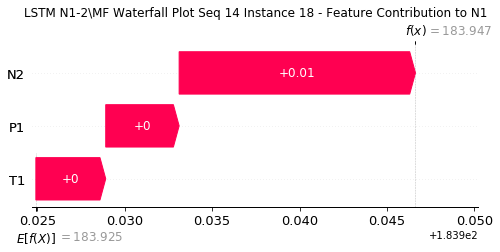

None

Contribution: [0.00578627 0.0055559  0.01859498]


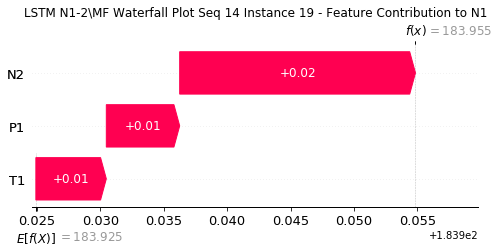

None

Contribution: [0.00843322 0.00821556 0.02705654]


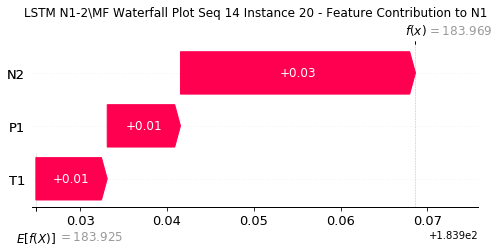

None

Contribution: [0.01280544 0.01262603 0.04118397]


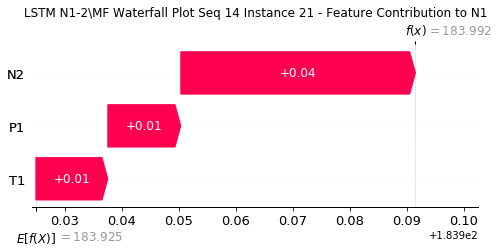

None

Contribution: [0.01995692 0.01992058 0.06420041]


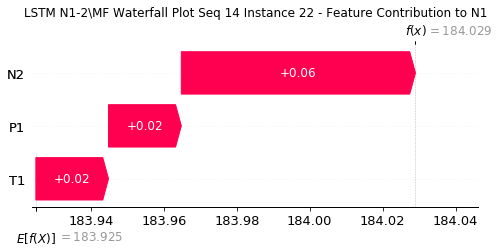

None

Contribution: [0.03065774 0.03223173 0.09752828]


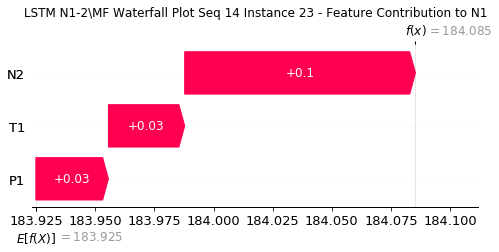

None

Contribution: [0.04451866 0.03824484 0.14281931]


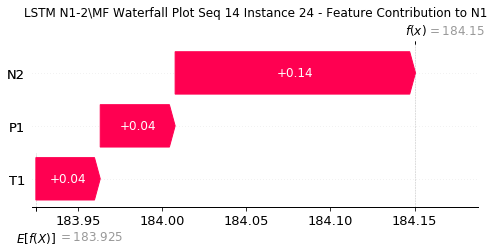

None

Contribution: [0.56675961 0.37294265 1.90126288]


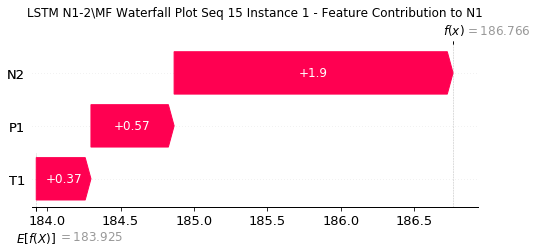

None

Contribution: [0.04164231 0.02853691 0.12985515]


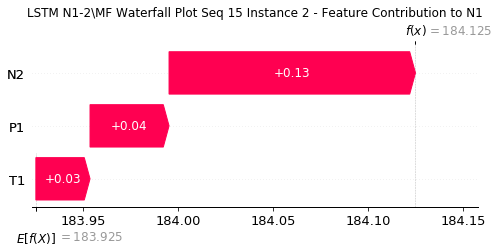

None

Contribution: [0.0034986  0.00102808 0.01164537]


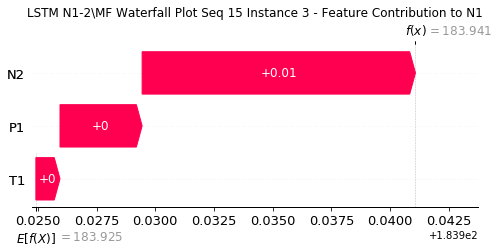

None

Contribution: [0.00223159 0.00231934 0.0072429 ]


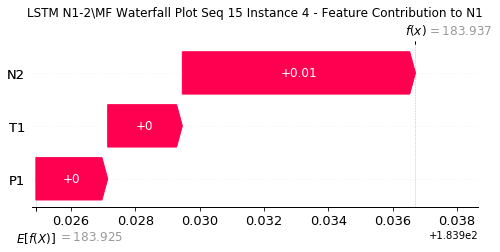

None

Contribution: [0.00194208 0.00201641 0.00622296]


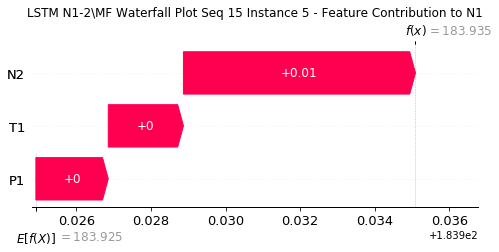

None

Contribution: [0.00164832 0.00170708 0.00533684]


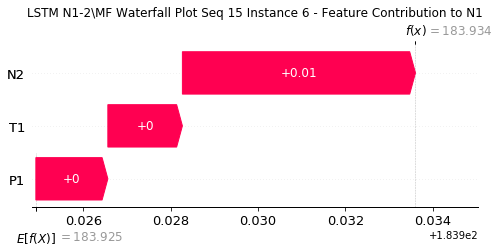

None

Contribution: [0.00154674 0.00156772 0.00512648]


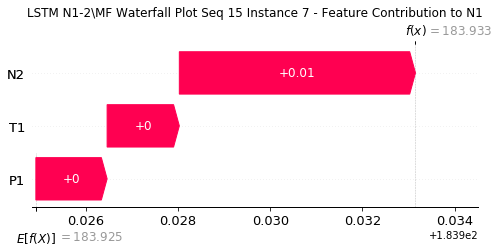

None

Contribution: [0.00160449 0.00156866 0.00513102]


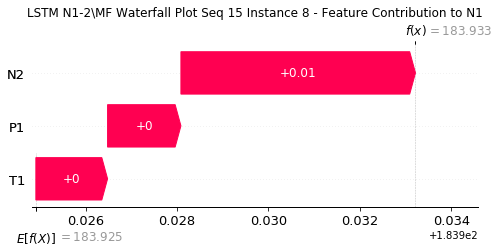

None

Contribution: [0.00158479 0.00159296 0.00514818]


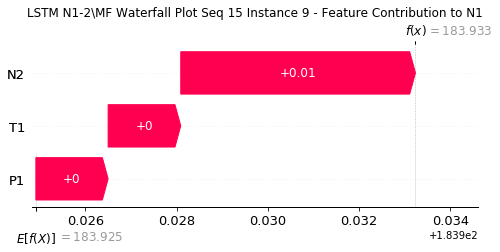

None

Contribution: [0.00161946 0.00156606 0.00521357]


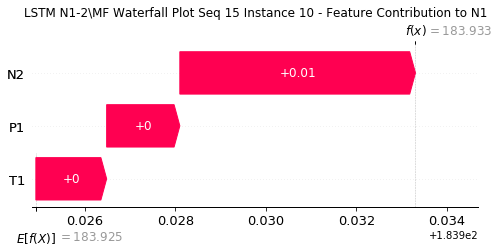

None

Contribution: [0.0016607  0.00159675 0.00535788]


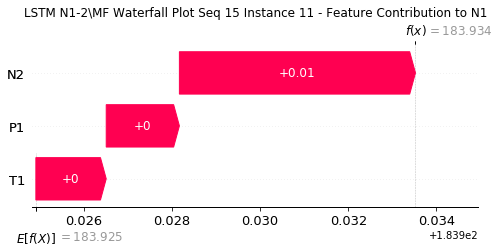

None

Contribution: [0.00172543 0.00166461 0.00557482]


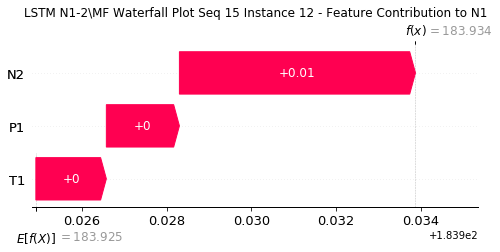

None

Contribution: [0.00183745 0.00172875 0.00590777]


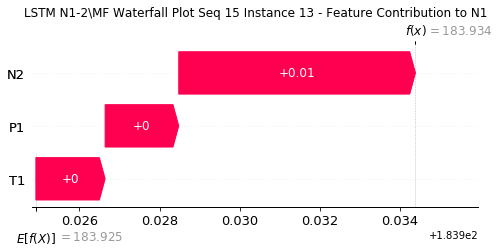

None

Contribution: [0.00199993 0.0017897  0.00642404]


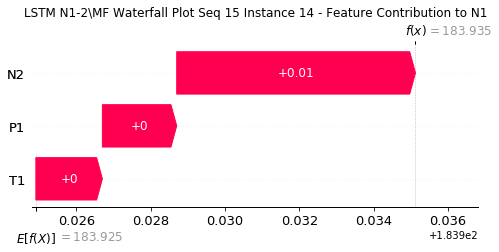

None

Contribution: [0.00223809 0.00206044 0.00719546]


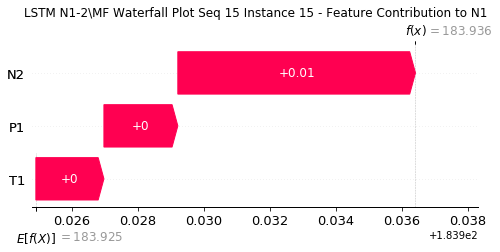

None

Contribution: [0.00261362 0.0024103  0.00838641]


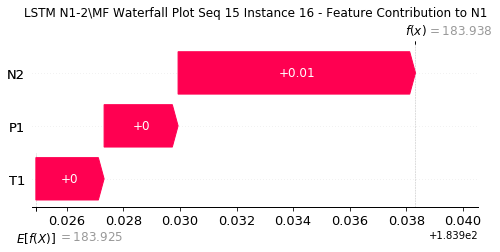

None

Contribution: [0.00320026 0.00291135 0.01025744]


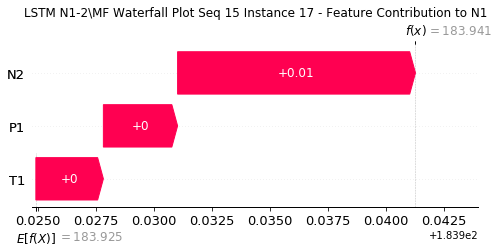

None

Contribution: [0.00412463 0.00381948 0.0132616 ]


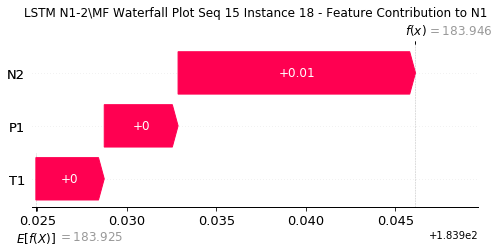

None

Contribution: [0.00567929 0.00525228 0.01822168]


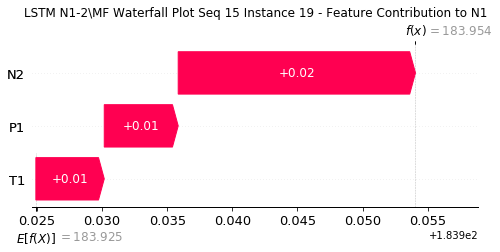

None

Contribution: [0.00827645 0.00762091 0.0265145 ]


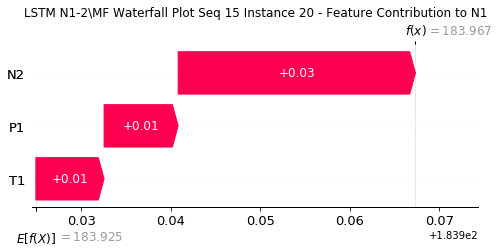

None

Contribution: [0.01266661 0.01155158 0.04045238]


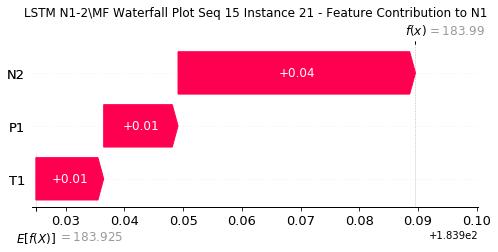

None

Contribution: [0.01967153 0.01797669 0.06314882]


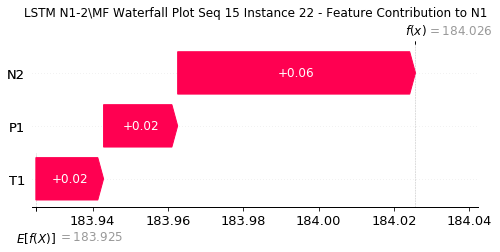

None

Contribution: [0.02925168 0.02682911 0.09624567]


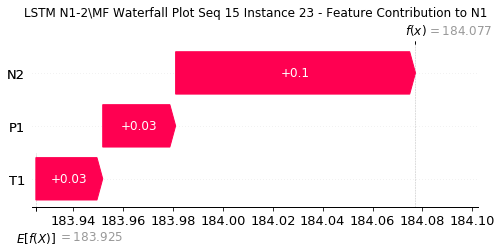

None

Contribution: [0.04390019 0.02573433 0.14294084]


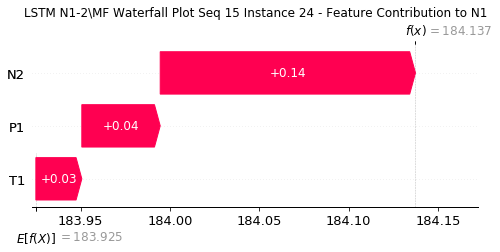

None

Contribution: [0.57061106 0.02304952 1.94044872]


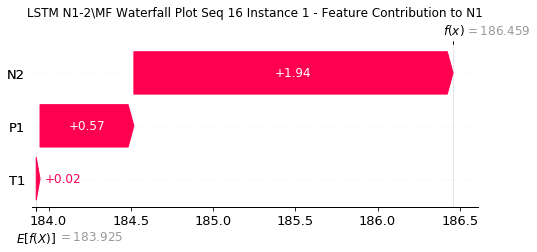

None

Contribution: [0.04455295 0.01796367 0.13400005]


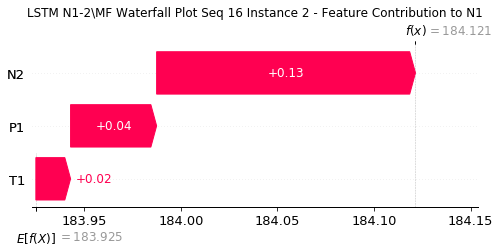

None

Contribution: [ 0.00334136 -0.00034884  0.01179788]


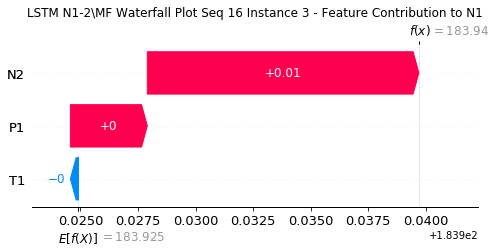

None

Contribution: [0.00218201 0.00213446 0.00715774]


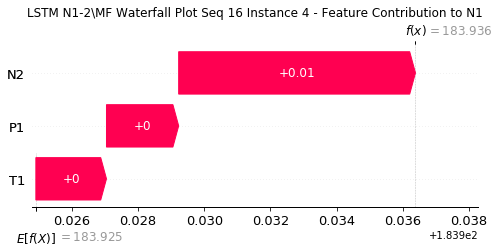

None

Contribution: [0.0019356  0.00186688 0.00622236]


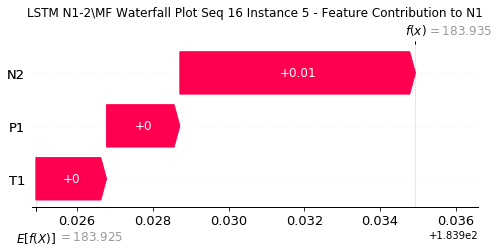

None

Contribution: [0.00164232 0.0016144  0.00535916]


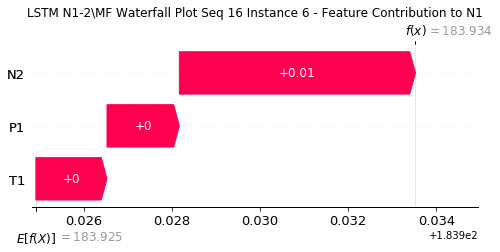

None

Contribution: [0.00158021 0.00152952 0.00517834]


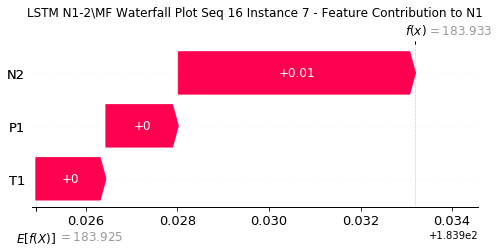

None

Contribution: [0.0015751  0.00157943 0.0051593 ]


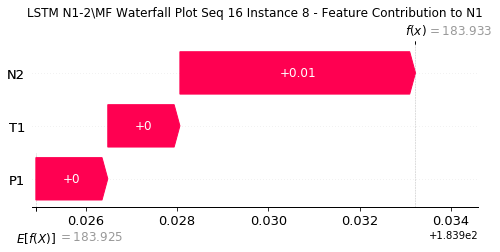

None

Contribution: [0.00161333 0.00153434 0.005199  ]


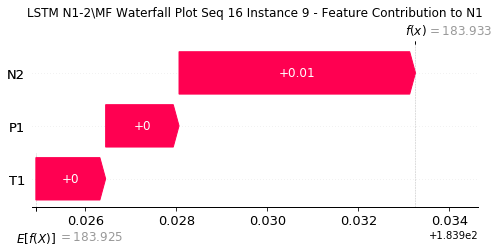

None

Contribution: [0.00163395 0.00157157 0.00525809]


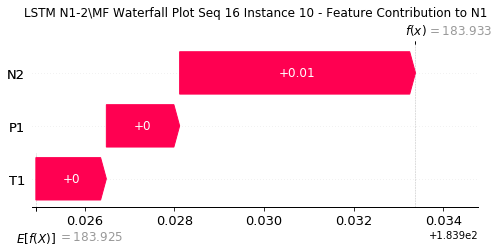

None

Contribution: [0.00167527 0.00160955 0.00540555]


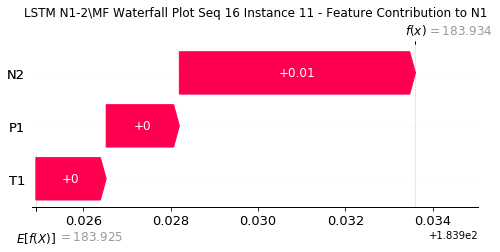

None

Contribution: [0.00173916 0.00173724 0.00561832]


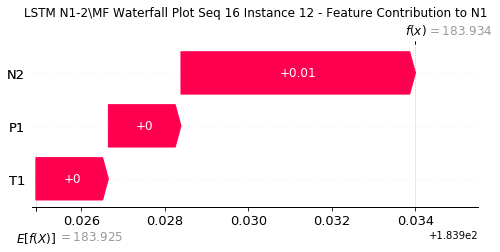

None

Contribution: [0.00185744 0.00176896 0.00596938]


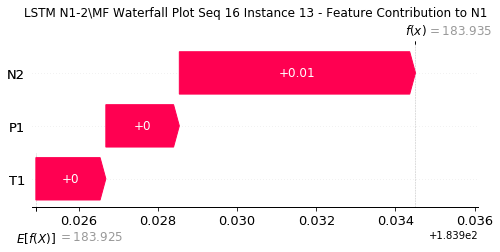

None

Contribution: [0.00202524 0.00192443 0.00648567]


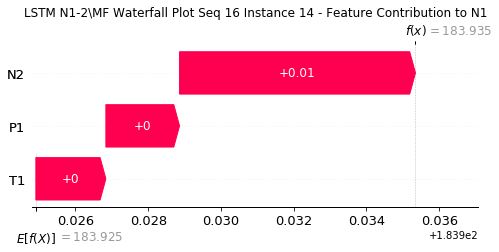

None

Contribution: [0.0022659  0.00213718 0.00728338]


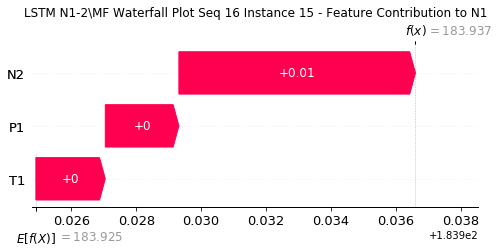

None

Contribution: [0.00264033 0.00248749 0.00849236]


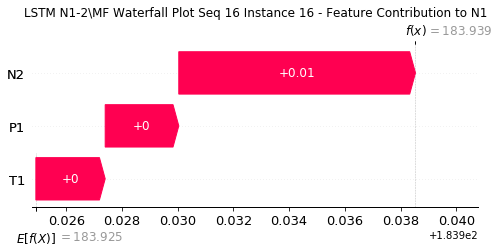

None

Contribution: [0.00324439 0.00295151 0.01039349]


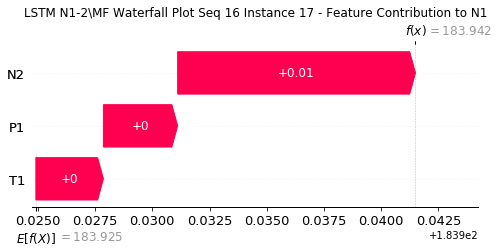

None

Contribution: [0.00415687 0.00392575 0.0134541 ]


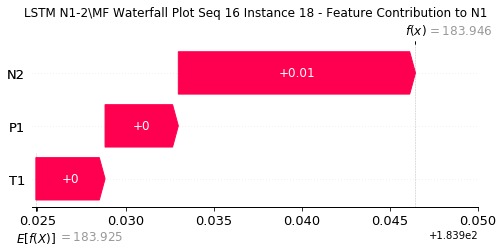

None

Contribution: [0.00572287 0.00540365 0.01849174]


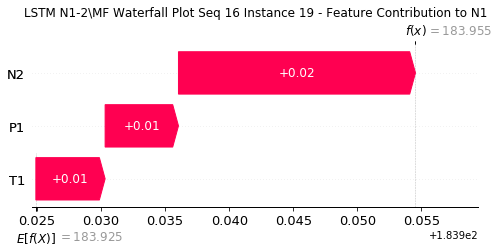

None

Contribution: [0.00833627 0.00789061 0.02689909]


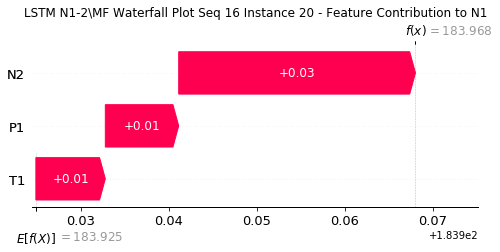

None

Contribution: [0.0127596  0.01205829 0.04098501]


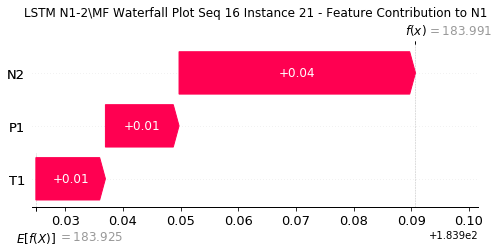

None

Contribution: [0.01975486 0.01914467 0.06386772]


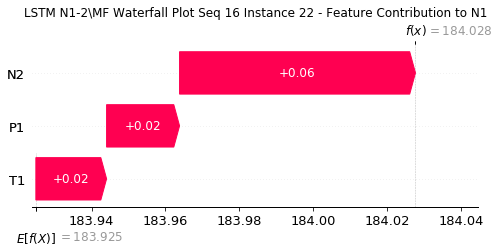

None

Contribution: [0.03012989 0.03015808 0.09699778]


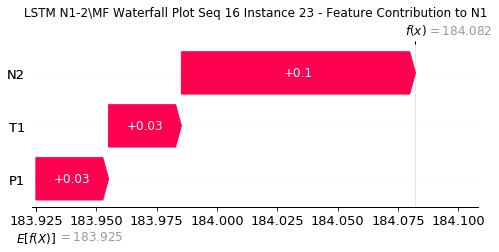

None

Contribution: [0.04448159 0.02133472 0.14280024]


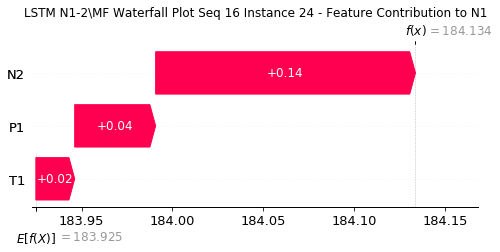

None

Contribution: [0.58993688 0.0260228  1.93721828]


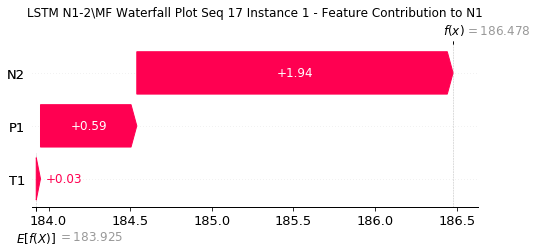

None

Contribution: [0.0444079  0.01248202 0.13508185]


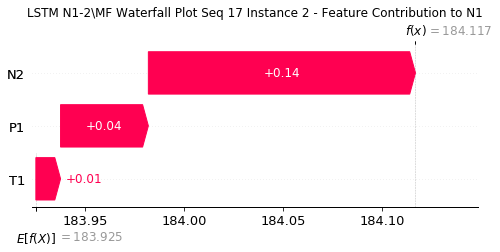

None

Contribution: [ 0.00358312 -0.00128605  0.01184553]


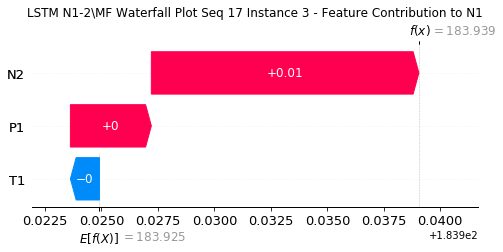

None

Contribution: [0.00219923 0.00200371 0.00716277]


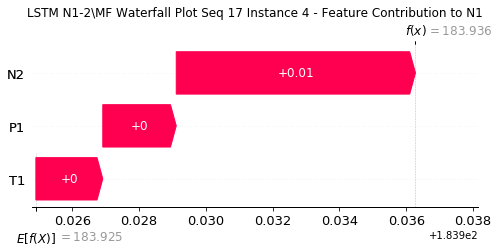

None

Contribution: [0.00192773 0.00182534 0.00623138]


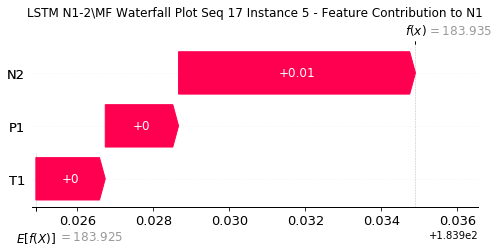

None

Contribution: [0.00165387 0.00153025 0.00536828]


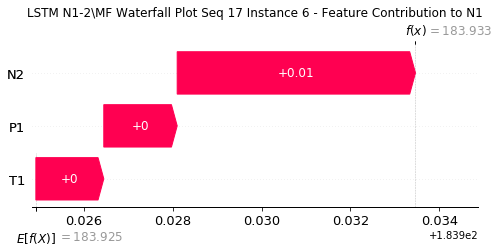

None

Contribution: [0.00159125 0.00152262 0.00519484]


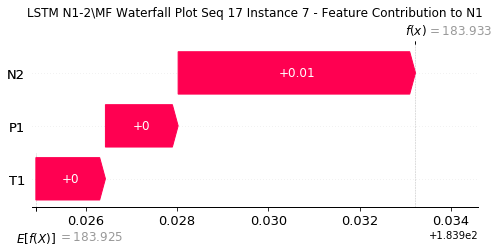

None

Contribution: [0.00159116 0.00148878 0.00518671]


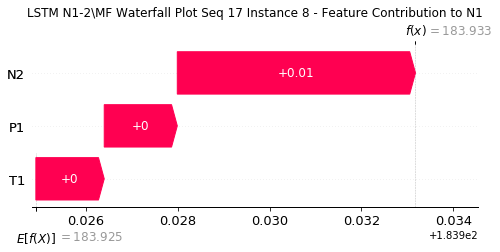

None

Contribution: [0.00159154 0.00148811 0.00520032]


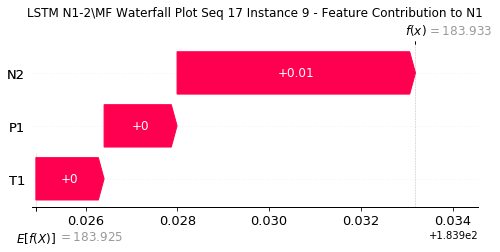

None

Contribution: [0.0016137  0.00145583 0.00524858]


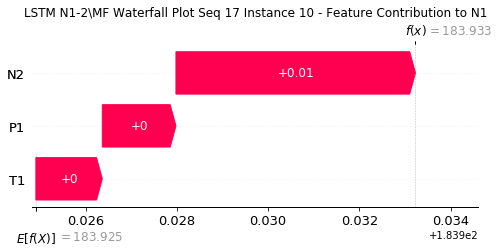

None

Contribution: [0.00166378 0.00150013 0.00540007]


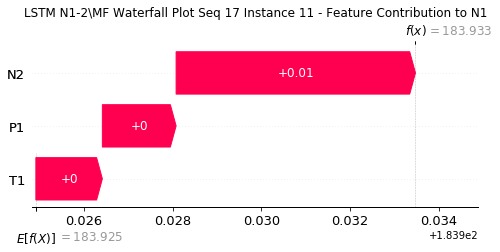

None

Contribution: [0.00172837 0.0016173  0.00562306]


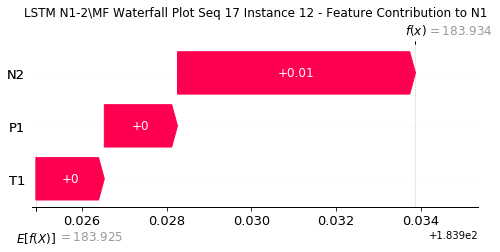

None

Contribution: [0.00184111 0.00165141 0.00596211]


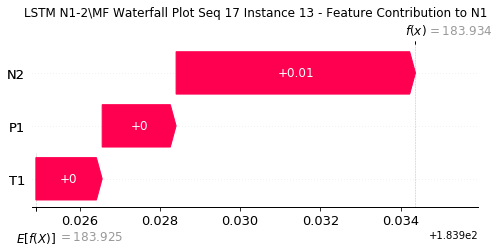

None

Contribution: [0.00202431 0.00177948 0.00648491]


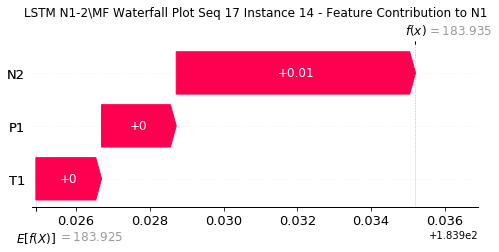

None

Contribution: [0.00225162 0.00200918 0.00728015]


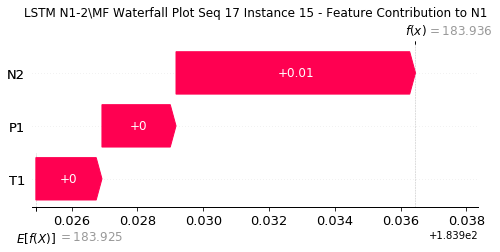

None

Contribution: [0.00263172 0.00233757 0.00849748]


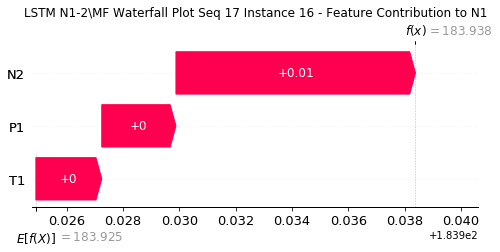

None

Contribution: [0.00324166 0.00285986 0.01038816]


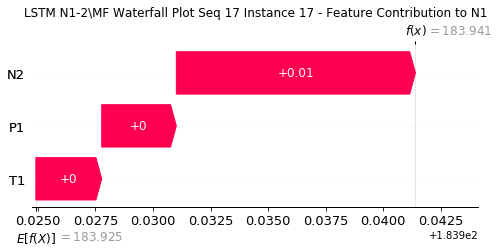

None

Contribution: [0.00420365 0.00376028 0.01347829]


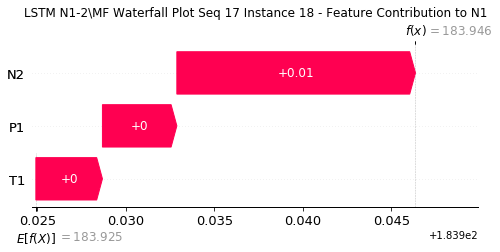

None

Contribution: [0.00578403 0.00515799 0.01852886]


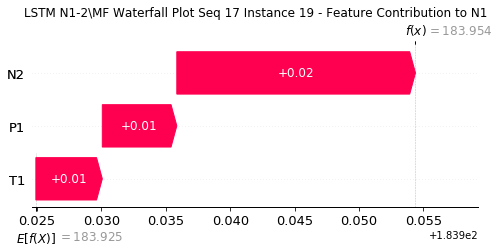

None

Contribution: [0.00842779 0.00752144 0.02694135]


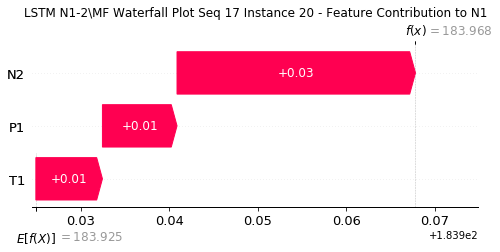

None

Contribution: [0.01279625 0.01138212 0.04103035]


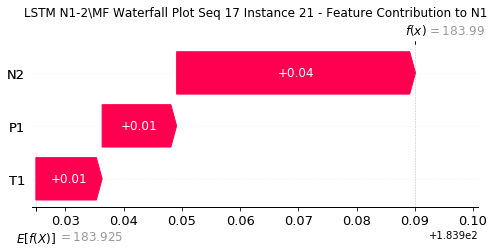

None

Contribution: [0.02006009 0.01788228 0.0639923 ]


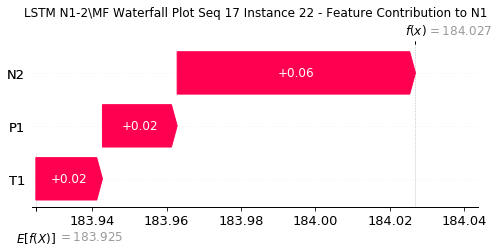

None

Contribution: [0.03112193 0.02629086 0.09759914]


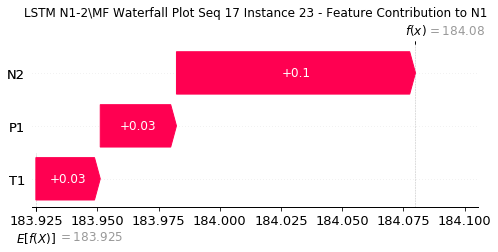

None

Contribution: [0.04351052 0.01168522 0.14240027]


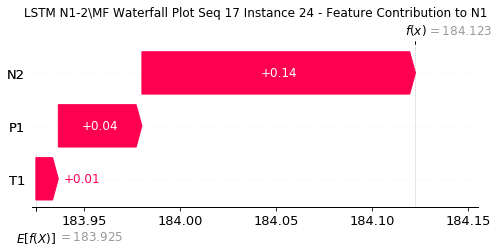

None

Contribution: [ 0.57499435 -0.14899692  1.92016594]


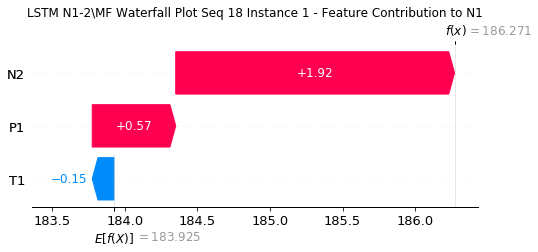

None

Contribution: [0.04362945 0.00677564 0.13472458]


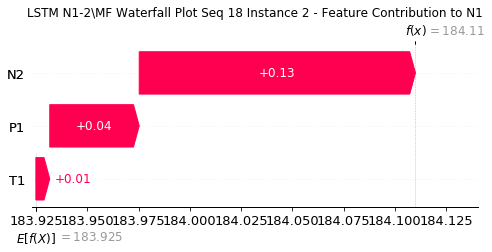

None

Contribution: [ 0.00360512 -0.00192255  0.01190979]


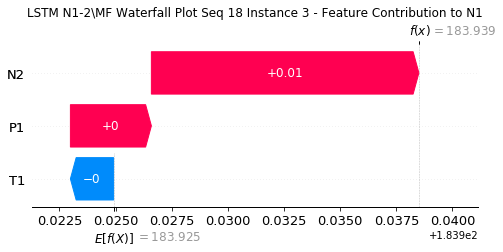

None

Contribution: [0.00218393 0.00190072 0.00710598]


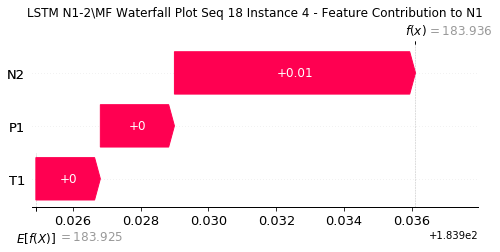

None

Contribution: [0.00191522 0.00173948 0.00624817]


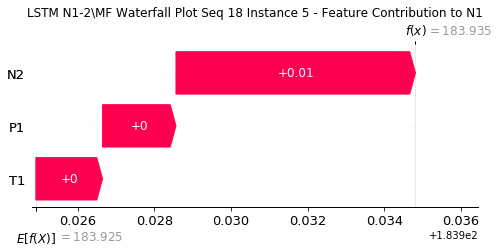

None

Contribution: [0.00165891 0.00146304 0.00538507]


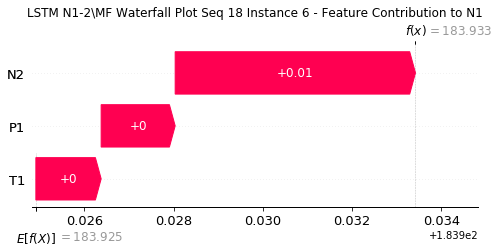

None

Contribution: [0.00156896 0.00137165 0.00519463]


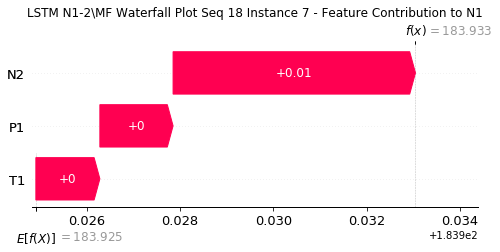

None

Contribution: [0.00160206 0.00137056 0.00519757]


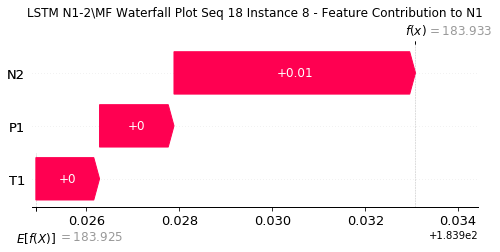

None

Contribution: [0.00158441 0.00138529 0.00521331]


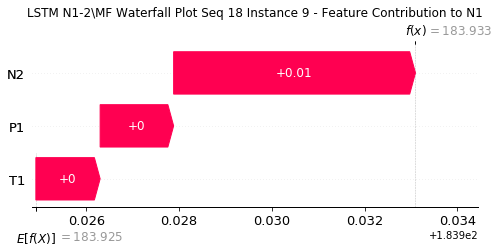

None

Contribution: [0.00163549 0.00143407 0.00529358]


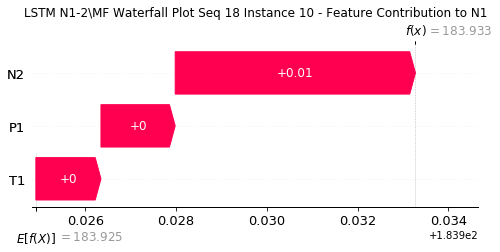

None

Contribution: [0.0016847  0.00146829 0.00544419]


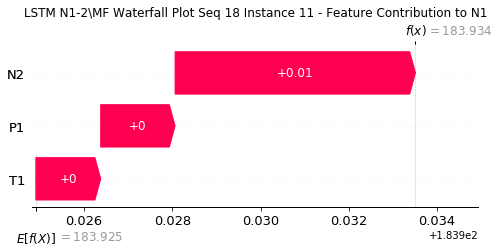

None

Contribution: [0.00174316 0.00153818 0.0056404 ]


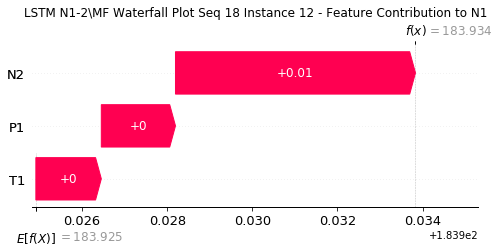

None

Contribution: [0.00187071 0.00162668 0.00602338]


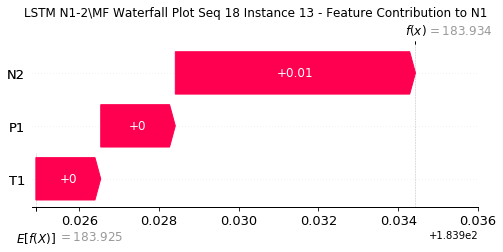

None

Contribution: [0.00204351 0.00182613 0.00655922]


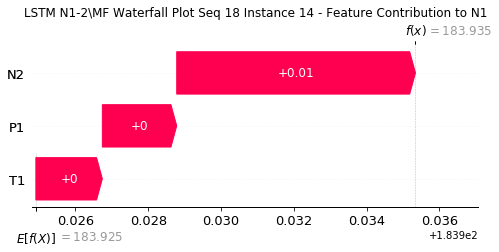

None

Contribution: [0.00229419 0.00198397 0.00736526]


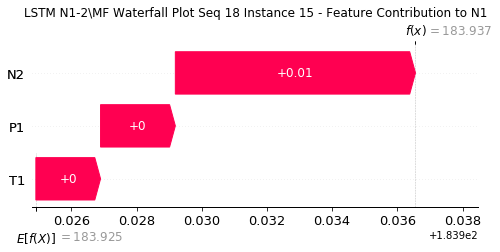

None

Contribution: [0.00268354 0.00231195 0.00859556]


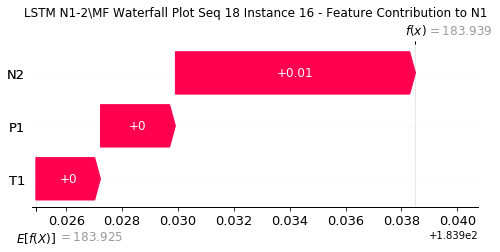

None

Contribution: [0.00326437 0.00272732 0.01052337]


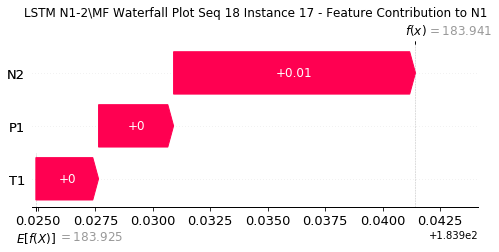

None

Contribution: [0.00428623 0.00367352 0.01365869]


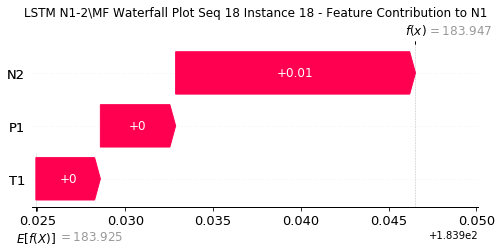

None

Contribution: [0.00590184 0.00505733 0.01877977]


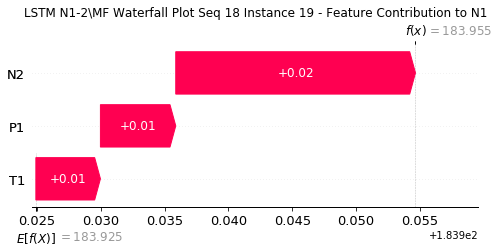

None

Contribution: [0.00860277 0.00737281 0.02732028]


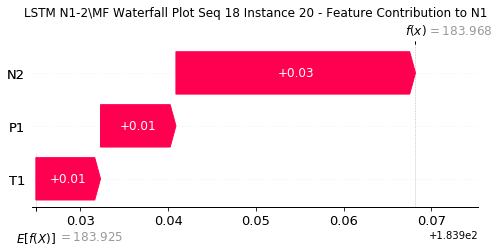

None

Contribution: [0.01307181 0.01125368 0.04155373]


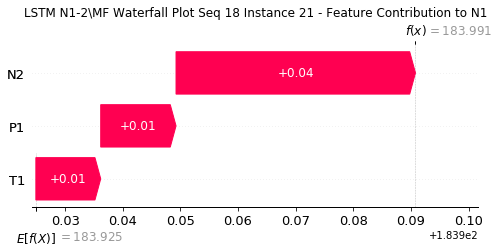

None

Contribution: [0.02033442 0.01734109 0.06463764]


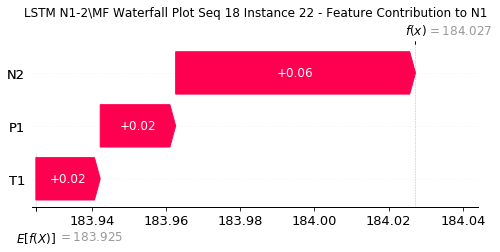

None

Contribution: [0.03023474 0.02456947 0.0979903 ]


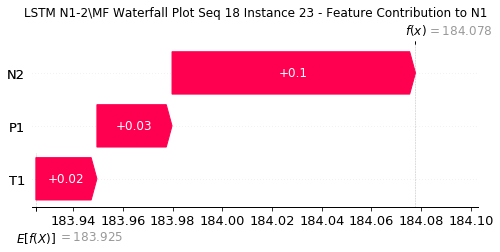

None

Contribution: [0.04423692 0.01164558 0.14431983]


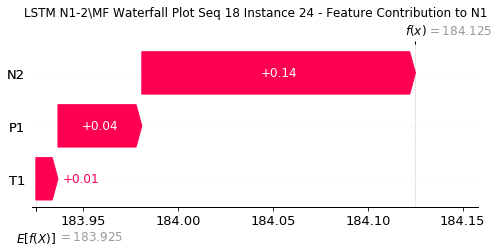

None

Contribution: [ 0.59413323 -0.15222485  1.97440451]


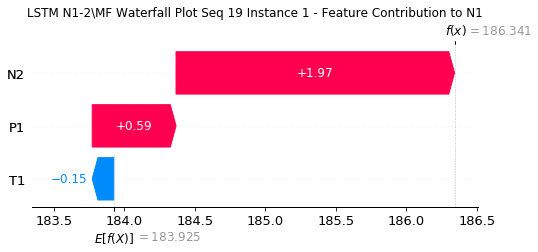

None

Contribution: [0.04610371 0.00883174 0.13670123]


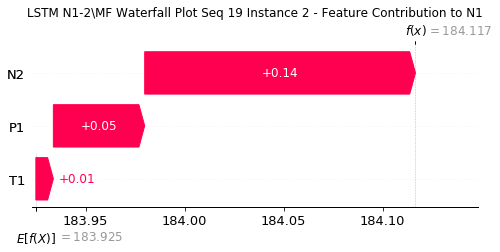

None

Contribution: [ 0.00387496 -0.00068448  0.01197711]


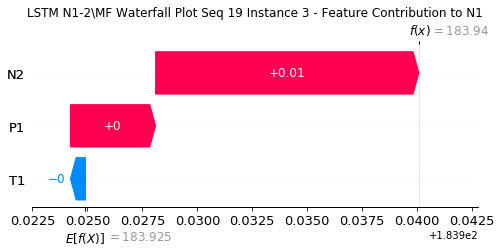

None

Contribution: [0.00222966 0.00207519 0.00715587]


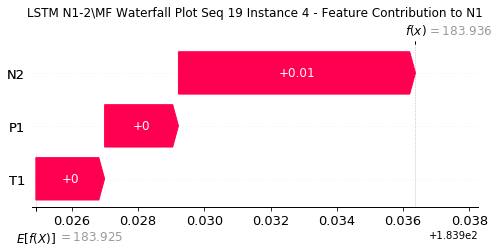

None

Contribution: [0.00197846 0.00177458 0.00623394]


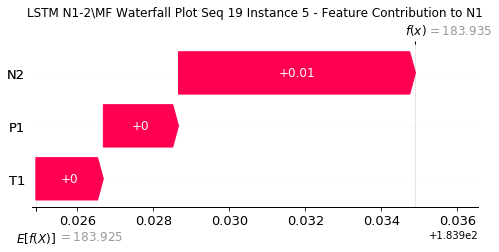

None

Contribution: [0.00168966 0.00157897 0.00539361]


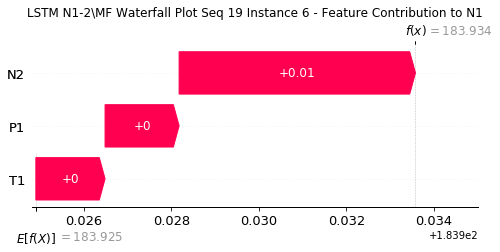

None

Contribution: [0.00164884 0.00151982 0.00523154]


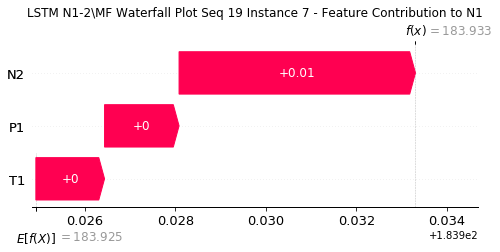

None

Contribution: [0.00166444 0.00148968 0.00522489]


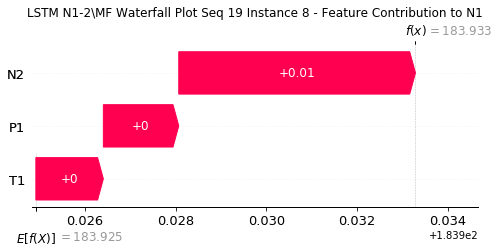

None

Contribution: [0.00164294 0.00156425 0.00523893]


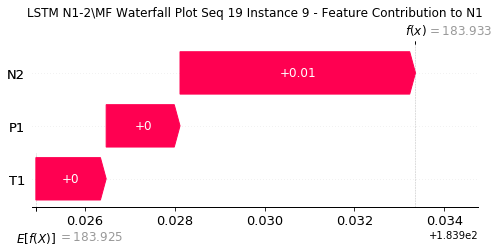

None

Contribution: [0.0016623  0.00153695 0.0052861 ]


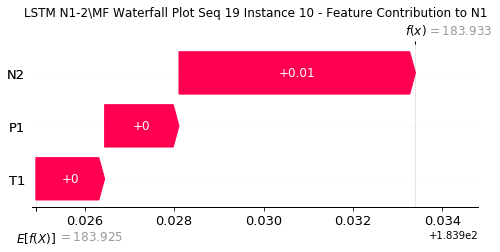

None

Contribution: [0.00171235 0.00156239 0.00543686]


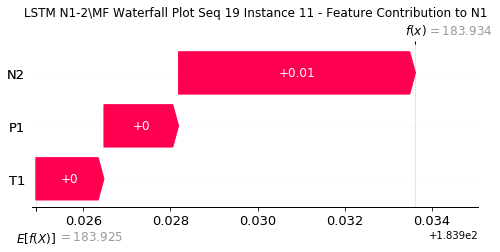

None

Contribution: [0.00180491 0.00162933 0.00566675]


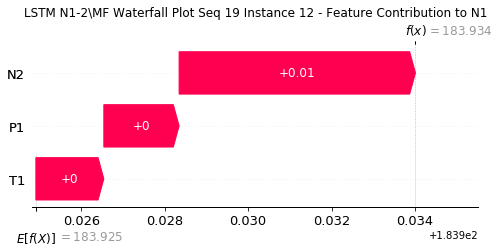

None

Contribution: [0.00189184 0.00171596 0.0060012 ]


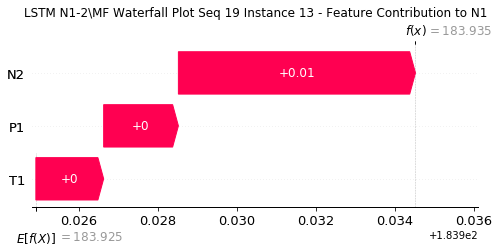

None

Contribution: [0.00206557 0.00182344 0.00653304]


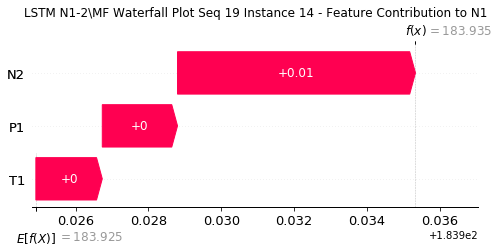

None

Contribution: [0.00230549 0.00204851 0.0073242 ]


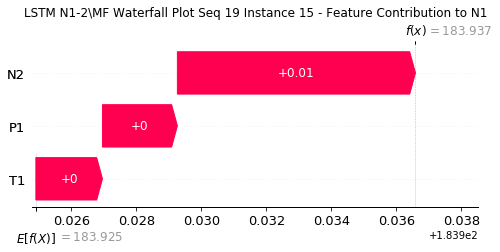

None

Contribution: [0.00268593 0.00237499 0.00854806]


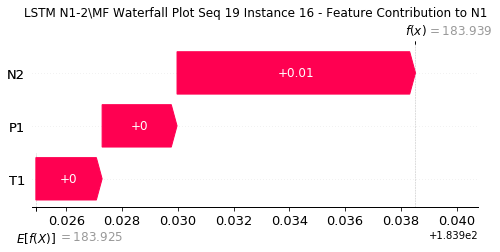

None

Contribution: [0.00330869 0.00289809 0.01051209]


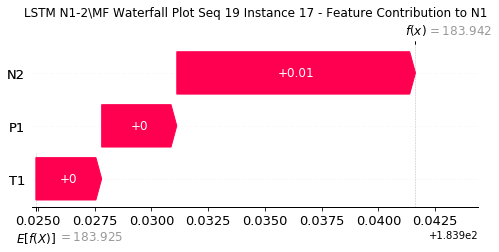

None

Contribution: [0.00426924 0.00371603 0.01356685]


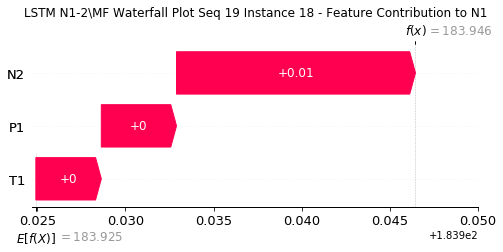

None

Contribution: [0.00587376 0.00511642 0.01865364]


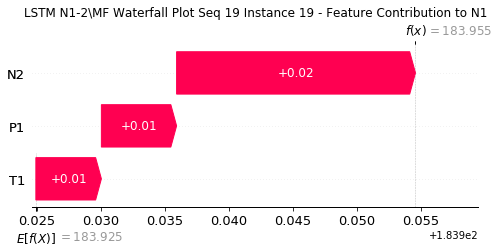

None

Contribution: [0.0085619  0.00750389 0.02712739]


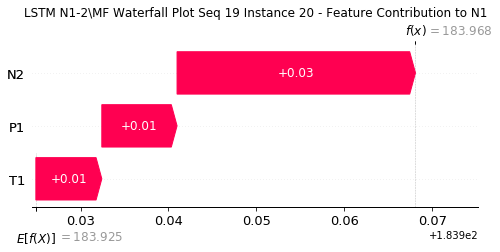

None

Contribution: [0.01299614 0.01146797 0.04128235]


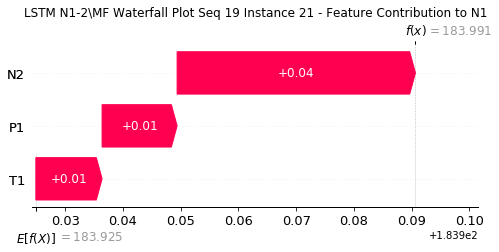

None

Contribution: [0.02012704 0.01773443 0.06423526]


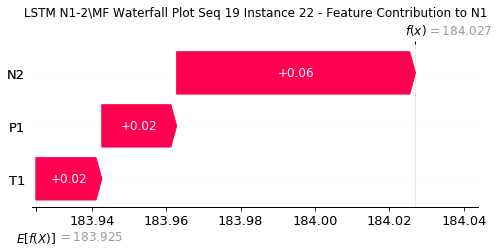

None

Contribution: [0.03063761 0.02601246 0.09784788]


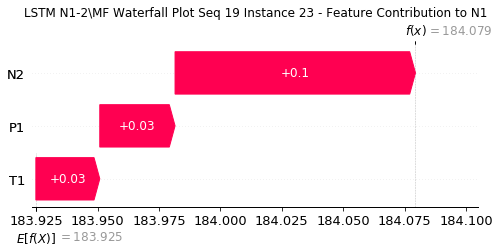

None

Contribution: [0.04640676 0.01450046 0.14444551]


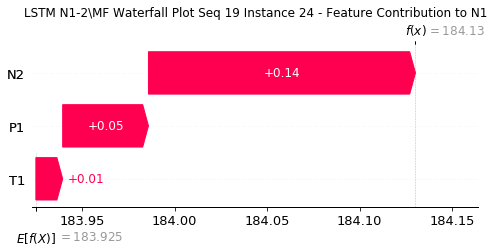

None

Contribution: [ 0.62206057 -0.08947104  1.95113775]


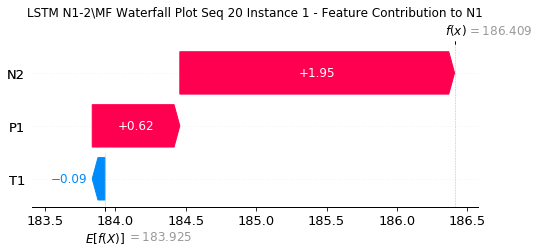

None

Contribution: [0.04196375 0.00648384 0.13416903]


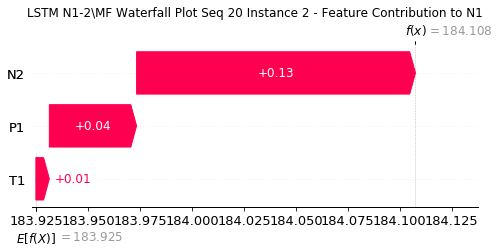

None

Contribution: [ 0.00374312 -0.00136605  0.01188606]


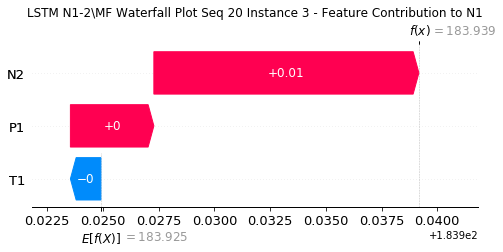

None

Contribution: [0.00222608 0.00199686 0.00715234]


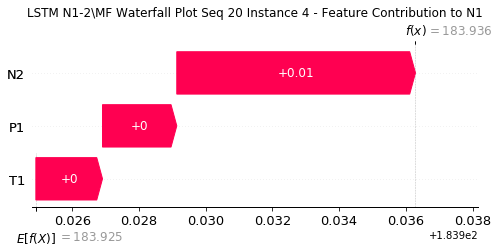

None

Contribution: [0.00196014 0.00176266 0.00623328]


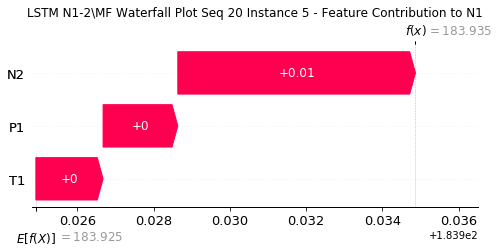

None

Contribution: [0.00168197 0.001518   0.0053793 ]


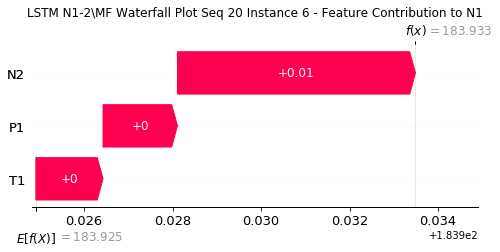

None

Contribution: [0.00162273 0.00142916 0.00520545]


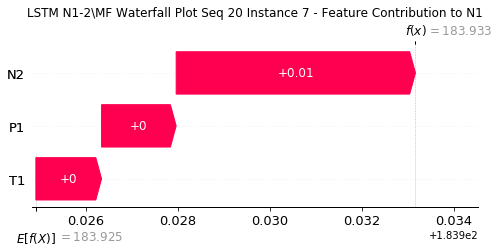

None

Contribution: [0.00162859 0.0014478  0.0051927 ]


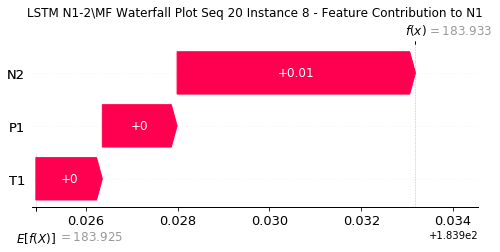

None

Contribution: [0.00164077 0.00146401 0.00522961]


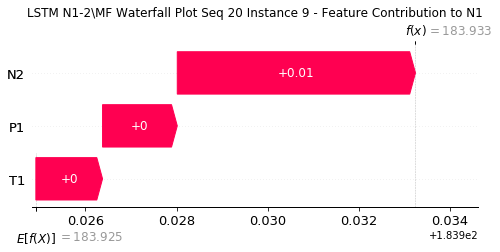

None

Contribution: [0.00165223 0.00147479 0.00526613]


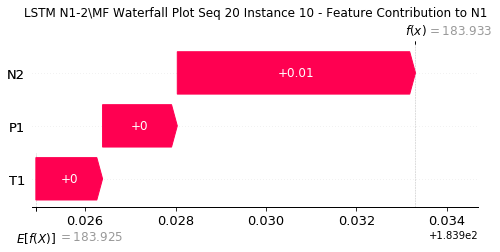

None

Contribution: [0.00170026 0.00150397 0.00541467]


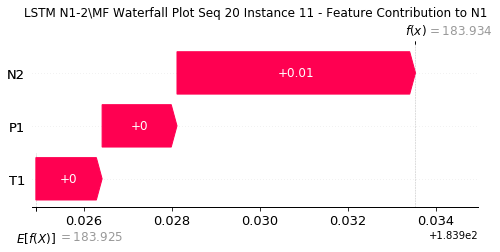

None

Contribution: [0.00178827 0.00165169 0.00562035]


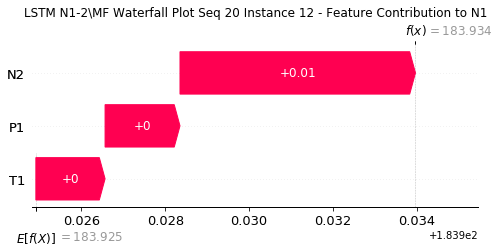

None

Contribution: [0.00188085 0.00165597 0.00597554]


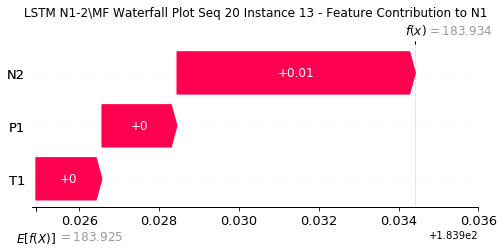

None

Contribution: [0.00202569 0.00179179 0.00648948]


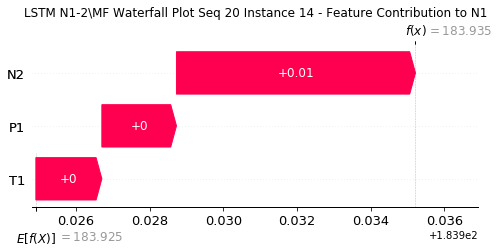

None

Contribution: [0.00230692 0.00199767 0.0072989 ]


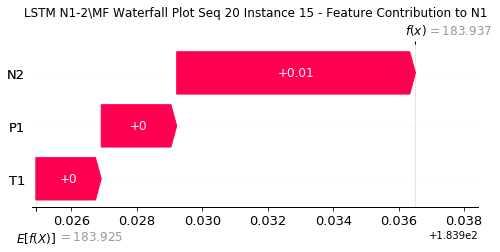

None

Contribution: [0.00270098 0.00232775 0.00852205]


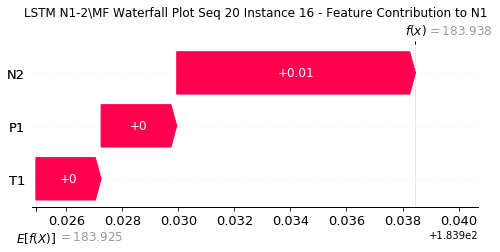

None

Contribution: [0.00333601 0.00279955 0.01042479]


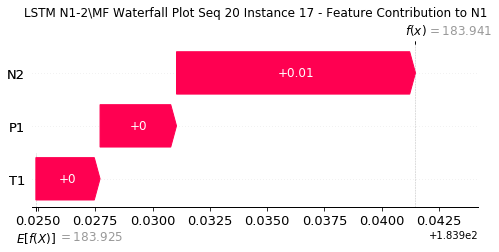

None

Contribution: [0.00427893 0.00365417 0.01350825]


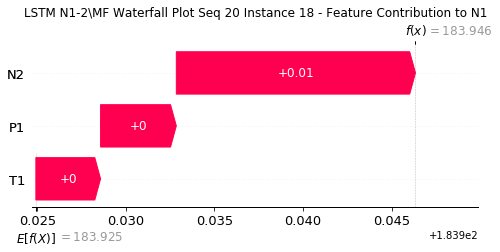

None

Contribution: [0.00588788 0.00503538 0.01857137]


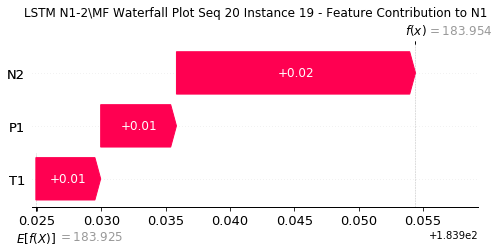

None

Contribution: [0.00854029 0.00734669 0.02698443]


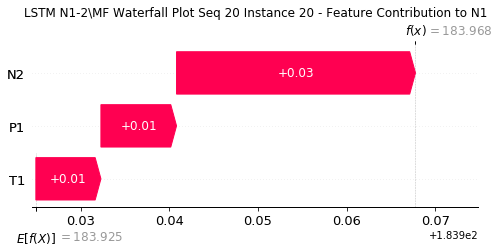

None

Contribution: [0.01304171 0.01125066 0.04108953]


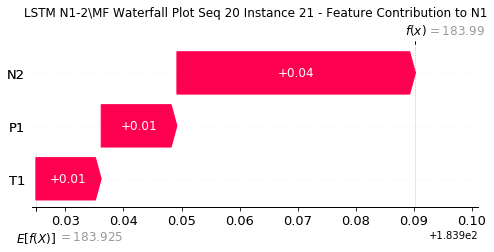

None

Contribution: [0.02019314 0.01742564 0.06390155]


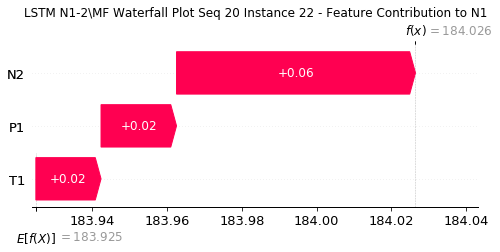

None

Contribution: [0.0302893  0.02703831 0.09712802]


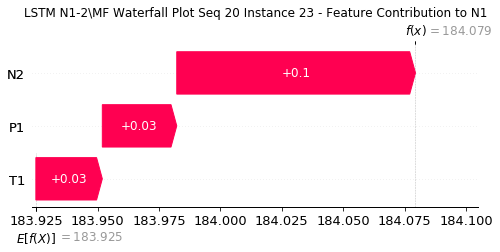

None

Contribution: [0.04604659 0.01880628 0.1432918 ]


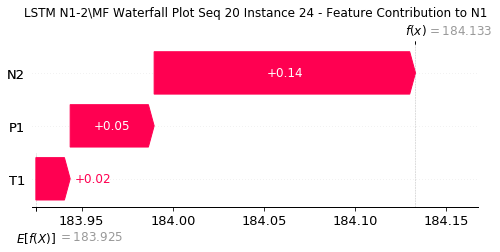

None

Contribution: [ 0.59262336 -0.02899979  1.91788327]


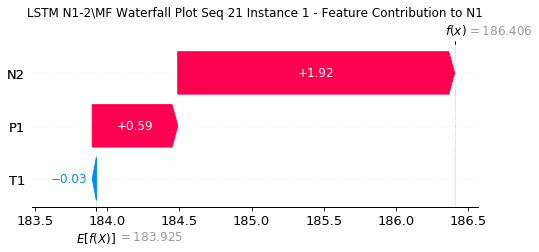

None

Contribution: [0.04741328 0.01256124 0.13539619]


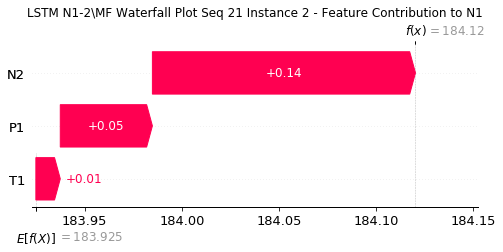

None

Contribution: [ 0.0036777  -0.00125277  0.01187231]


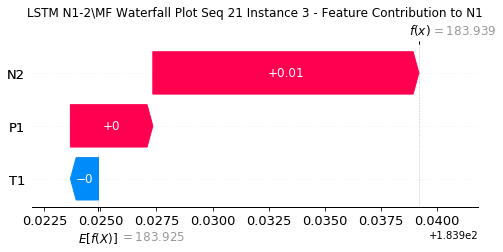

None

Contribution: [0.00221281 0.00202043 0.0071602 ]


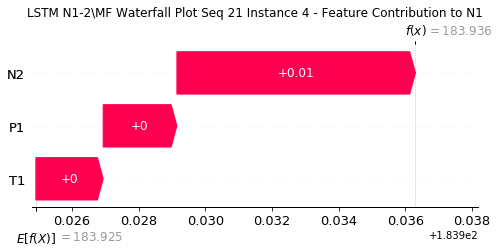

None

Contribution: [0.00197578 0.001647   0.00620636]


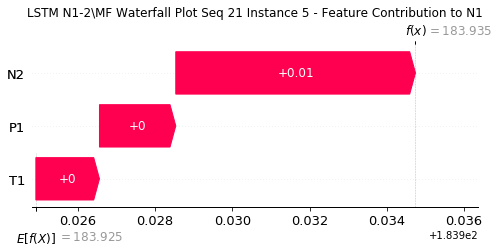

None

Contribution: [0.00167816 0.00154538 0.0053834 ]


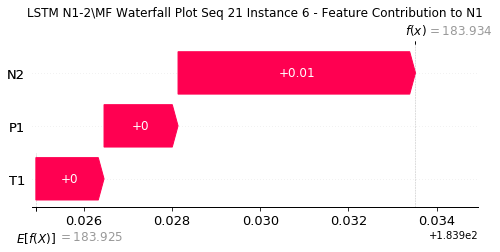

None

Contribution: [0.00165137 0.00152105 0.00521376]


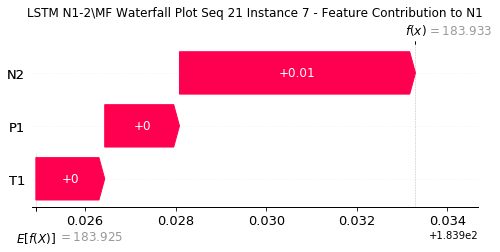

None

Contribution: [0.00164532 0.00157454 0.00520913]


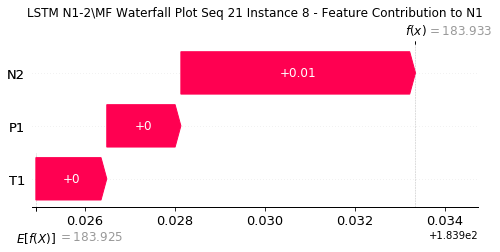

None

Contribution: [0.00164422 0.00156322 0.00523268]


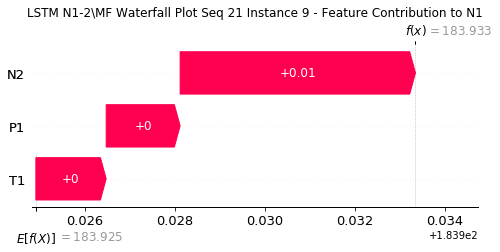

None

Contribution: [0.00162986 0.00148781 0.00527325]


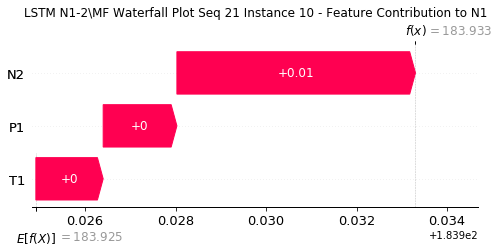

None

Contribution: [0.00168474 0.00152171 0.00542406]


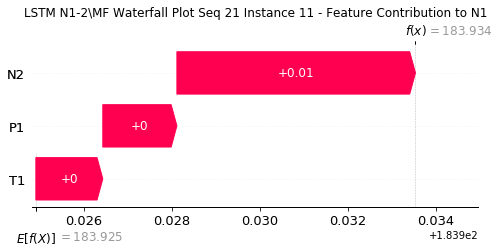

None

Contribution: [0.0018067  0.00160157 0.00566611]


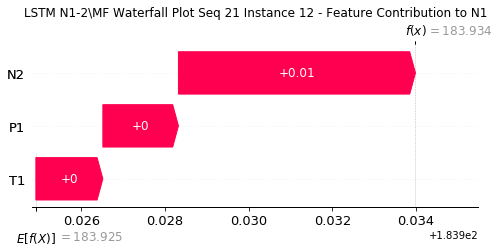

None

Contribution: [0.00187039 0.00167914 0.00599253]


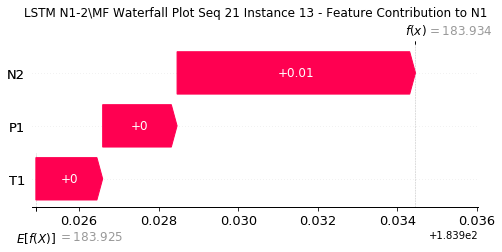

None

Contribution: [0.0020714  0.00183537 0.00653072]


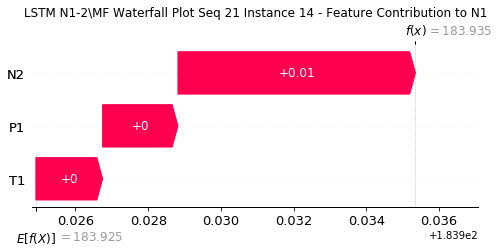

None

Contribution: [0.00234043 0.00195194 0.00733879]


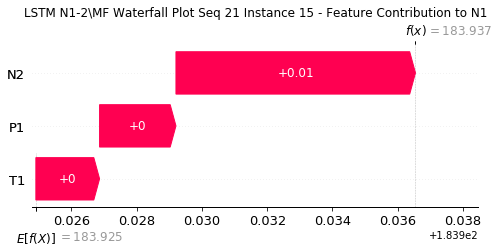

None

Contribution: [0.00271683 0.00227933 0.00856514]


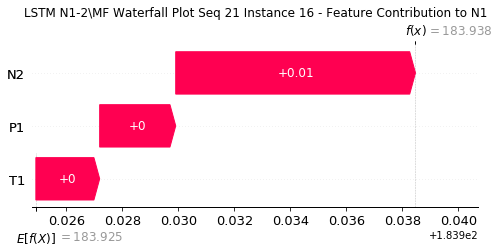

None

Contribution: [0.00332435 0.00275041 0.01049349]


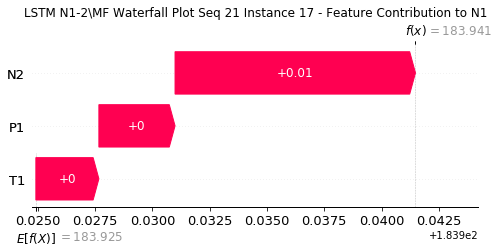

None

Contribution: [0.00433956 0.00362137 0.01359917]


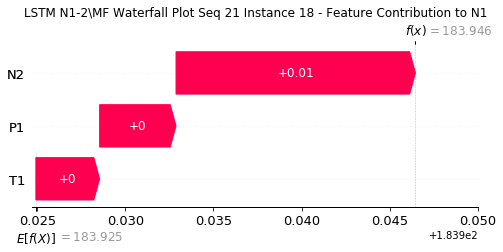

None

Contribution: [0.00589736 0.00484771 0.01866299]


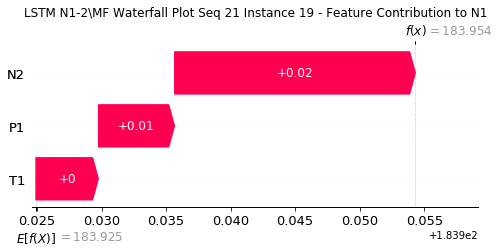

None

Contribution: [0.00856363 0.00703388 0.02715863]


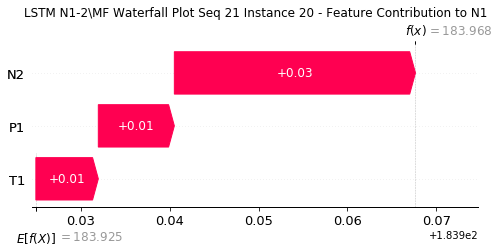

None

Contribution: [0.01297692 0.01066095 0.04128256]


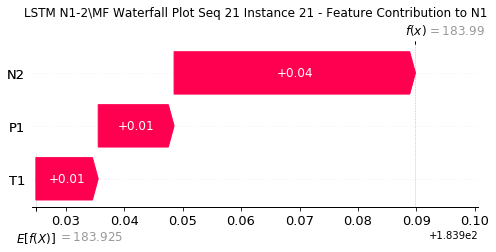

None

Contribution: [0.02018004 0.01618249 0.06431368]


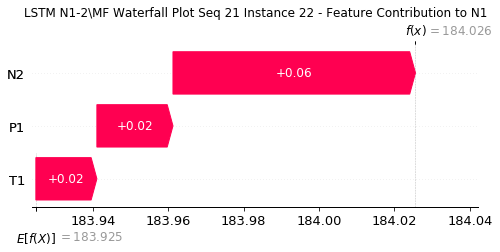

None

Contribution: [0.03069921 0.02184005 0.09772521]


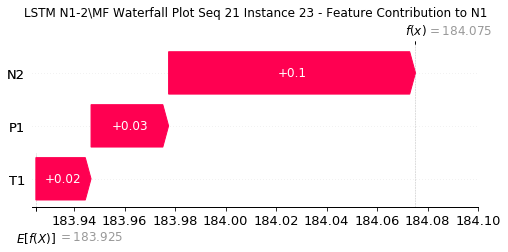

None

Contribution: [0.04885047 0.00406788 0.1448413 ]


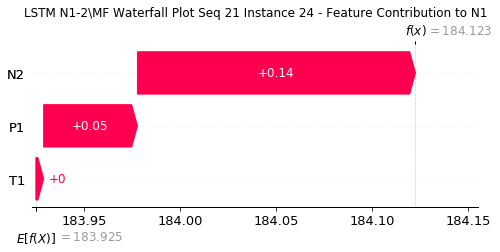

None

Contribution: [ 0.60662915 -0.37339023  1.95064676]


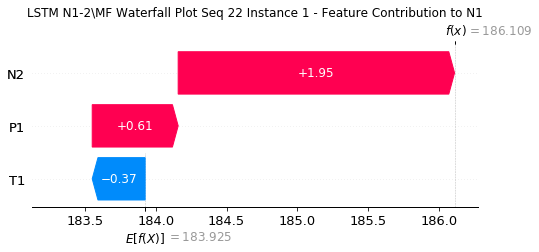

None

Contribution: [ 0.04612886 -0.00563521  0.13587761]


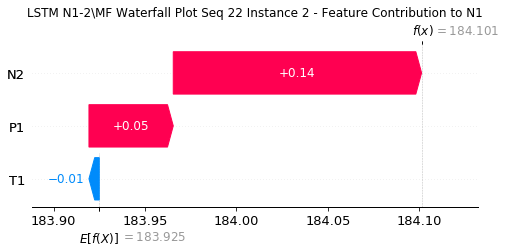

None

Contribution: [ 0.00397777 -0.00291891  0.01174589]


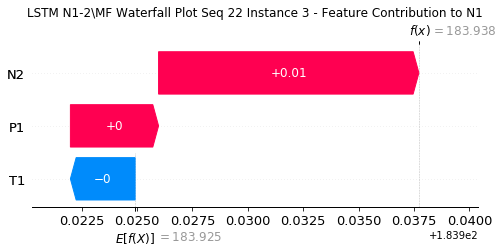

None

Contribution: [0.00218869 0.00189871 0.00701708]


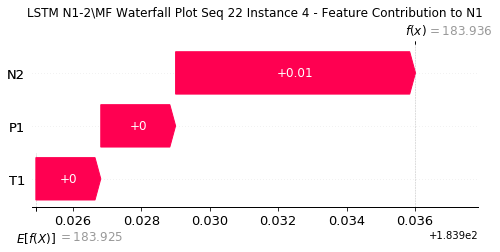

None

Contribution: [0.00193816 0.0016847  0.0061971 ]


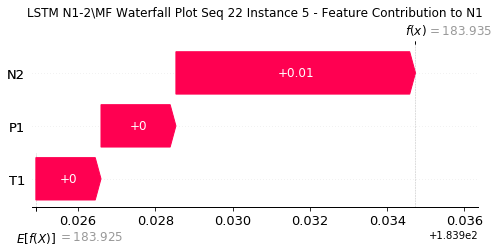

None

Contribution: [0.00170716 0.0015319  0.00539466]


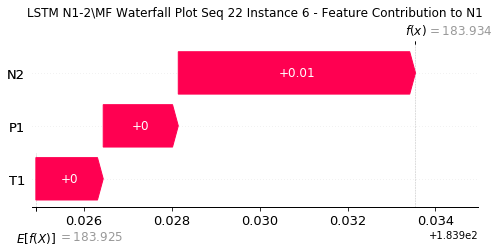

None

Contribution: [0.00163732 0.00146153 0.00522859]


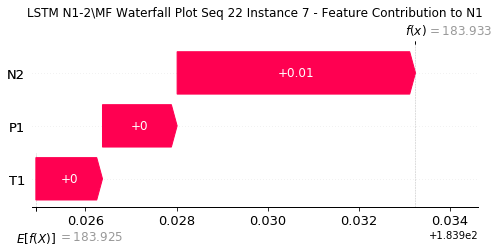

None

Contribution: [0.00165866 0.00156361 0.00524661]


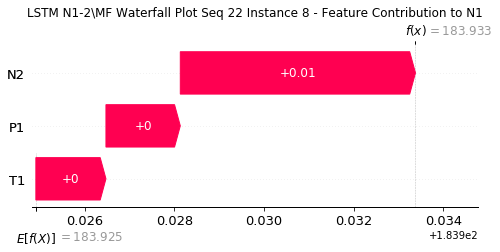

None

Contribution: [0.0016765  0.00151929 0.00526633]


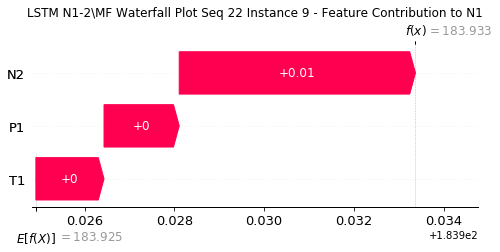

None

Contribution: [0.00165942 0.00153253 0.00531856]


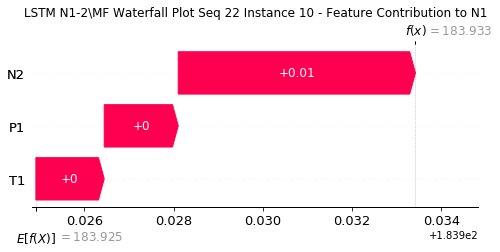

None

Contribution: [0.00170178 0.00152678 0.00545552]


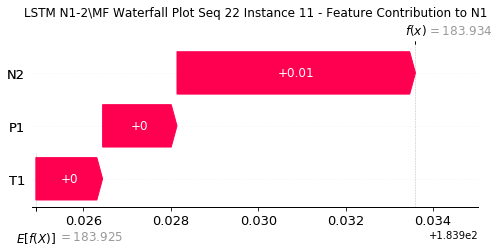

None

Contribution: [0.00178013 0.0016006  0.00568285]


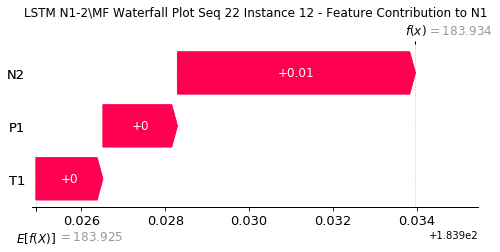

None

Contribution: [0.00193944 0.00169584 0.00607244]


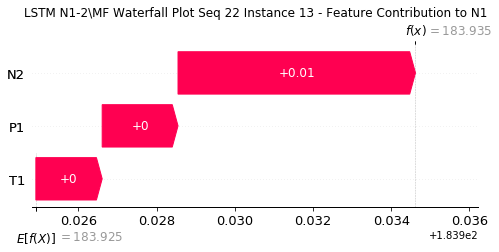

None

Contribution: [0.00205977 0.00184091 0.00657703]


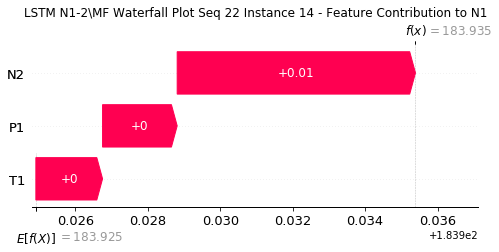

None

Contribution: [0.00231224 0.00206035 0.00738968]


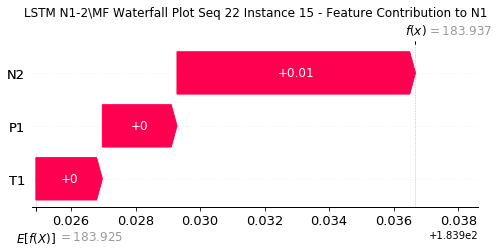

None

Contribution: [0.00273362 0.00243734 0.00865554]


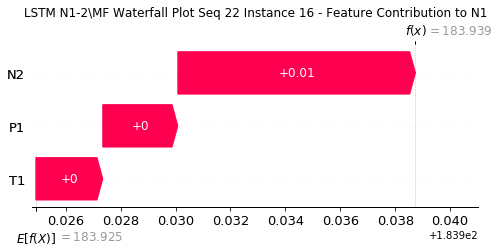

None

Contribution: [0.00335806 0.0029653  0.01061383]


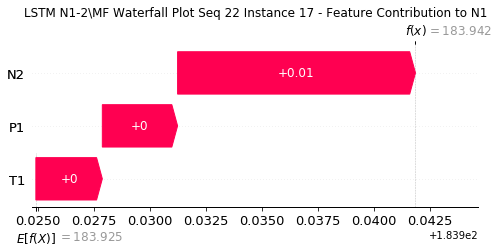

None

Contribution: [0.00444427 0.00386918 0.01375263]


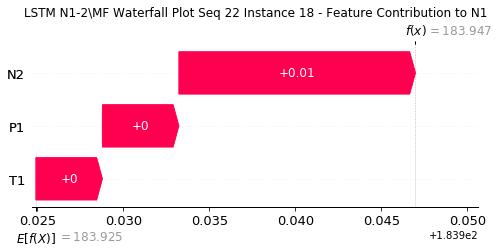

None

Contribution: [0.00601637 0.00529269 0.01892749]


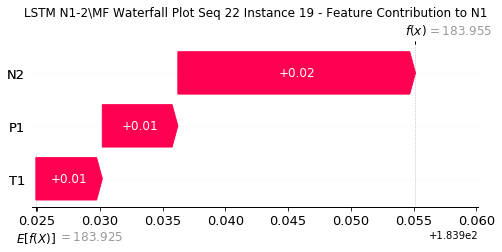

None

Contribution: [0.00873426 0.00769655 0.02753778]


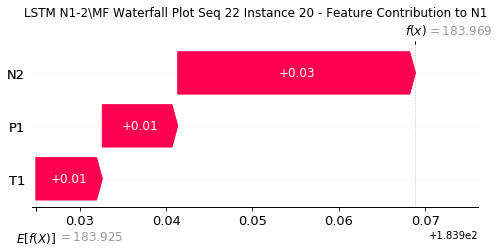

None

Contribution: [0.01319296 0.01164412 0.0418344 ]


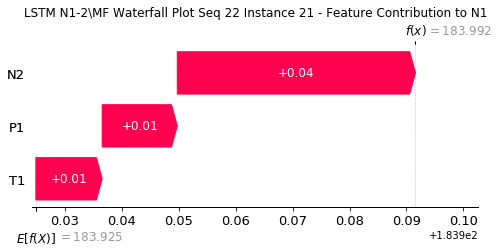

None

Contribution: [0.02047536 0.01796966 0.06504477]


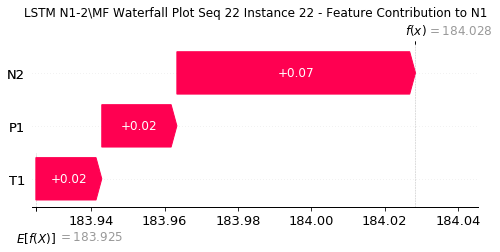

None

Contribution: [0.03053565 0.02470374 0.09846181]


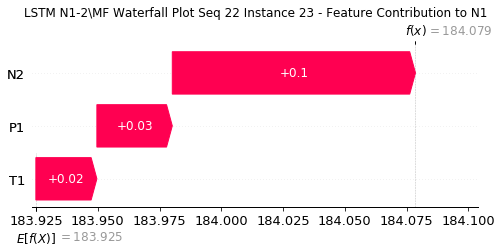

None

Contribution: [0.03994789 0.00401585 0.14343124]


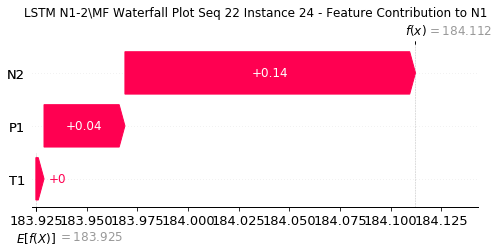

None

Contribution: [ 0.62543837 -0.16776793  1.95688232]


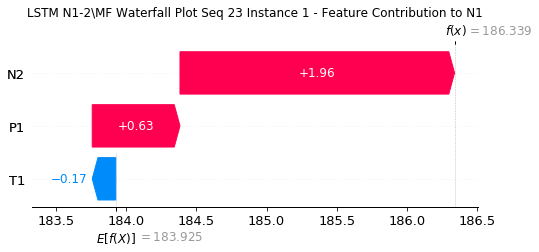

None

Contribution: [0.04592362 0.0045042  0.13585868]


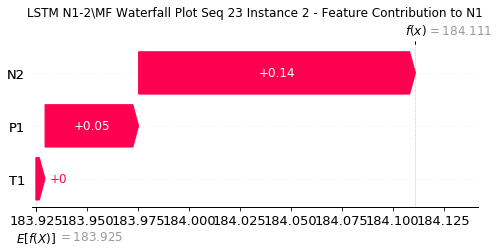

None

Contribution: [ 0.00410261 -0.00158849  0.01195077]


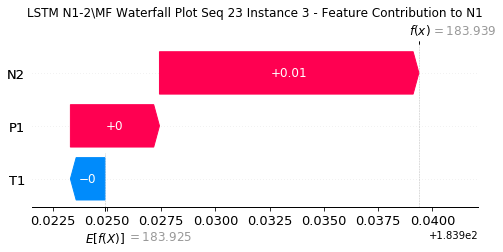

None

Contribution: [0.00222794 0.00199523 0.00713857]


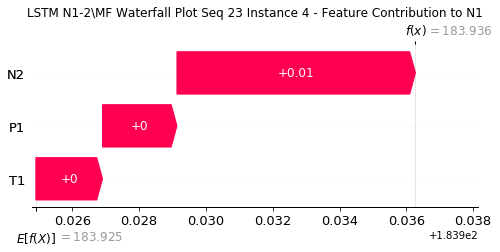

None

Contribution: [0.00194846 0.00174019 0.0062263 ]


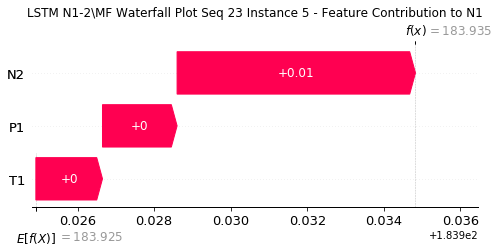

None

Contribution: [0.00172702 0.00154375 0.00540088]


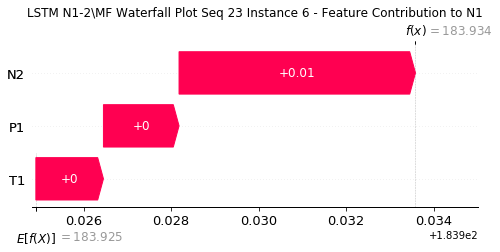

None

Contribution: [0.00163789 0.00148365 0.00521936]


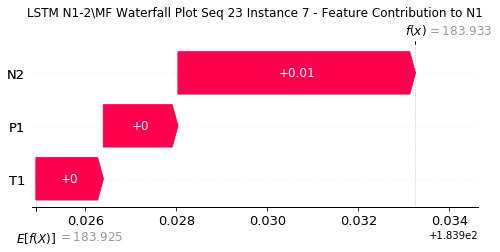

None

Contribution: [0.00165981 0.00146816 0.00520938]


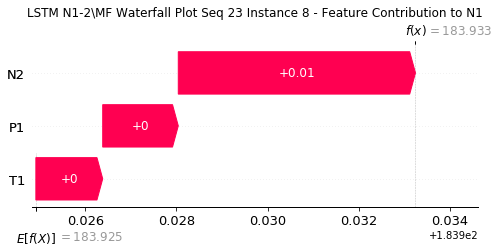

None

Contribution: [0.00165988 0.00153249 0.0052394 ]


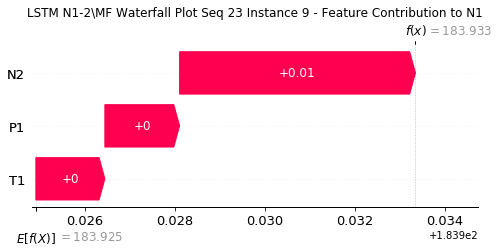

None

Contribution: [0.0016746  0.00151633 0.00530151]


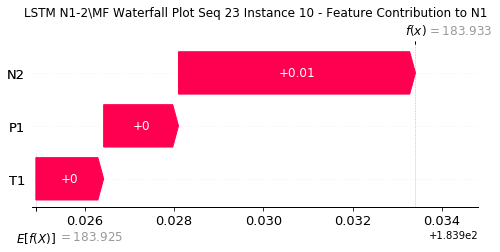

None

Contribution: [0.00170999 0.00154343 0.00543757]


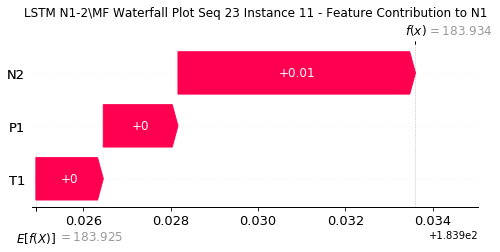

None

Contribution: [0.00178267 0.00159837 0.0056557 ]


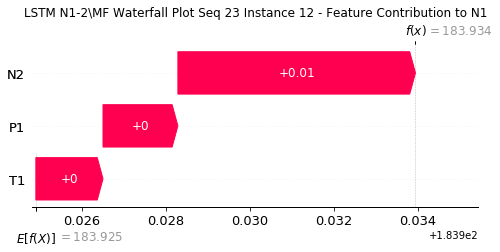

None

Contribution: [0.00191015 0.00170078 0.00600755]


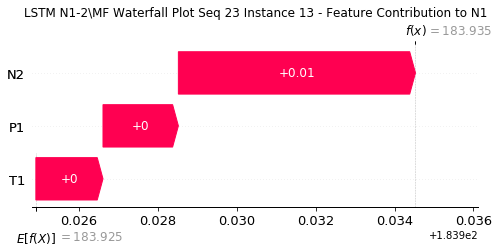

None

Contribution: [0.00206355 0.00183423 0.00653453]


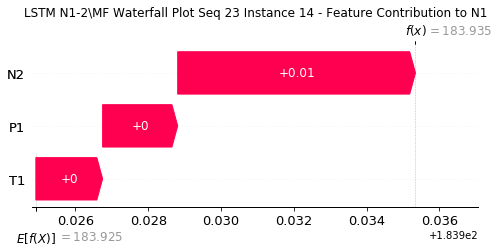

None

Contribution: [0.00232388 0.00200929 0.00731105]


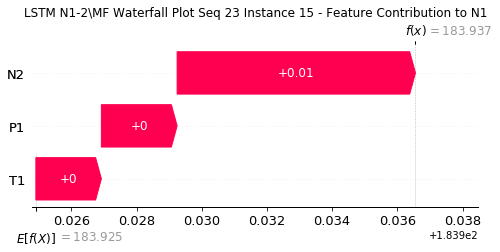

None

Contribution: [0.00272078 0.00238154 0.00857057]


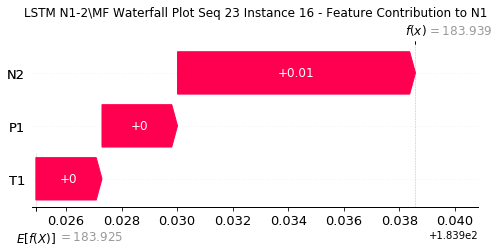

None

Contribution: [0.00333123 0.00289787 0.01049459]


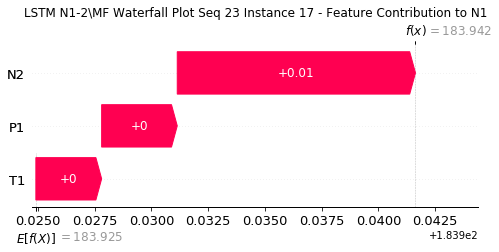

None

Contribution: [0.00429211 0.00370287 0.01356578]


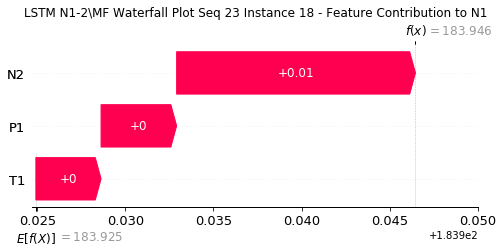

None

Contribution: [0.00596001 0.00510477 0.01867765]


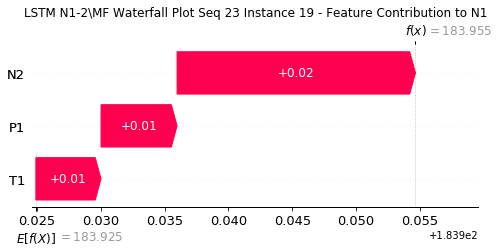

None

Contribution: [0.00866983 0.00746105 0.0271786 ]


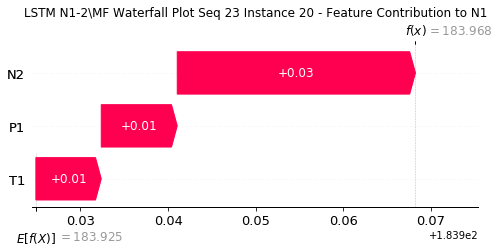

None

Contribution: [0.01317534 0.01138869 0.04134104]


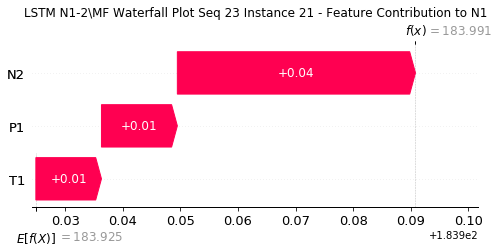

None

Contribution: [0.02048732 0.01769882 0.06438521]


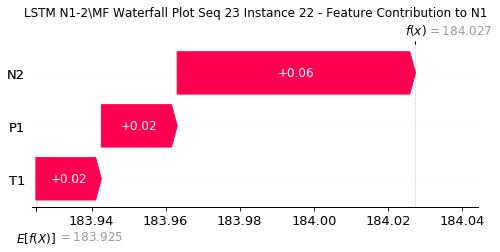

None

Contribution: [0.0314278  0.02504875 0.09787324]


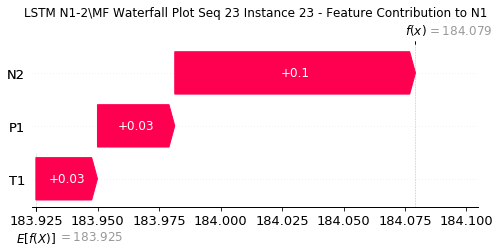

None

Contribution: [0.05051542 0.00959901 0.14468199]


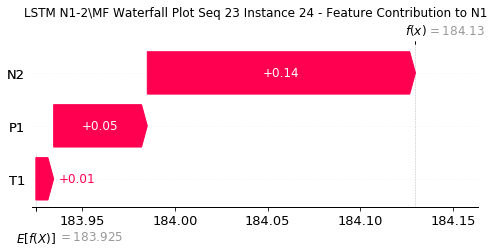

None

Contribution: [ 0.64584134 -0.20436169  1.95072499]


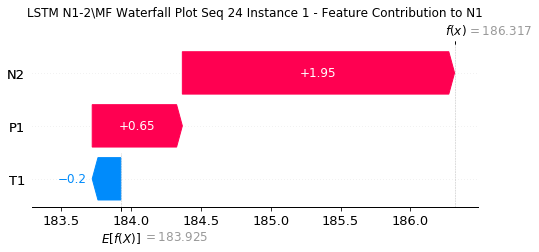

None

Contribution: [0.04826609 0.00313073 0.13578622]


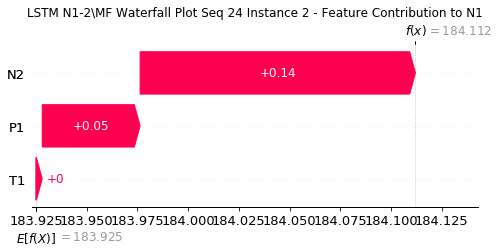

None

Contribution: [ 0.00391367 -0.00193892  0.01190091]


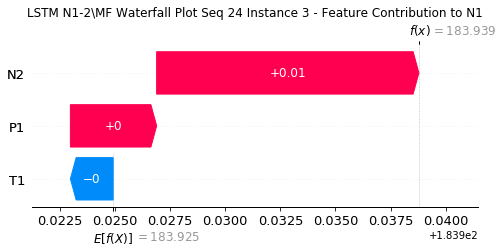

None

Contribution: [0.00222944 0.00188698 0.00711804]


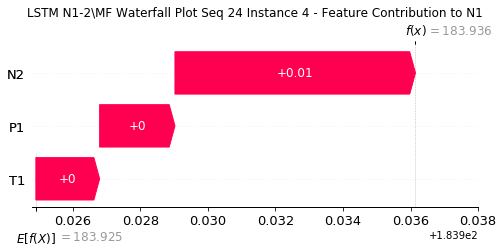

None

Contribution: [0.00195017 0.00167072 0.00621368]


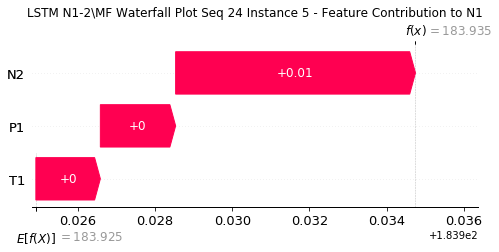

None

Contribution: [0.00170444 0.00145948 0.00537952]


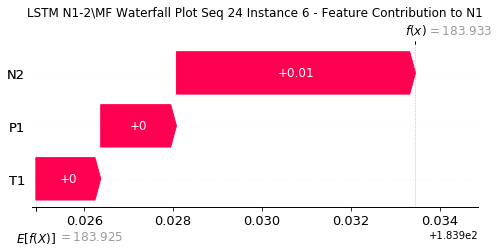

None

Contribution: [0.00163635 0.00143204 0.00520848]


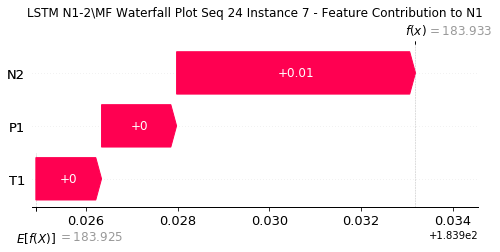

None

Contribution: [0.00163918 0.00139007 0.00519044]


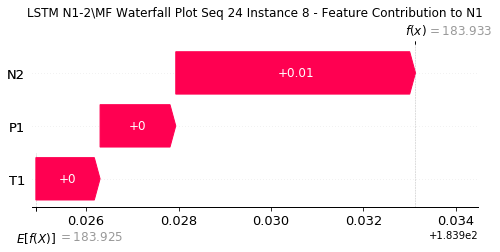

None

Contribution: [0.00163417 0.00141441 0.00521249]


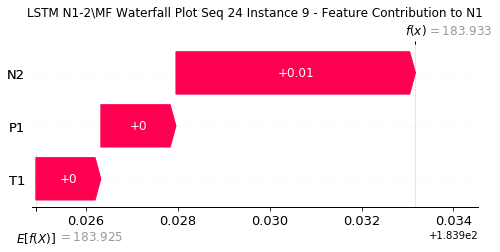

None

Contribution: [0.00166852 0.00142756 0.00527577]


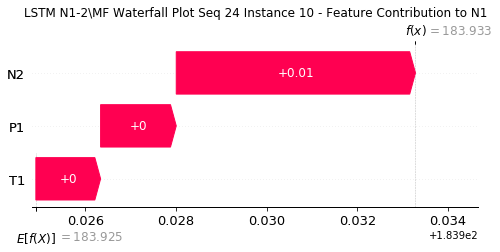

None

Contribution: [0.00171781 0.00153705 0.00543504]


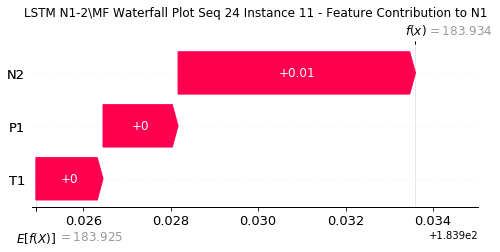

None

Contribution: [0.00178877 0.00160294 0.00565507]


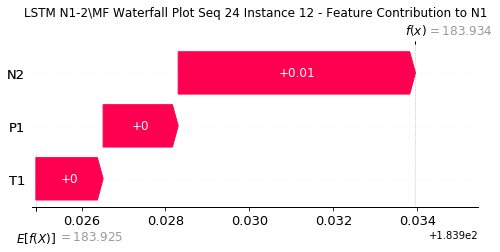

None

Contribution: [0.00190311 0.0017349  0.00600128]


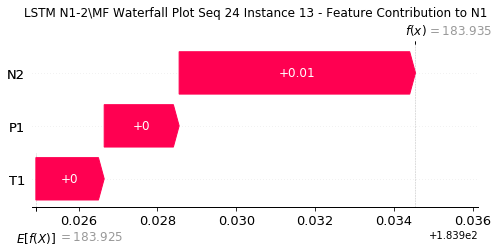

None

Contribution: [0.00207894 0.00186516 0.00653845]


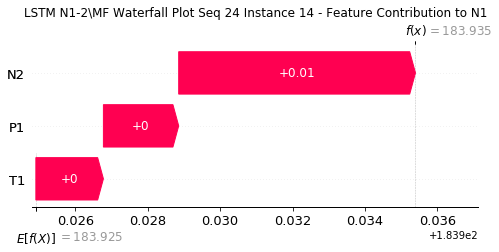

None

Contribution: [0.00232434 0.00212209 0.007361  ]


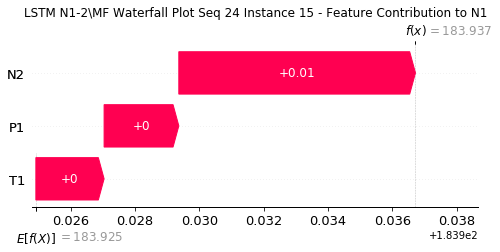

None

Contribution: [0.00273343 0.00246463 0.00857216]


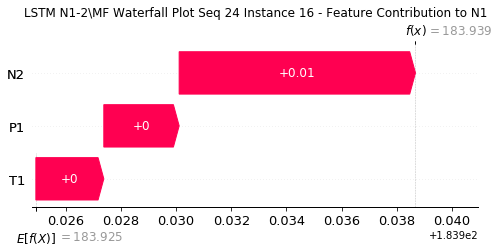

None

Contribution: [0.00333614 0.00301977 0.01048488]


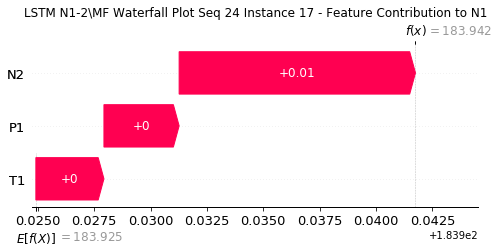

None

Contribution: [0.0043559  0.00400835 0.0135582 ]


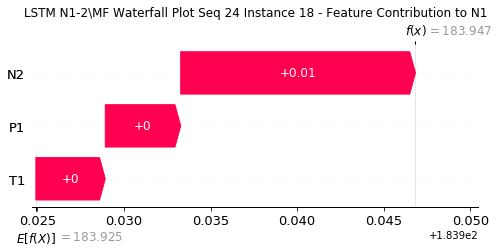

None

Contribution: [0.00597762 0.005384   0.01866594]


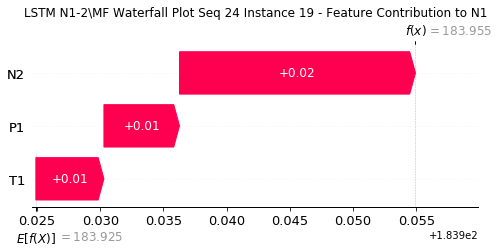

None

Contribution: [0.0086834  0.00788591 0.02714858]


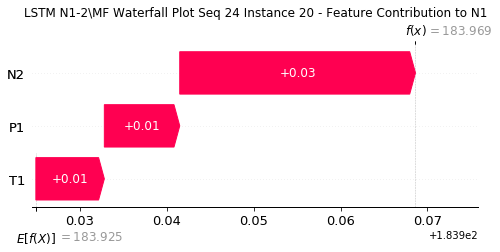

None

Contribution: [0.01325793 0.01207151 0.04131606]


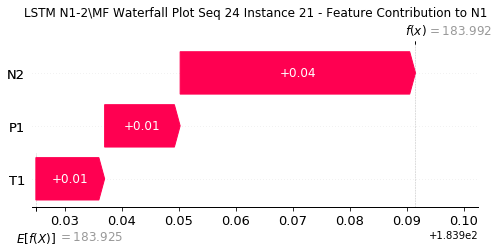

None

Contribution: [0.02061481 0.01896271 0.0643257 ]


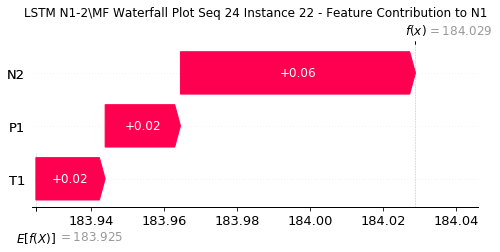

None

Contribution: [0.03171366 0.02739456 0.09788614]


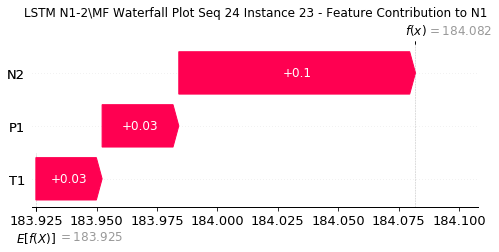

None

Contribution: [0.04303881 0.01201196 0.14328114]


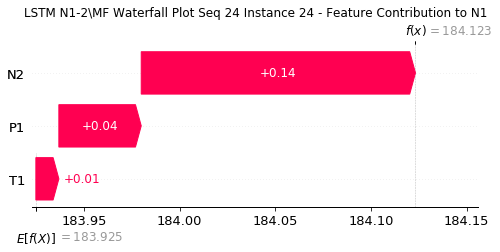

None

Contribution: [ 0.52448206 -0.02142061  1.89521114]


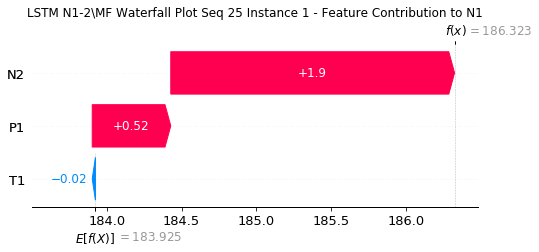

None

Contribution: [0.04526637 0.01249909 0.1346705 ]


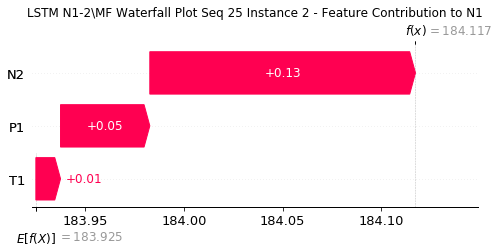

None

Contribution: [ 0.00379721 -0.00081065  0.01191519]


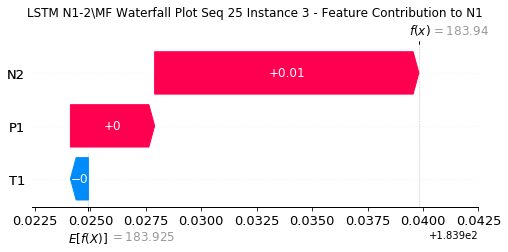

None

Contribution: [0.00224349 0.00203592 0.00714288]


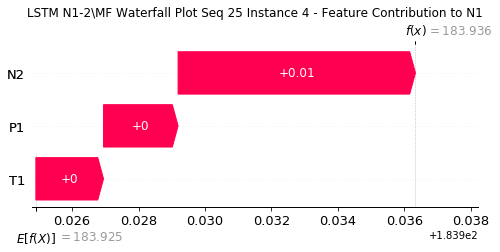

None

Contribution: [0.00195318 0.00177017 0.00621576]


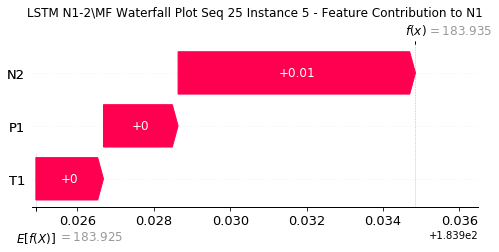

None

Contribution: [0.00162318 0.0015002  0.00534247]


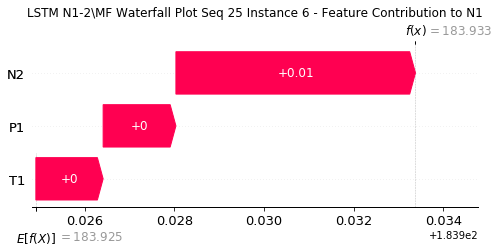

None

Contribution: [0.00163605 0.00151616 0.00520877]


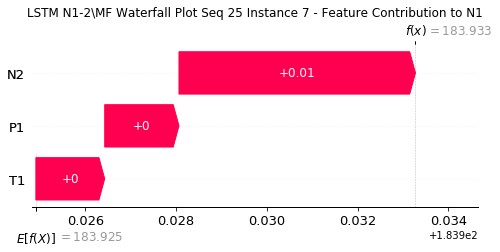

None

Contribution: [0.00162608 0.00149574 0.00518682]


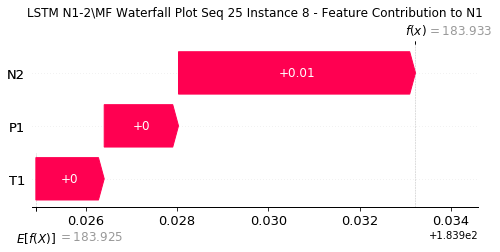

None

Contribution: [0.0016322  0.00151162 0.00521293]


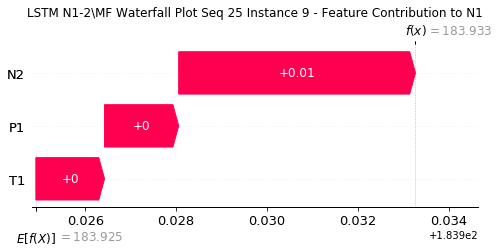

None

Contribution: [0.00166964 0.00153024 0.00527445]


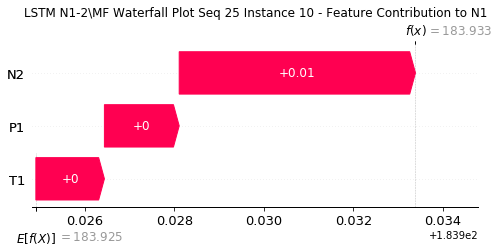

None

Contribution: [0.00168642 0.00155848 0.00540929]


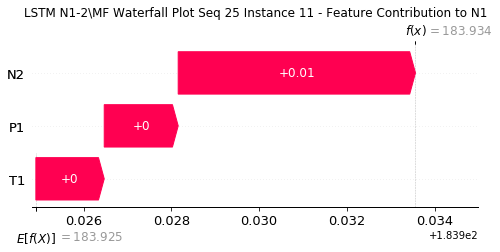

None

Contribution: [0.00175549 0.00162771 0.00562816]


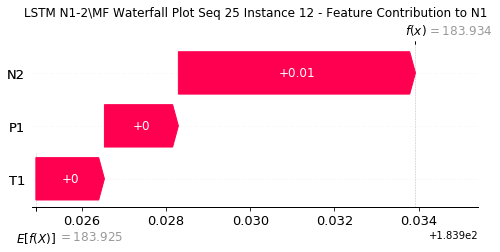

None

Contribution: [0.0018369  0.00171205 0.00596748]


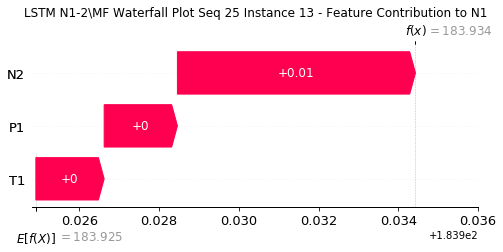

None

Contribution: [0.0020326  0.00188447 0.00650415]


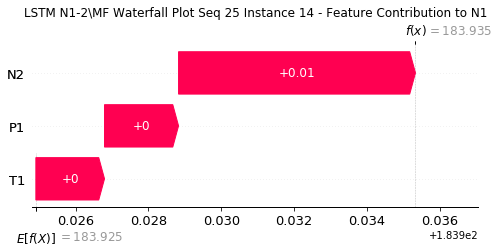

None

Contribution: [0.00234224 0.00213037 0.007321  ]


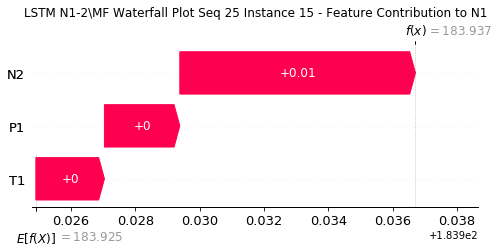

None

Contribution: [0.00266926 0.00248041 0.00852642]


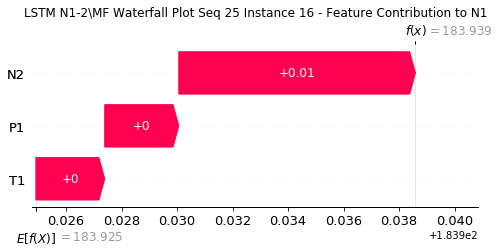

None

Contribution: [0.00328623 0.00305298 0.01044506]


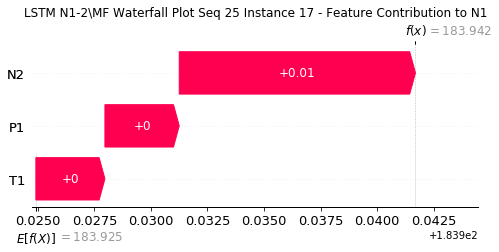

None

Contribution: [0.00433668 0.00410749 0.0135535 ]


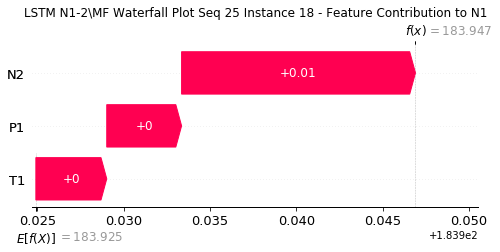

None

Contribution: [0.00590828 0.00553959 0.01862014]


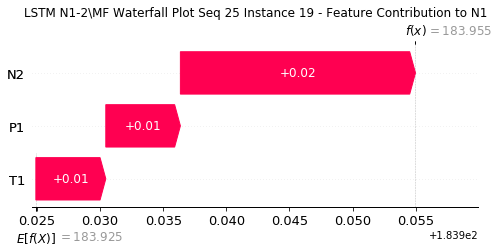

None

Contribution: [0.00861386 0.00811313 0.02709858]


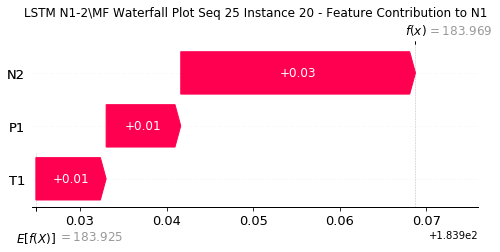

None

Contribution: [0.01313624 0.01245111 0.04125101]


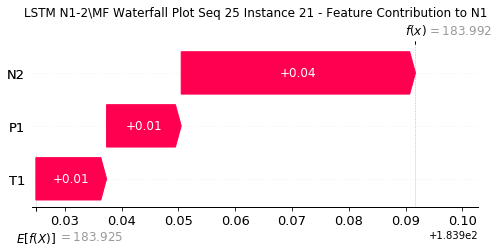

None

Contribution: [0.02043337 0.01939833 0.06424634]


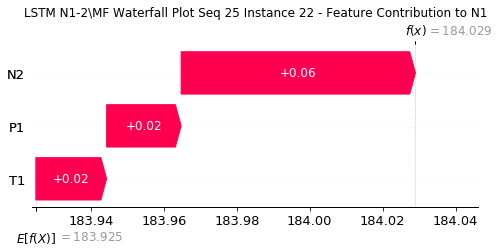

None

Contribution: [0.03135934 0.02917578 0.0978496 ]


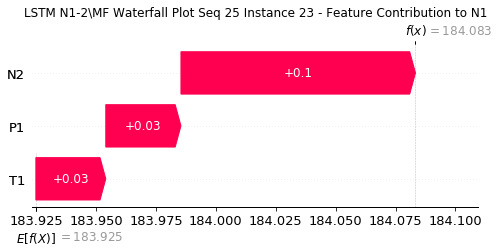

None

Contribution: [0.04715329 0.02617289 0.14488393]


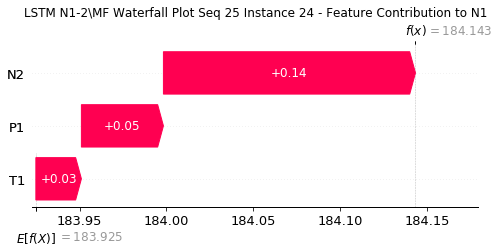

None

Contribution: [0.63611036 0.13569765 1.93481239]


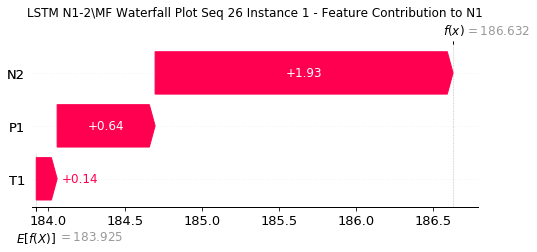

None

Contribution: [0.04629833 0.01984475 0.13314927]


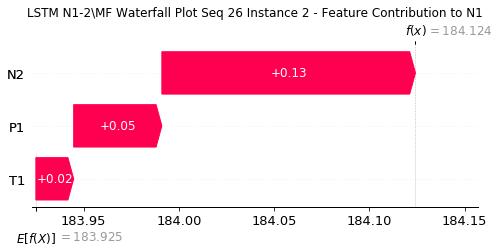

None

Contribution: [ 3.93020439e-03 -2.85745342e-06  1.18798095e-02]


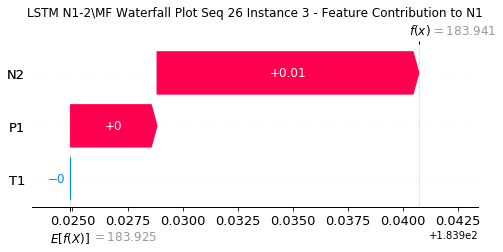

None

Contribution: [0.00220463 0.00212769 0.0071959 ]


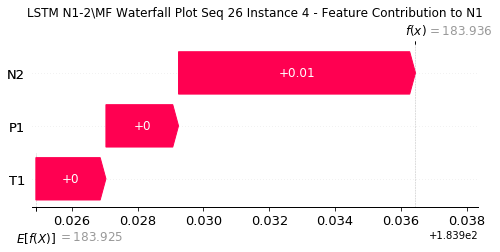

None

Contribution: [0.00191356 0.00182265 0.00619667]


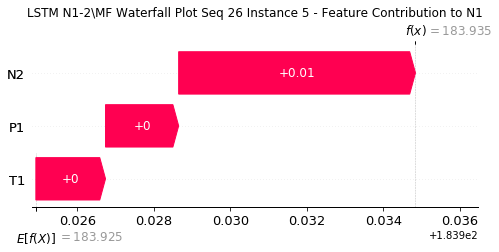

None

Contribution: [0.00167348 0.00160852 0.00535257]


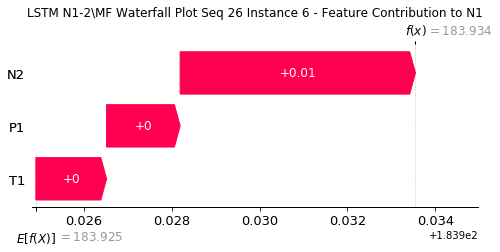

None

Contribution: [0.00160156 0.00154244 0.00516626]


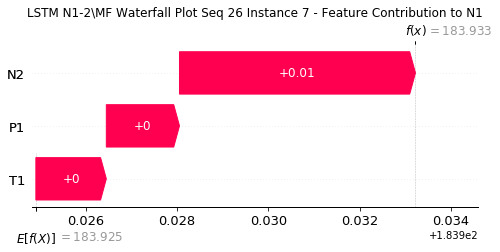

None

Contribution: [0.00161939 0.0015176  0.00515801]


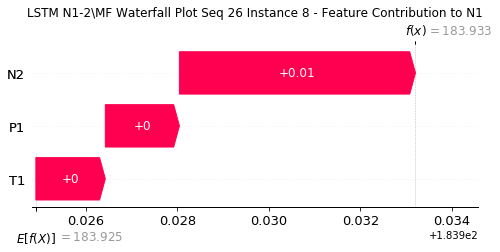

None

Contribution: [0.0016819  0.00152686 0.00520519]


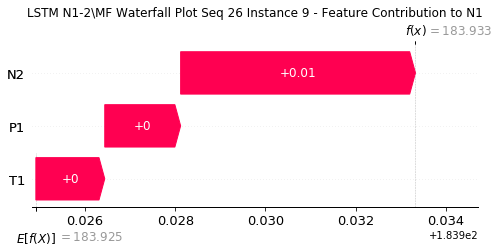

None

Contribution: [0.00166957 0.00155471 0.0052476 ]


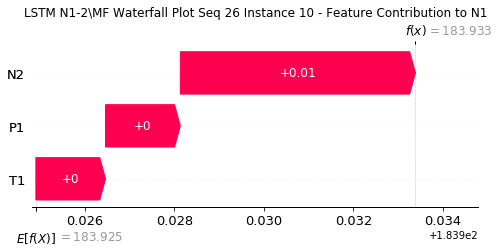

None

Contribution: [0.0016742  0.00158063 0.00537311]


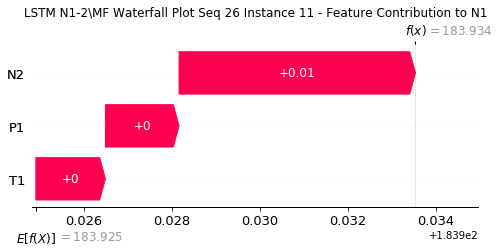

None

Contribution: [0.00174025 0.00164216 0.00558857]


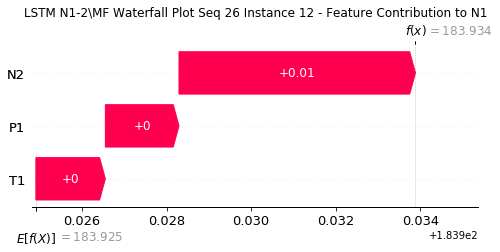

None

Contribution: [0.00188913 0.00181112 0.00595285]


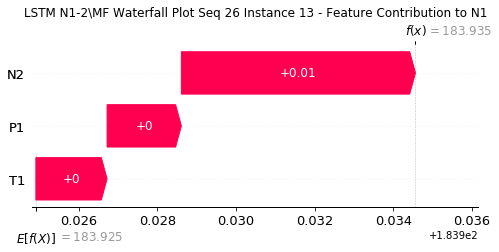

None

Contribution: [0.00202115 0.00189133 0.00645174]


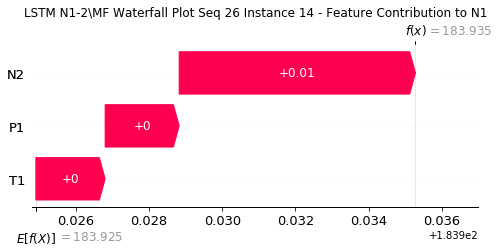

None

Contribution: [0.00228893 0.002149   0.00723608]


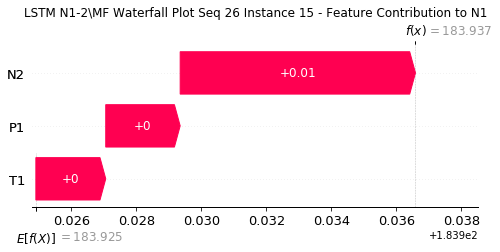

None

Contribution: [0.00266088 0.00246132 0.00844154]


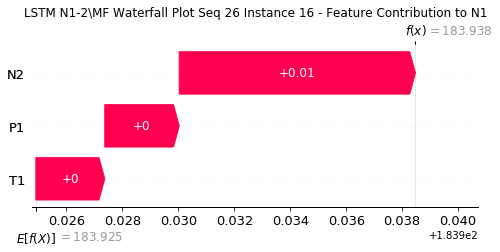

None

Contribution: [0.0032633  0.00298809 0.01031801]


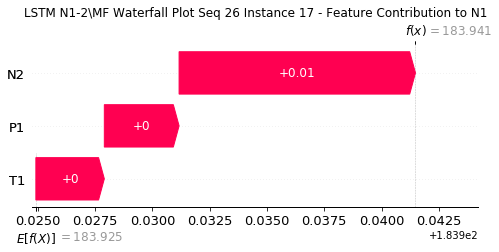

None

Contribution: [0.00423317 0.00390429 0.01333326]


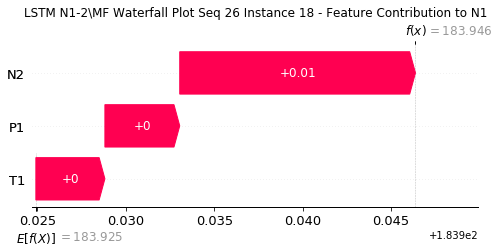

None

Contribution: [0.00581801 0.00531819 0.01833833]


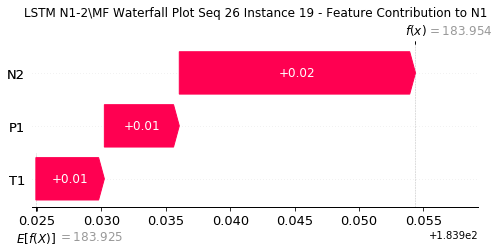

None

Contribution: [0.00847993 0.00774323 0.02668649]


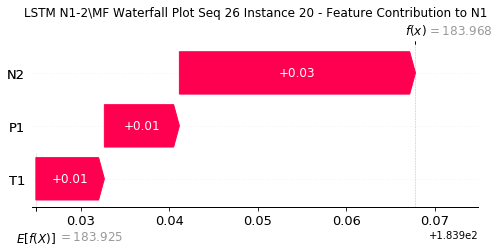

None

Contribution: [0.01292727 0.01184485 0.04066443]


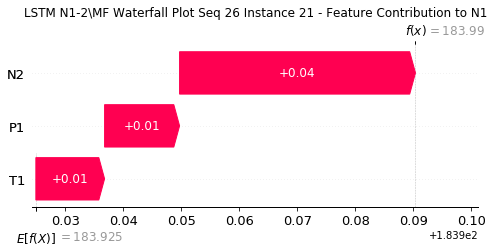

None

Contribution: [0.02028028 0.01846378 0.06349616]


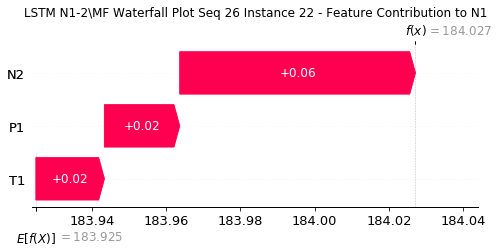

None

Contribution: [0.03139887 0.02781623 0.09697986]


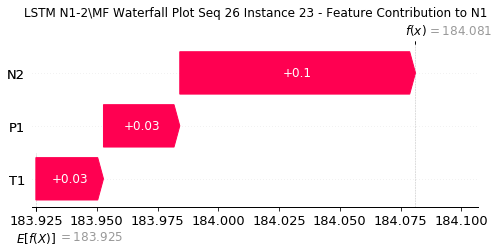

None

Contribution: [0.0470704  0.02186724 0.14393466]


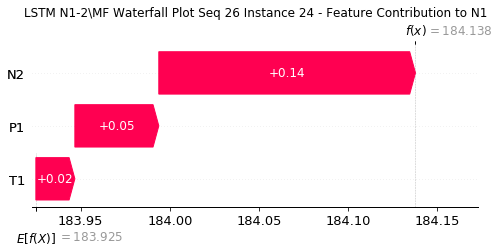

None

Contribution: [ 0.55947905 -0.12911403  1.91917508]


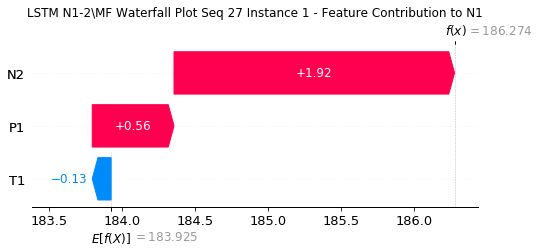

None

Contribution: [0.04416645 0.01108275 0.13552247]


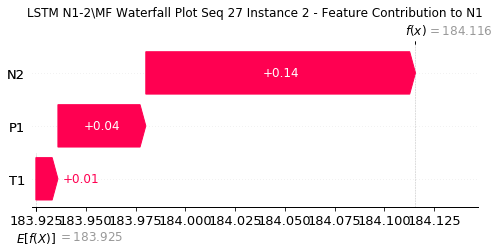

None

Contribution: [ 0.00375145 -0.00026964  0.01198944]


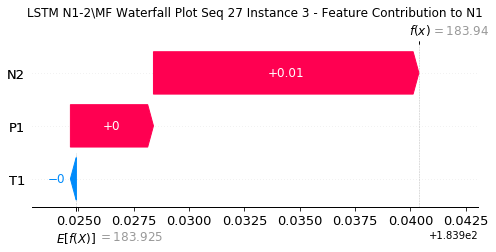

None

Contribution: [0.00222335 0.00207838 0.00713104]


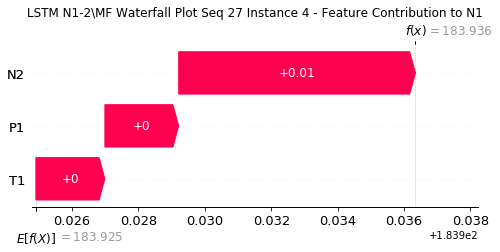

None

Contribution: [0.00194615 0.00181454 0.00622512]


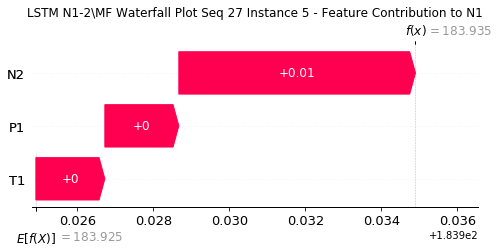

None

Contribution: [0.00167544 0.0015786  0.00538334]


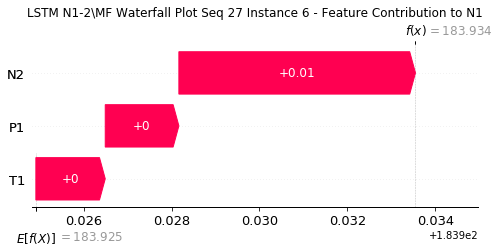

None

Contribution: [0.00162639 0.00154249 0.00521561]


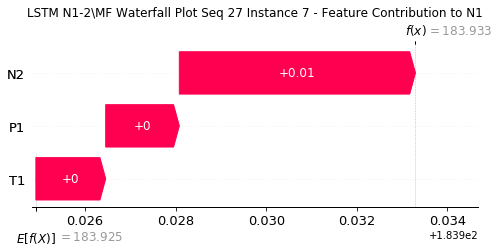

None

Contribution: [0.00161094 0.00149403 0.00518261]


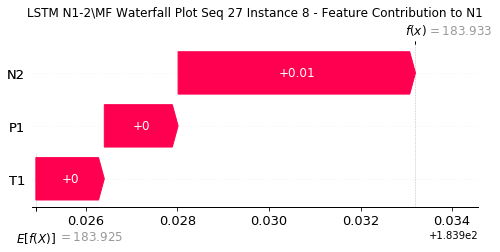

None

Contribution: [0.00158262 0.00136722 0.00517396]


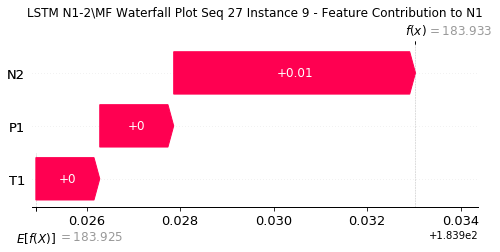

None

Contribution: [0.00162143 0.00152186 0.00526583]


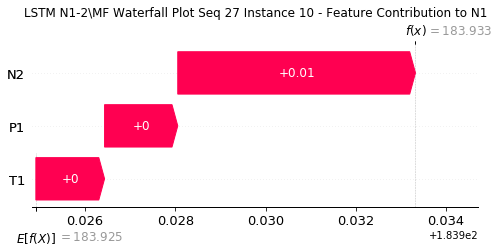

None

Contribution: [0.00170601 0.00161753 0.00543313]


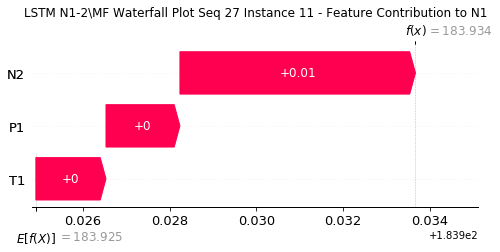

None

Contribution: [0.00177726 0.00168303 0.00565229]


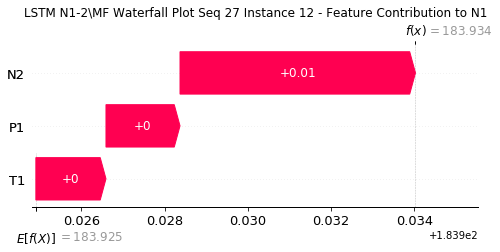

None

Contribution: [0.00186853 0.00179818 0.00598739]


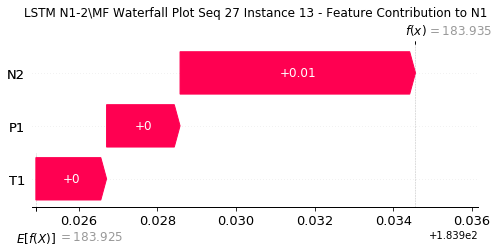

None

Contribution: [0.00204667 0.00194391 0.00652757]


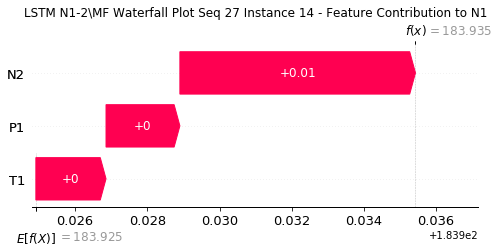

None

Contribution: [0.00231044 0.00217155 0.00731816]


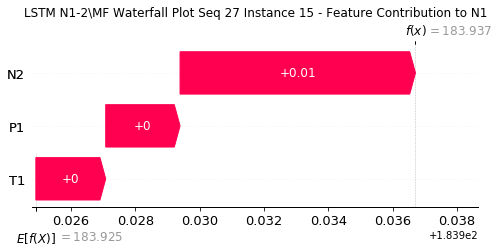

None

Contribution: [0.00269076 0.00254392 0.00856005]


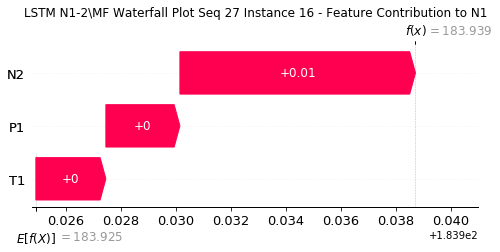

None

Contribution: [0.00329048 0.00309485 0.01047963]


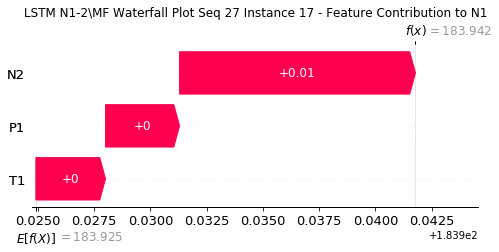

None

Contribution: [0.00433995 0.00414366 0.01361818]


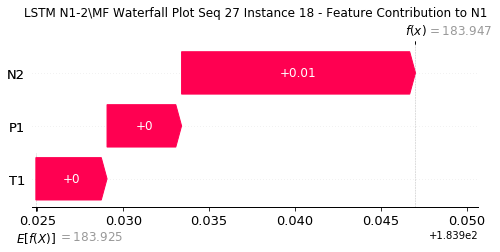

None

Contribution: [0.0058379  0.00551009 0.01865662]


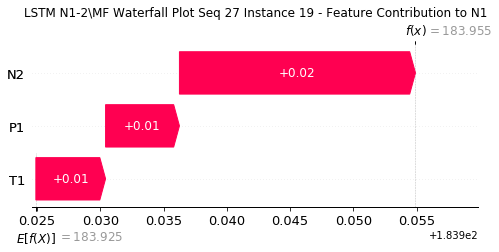

None

Contribution: [0.00848044 0.00802772 0.02713888]


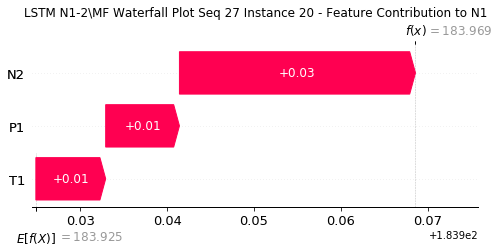

None

Contribution: [0.01284071 0.01226932 0.04126711]


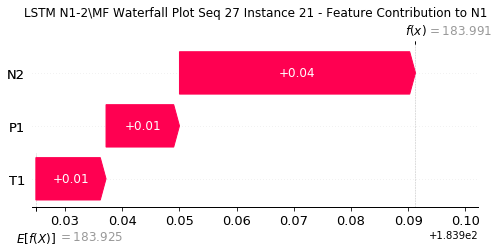

None

Contribution: [0.01994343 0.01911904 0.06422536]


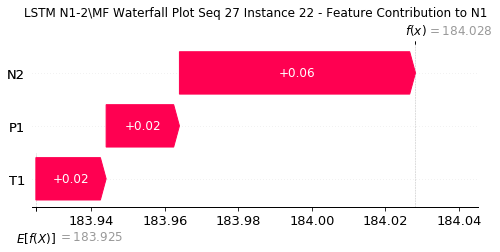

None

Contribution: [0.02963904 0.02818891 0.09738805]


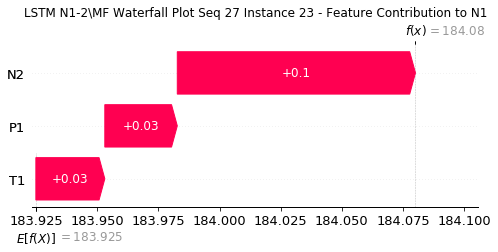

None

Contribution: [0.04759472 0.02242295 0.1435186 ]


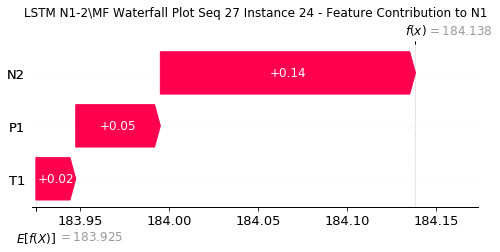

None

Contribution: [0.71369863 0.04005975 1.93720197]


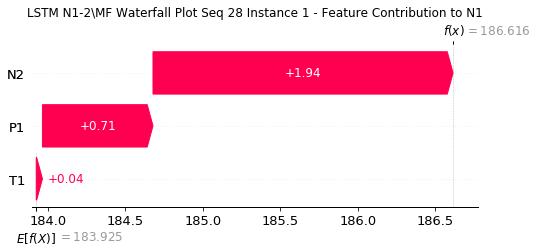

None

Contribution: [0.04985317 0.01820558 0.13386881]


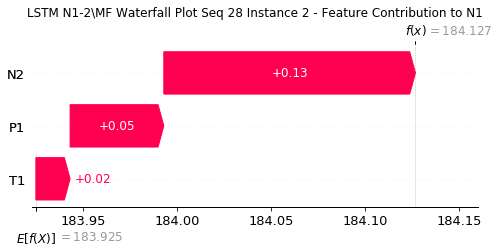

None

Contribution: [ 4.20497268e-03 -9.05777517e-06  1.20065367e-02]


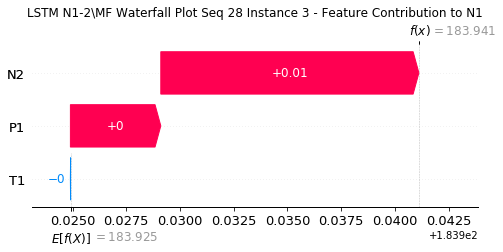

None

Contribution: [0.00230564 0.0023439  0.00731251]


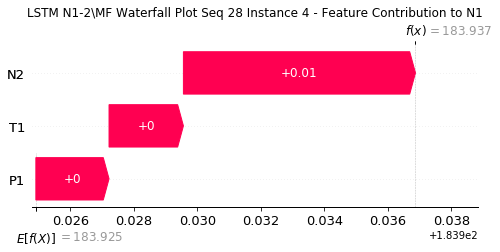

None

Contribution: [0.00197437 0.00196085 0.00628868]


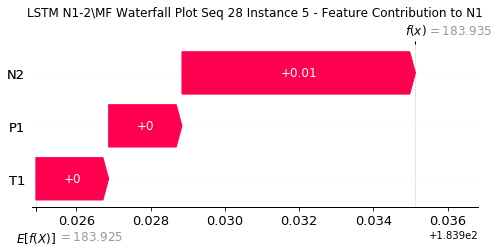

None

Contribution: [0.00176112 0.00177977 0.00545499]


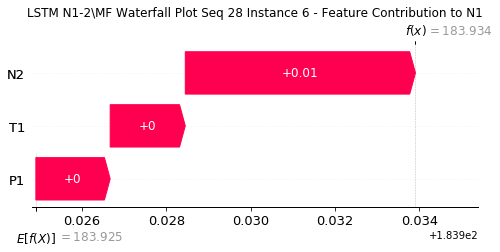

None

Contribution: [0.00165677 0.00159158 0.00523395]


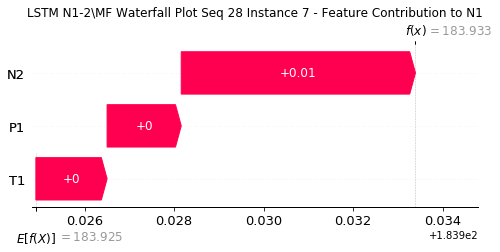

None

Contribution: [0.00165677 0.0015198  0.00519872]


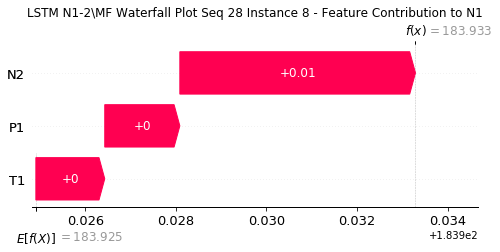

None

Contribution: [0.001658   0.0015056  0.00522513]


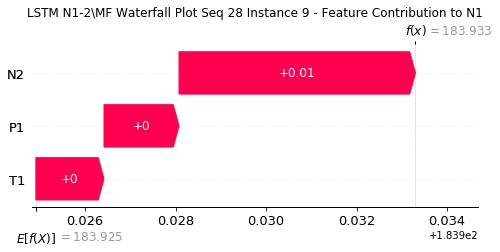

None

Contribution: [0.0016495  0.001496   0.00527077]


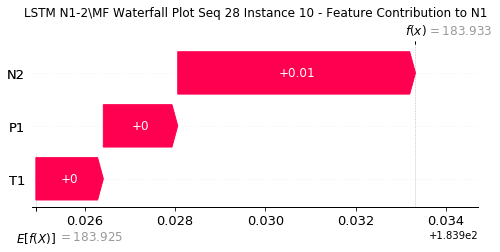

None

Contribution: [0.00173764 0.00161692 0.00544548]


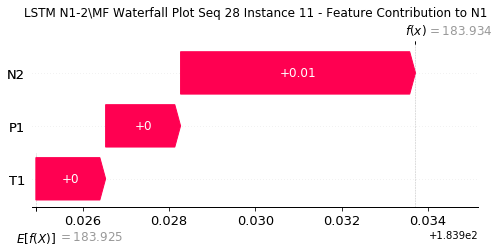

None

Contribution: [0.00182351 0.00164309 0.00566187]


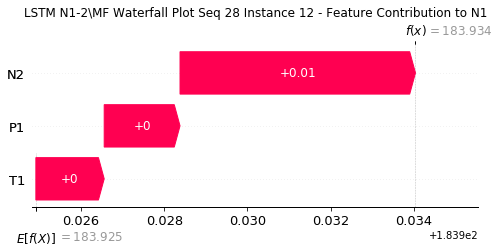

None

Contribution: [0.00183683 0.00173234 0.00597604]


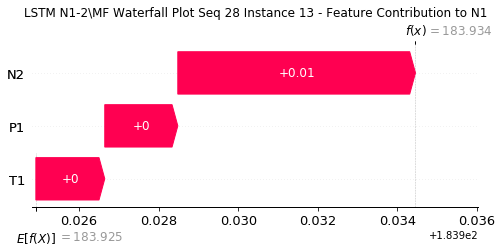

None

Contribution: [0.00214377 0.00176996 0.00653671]


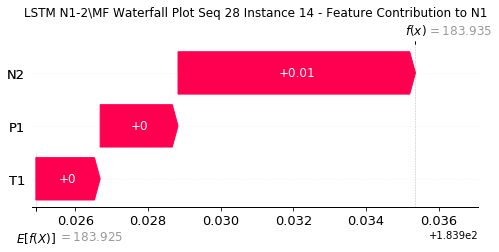

None

Contribution: [0.00230736 0.00189057 0.00729891]


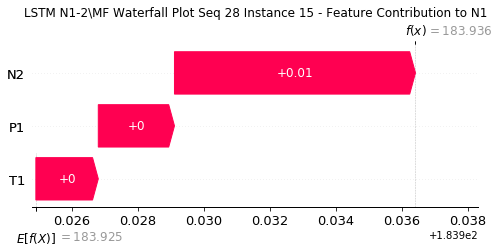

None

Contribution: [0.00284977 0.00213569 0.0085553 ]


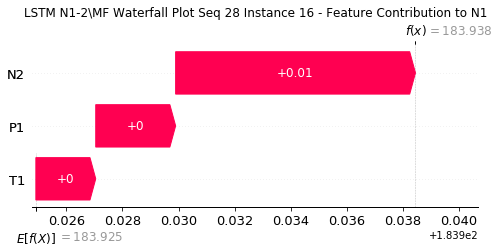

None

Contribution: [0.0034827  0.0024306  0.01045358]


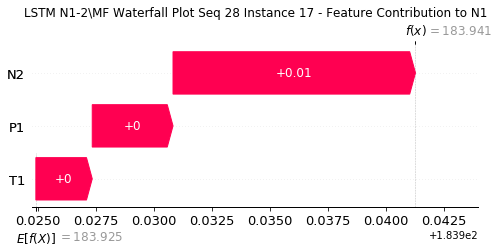

None

Contribution: [0.00414254 0.00364567 0.01346429]


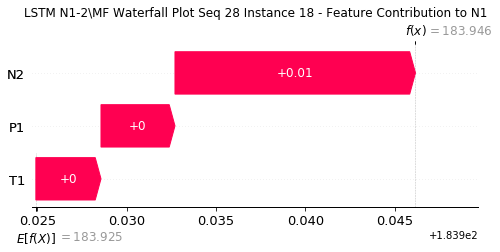

None

Contribution: [0.00648888 0.00371662 0.01864989]


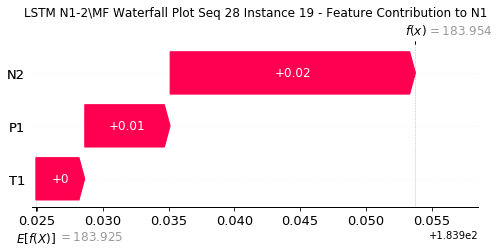

None

Contribution: [0.00946879 0.00516628 0.02713408]


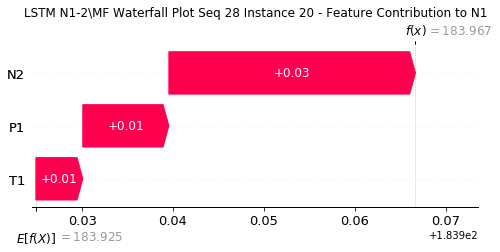

None

Contribution: [0.01468389 0.00746259 0.04136452]


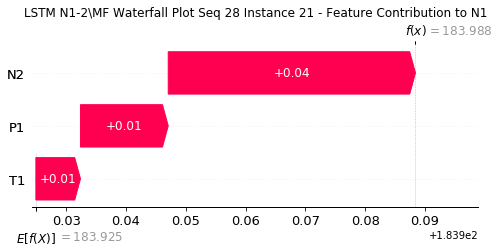

None

Contribution: [0.02264692 0.01105287 0.06438623]


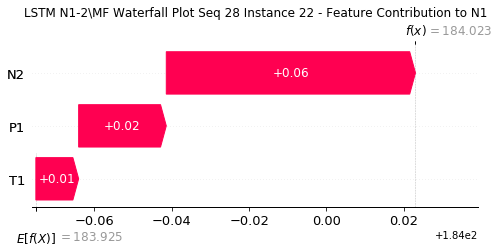

None

Contribution: [0.03725375 0.00956981 0.09852032]


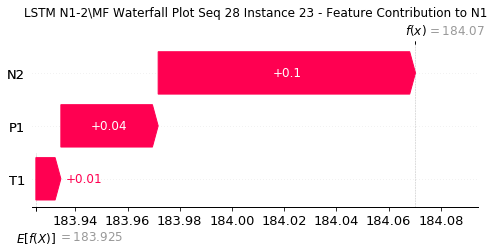

None

Contribution: [ 0.07172697 -0.04883121  0.1484817 ]


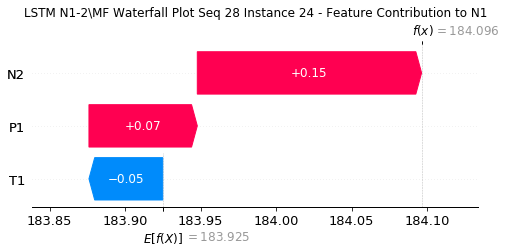

None

Contribution: [ 1.04797877 -1.57741824  2.05498537]


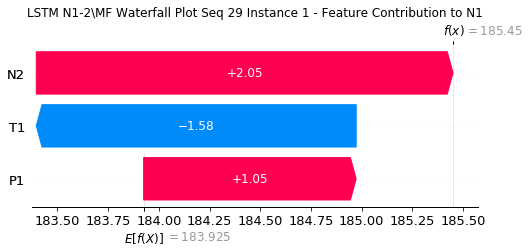

None

Contribution: [ 0.08132638 -0.06213851  0.14997955]


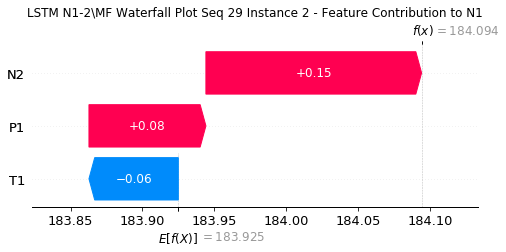

None

Contribution: [ 0.00666018 -0.00681613  0.01321306]


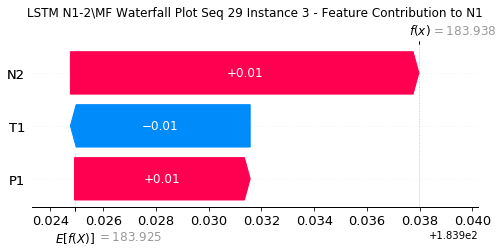

None

Contribution: [0.00249495 0.00086334 0.00692074]


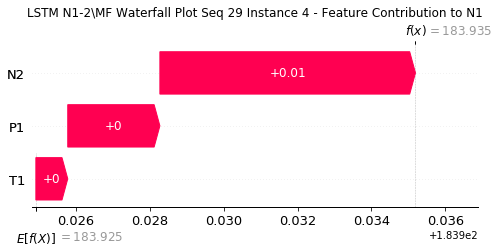

None

Contribution: [0.00225315 0.00090451 0.00628386]


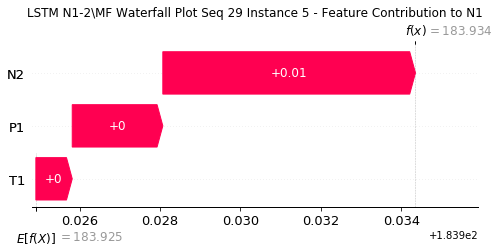

None

Contribution: [0.00180642 0.00080137 0.00546047]


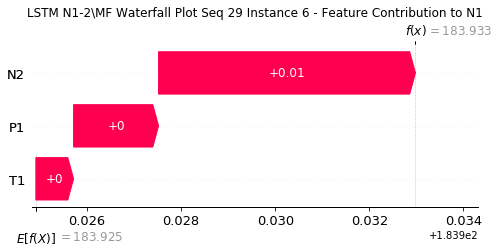

None

Contribution: [0.00191506 0.00083066 0.00538351]


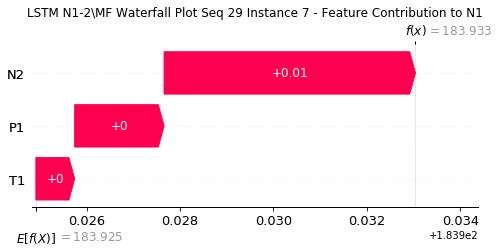

None

Contribution: [0.00190976 0.00076655 0.00536674]


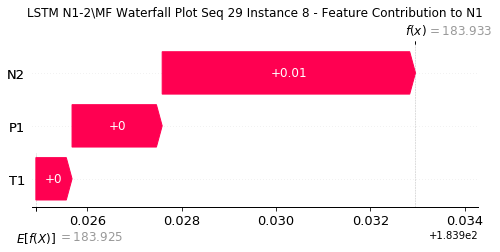

None

Contribution: [0.00202667 0.00082852 0.00544699]


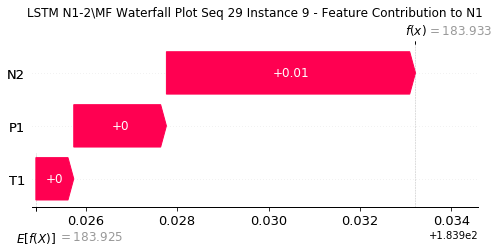

None

Contribution: [0.00204688 0.0008455  0.00549769]


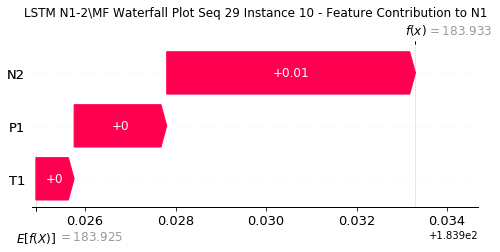

None

Contribution: [0.00201289 0.00093825 0.00563343]


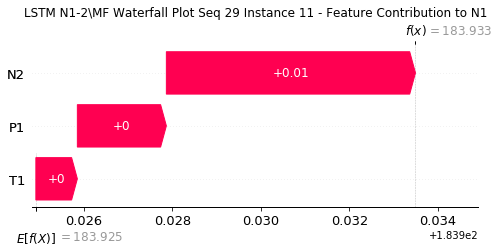

None

Contribution: [0.00206165 0.00101384 0.00586112]


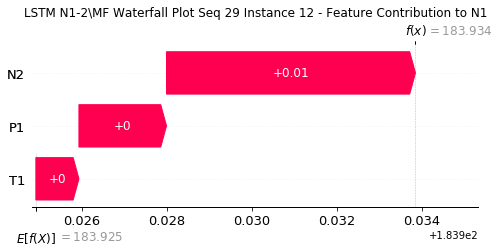

None

Contribution: [0.00224391 0.00099737 0.00624881]


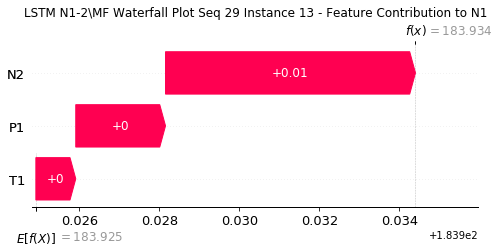

None

Contribution: [0.00236535 0.0012934  0.00680949]


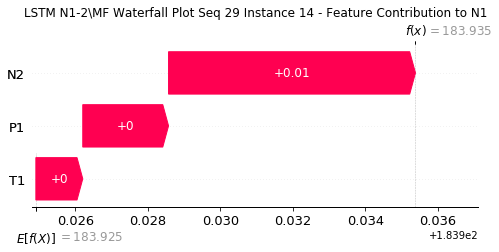

None

Contribution: [0.00251004 0.00185824 0.00764263]


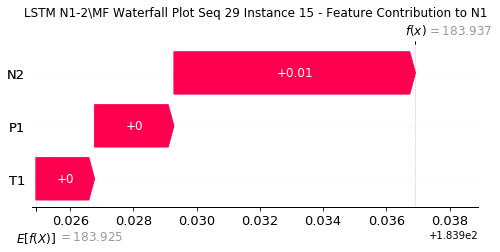

None

Contribution: [0.00302977 0.00193388 0.00898491]


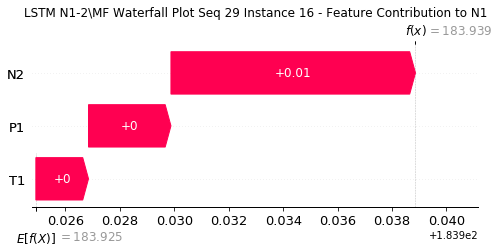

None

Contribution: [0.00365894 0.00255381 0.0110374 ]


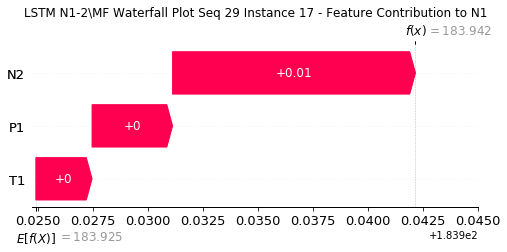

None

Contribution: [0.00431621 0.00380396 0.01424692]


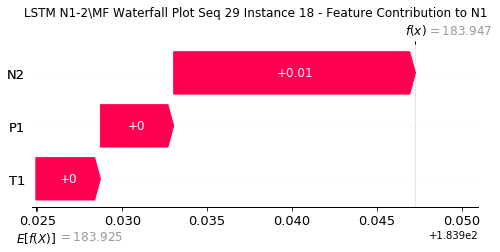

None

Contribution: [0.00621354 0.00505942 0.0196912 ]


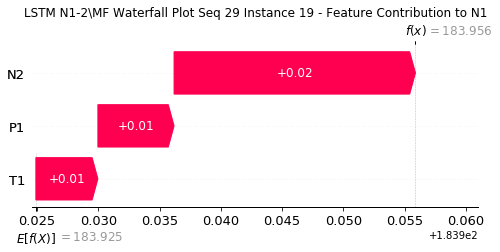

None

Contribution: [0.00899008 0.00754713 0.02859709]


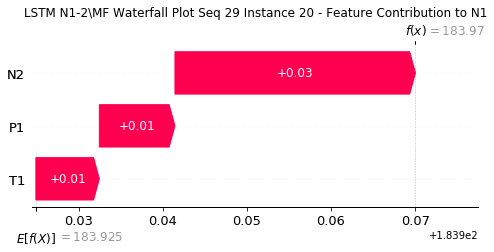

None

Contribution: [0.01359542 0.01151432 0.04329995]


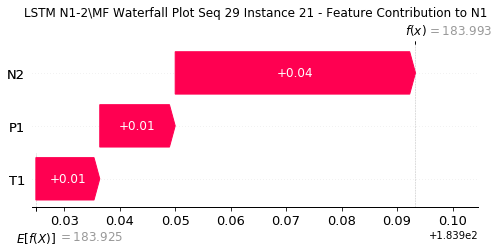

None

Contribution: [0.0211284  0.01809088 0.06687956]


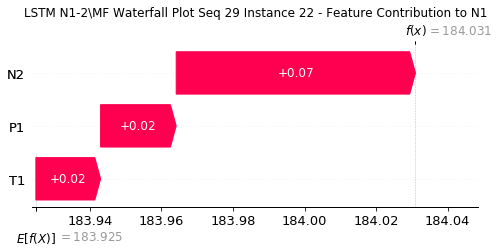

None

Contribution: [0.0305435  0.02458794 0.10064808]


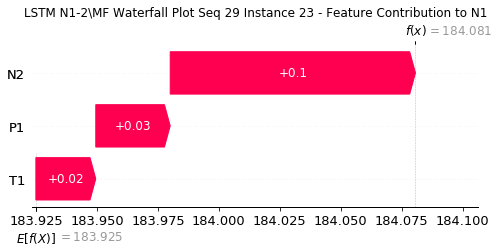

None

Contribution: [ 0.03414103 -0.01156785  0.14518682]


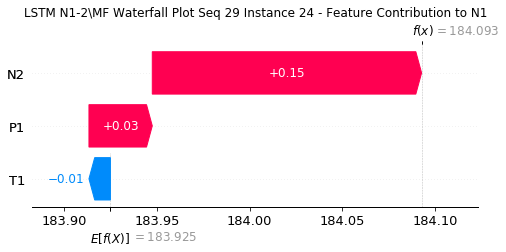

None

Contribution: [ 0.57675103 -0.05466065  1.95041269]


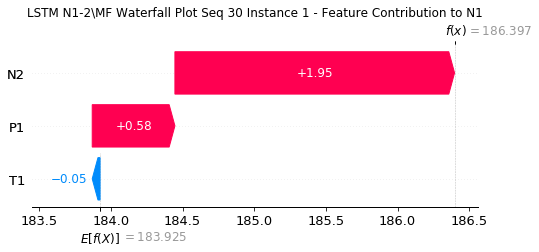

None

Contribution: [0.0474543  0.00480537 0.13617355]


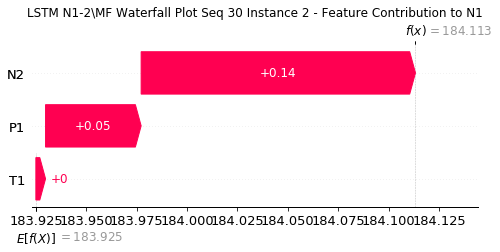

None

Contribution: [0.00411803 0.00020707 0.01200964]


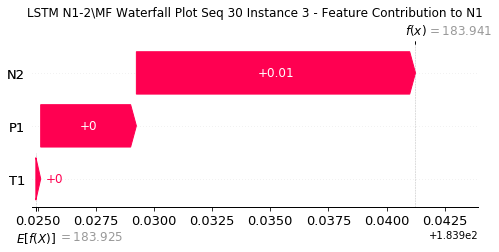

None

Contribution: [0.00221595 0.00218827 0.0071815 ]


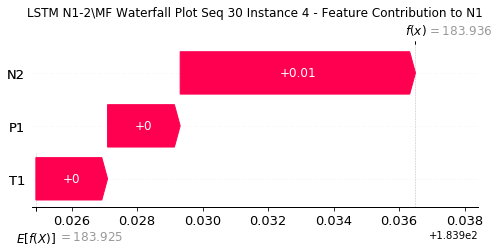

None

Contribution: [0.00192799 0.00185913 0.00622783]


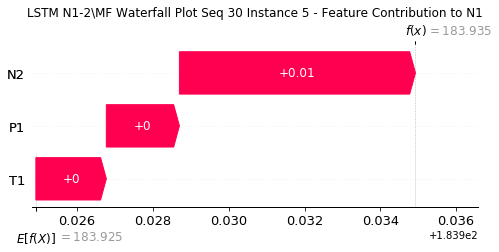

None

Contribution: [0.00169335 0.00157585 0.00538538]


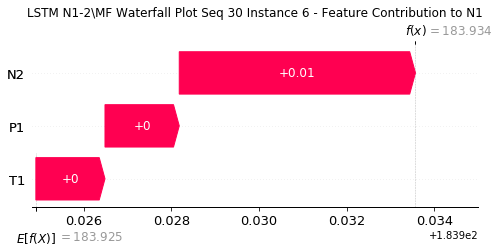

None

Contribution: [0.00161589 0.00156528 0.00521013]


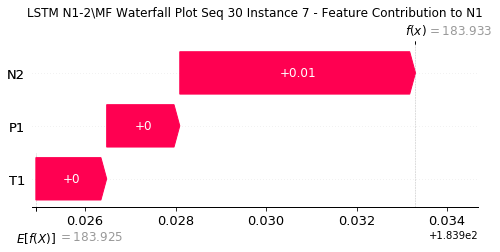

None

Contribution: [0.00160467 0.00146583 0.00517033]


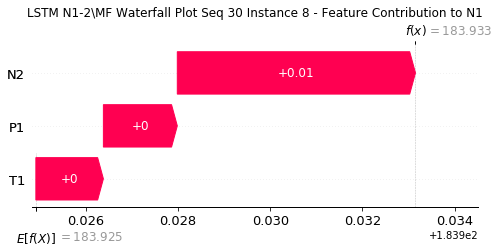

None

Contribution: [0.00159121 0.00142623 0.00518935]


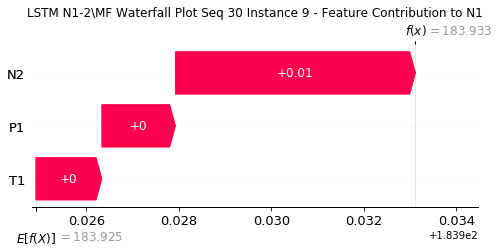

None

Contribution: [0.00162861 0.00145421 0.00524851]


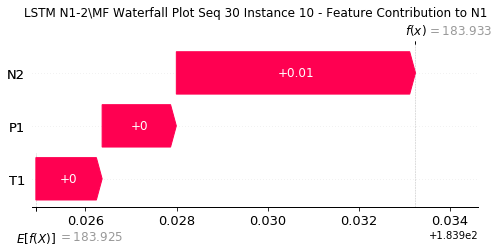

None

Contribution: [0.00167417 0.0015395  0.00540386]


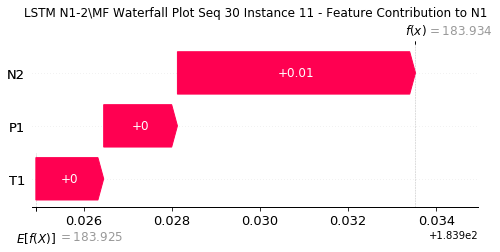

None

Contribution: [0.00174433 0.00161396 0.00562361]


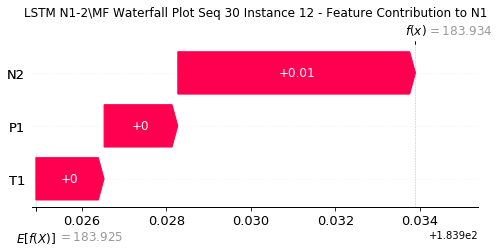

None

Contribution: [0.00184008 0.0016601  0.00595214]


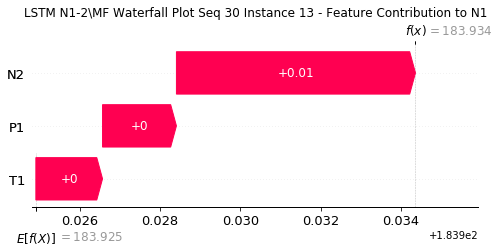

None

Contribution: [0.00201693 0.00184439 0.00649733]


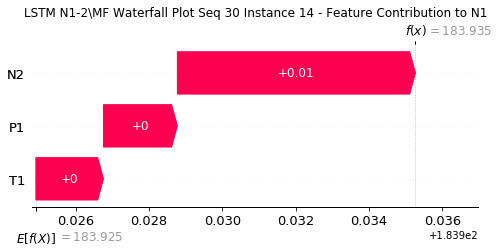

None

Contribution: [0.00230375 0.00214696 0.00730351]


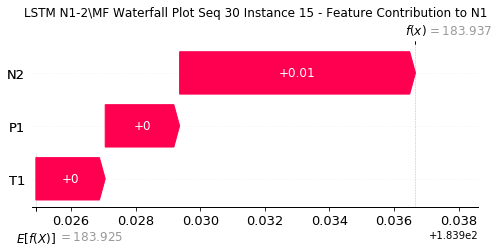

None

Contribution: [0.00265603 0.00241252 0.00851732]


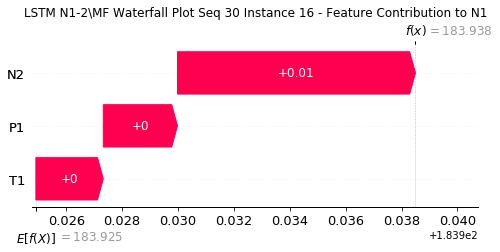

None

Contribution: [0.00326765 0.00296278 0.0104318 ]


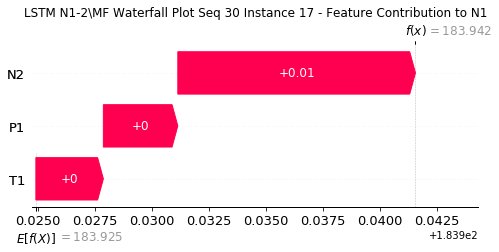

None

Contribution: [0.00426581 0.00377455 0.01348216]


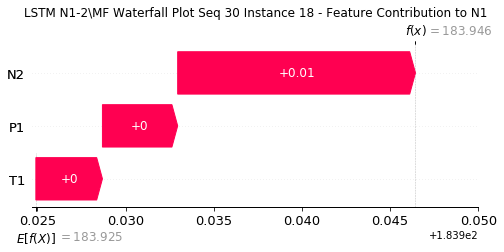

None

Contribution: [0.00585124 0.00543082 0.0185954 ]


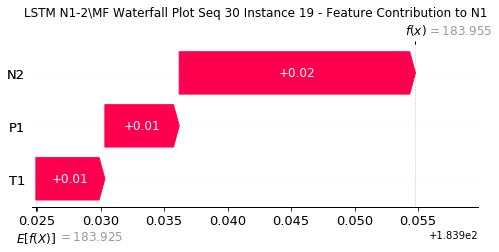

None

Contribution: [0.00853425 0.00792264 0.02707143]


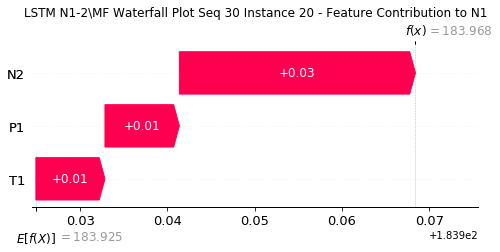

None

Contribution: [0.01296631 0.0120856  0.04122448]


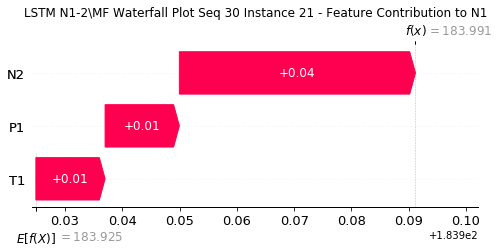

None

Contribution: [0.02019883 0.01846372 0.06421261]


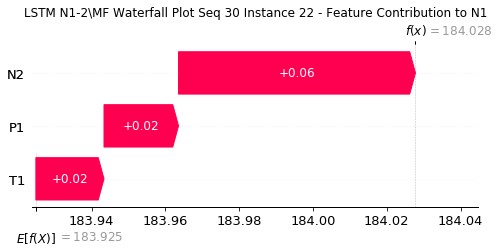

None

Contribution: [0.0304109  0.02790611 0.09766286]


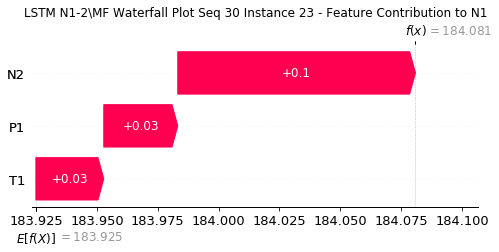

None

Contribution: [0.04165189 0.02325506 0.14474253]


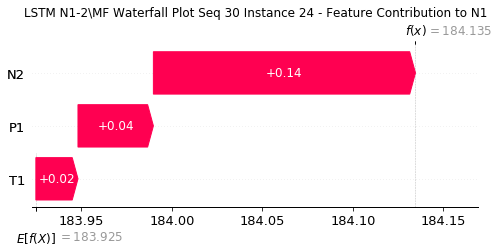

None

Contribution: [ 0.61407253 -0.04905104  1.99678846]


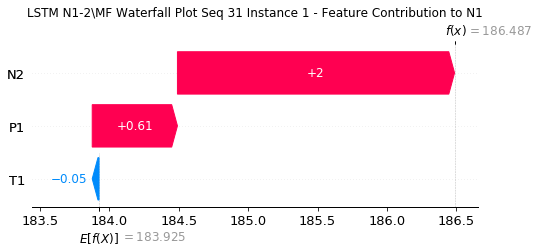

None

Contribution: [0.04327922 0.01127956 0.13653668]


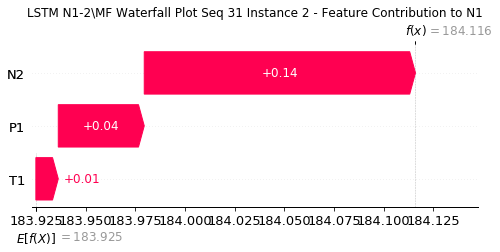

None

Contribution: [ 0.00328195 -0.00043286  0.01190629]


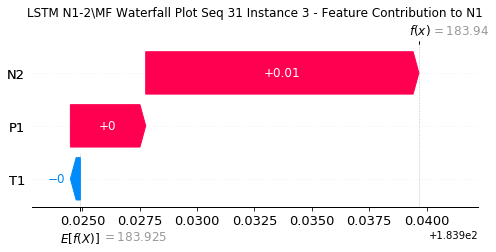

None

Contribution: [0.00227341 0.00215814 0.00724155]


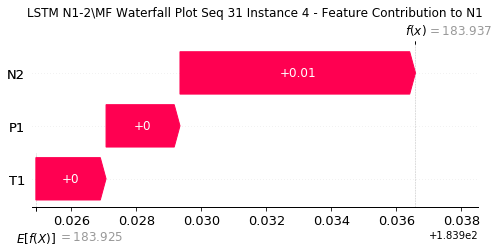

None

Contribution: [0.00196885 0.00184962 0.00626369]


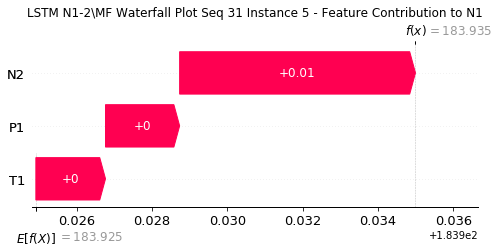

None

Contribution: [0.00170247 0.00163157 0.00539639]


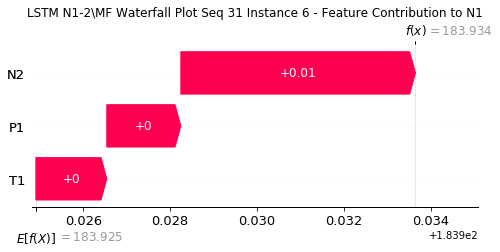

None

Contribution: [0.00163571 0.00155794 0.00522322]


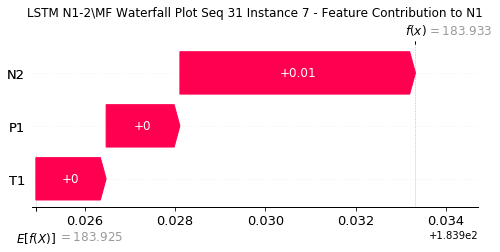

None

Contribution: [0.00158858 0.00145878 0.00515864]


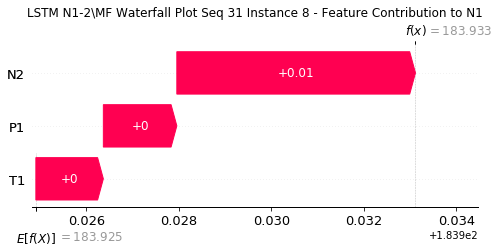

None

Contribution: [0.00156764 0.00146338 0.00516864]


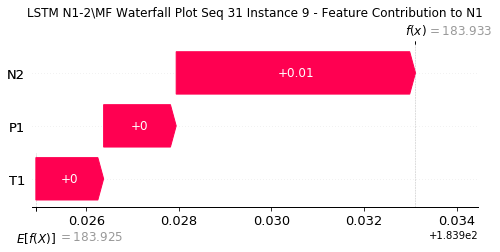

None

Contribution: [0.00161314 0.00146495 0.0052479 ]


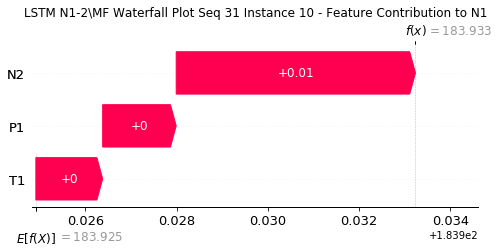

None

Contribution: [0.00170818 0.00159052 0.00542493]


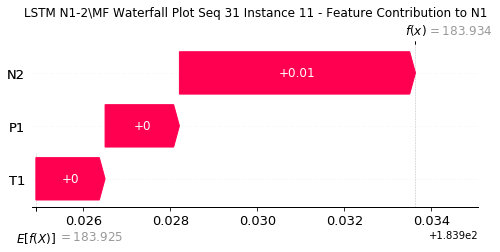

None

Contribution: [0.0017765  0.00165399 0.00564044]


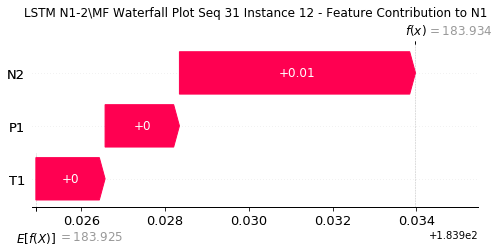

None

Contribution: [0.00188423 0.00172441 0.00598255]


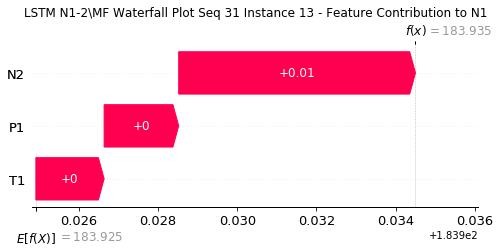

None

Contribution: [0.00204759 0.00187168 0.00650582]


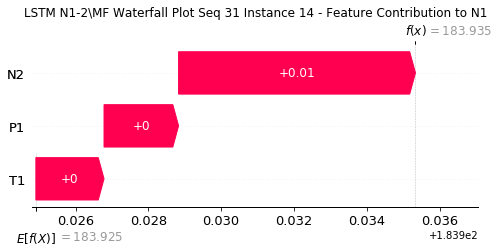

None

Contribution: [0.00226545 0.0020856  0.00729732]


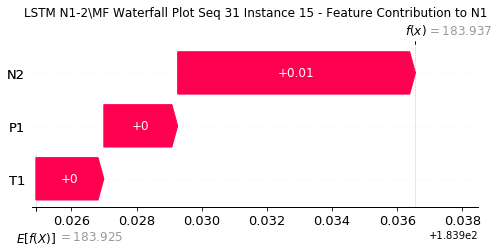

None

Contribution: [0.00267982 0.00242228 0.00850726]


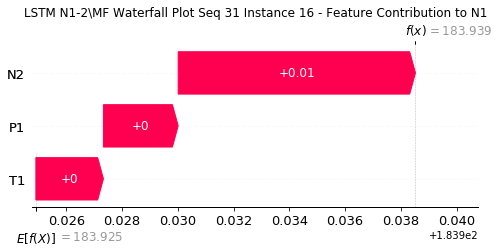

None

Contribution: [0.00327448 0.00295962 0.01040664]


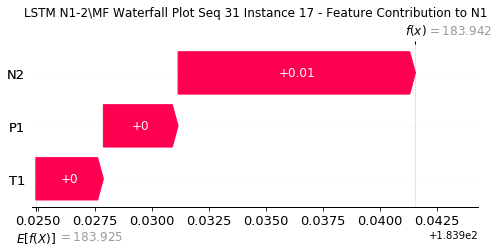

None

Contribution: [0.00434219 0.00397835 0.013513  ]


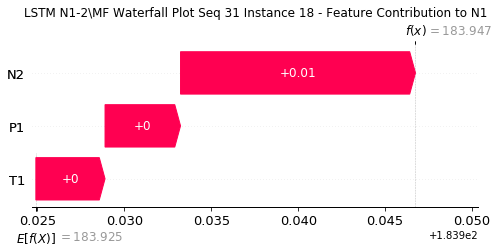

None

Contribution: [0.00582282 0.00521906 0.01852143]


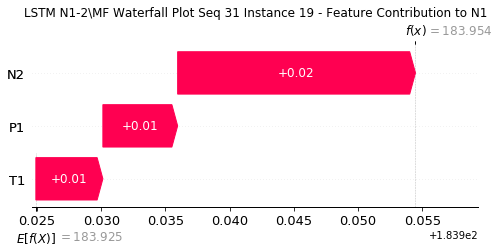

None

Contribution: [0.00846362 0.0076203  0.0269516 ]


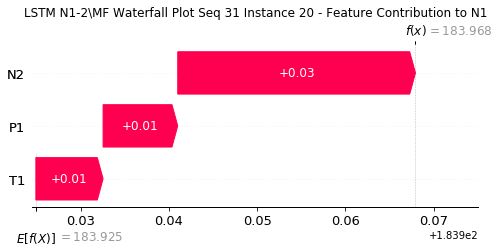

None

Contribution: [0.01287589 0.01154712 0.04105771]


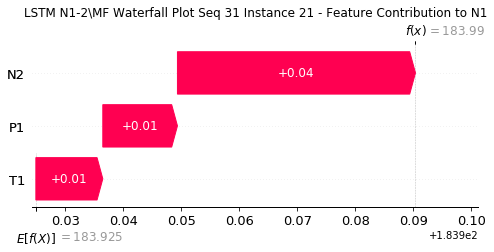

None

Contribution: [0.02001642 0.01790287 0.06395367]


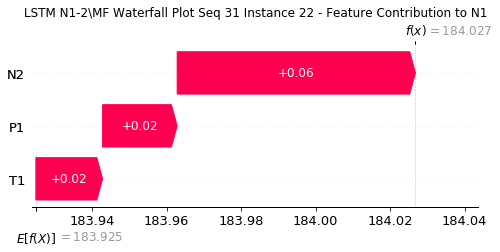

None

Contribution: [0.03001893 0.02569491 0.09731462]


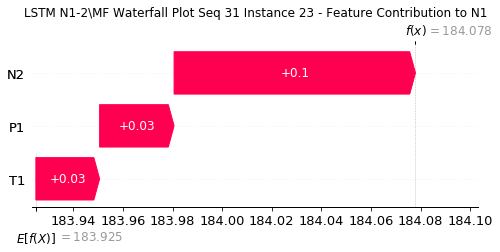

None

Contribution: [0.04583897 0.02048786 0.14838741]


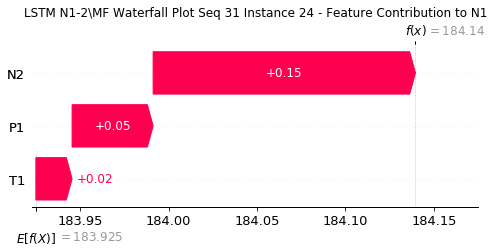

None

Contribution: [ 0.69535651 -0.02224858  2.048894  ]


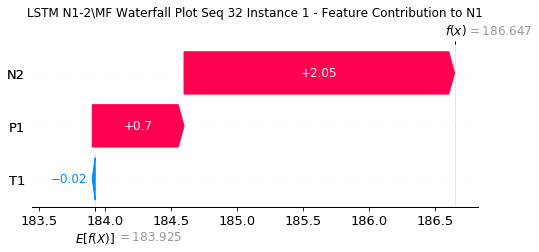

None

Contribution: [0.05018039 0.00736008 0.13965711]


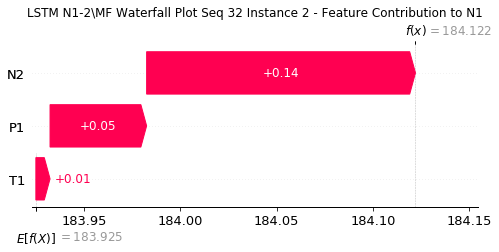

None

Contribution: [ 0.00424436 -0.00198326  0.01262724]


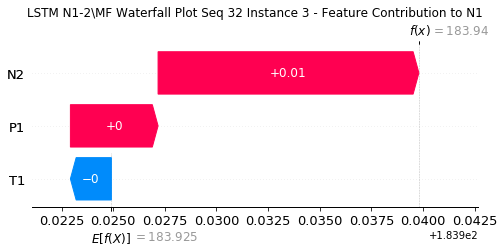

None

Contribution: [0.0022339  0.00207781 0.00726016]


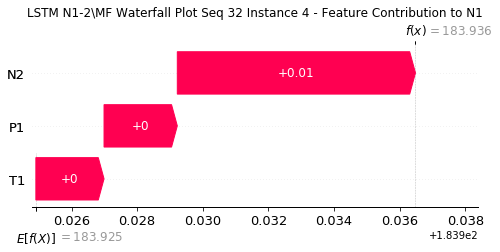

None

Contribution: [0.00192736 0.00178096 0.006244  ]


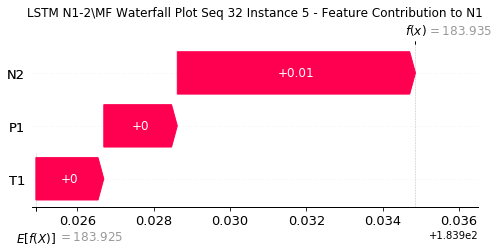

None

Contribution: [0.00160703 0.00156873 0.00532669]


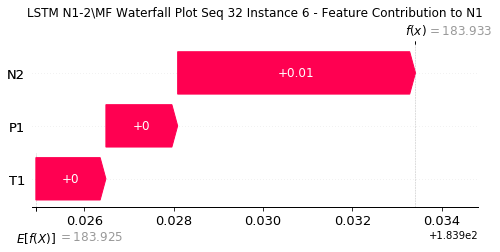

None

Contribution: [0.00160655 0.00150723 0.00520882]


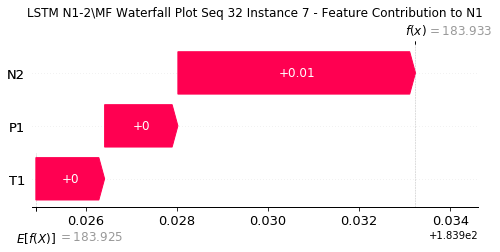

None

Contribution: [0.0016239  0.00150778 0.0052089 ]


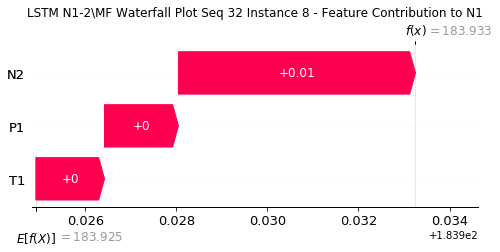

None

Contribution: [0.00165146 0.00155374 0.00524864]


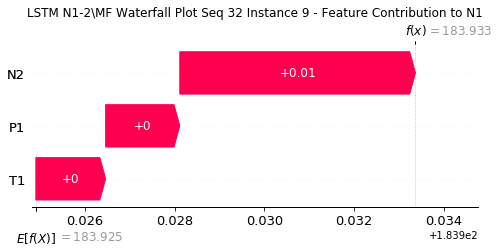

None

Contribution: [0.00164232 0.00156063 0.00529722]


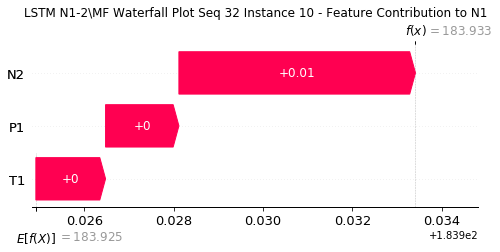

None

Contribution: [0.00167927 0.00153827 0.00542056]


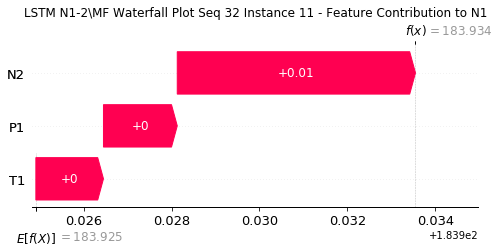

None

Contribution: [0.00175028 0.00158781 0.00563668]


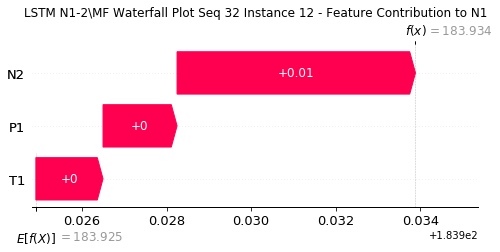

None

Contribution: [0.00183133 0.00164542 0.00596384]


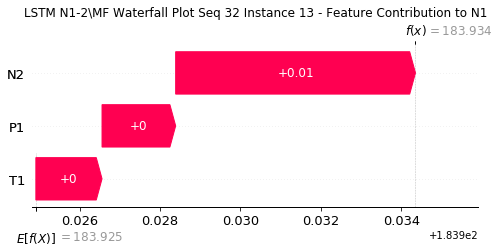

None

Contribution: [0.00201807 0.00180251 0.00649964]


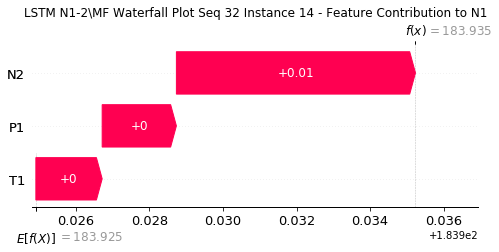

None

Contribution: [0.00216534 0.0018648  0.00722467]


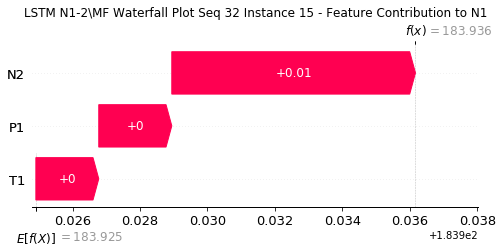

None

Contribution: [0.00265042 0.00232621 0.00850243]


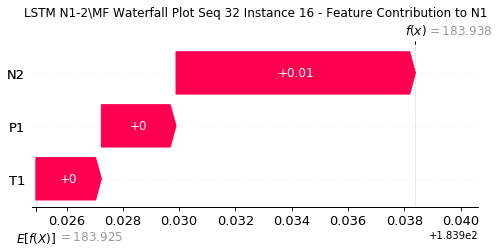

None

Contribution: [0.00324153 0.00282841 0.01039727]


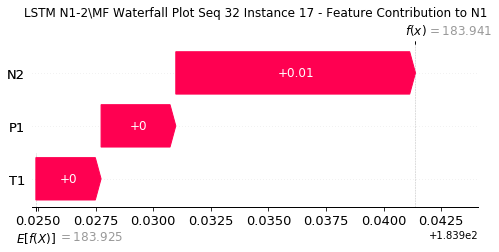

None

Contribution: [0.00420498 0.00358732 0.01347427]


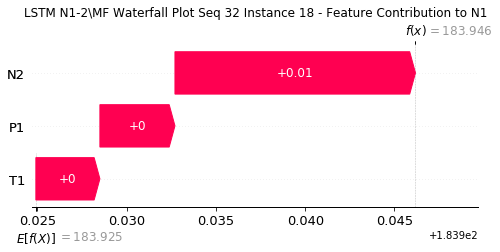

None

Contribution: [0.00578883 0.00494683 0.01849461]


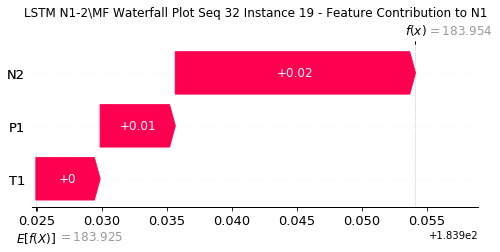

None

Contribution: [0.00841987 0.00722573 0.02691628]


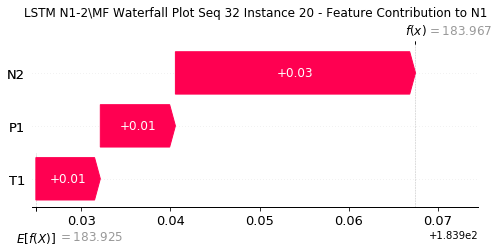

None

Contribution: [0.01283857 0.01098447 0.04104056]


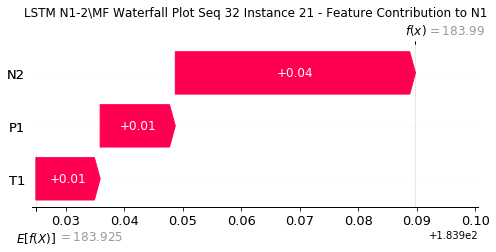

None

Contribution: [0.01996378 0.01707965 0.0640493 ]


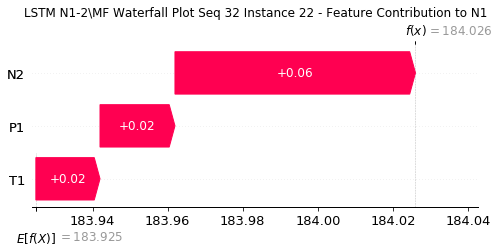

None

Contribution: [0.0304053  0.02452874 0.09796608]


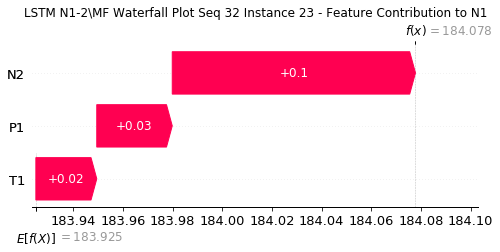

None

Contribution: [0.04552302 0.02263248 0.1478202 ]


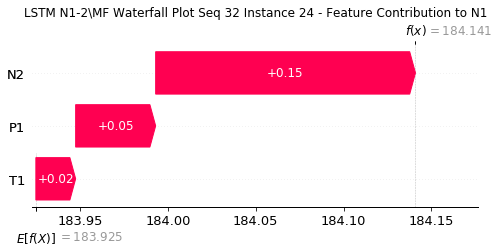

None

Contribution: [ 0.6007335  -0.10463529  2.04287468]


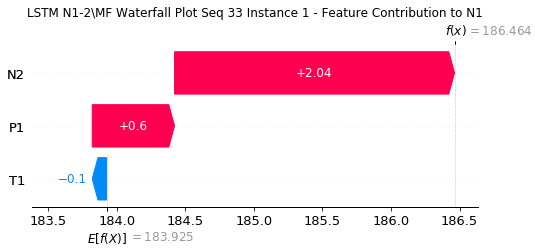

None

Contribution: [0.04639455 0.00648647 0.14091146]


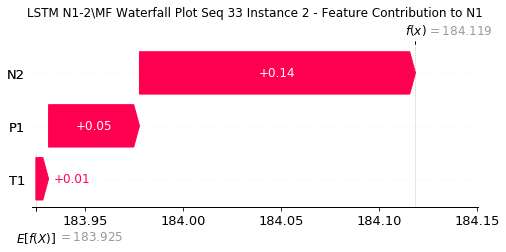

None

Contribution: [ 0.00377257 -0.00143647  0.01255081]


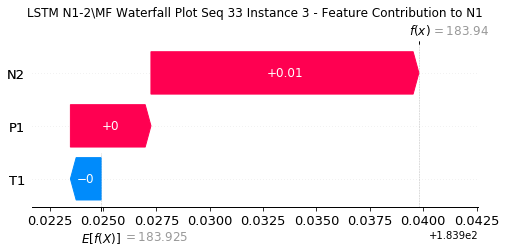

None

Contribution: [0.00216738 0.00195175 0.00723635]


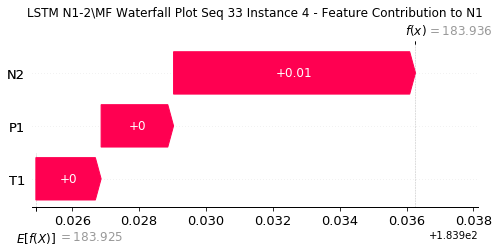

None

Contribution: [0.00188503 0.00167674 0.00626412]


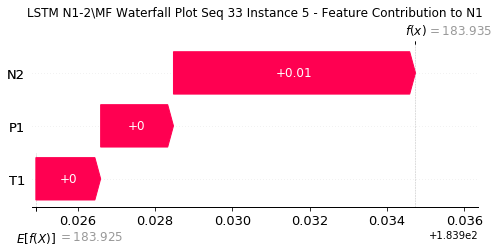

None

Contribution: [0.00163371 0.00153186 0.00539484]


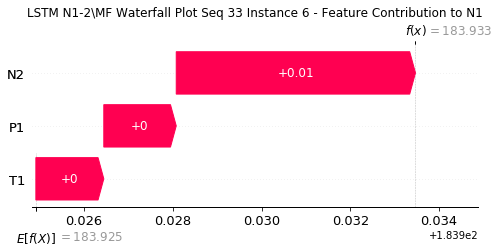

None

Contribution: [0.00157717 0.00140904 0.00523275]


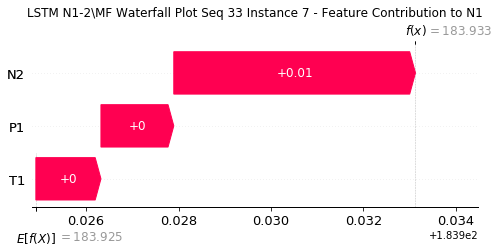

None

Contribution: [0.00161549 0.00133096 0.00520381]


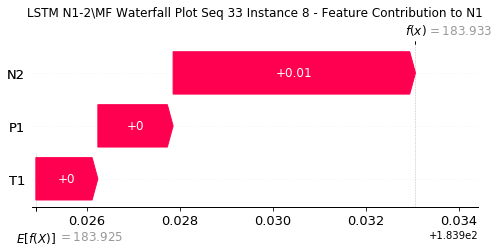

None

Contribution: [0.00162912 0.00144764 0.00523889]


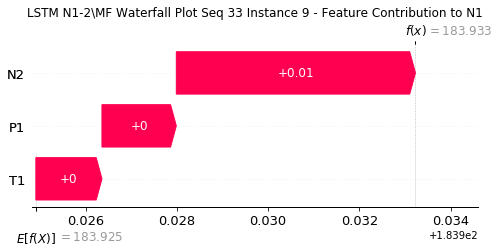

None

Contribution: [0.0016298  0.00133173 0.00528011]


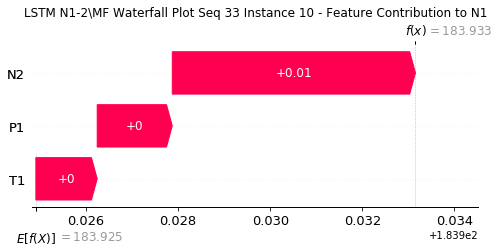

None

Contribution: [0.00165344 0.00142672 0.00543269]


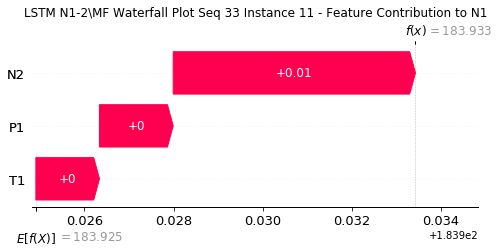

None

Contribution: [0.00172477 0.00148425 0.00565612]


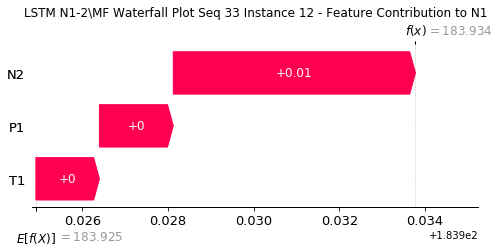

None

Contribution: [0.00188821 0.00158178 0.00601317]


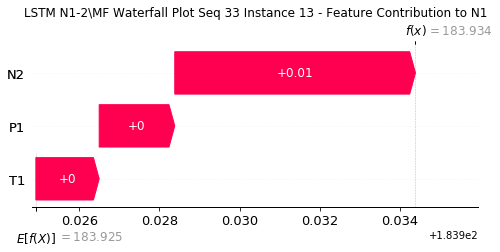

None

Contribution: [0.00200503 0.00168277 0.00653231]


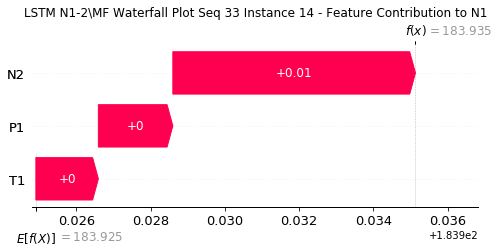

None

Contribution: [0.00222015 0.00186463 0.00730426]


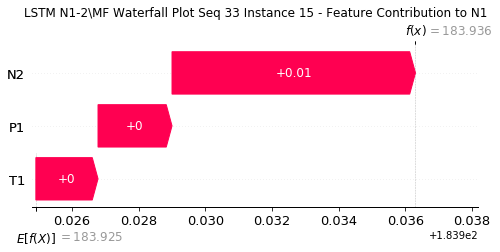

None

Contribution: [0.00263241 0.00218228 0.00855683]


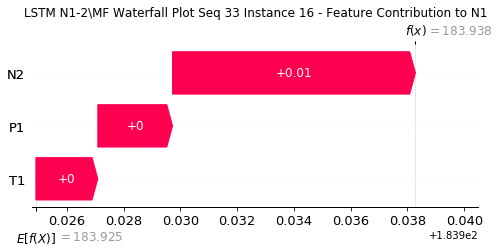

None

Contribution: [0.00320662 0.00265327 0.0104746 ]


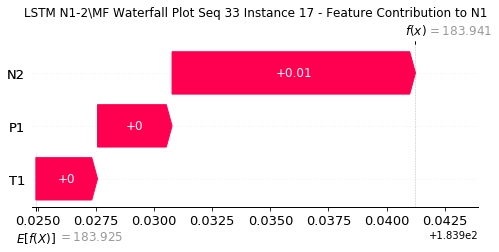

None

Contribution: [0.00429851 0.00339369 0.01360586]


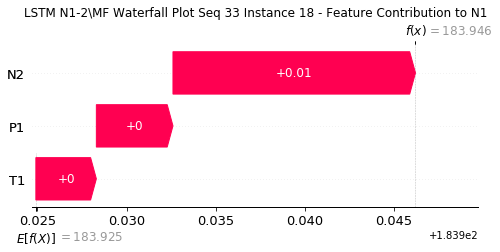

None

Contribution: [0.00575341 0.00468722 0.01866911]


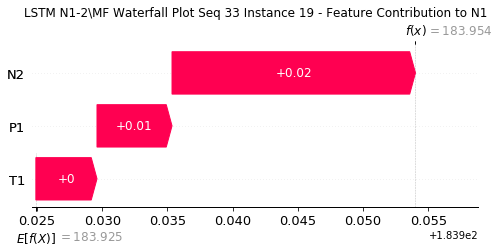

None

Contribution: [0.00834578 0.0068215  0.02714954]


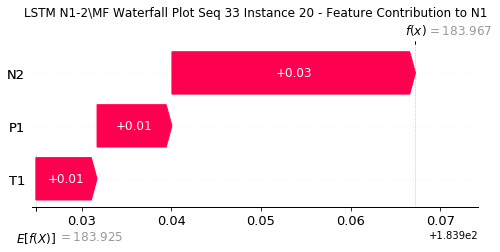

None

Contribution: [0.01276362 0.01029782 0.04131838]


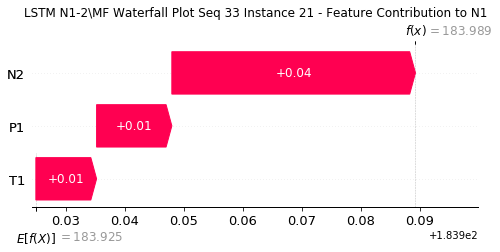

None

Contribution: [0.01973475 0.01569586 0.06422161]


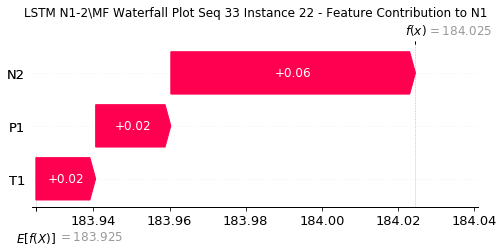

None

Contribution: [0.02984016 0.02070761 0.09764392]


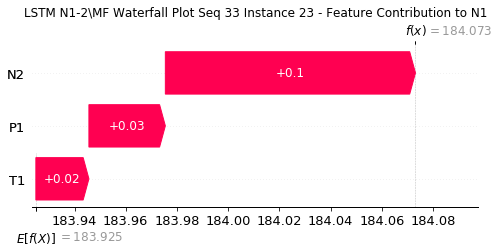

None

Contribution: [ 0.0404036  -0.00387047  0.14331865]


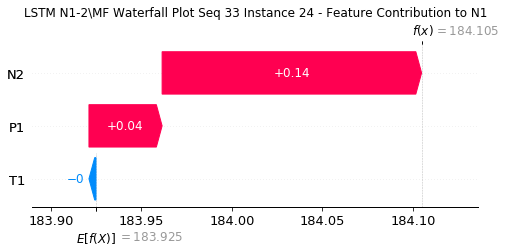

None

Contribution: [ 0.45914375 -0.44331247  1.95106057]


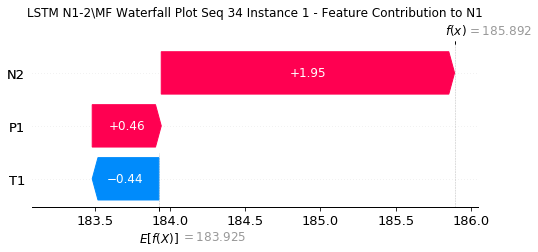

None

Contribution: [ 0.04424169 -0.010438    0.14022481]


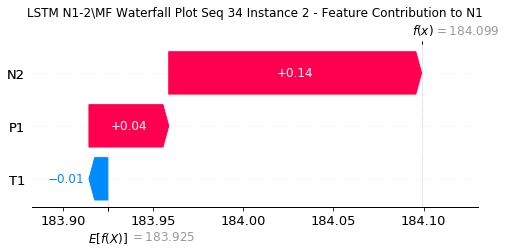

None

Contribution: [ 0.0033336  -0.00266805  0.01210172]


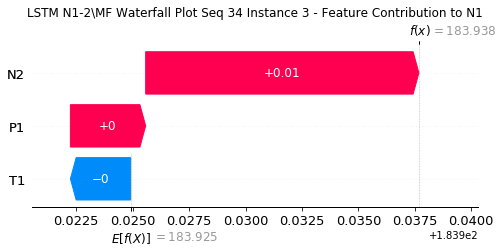

None

Contribution: [0.00209819 0.00177802 0.00706268]


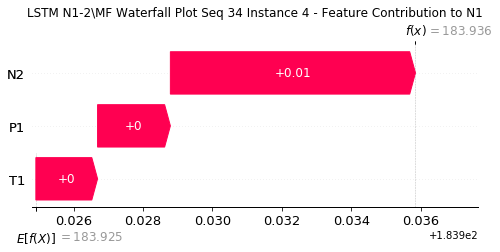

None

Contribution: [0.0018683  0.00157723 0.00627852]


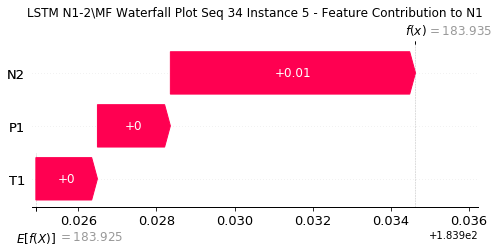

None

Contribution: [0.00157335 0.00135478 0.0054557 ]


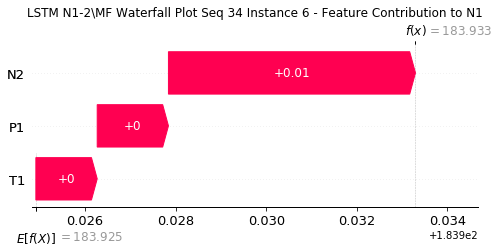

None

Contribution: [0.00156895 0.0013464  0.00531311]


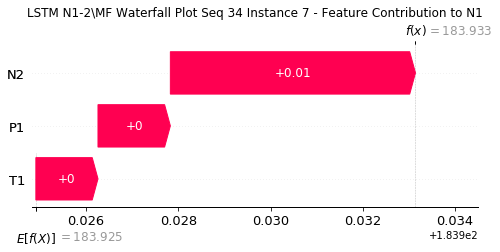

None

Contribution: [0.00153274 0.00134147 0.00529659]


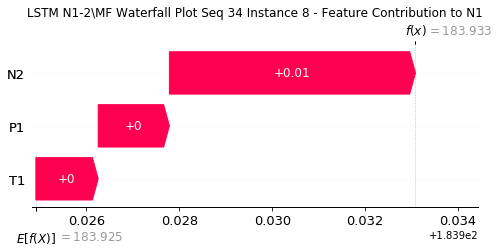

None

Contribution: [0.00146781 0.00130983 0.0052941 ]


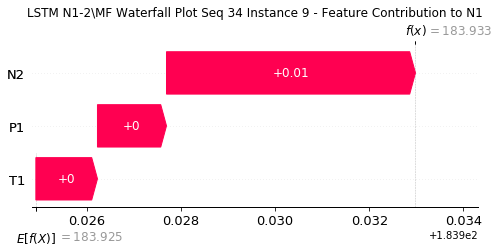

None

Contribution: [0.00151525 0.00133382 0.00536337]


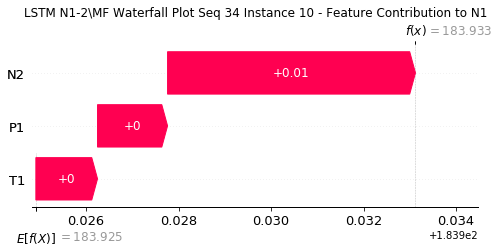

None

Contribution: [0.00164143 0.00137116 0.00553212]


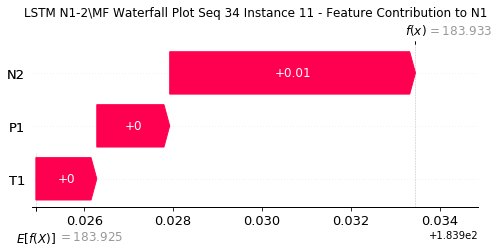

None

Contribution: [0.0017232  0.00143451 0.0057669 ]


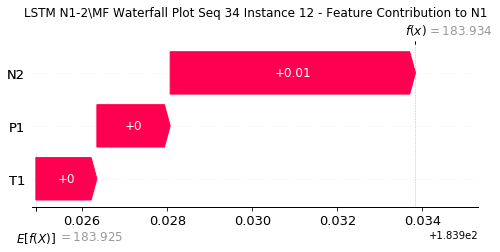

None

Contribution: [0.00181156 0.00157341 0.00613367]


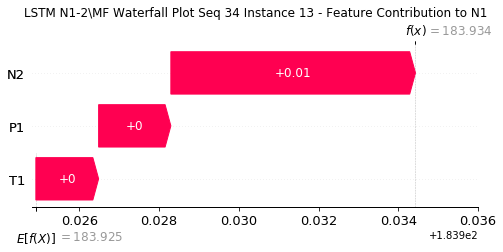

None

Contribution: [0.00200038 0.00164893 0.00667887]


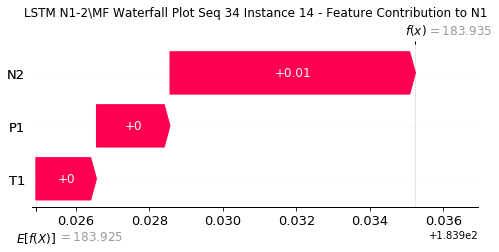

None

Contribution: [0.00219889 0.00179457 0.00748891]


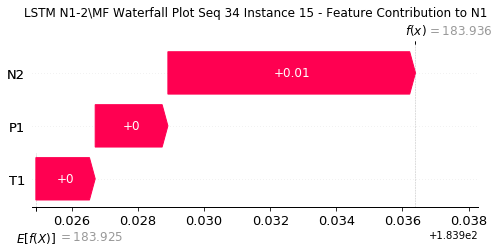

None

Contribution: [0.00265425 0.00215247 0.00879701]


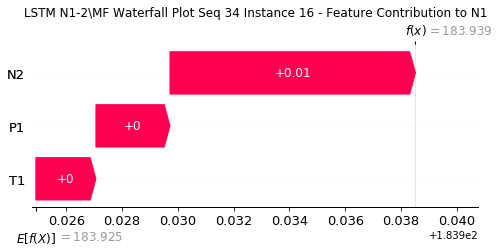

None

Contribution: [0.00325815 0.00262268 0.01079408]


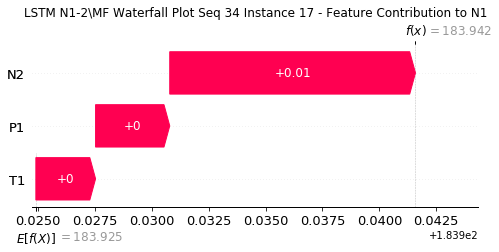

None

Contribution: [0.00430835 0.00354678 0.01403365]


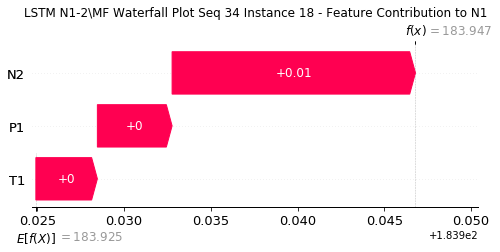

None

Contribution: [0.00591089 0.00473307 0.01928627]


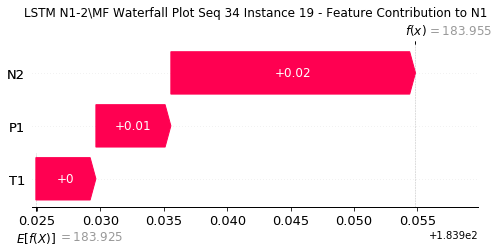

None

Contribution: [0.00857227 0.00688203 0.02801796]


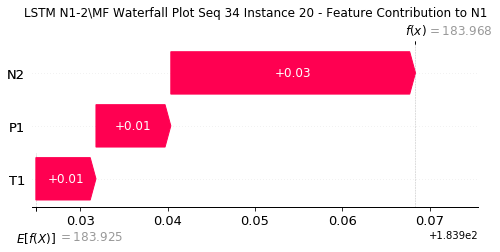

None

Contribution: [0.01301886 0.01048058 0.04248338]


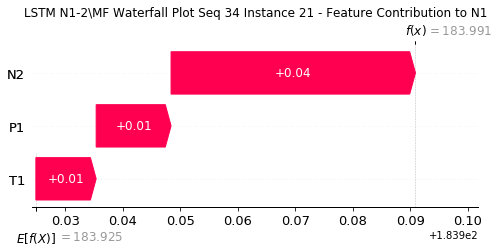

None

Contribution: [0.01990764 0.01574004 0.06574028]


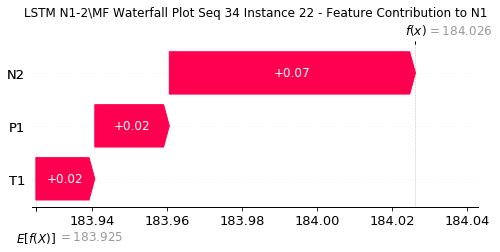

None

Contribution: [0.02979017 0.02032372 0.09934536]


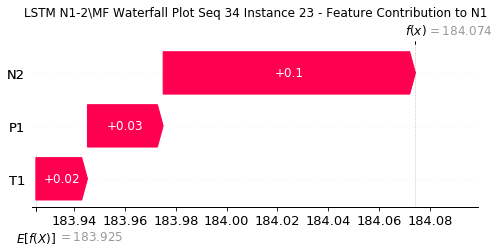

None

Contribution: [ 0.0400391  -0.00935321  0.14538953]


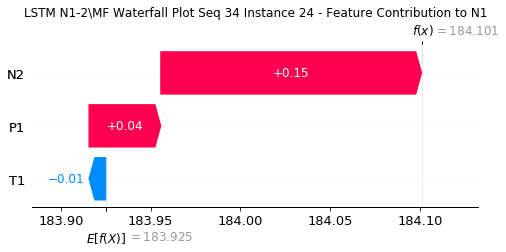

None

In [40]:
#Waterfall Plot for Consistency metric

instance = xtrain
instance2 = xtest
explainer = shap.DeepExplainer(model3,instance)
    
for s in range(0,34):
    instance=xtest[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("LSTM N1-2\MF Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution to N1" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [1]:
#Consistency

N1_tot1' = 195.219 - 186.2017
N1_tot1'

9.017300000000006

In [ ]:
#MF contribution instance 1

MF_N1_1' = 0.74862935